In [1]:
# Attempt to create a GAN model written using keras with tensorflow backend
# Created by: @leopauly 
# email :cnlp@leeds.ac.uk

%matplotlib inline
import numpy as np
import datetime
from matplotlib import pyplot 
from matplotlib.backends.backend_pdf import PdfPages
from scipy.misc import toimage

from keras.datasets import mnist,cifar10
from keras.models import Sequential
from keras.layers.core import Reshape,Activation
from keras.layers import Dense, Dropout, Flatten
from keras.layers.pooling import MaxPooling2D
from keras.constraints import maxnorm
from keras.layers.normalization import BatchNormalization
from keras.optimizers import SGD
from keras.layers.convolutional import Convolution2D, UpSampling2D
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from keras.utils import np_utils
from keras import backend as K

K.set_image_dim_ordering('th')
seed = 7
np.random.seed(seed)
mypdf = PdfPages("mygan_v3.pdf")


Using TensorFlow backend.


In [2]:
def data():
    (X_train, y_train), (X_test, y_test) = mnist.load_data()
    global img_rows,img_cols,channel,noise_size,input_shape
    img_rows=28
    img_cols=28
    channel=1
    noise_size=100
    print ('shape of X_train',X_train.shape)
    print ('shape of X_test',X_test.shape)
    
    #since the image ordering is set to th (theano image ordering)
    X_train = X_train.reshape(X_train.shape[0], 1, img_rows, img_cols)
    X_test = X_test.reshape(X_test.shape[0], 1, img_rows, img_cols)
    input_shape = (1, img_rows, img_cols)
    
    # normalize inputs from the range 0-255 to 0.0-1.0
    X_train = X_train.astype('float32')
    X_test = X_test.astype('float32')
    X_train = X_train / 255.0
    X_test = X_test / 255.0
    
    return (X_train, y_train),(X_test, y_test)

In [3]:
def create_generator():
    net= Sequential()
    net.add(Dense(1024,input_dim=noise_size,activation='tanh'))
    net.add(Dense(6272))  # 128*7*7=6272 Nodes in this dense layer
    net.add(BatchNormalization())
    net.add(Activation('tanh'))
    net.add(Reshape(target_shape=(128,7,7)))
    net.add(UpSampling2D(size=(2, 2)))
    net.add(Convolution2D(64, 5, 5, border_mode='same',activation='tanh'))
    net.add(UpSampling2D(size=(2, 2)))
    net.add(Convolution2D(1, 5, 5, border_mode='same',activation='sigmoid'))
    return net

In [4]:
def create_discriminator():
    net= Sequential()
    net.add(Convolution2D(64, 5, 5, input_shape=input_shape, border_mode='same', activation='relu'))
    net.add(MaxPooling2D(pool_size=(2, 2)))
    net.add(Convolution2D(128, 5, 5, border_mode='same', activation='relu'))
    net.add(MaxPooling2D(pool_size=(2, 2)))
    net.add(Flatten())
    net.add(Dense(128*7*7,activation='tanh'))
    net.add(Dense(1024, activation='tanh'))
    net.add(Dense(1, activation='sigmoid'))
    return net

In [5]:
def create_gan(generator, discriminator):
    net=Sequential()
    net.add(generator)
    discriminator.trainable = False
    net.add(discriminator)
    return net

shape of X_train (60000, 28, 28)
shape of X_test (10000, 28, 28)


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:9: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (5, 5), activation="tanh", padding="same")`
  if __name__ == '__main__':
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:11: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(1, (5, 5), activation="sigmoid", padding="same")`
  # This is added back by InteractiveShellApp.init_path()
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (5, 5), input_shape=(1, 28, 28..., activation="relu", padding="same")`
  This is separate from the ipykernel package so we can avoid doing imports until
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:5: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (5, 5), activation="relu", padding="same")`
  """
/opt/conda/lib/python3.6/site-packages/keras/models.py:851: UserWarning: The `

Epoch 1/1
4000/4000 [==============================] - 6s - loss: 0.2845     
epoch no: 0
index no: 0


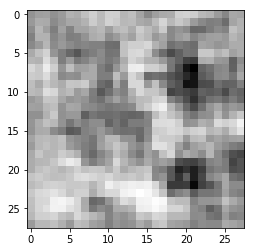

index no: 1


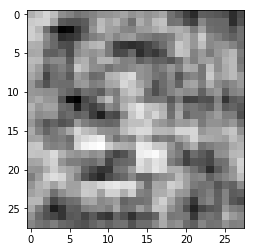

epoch no: 1
index no: 0


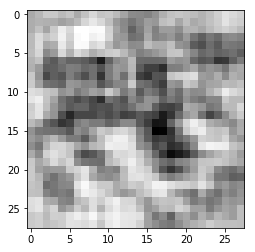

index no: 1


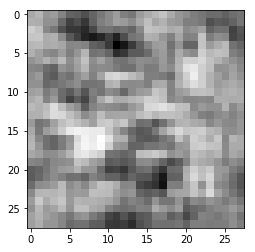

epoch no: 2
index no: 0


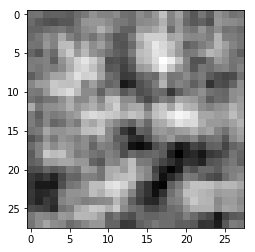

index no: 1


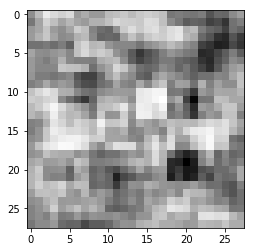

epoch no: 3
index no: 0


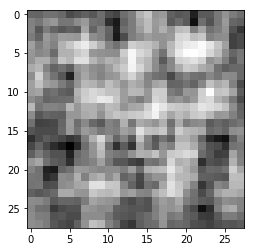

index no: 1


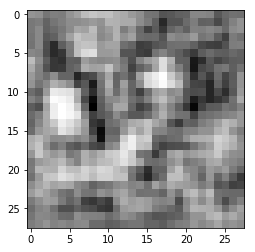

epoch no: 4
index no: 0


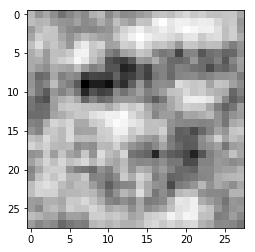

index no: 1


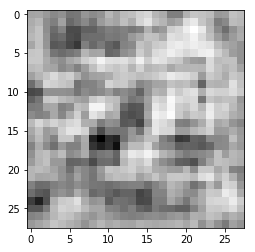

epoch no: 5
index no: 0


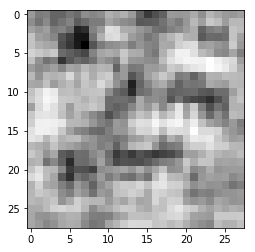

index no: 1


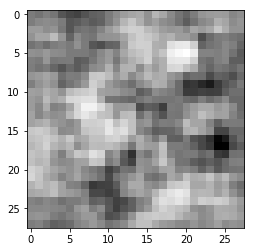

epoch no: 6
index no: 0


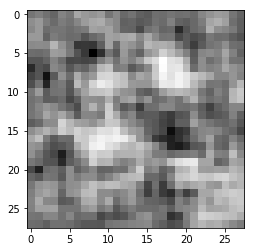

index no: 1


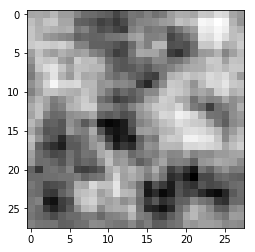

epoch no: 7
index no: 0


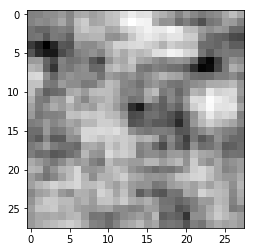

index no: 1


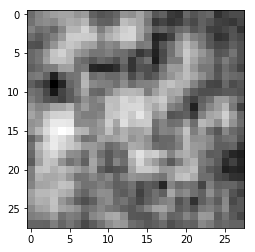

epoch no: 8
index no: 0


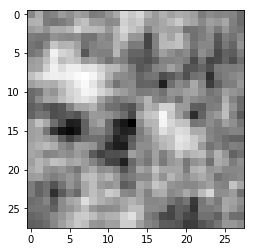

index no: 1


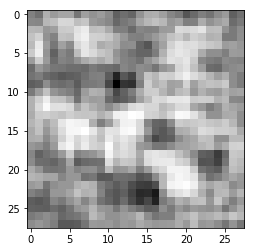

epoch no: 9
index no: 0


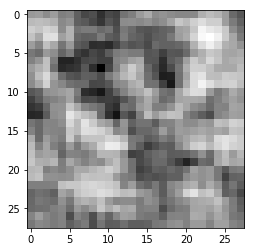

index no: 1


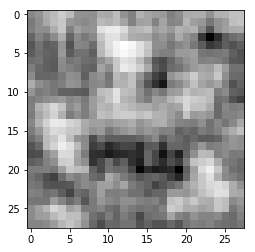

epoch no: 10
index no: 0


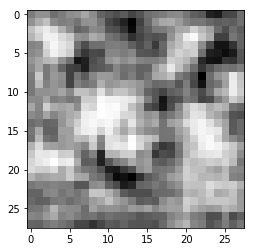

index no: 1


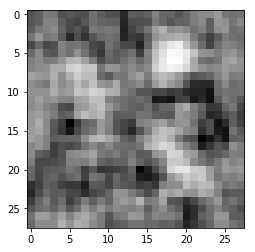

epoch no: 11
index no: 0


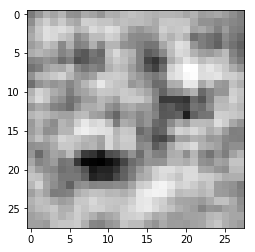

index no: 1


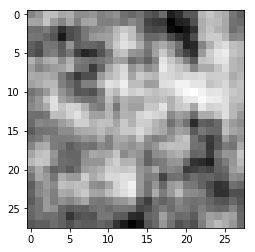

epoch no: 12
index no: 0


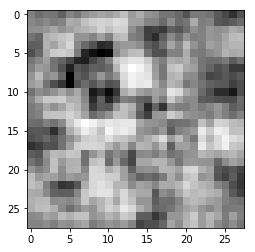

index no: 1


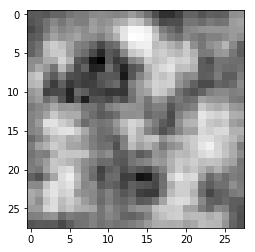

epoch no: 13
index no: 0


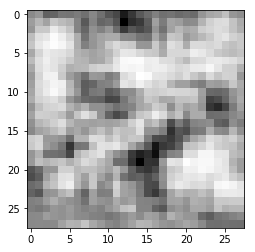

index no: 1


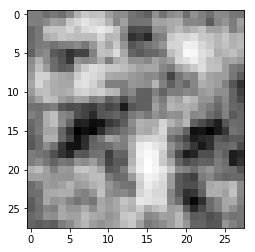

epoch no: 14
index no: 0


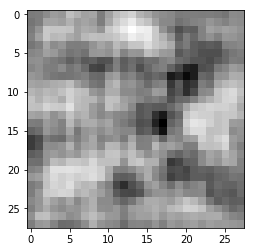

index no: 1


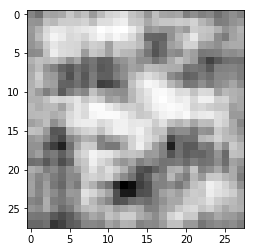

epoch no: 15
index no: 0


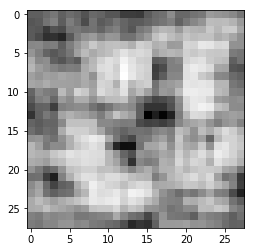

index no: 1


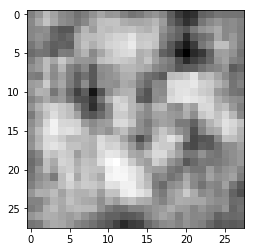

epoch no: 16
index no: 0


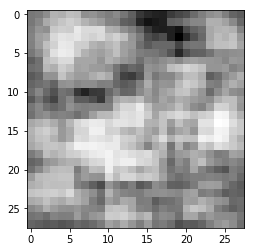

index no: 1


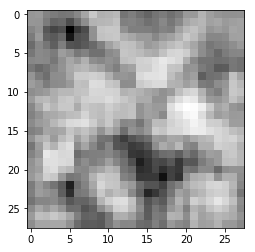

epoch no: 17
index no: 0


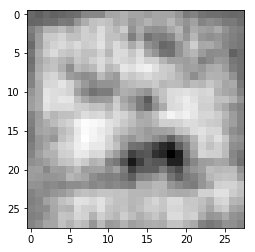

index no: 1


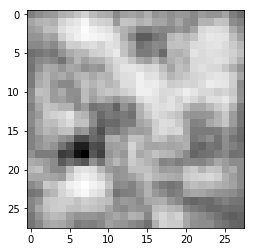

epoch no: 18
index no: 0


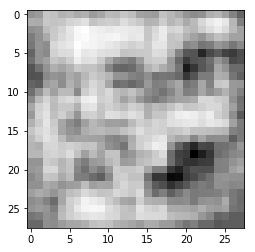

index no: 1


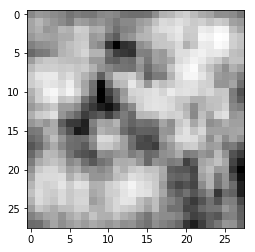

epoch no: 19
index no: 0


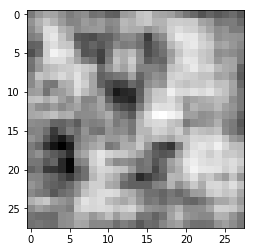

index no: 1


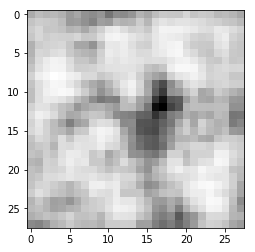

epoch no: 20
index no: 0


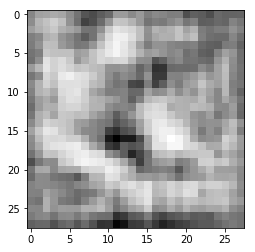

index no: 1


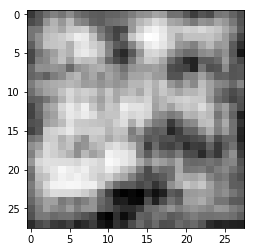

epoch no: 21
index no: 0


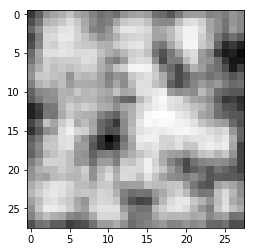

index no: 1


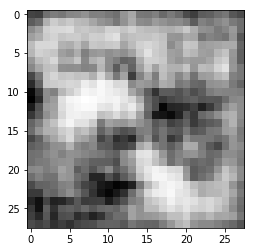

epoch no: 22
index no: 0


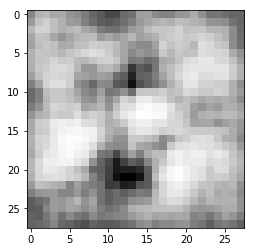

index no: 1


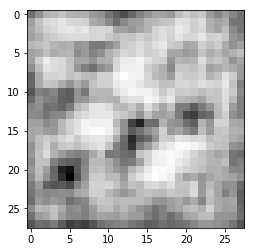

epoch no: 23
index no: 0


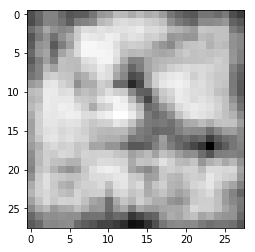

index no: 1


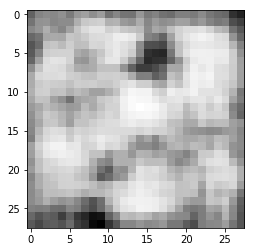

epoch no: 24
index no: 0


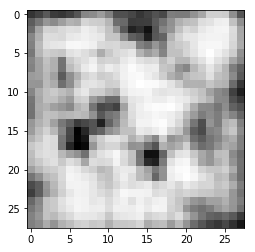

index no: 1


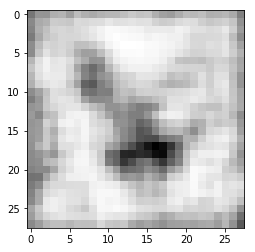

epoch no: 25
index no: 0


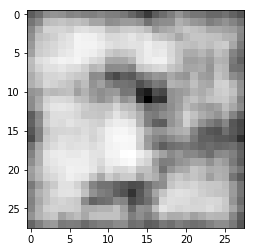

index no: 1


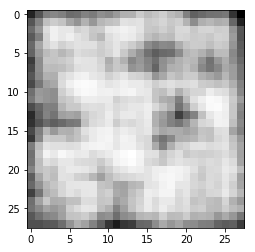

epoch no: 26
index no: 0


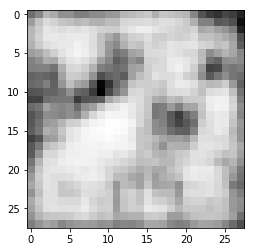

index no: 1


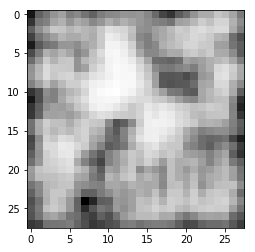

epoch no: 27
index no: 0


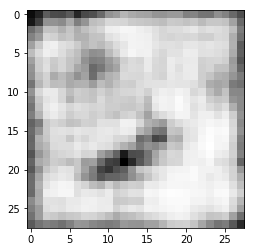

index no: 1


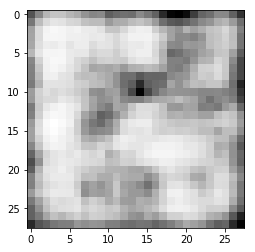

epoch no: 28
index no: 0


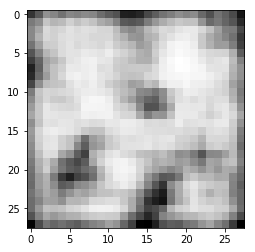

index no: 1


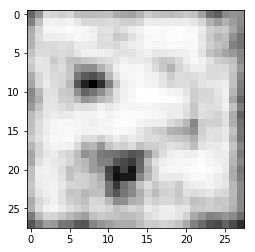

epoch no: 29
index no: 0


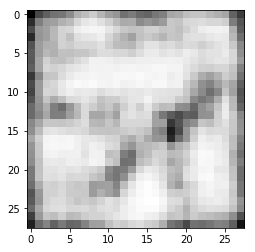

index no: 1


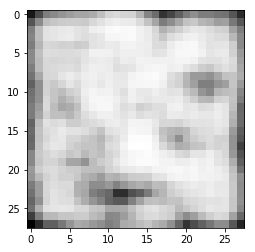

epoch no: 30
index no: 0


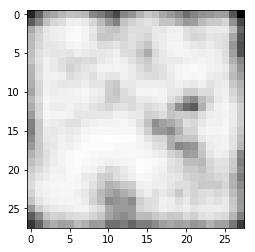

index no: 1


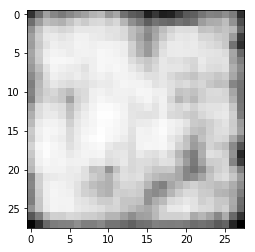

epoch no: 31
index no: 0


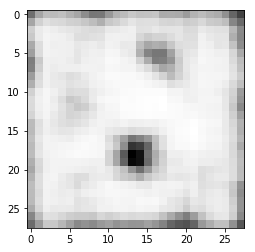

index no: 1


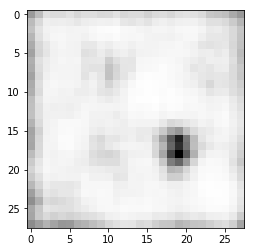

epoch no: 32
index no: 0


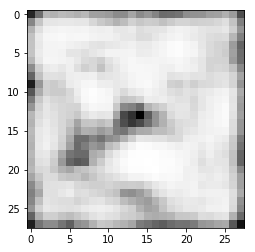

index no: 1


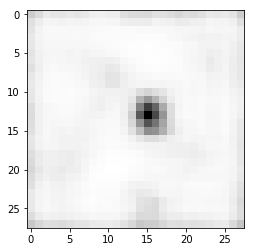

epoch no: 33
index no: 0


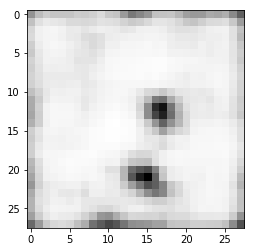

index no: 1


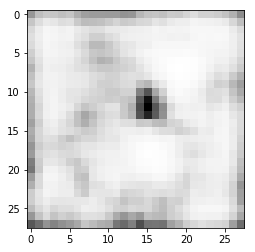

epoch no: 34
index no: 0


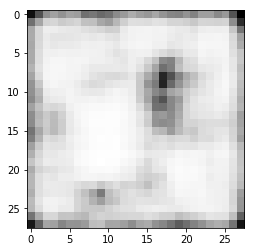

index no: 1


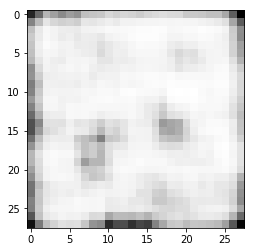

epoch no: 35
index no: 0


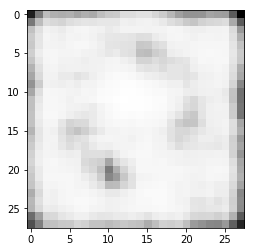

index no: 1


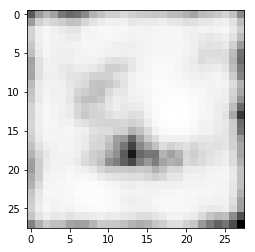

epoch no: 36
index no: 0


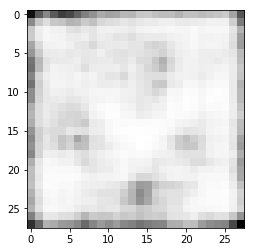

index no: 1


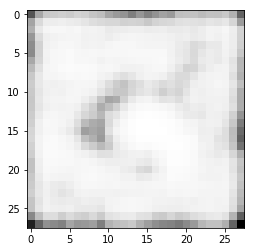

epoch no: 37
index no: 0


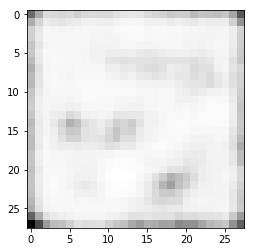

index no: 1


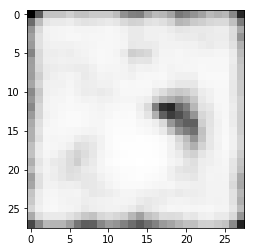

epoch no: 38
index no: 0


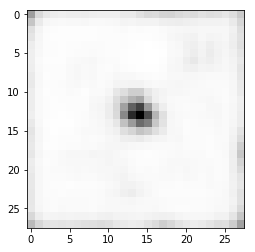

index no: 1


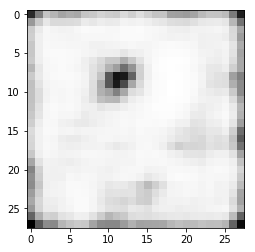

epoch no: 39
index no: 0


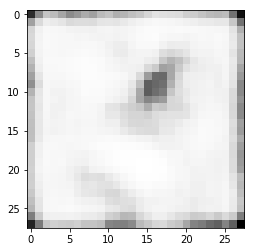

index no: 1


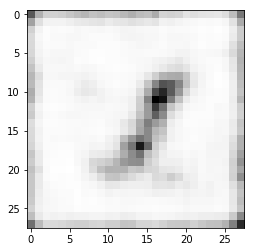

epoch no: 40
index no: 0


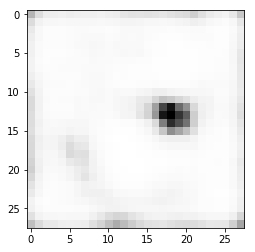

index no: 1


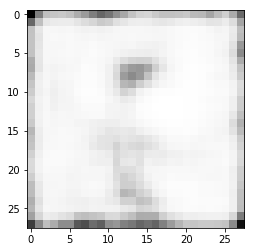

epoch no: 41
index no: 0


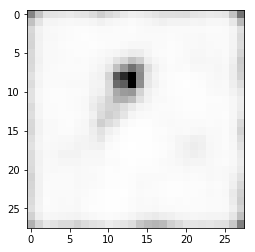

index no: 1


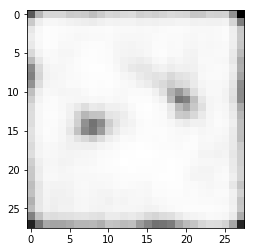

epoch no: 42
index no: 0


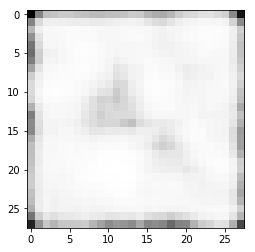

index no: 1


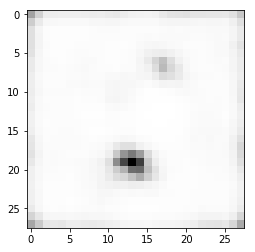

epoch no: 43
index no: 0


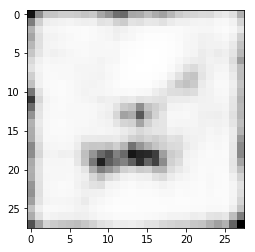

index no: 1


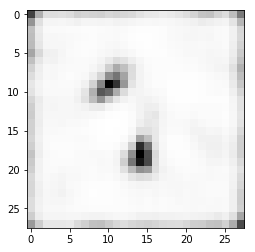

epoch no: 44
index no: 0


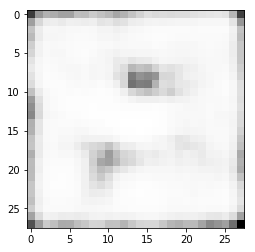

index no: 1


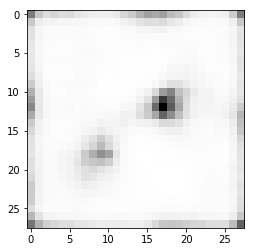

epoch no: 45
index no: 0


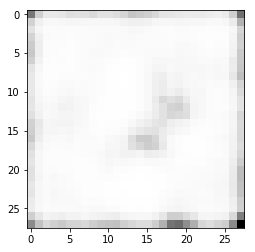

index no: 1


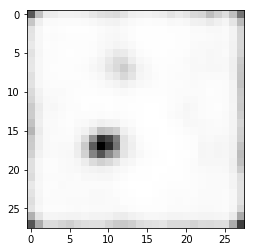

epoch no: 46
index no: 0


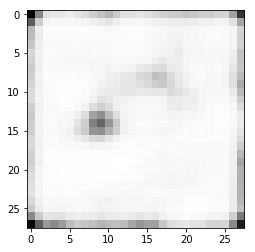

index no: 1


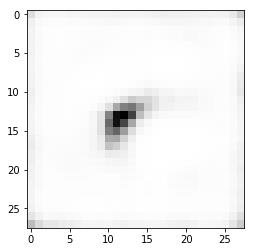

epoch no: 47
index no: 0


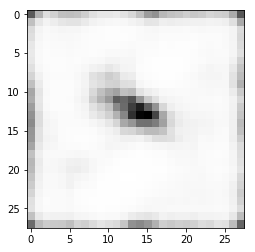

index no: 1


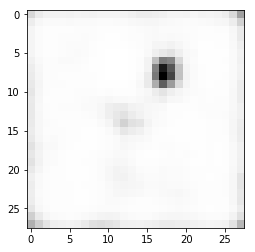

epoch no: 48
index no: 0


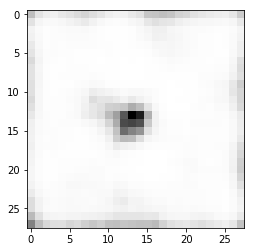

index no: 1


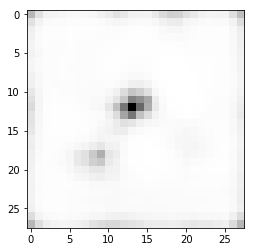

epoch no: 49
index no: 0


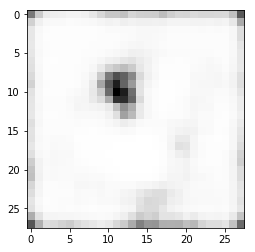

index no: 1


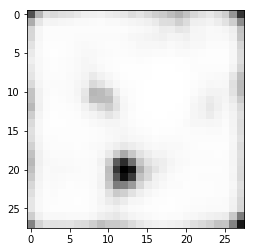

epoch no: 50
index no: 0


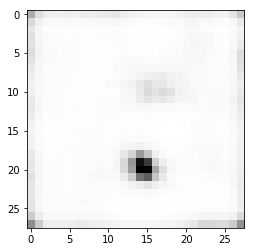

index no: 1


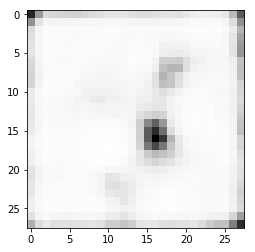

epoch no: 51
index no: 0


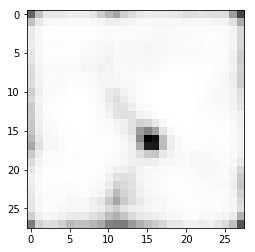

index no: 1


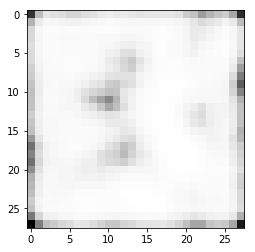

epoch no: 52
index no: 0


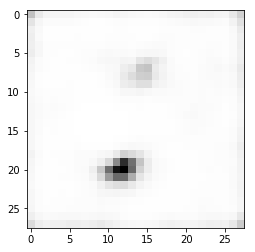

index no: 1


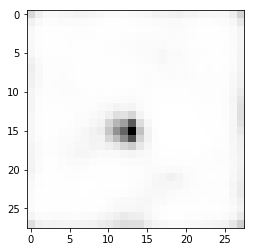

epoch no: 53
index no: 0


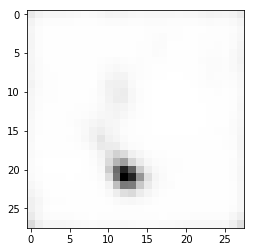

index no: 1


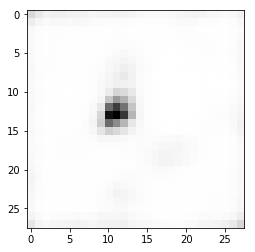

epoch no: 54
index no: 0


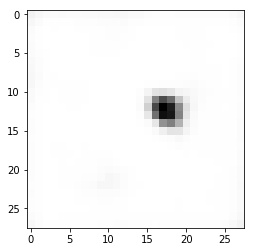

index no: 1


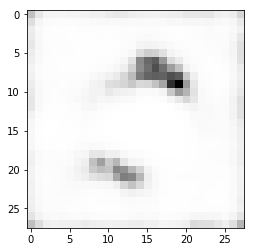

epoch no: 55
index no: 0


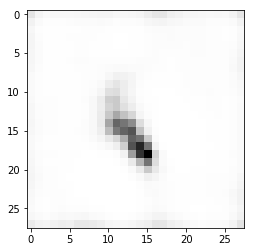

index no: 1


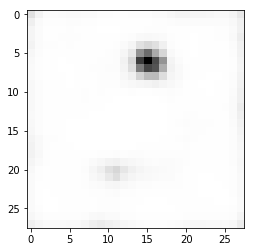

epoch no: 56
index no: 0


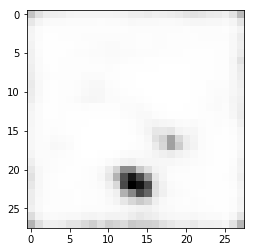

index no: 1


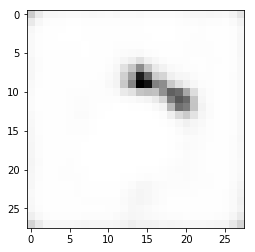

epoch no: 57
index no: 0


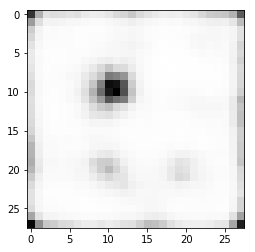

index no: 1


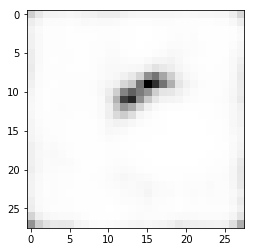

epoch no: 58
index no: 0


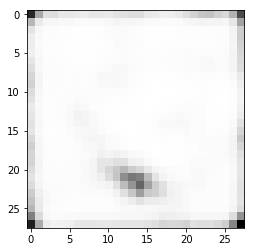

index no: 1


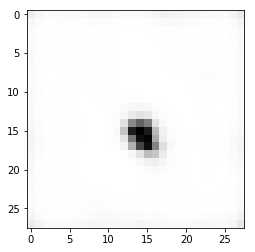

epoch no: 59
index no: 0


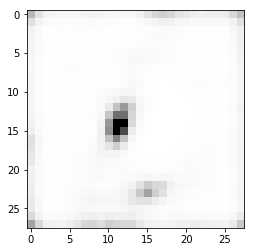

index no: 1


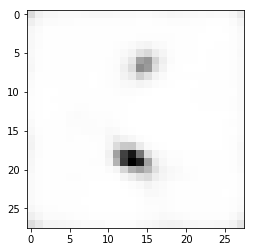

epoch no: 60
index no: 0


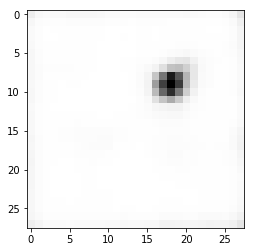

index no: 1


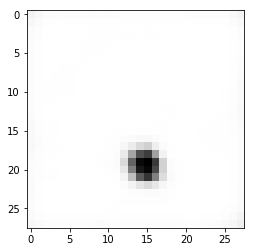

epoch no: 61
index no: 0


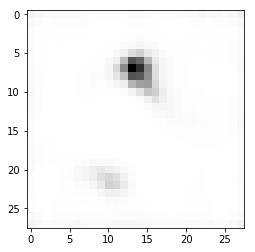

index no: 1


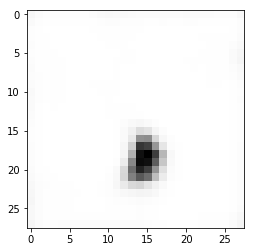

epoch no: 62
index no: 0


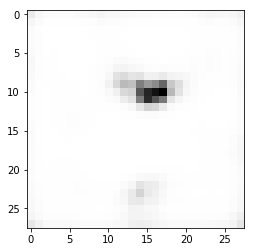

index no: 1


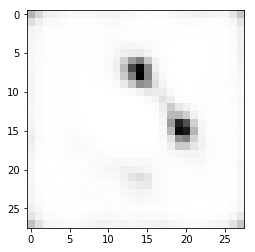

epoch no: 63
index no: 0


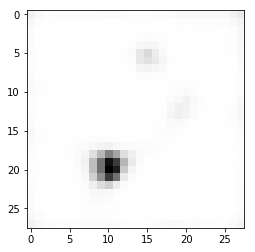

index no: 1


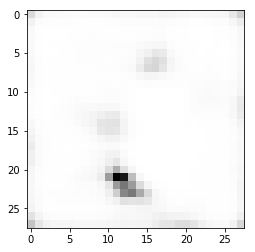

epoch no: 64
index no: 0


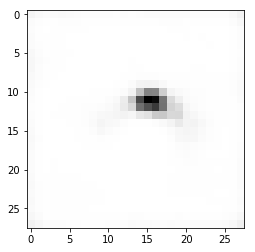

index no: 1


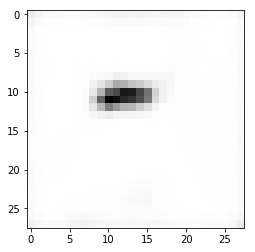

epoch no: 65
index no: 0


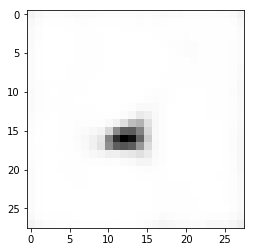

index no: 1


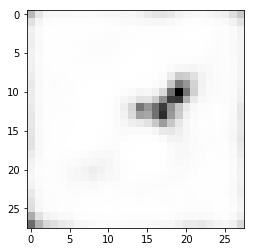

epoch no: 66
index no: 0


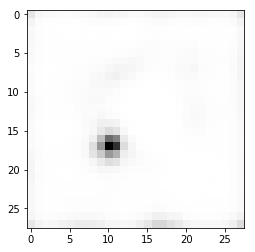

index no: 1


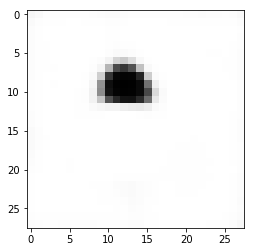

epoch no: 67
index no: 0


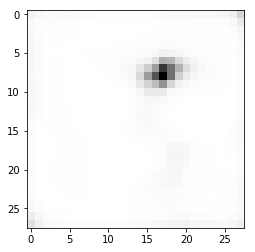

index no: 1


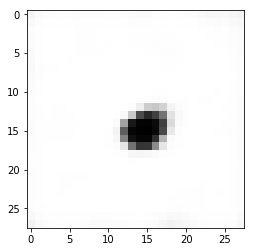

epoch no: 68
index no: 0


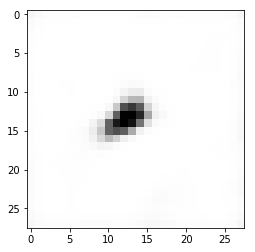

index no: 1


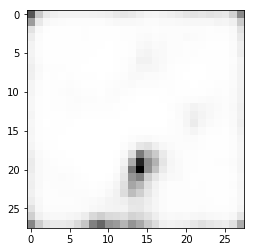

epoch no: 69
index no: 0


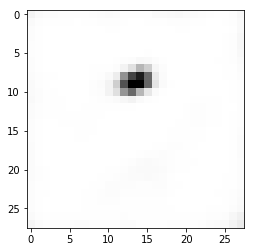

index no: 1


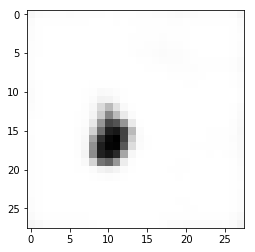

epoch no: 70
index no: 0


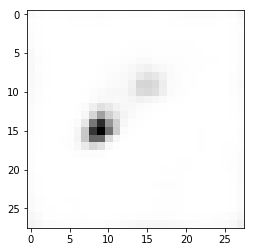

index no: 1


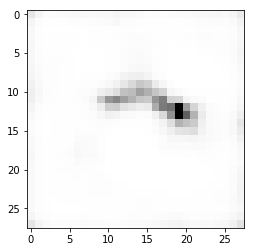

epoch no: 71
index no: 0


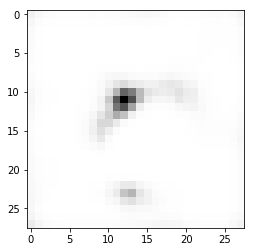

index no: 1


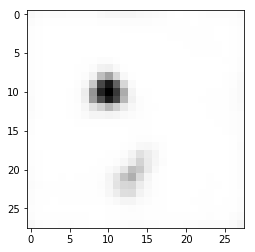

epoch no: 72
index no: 0


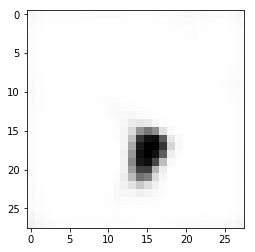

index no: 1


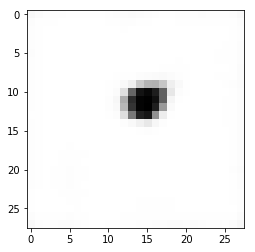

epoch no: 73
index no: 0


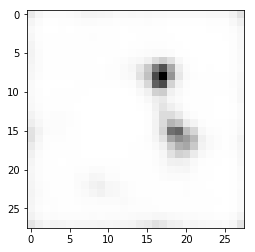

index no: 1


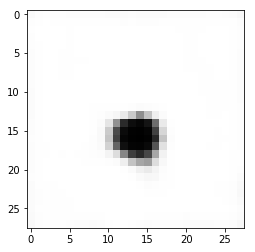

epoch no: 74
index no: 0


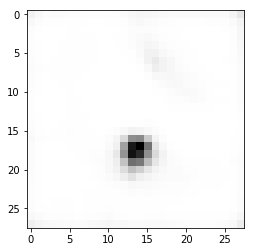

index no: 1


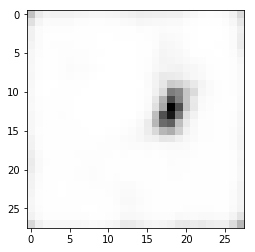

epoch no: 75
index no: 0


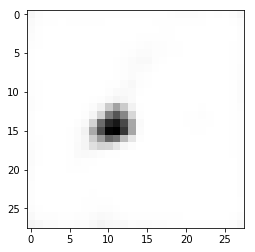

index no: 1


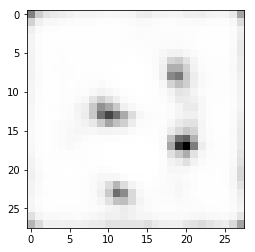

epoch no: 76
index no: 0


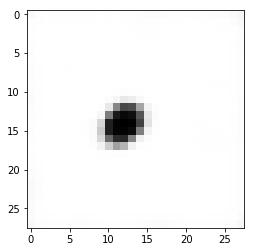

index no: 1


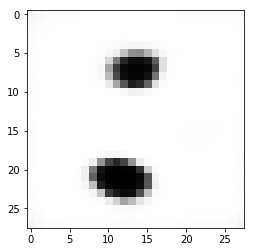

epoch no: 77
index no: 0


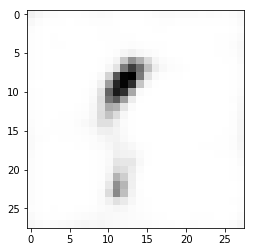

index no: 1


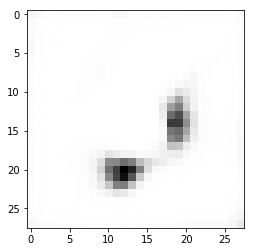

epoch no: 78
index no: 0


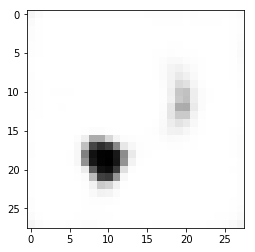

index no: 1


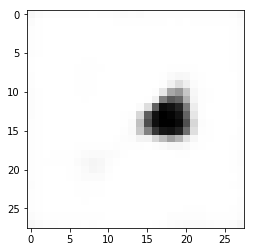

epoch no: 79
index no: 0


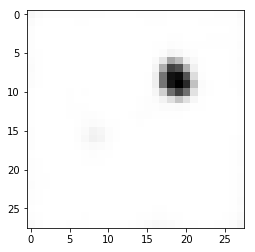

index no: 1


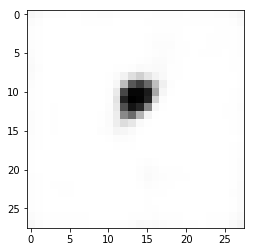

epoch no: 80
index no: 0


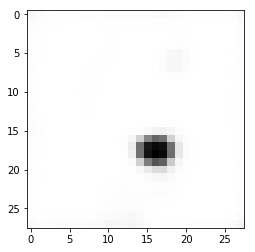

index no: 1


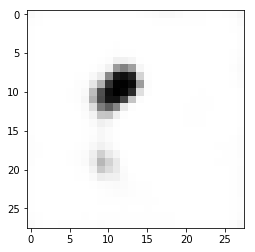

epoch no: 81
index no: 0


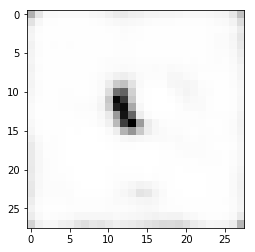

index no: 1


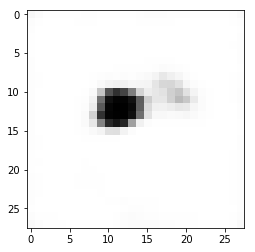

epoch no: 82
index no: 0


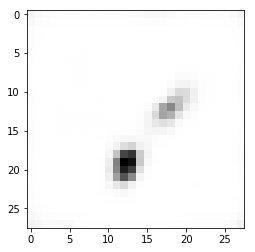

index no: 1


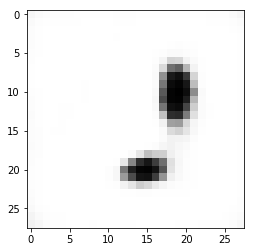

epoch no: 83
index no: 0


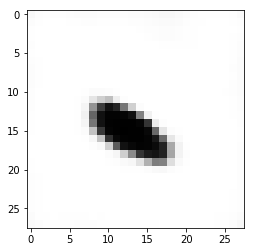

index no: 1


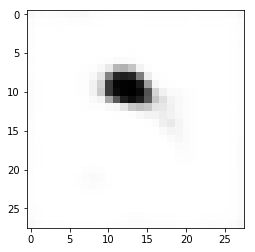

epoch no: 84
index no: 0


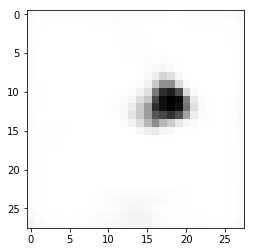

index no: 1


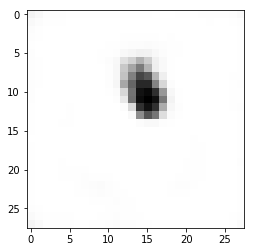

epoch no: 85
index no: 0


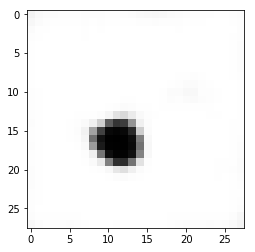

index no: 1


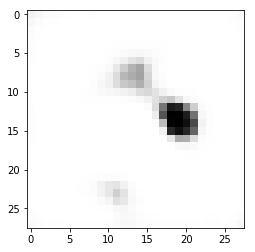

epoch no: 86
index no: 0


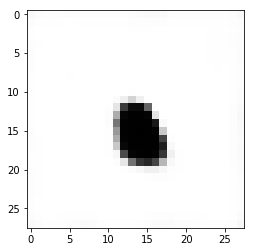

index no: 1


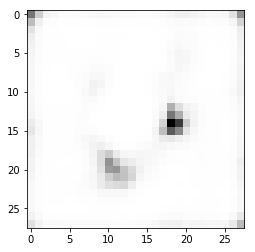

epoch no: 87
index no: 0


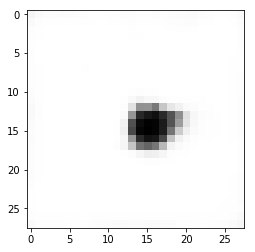

index no: 1


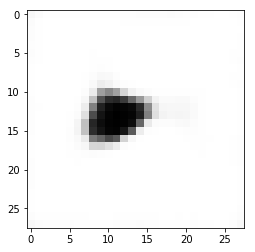

epoch no: 88
index no: 0


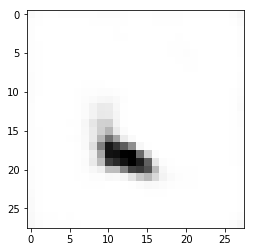

index no: 1


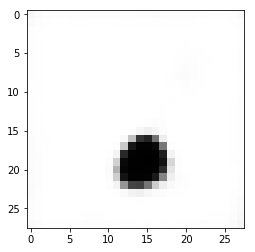

epoch no: 89
index no: 0


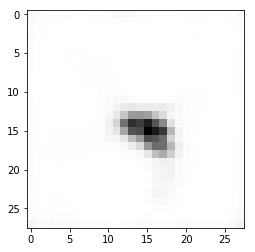

index no: 1


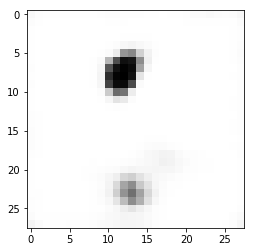

epoch no: 90
index no: 0


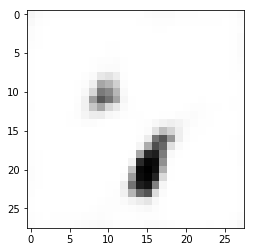

index no: 1


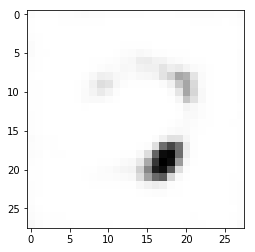

epoch no: 91
index no: 0


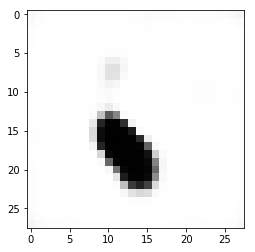

index no: 1


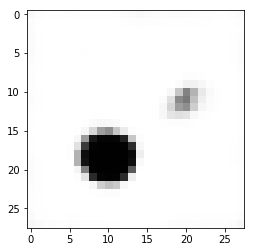

epoch no: 92
index no: 0


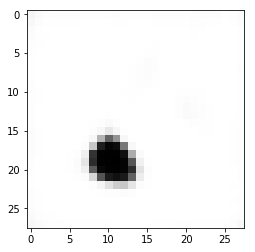

index no: 1


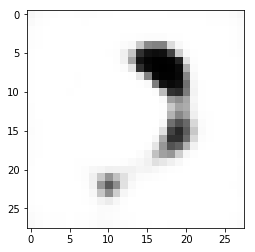

epoch no: 93
index no: 0


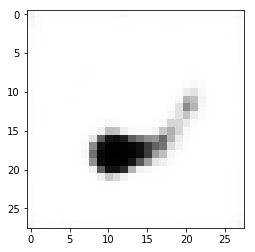

index no: 1


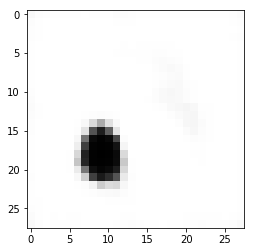

epoch no: 94
index no: 0


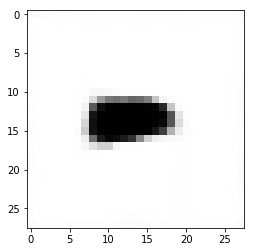

index no: 1


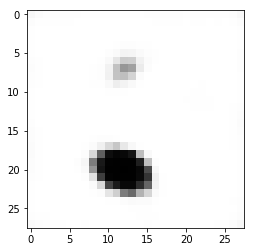

epoch no: 95
index no: 0


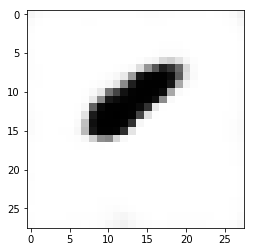

index no: 1


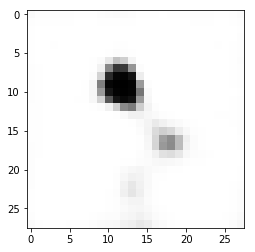

epoch no: 96
index no: 0


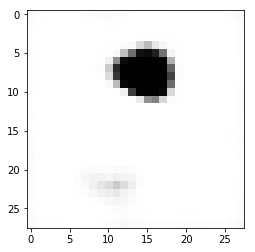

index no: 1


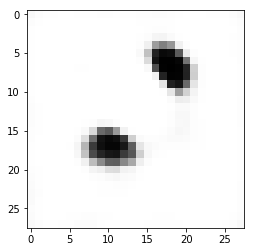

epoch no: 97
index no: 0


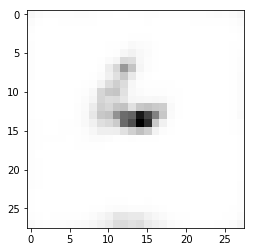

index no: 1


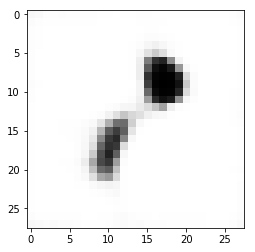

epoch no: 98
index no: 0


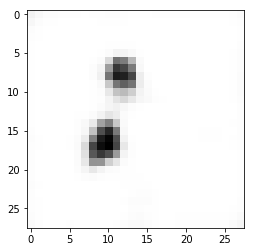

index no: 1


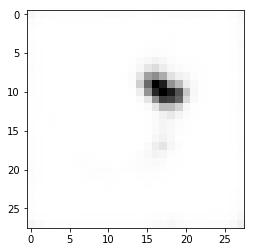

epoch no: 99
index no: 0


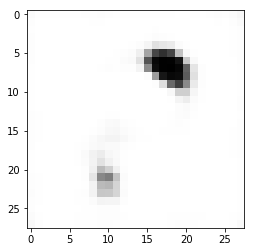

index no: 1


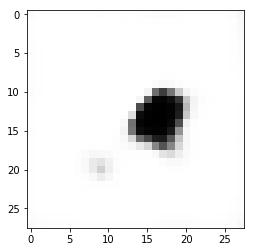

epoch no: 100
index no: 0


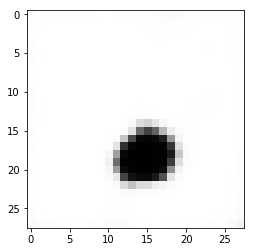

index no: 1


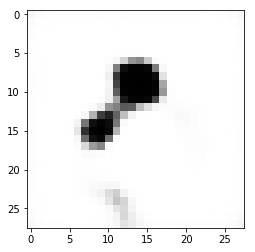

epoch no: 101
index no: 0


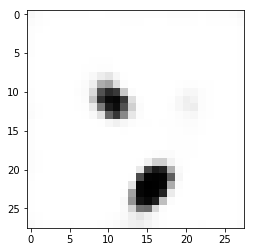

index no: 1


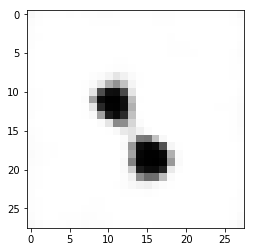

epoch no: 102
index no: 0


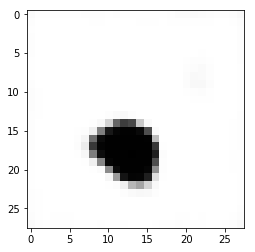

index no: 1


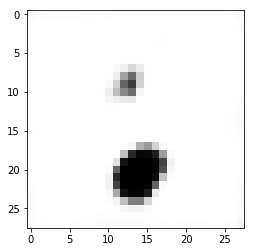

epoch no: 103
index no: 0


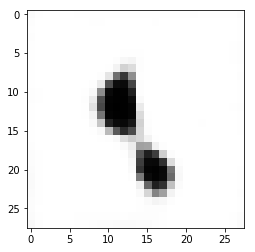

index no: 1


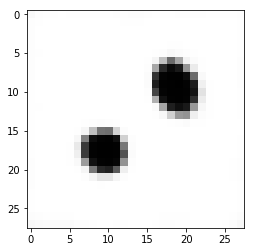

epoch no: 104
index no: 0


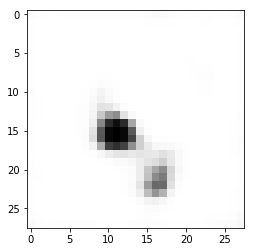

index no: 1


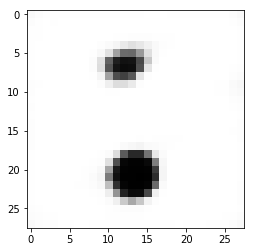

epoch no: 105
index no: 0


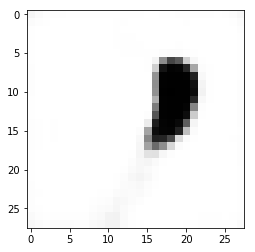

index no: 1


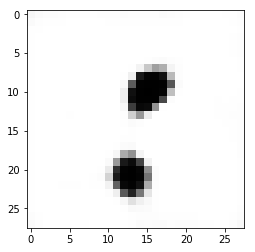

epoch no: 106
index no: 0


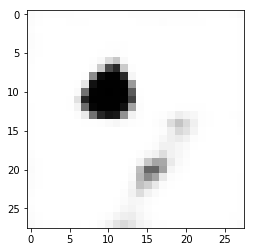

index no: 1


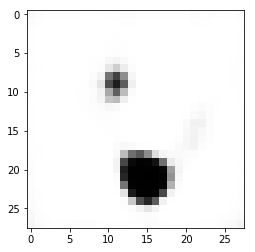

epoch no: 107
index no: 0


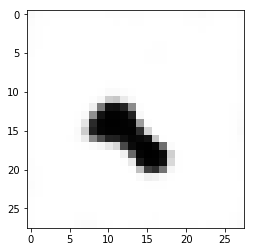

index no: 1


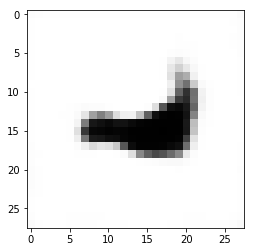

epoch no: 108
index no: 0


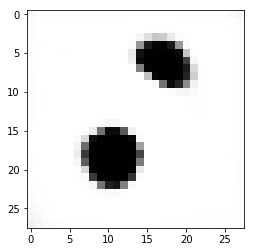

index no: 1


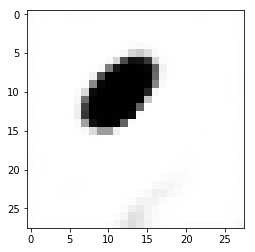

epoch no: 109
index no: 0


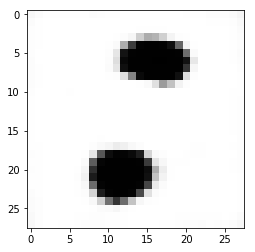

index no: 1


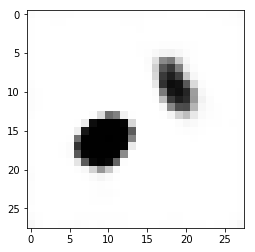

epoch no: 110
index no: 0


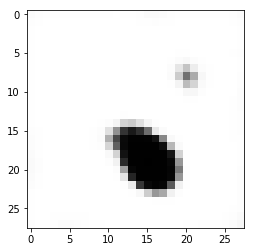

index no: 1


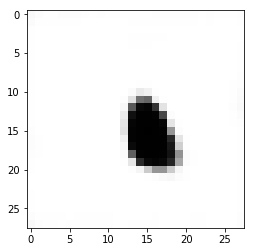

epoch no: 111
index no: 0


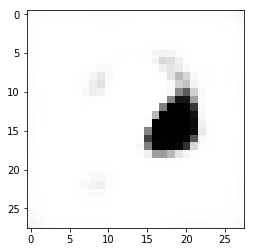

index no: 1


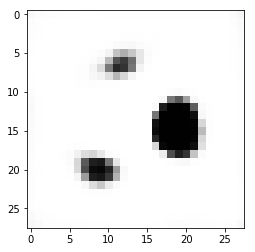

epoch no: 112
index no: 0


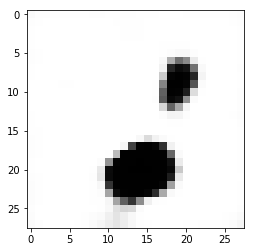

index no: 1


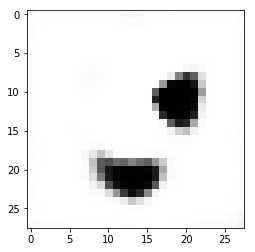

epoch no: 113
index no: 0


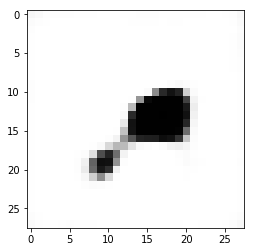

index no: 1


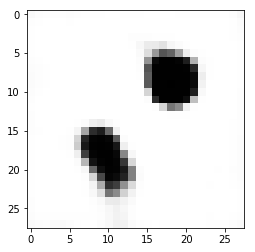

epoch no: 114
index no: 0


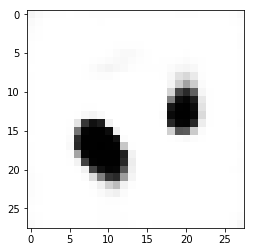

index no: 1


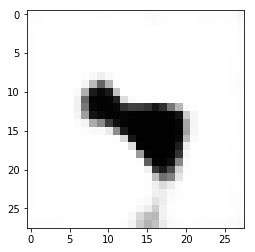

epoch no: 115
index no: 0


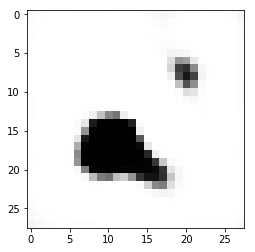

index no: 1


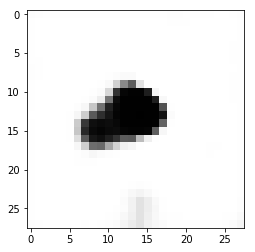

epoch no: 116
index no: 0


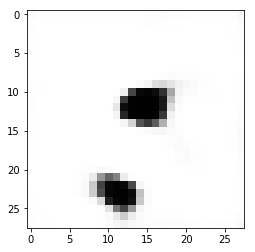

index no: 1


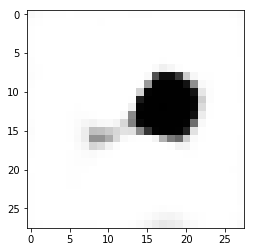

epoch no: 117
index no: 0


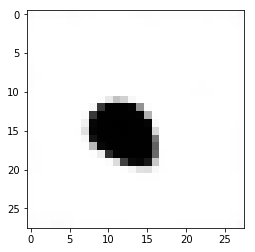

index no: 1


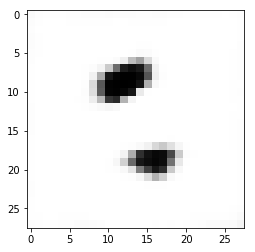

epoch no: 118
index no: 0


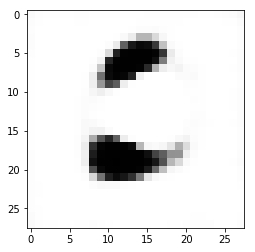

index no: 1


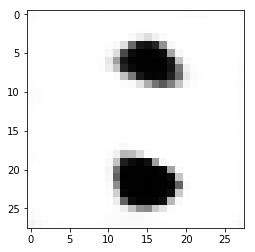

epoch no: 119
index no: 0


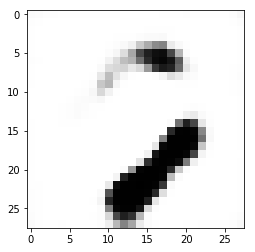

index no: 1


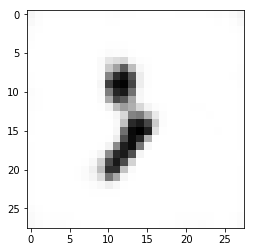

epoch no: 120
index no: 0


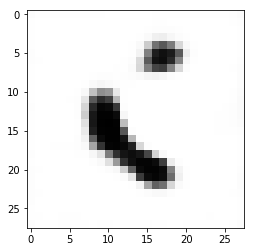

index no: 1


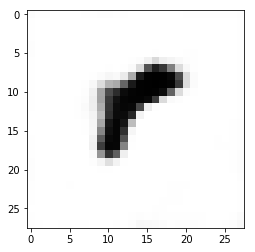

epoch no: 121
index no: 0


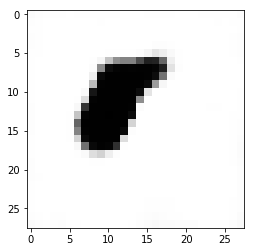

index no: 1


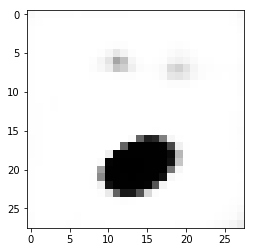

epoch no: 122
index no: 0


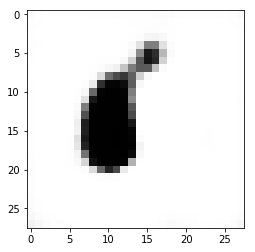

index no: 1


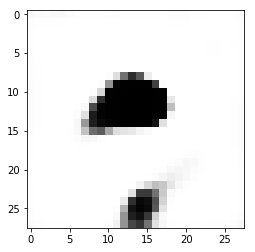

epoch no: 123
index no: 0


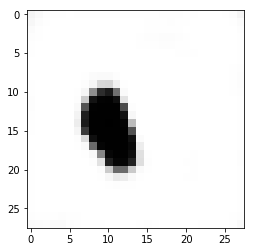

index no: 1


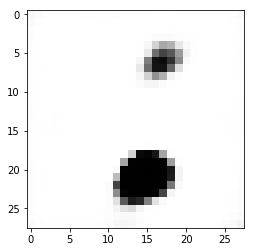

epoch no: 124
index no: 0


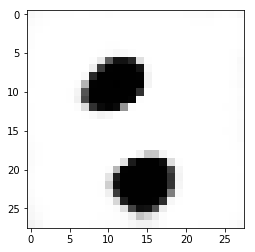

index no: 1


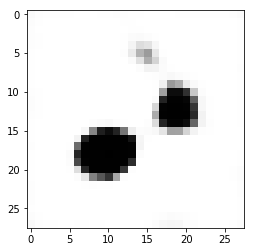

epoch no: 125
index no: 0


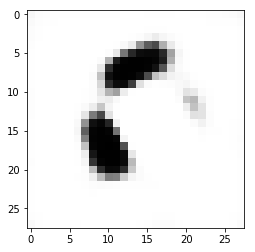

index no: 1


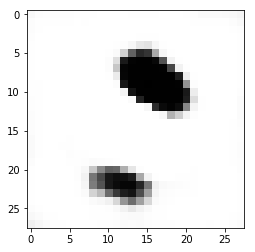

epoch no: 126
index no: 0


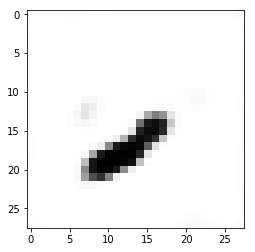

index no: 1


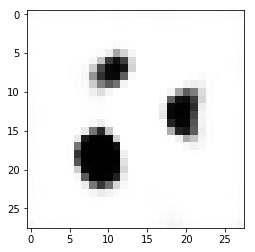

epoch no: 127
index no: 0


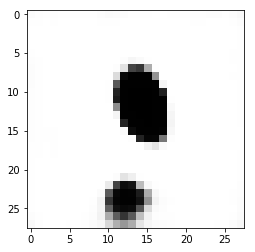

index no: 1


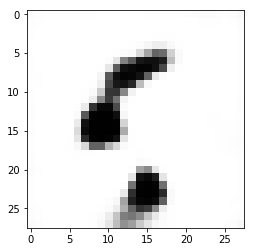

epoch no: 128
index no: 0


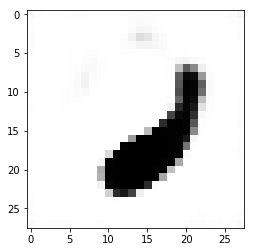

index no: 1


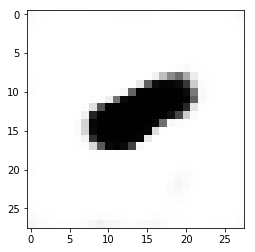

epoch no: 129
index no: 0


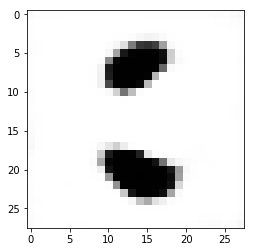

index no: 1


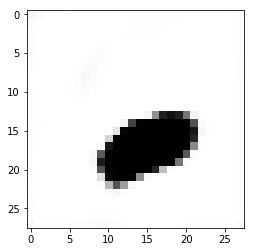

epoch no: 130
index no: 0


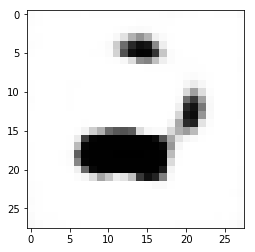

index no: 1


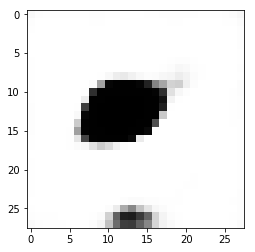

epoch no: 131
index no: 0


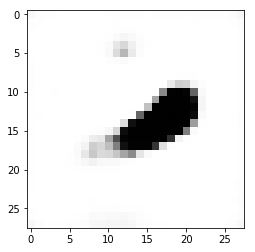

index no: 1


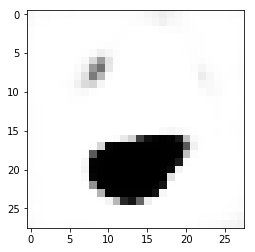

epoch no: 132
index no: 0


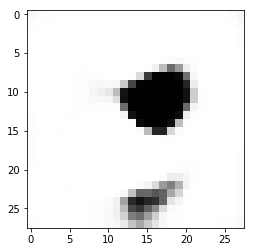

index no: 1


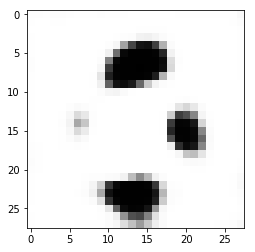

epoch no: 133
index no: 0


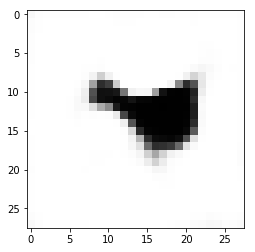

index no: 1


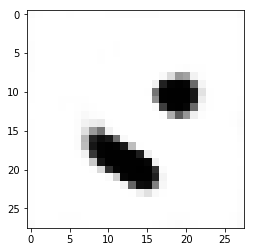

epoch no: 134
index no: 0


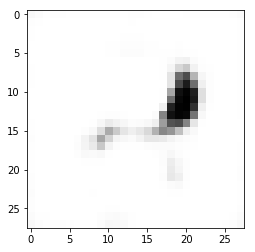

index no: 1


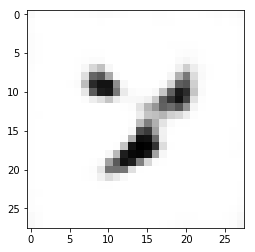

epoch no: 135
index no: 0


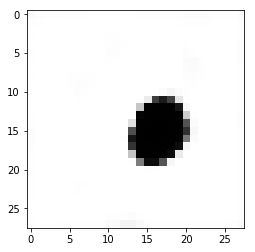

index no: 1


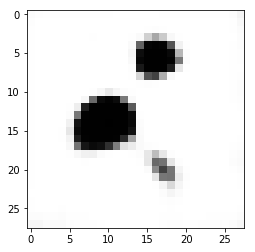

epoch no: 136
index no: 0


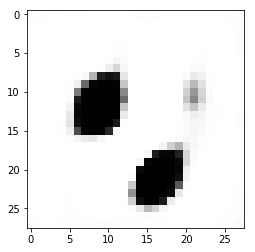

index no: 1


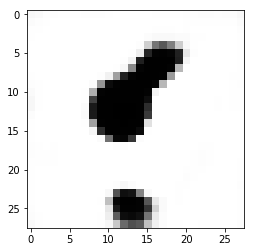

epoch no: 137
index no: 0


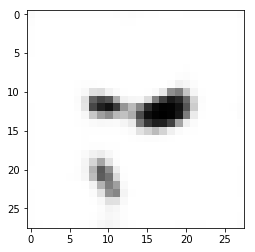

index no: 1


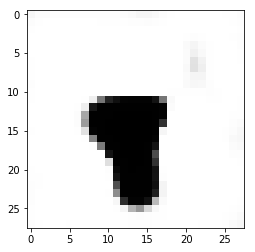

epoch no: 138
index no: 0


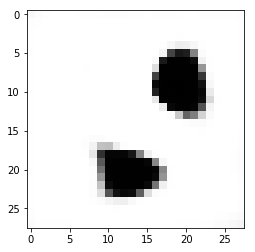

index no: 1


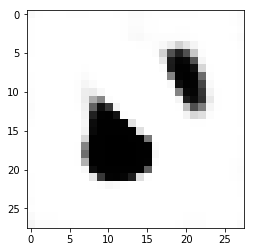

epoch no: 139
index no: 0


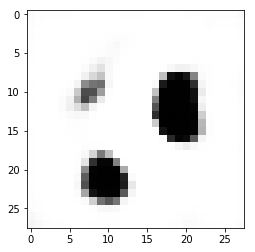

index no: 1


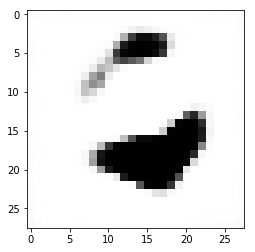

epoch no: 140
index no: 0


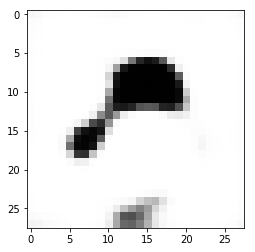

index no: 1


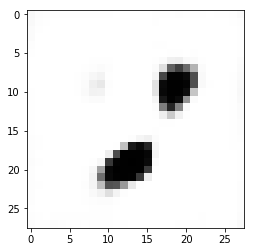

epoch no: 141
index no: 0


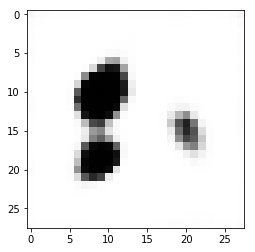

index no: 1


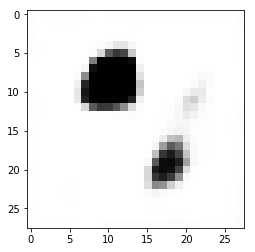

epoch no: 142
index no: 0


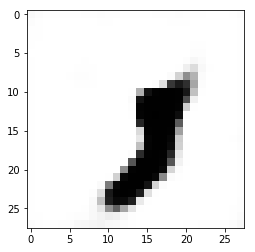

index no: 1


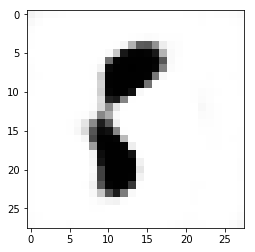

epoch no: 143
index no: 0


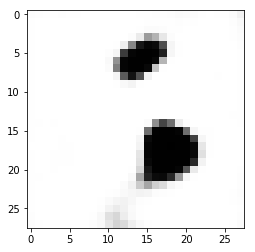

index no: 1


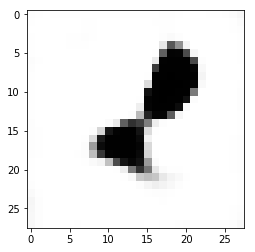

epoch no: 144
index no: 0


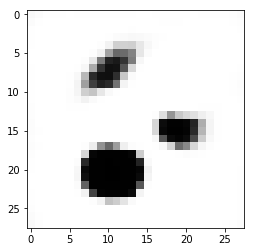

index no: 1


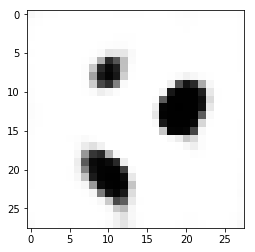

epoch no: 145
index no: 0


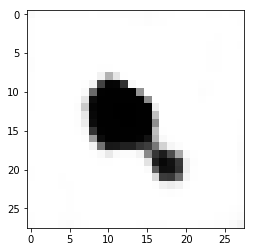

index no: 1


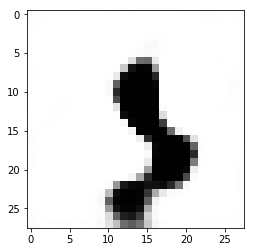

epoch no: 146
index no: 0


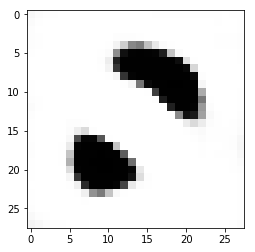

index no: 1


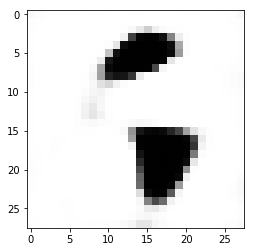

epoch no: 147
index no: 0


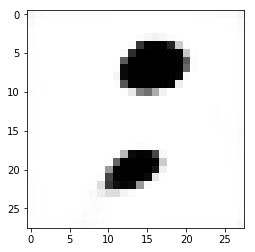

index no: 1


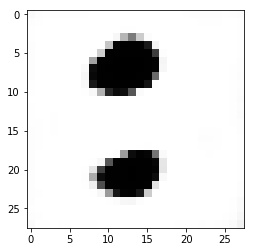

epoch no: 148
index no: 0


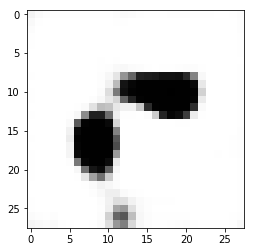

index no: 1


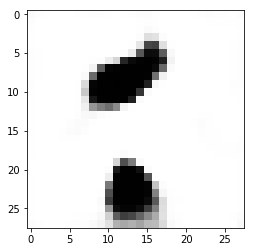

epoch no: 149
index no: 0


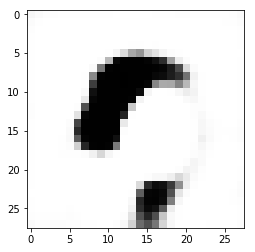

index no: 1


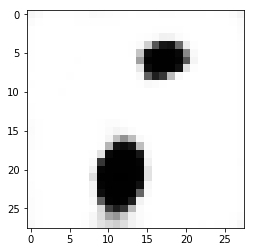

epoch no: 150
index no: 0


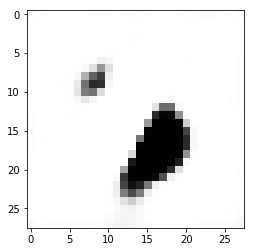

index no: 1


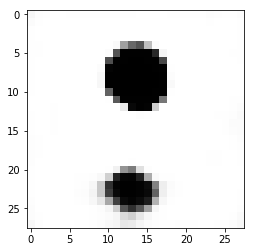

epoch no: 151
index no: 0


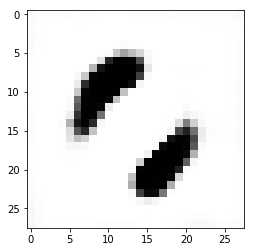

index no: 1


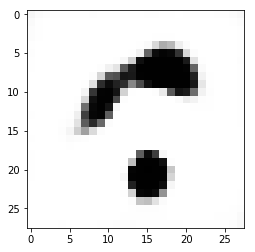

epoch no: 152
index no: 0


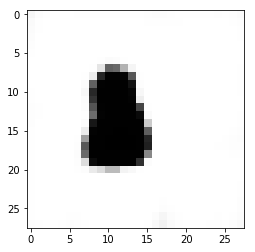

index no: 1


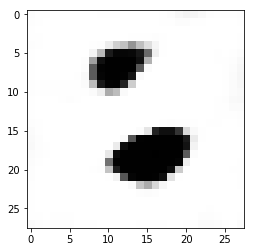

epoch no: 153
index no: 0


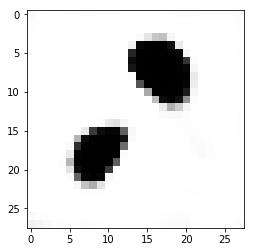

index no: 1


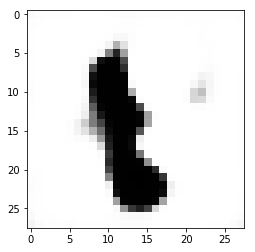

epoch no: 154
index no: 0


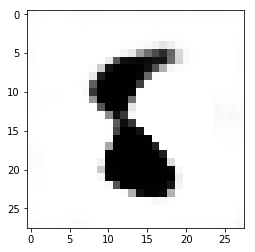

index no: 1


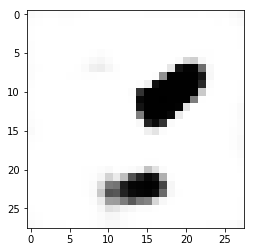

epoch no: 155
index no: 0


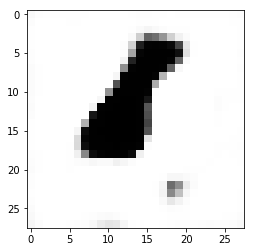

index no: 1


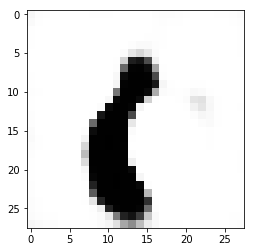

epoch no: 156
index no: 0


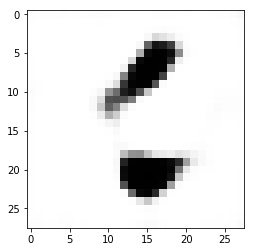

index no: 1


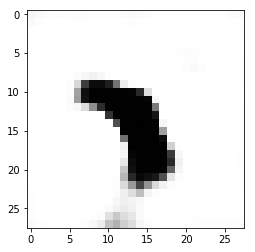

epoch no: 157
index no: 0


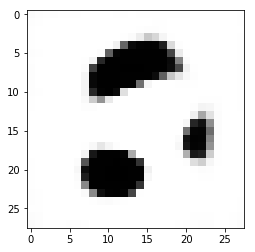

index no: 1


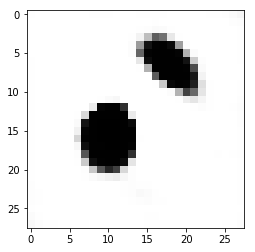

epoch no: 158
index no: 0


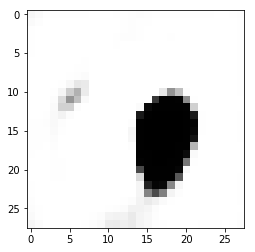

index no: 1


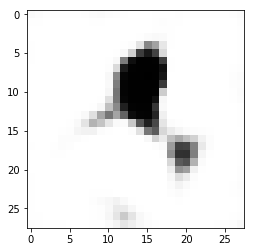

epoch no: 159
index no: 0


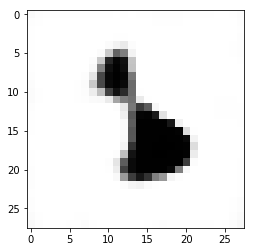

index no: 1


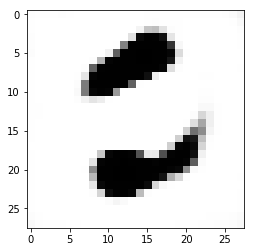

epoch no: 160
index no: 0


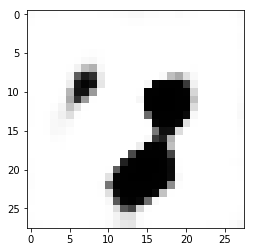

index no: 1


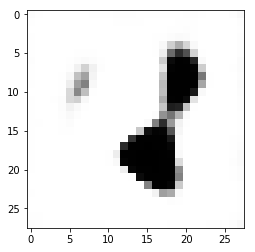

epoch no: 161
index no: 0


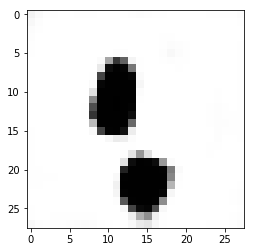

index no: 1


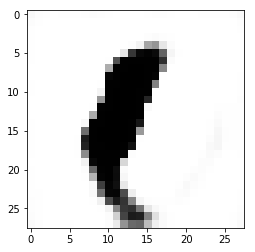

epoch no: 162
index no: 0


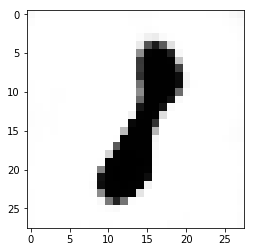

index no: 1


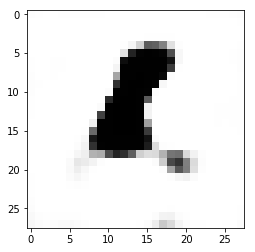

epoch no: 163
index no: 0


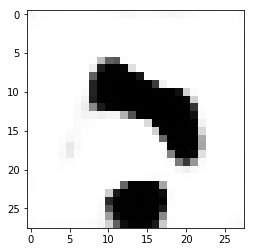

index no: 1


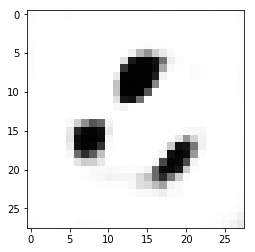

epoch no: 164
index no: 0


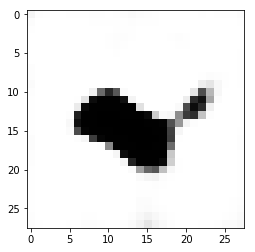

index no: 1


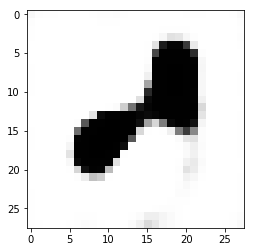

epoch no: 165
index no: 0


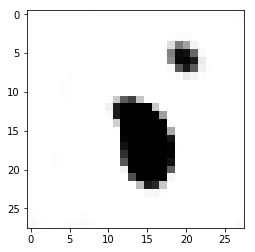

index no: 1


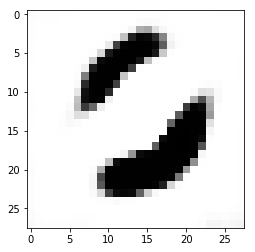

epoch no: 166
index no: 0


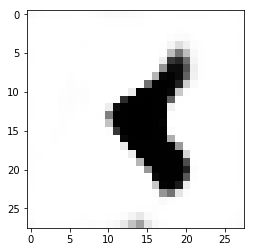

index no: 1


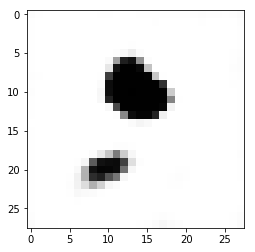

epoch no: 167
index no: 0


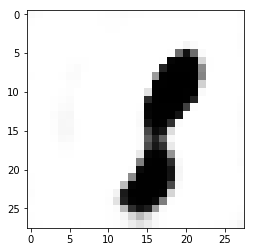

index no: 1


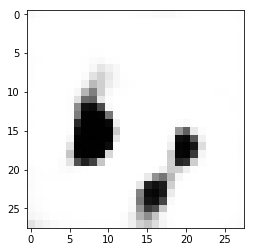

epoch no: 168
index no: 0


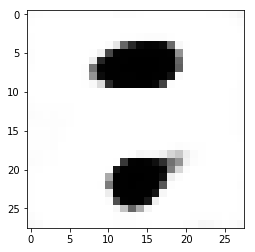

index no: 1


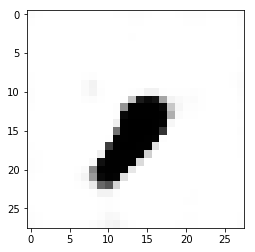

epoch no: 169
index no: 0


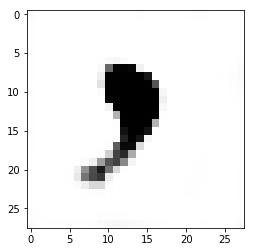

index no: 1


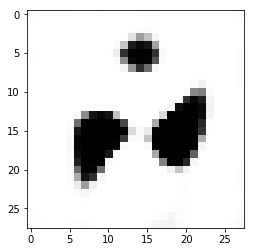

epoch no: 170
index no: 0


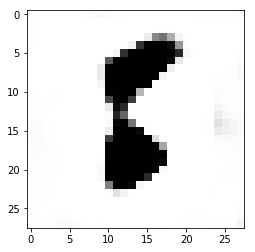

index no: 1


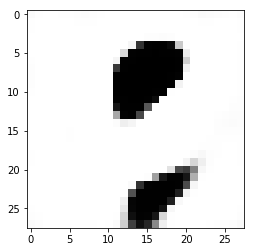

epoch no: 171
index no: 0


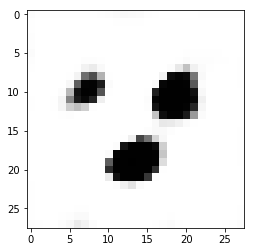

index no: 1


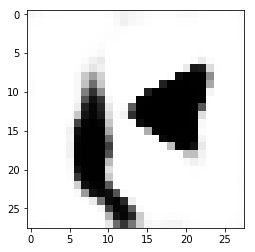

epoch no: 172
index no: 0


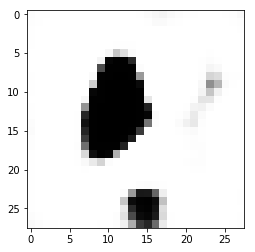

index no: 1


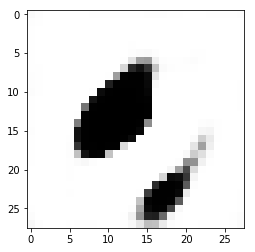

epoch no: 173
index no: 0


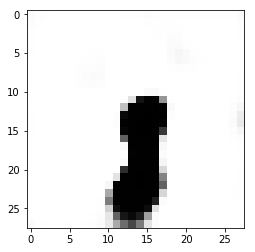

index no: 1


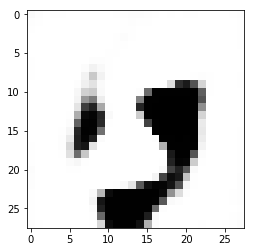

epoch no: 174
index no: 0


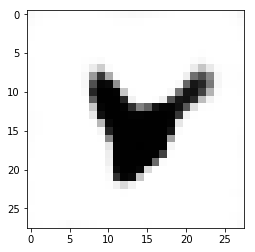

index no: 1


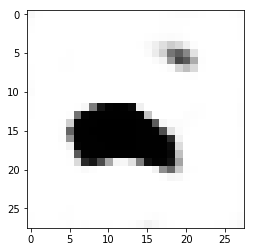

epoch no: 175
index no: 0


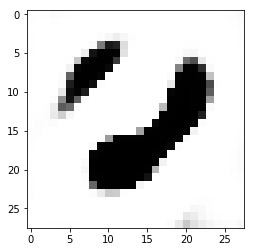

index no: 1


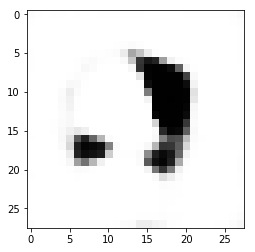

epoch no: 176
index no: 0


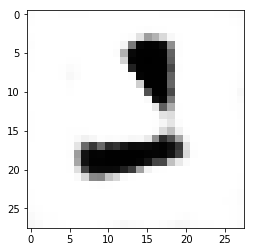

index no: 1


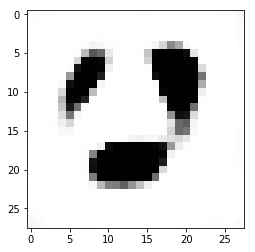

epoch no: 177
index no: 0


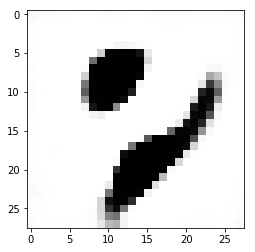

index no: 1


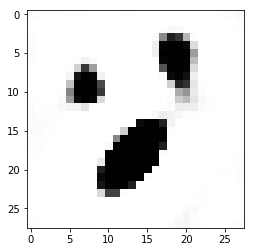

epoch no: 178
index no: 0


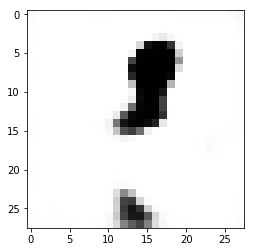

index no: 1


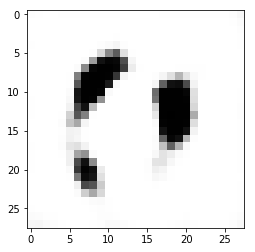

epoch no: 179
index no: 0


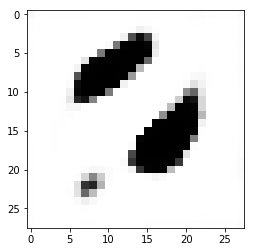

index no: 1


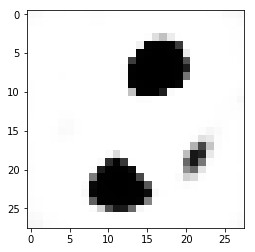

epoch no: 180
index no: 0


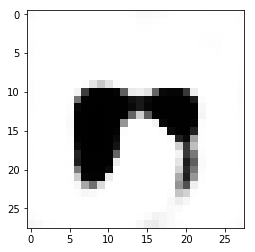

index no: 1


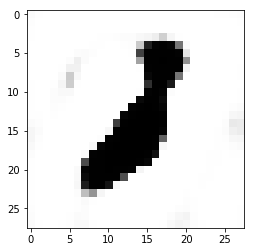

epoch no: 181
index no: 0


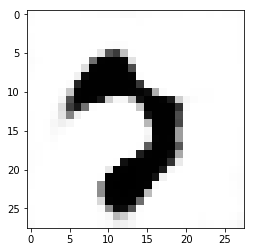

index no: 1


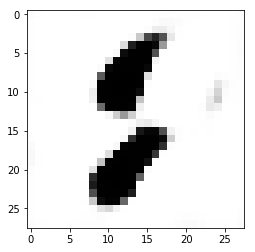

epoch no: 182
index no: 0


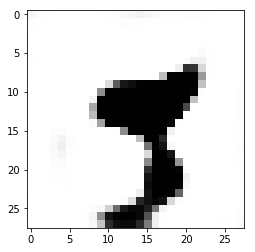

index no: 1


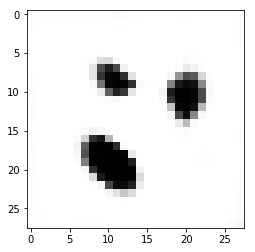

epoch no: 183
index no: 0


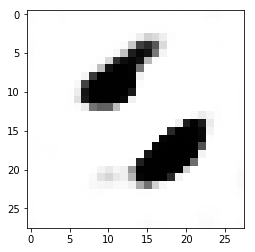

index no: 1


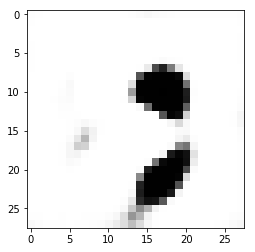

epoch no: 184
index no: 0


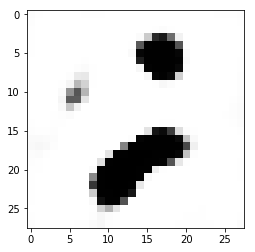

index no: 1


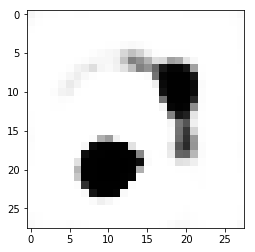

epoch no: 185
index no: 0


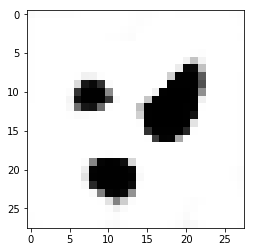

index no: 1


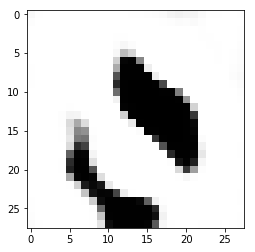

epoch no: 186
index no: 0


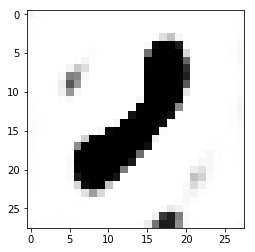

index no: 1


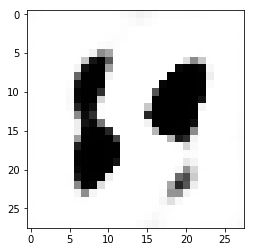

epoch no: 187
index no: 0


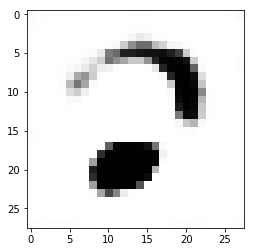

index no: 1


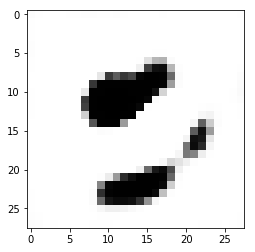

epoch no: 188
index no: 0


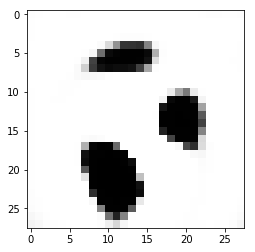

index no: 1


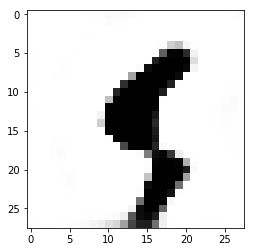

epoch no: 189
index no: 0


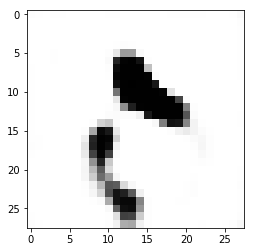

index no: 1


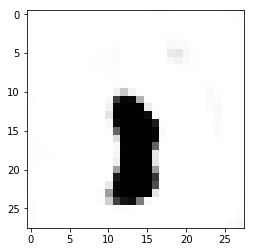

epoch no: 190
index no: 0


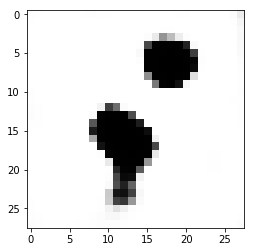

index no: 1


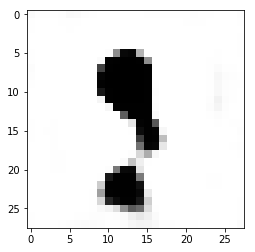

epoch no: 191
index no: 0


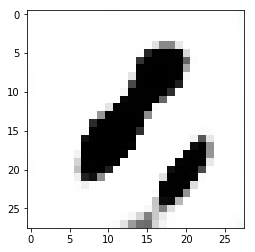

index no: 1


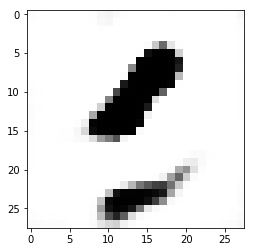

epoch no: 192
index no: 0


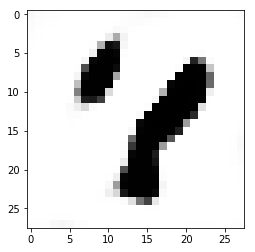

index no: 1


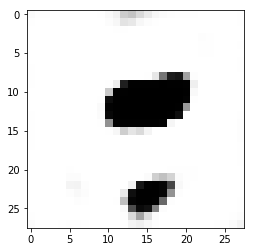

epoch no: 193
index no: 0


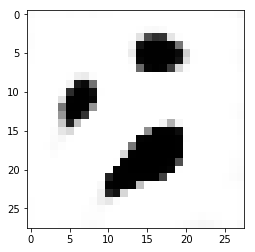

index no: 1


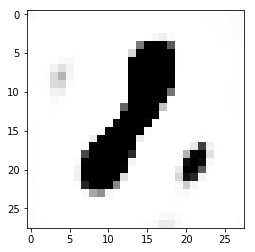

epoch no: 194
index no: 0


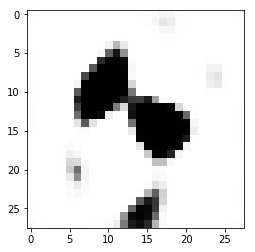

index no: 1


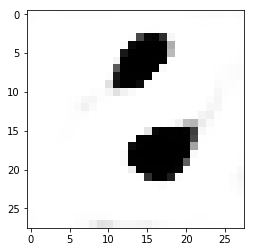

epoch no: 195
index no: 0


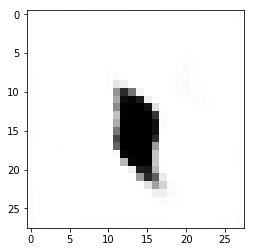

index no: 1


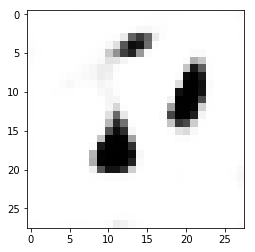

epoch no: 196
index no: 0


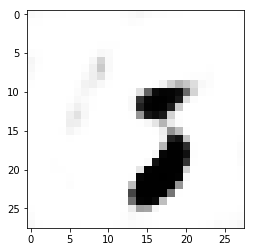

index no: 1


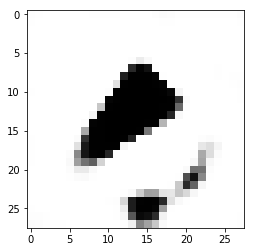

epoch no: 197
index no: 0


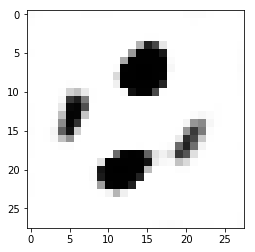

index no: 1


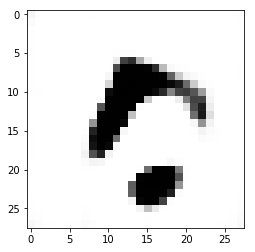

epoch no: 198
index no: 0


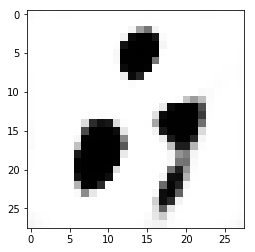

index no: 1


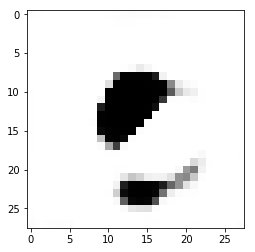

epoch no: 199
index no: 0


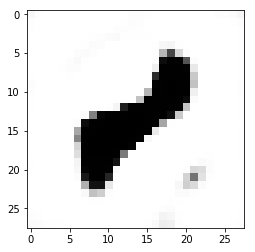

index no: 1


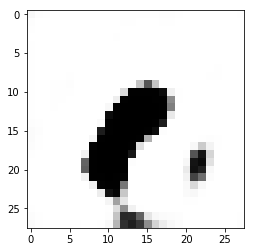

epoch no: 200
index no: 0


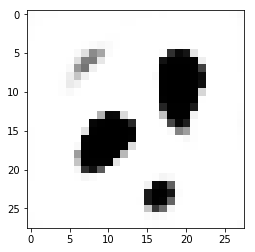

index no: 1


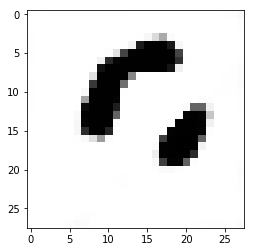

epoch no: 201
index no: 0


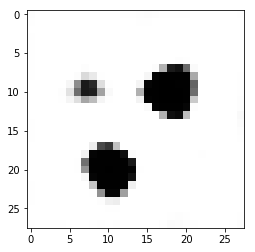

index no: 1


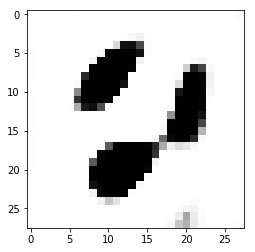

epoch no: 202
index no: 0


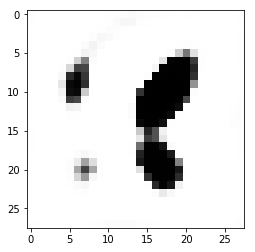

index no: 1


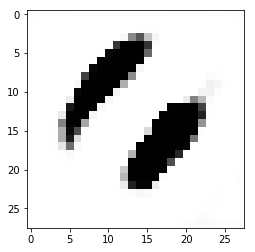

epoch no: 203
index no: 0


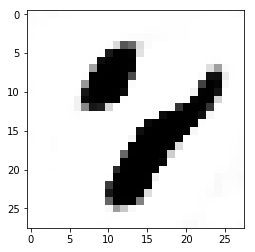

index no: 1


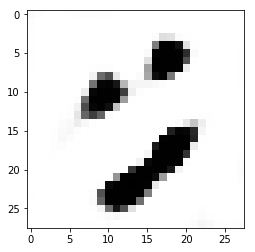

epoch no: 204
index no: 0


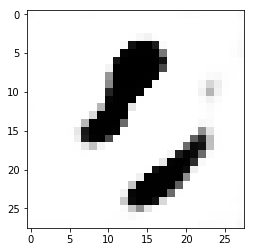

index no: 1


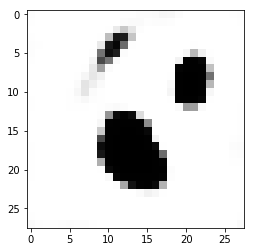

epoch no: 205
index no: 0


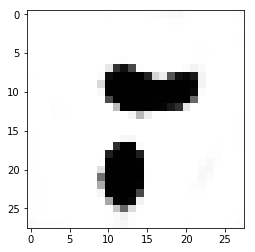

index no: 1


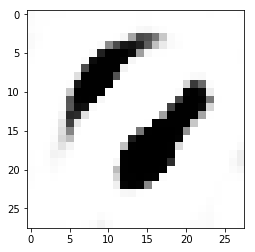

epoch no: 206
index no: 0


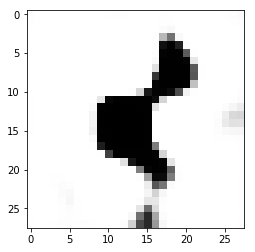

index no: 1


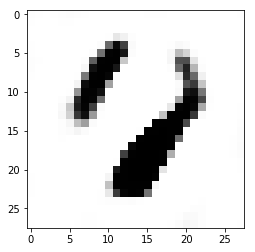

epoch no: 207
index no: 0


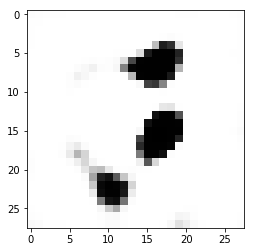

index no: 1


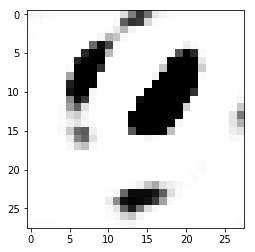

epoch no: 208
index no: 0


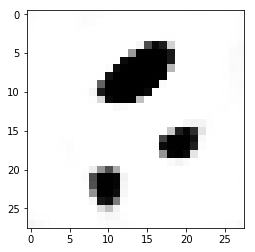

index no: 1


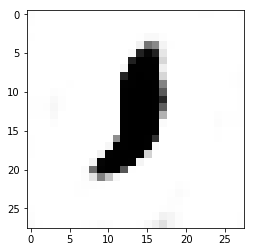

epoch no: 209
index no: 0


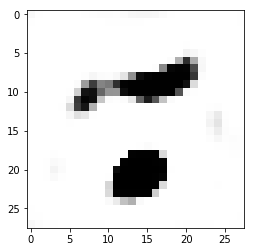

index no: 1


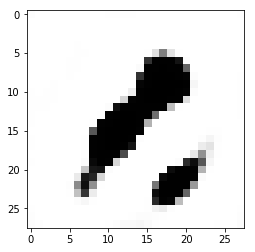

epoch no: 210
index no: 0


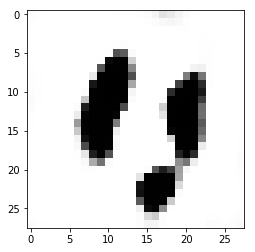

index no: 1


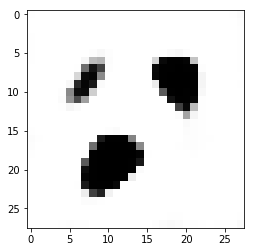

epoch no: 211
index no: 0


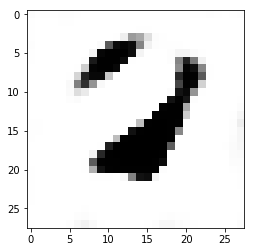

index no: 1


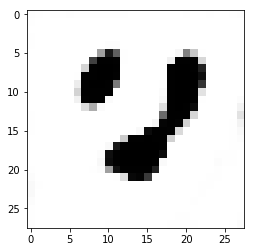

epoch no: 212
index no: 0


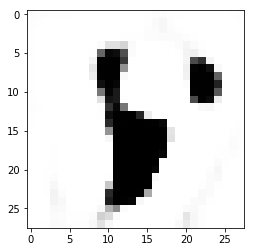

index no: 1


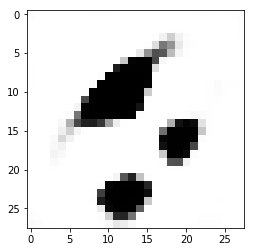

epoch no: 213
index no: 0


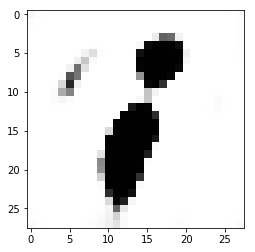

index no: 1


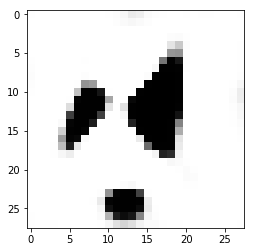

epoch no: 214
index no: 0


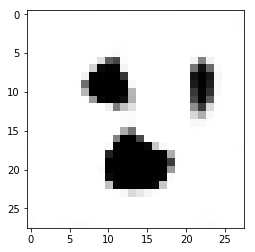

index no: 1


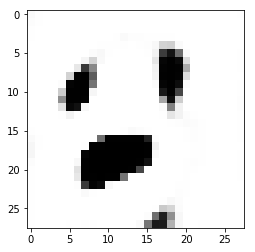

epoch no: 215
index no: 0


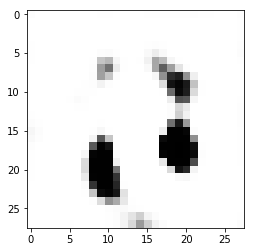

index no: 1


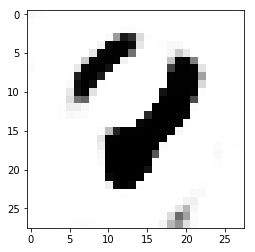

epoch no: 216
index no: 0


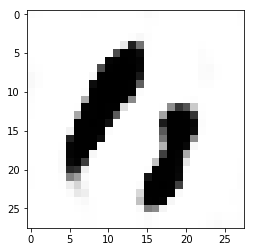

index no: 1


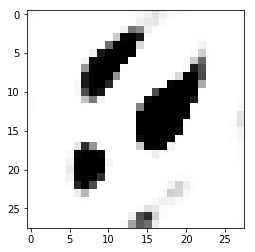

epoch no: 217
index no: 0


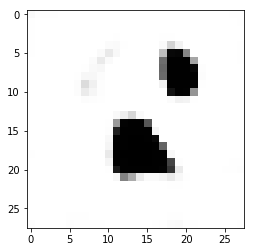

index no: 1


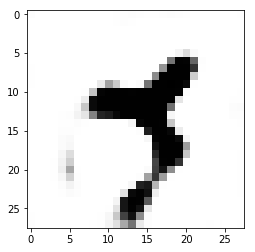

epoch no: 218
index no: 0


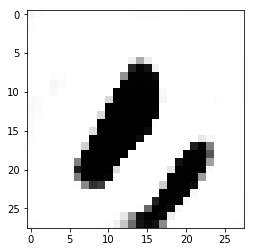

index no: 1


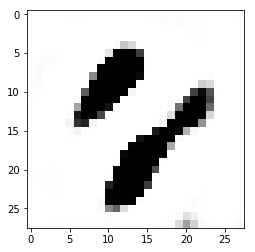

epoch no: 219
index no: 0


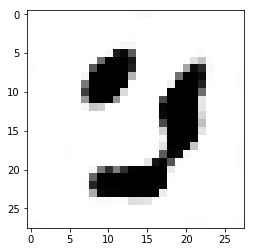

index no: 1


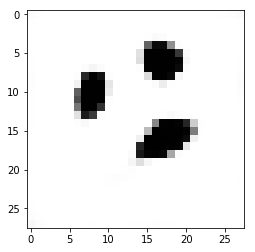

epoch no: 220
index no: 0


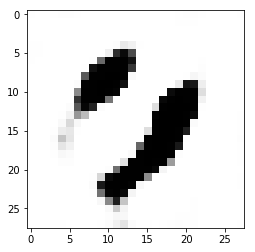

index no: 1


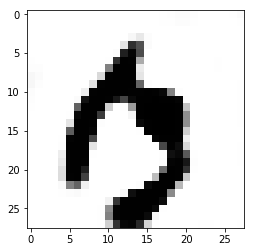

epoch no: 221
index no: 0


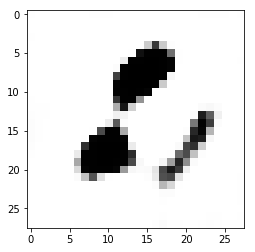

index no: 1


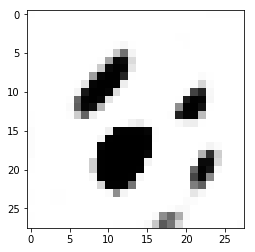

epoch no: 222
index no: 0


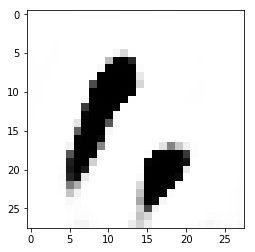

index no: 1


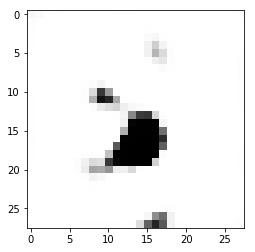

epoch no: 223
index no: 0


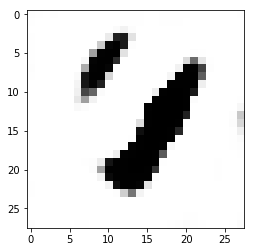

index no: 1


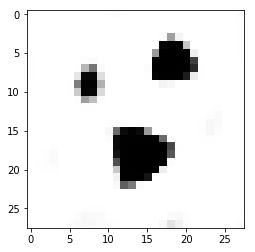

epoch no: 224
index no: 0


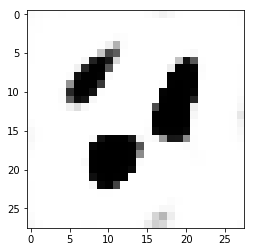

index no: 1


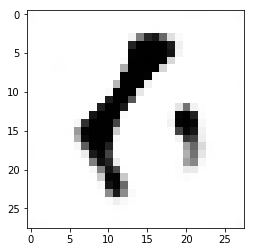

epoch no: 225
index no: 0


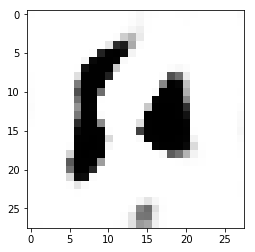

index no: 1


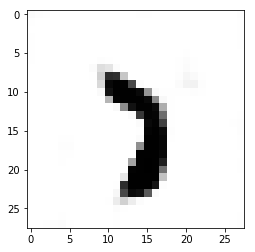

epoch no: 226
index no: 0


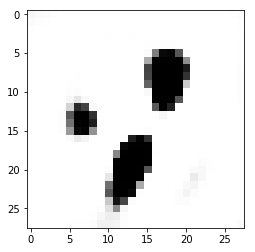

index no: 1


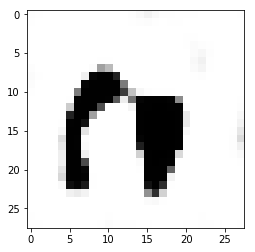

epoch no: 227
index no: 0


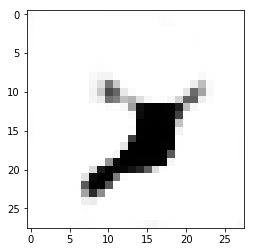

index no: 1


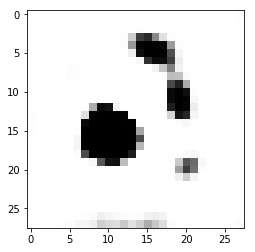

epoch no: 228
index no: 0


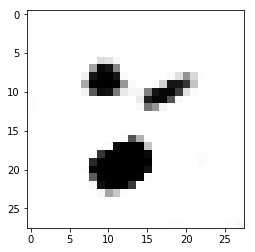

index no: 1


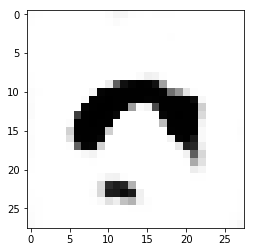

epoch no: 229
index no: 0


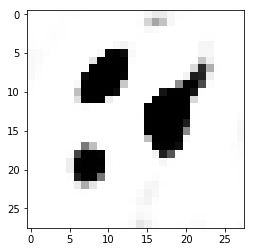

index no: 1


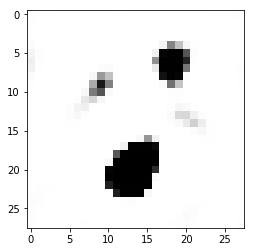

epoch no: 230
index no: 0


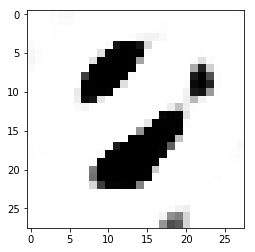

index no: 1


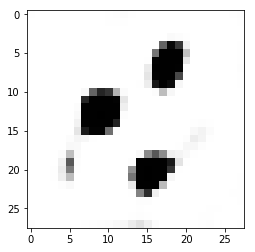

epoch no: 231
index no: 0


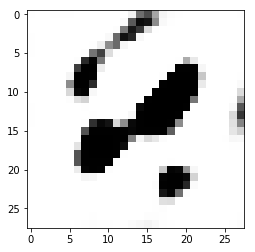

index no: 1


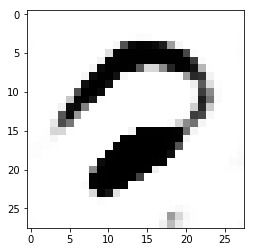

epoch no: 232
index no: 0


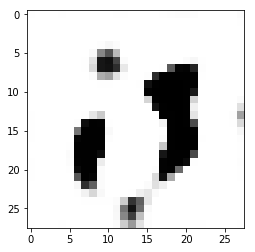

index no: 1


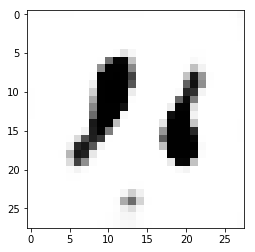

epoch no: 233
index no: 0


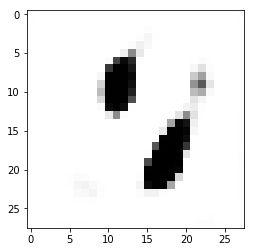

index no: 1


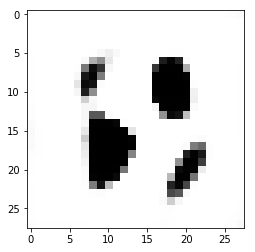

epoch no: 234
index no: 0


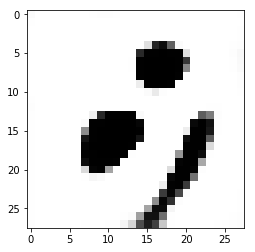

index no: 1


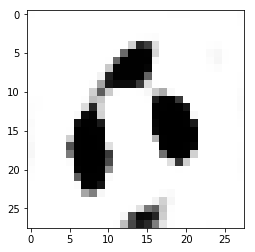

epoch no: 235
index no: 0


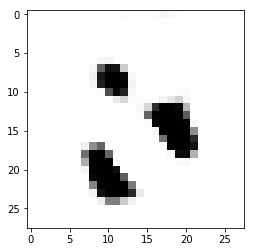

index no: 1


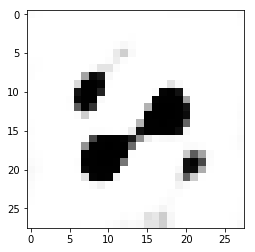

epoch no: 236
index no: 0


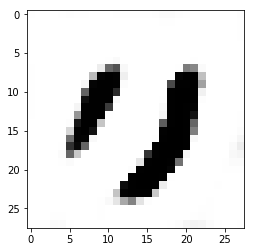

index no: 1


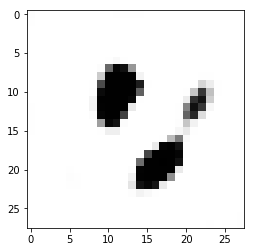

epoch no: 237
index no: 0


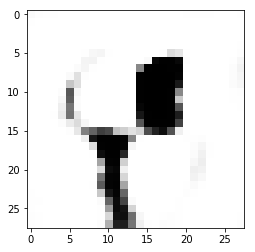

index no: 1


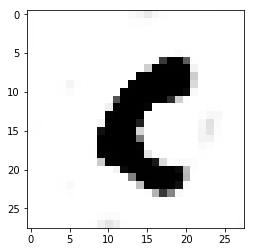

epoch no: 238
index no: 0


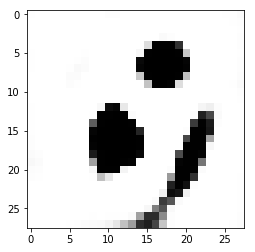

index no: 1


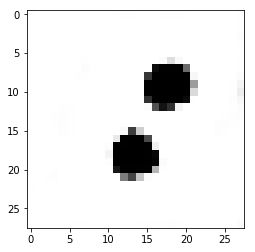

epoch no: 239
index no: 0


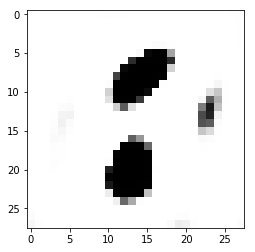

index no: 1


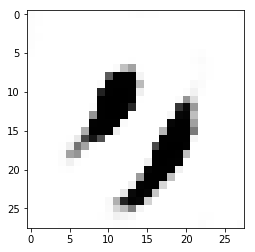

epoch no: 240
index no: 0


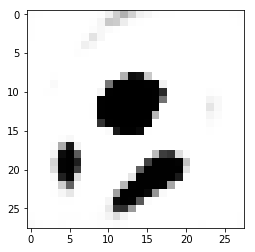

index no: 1


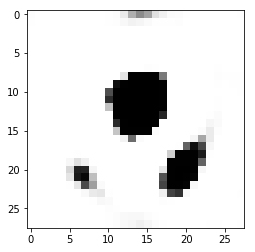

epoch no: 241
index no: 0


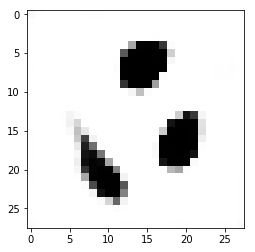

index no: 1


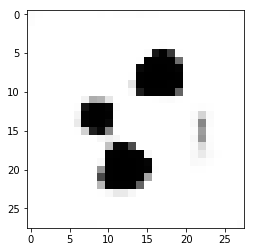

epoch no: 242
index no: 0


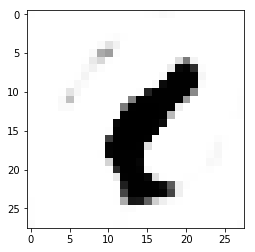

index no: 1


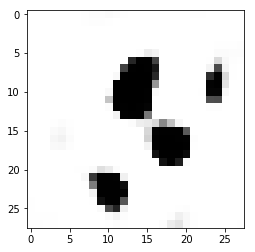

epoch no: 243
index no: 0


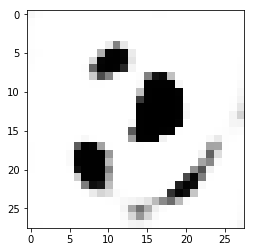

index no: 1


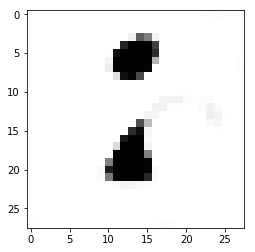

epoch no: 244
index no: 0


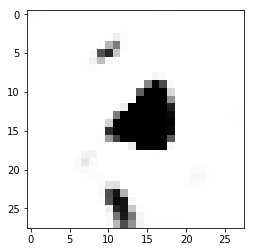

index no: 1


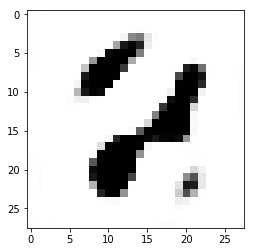

epoch no: 245
index no: 0


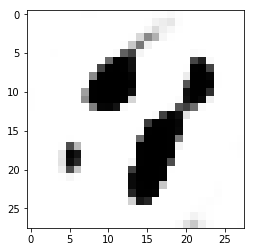

index no: 1


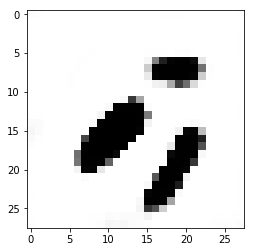

epoch no: 246
index no: 0


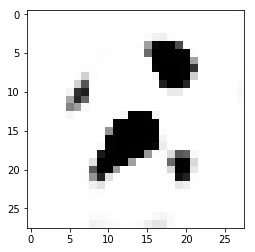

index no: 1


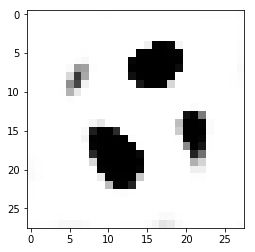

epoch no: 247
index no: 0


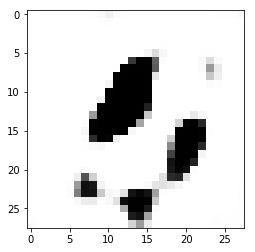

index no: 1


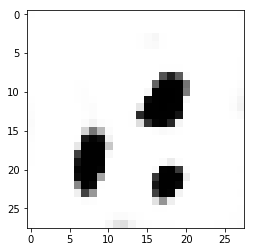

epoch no: 248
index no: 0


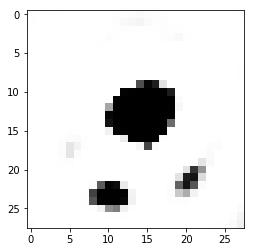

index no: 1


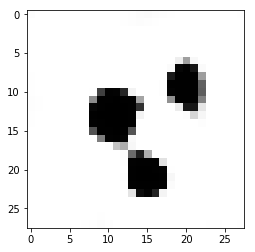

epoch no: 249
index no: 0


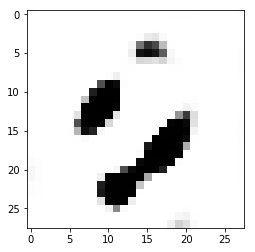

index no: 1


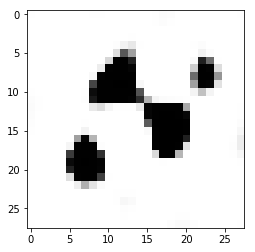

epoch no: 250
index no: 0


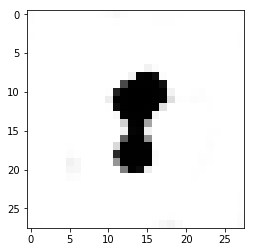

index no: 1


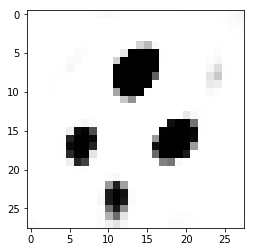

epoch no: 251
index no: 0


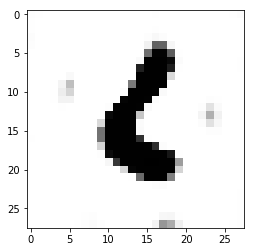

index no: 1


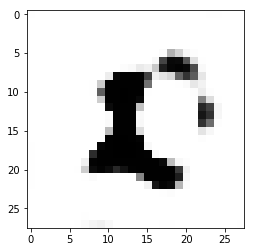

epoch no: 252
index no: 0


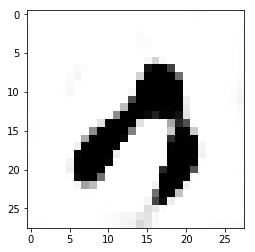

index no: 1


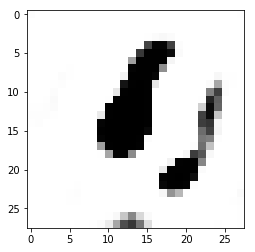

epoch no: 253
index no: 0


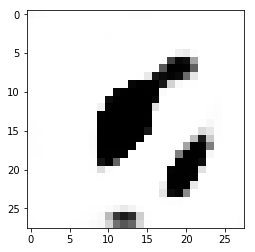

index no: 1


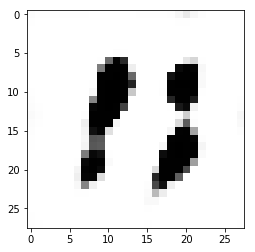

epoch no: 254
index no: 0


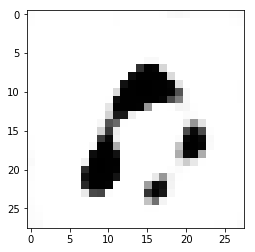

index no: 1


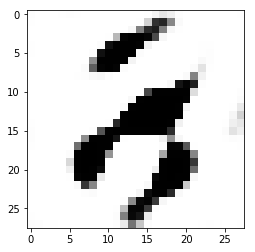

epoch no: 255
index no: 0


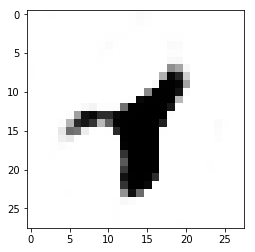

index no: 1


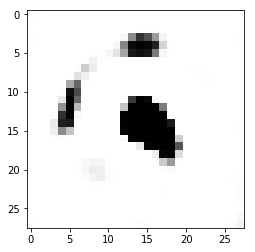

epoch no: 256
index no: 0


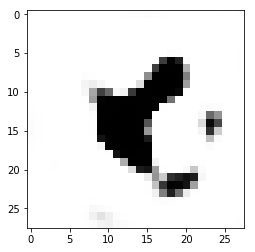

index no: 1


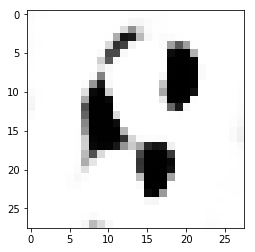

epoch no: 257
index no: 0


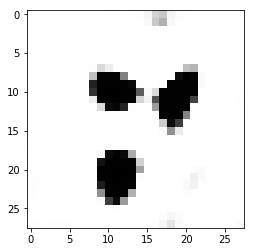

index no: 1


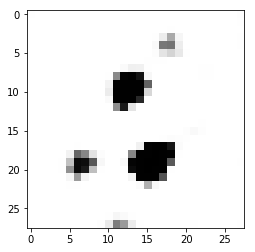

epoch no: 258
index no: 0


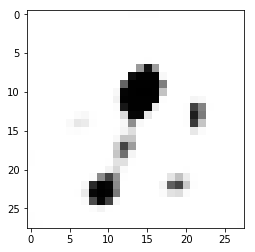

index no: 1


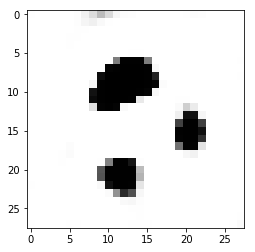

epoch no: 259
index no: 0


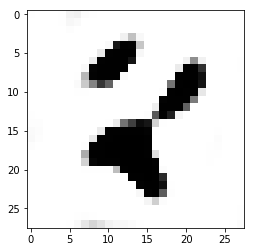

index no: 1


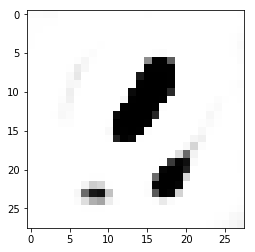

epoch no: 260
index no: 0


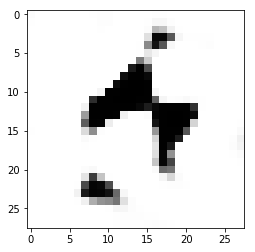

index no: 1


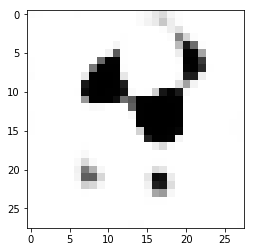

epoch no: 261
index no: 0


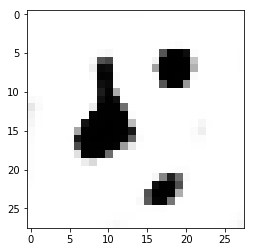

index no: 1


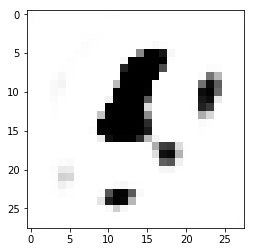

epoch no: 262
index no: 0


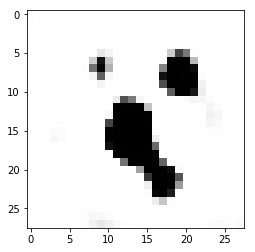

index no: 1


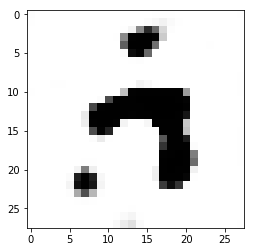

epoch no: 263
index no: 0


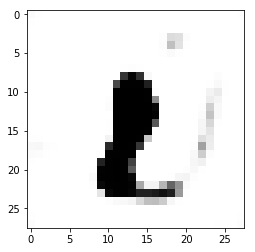

index no: 1


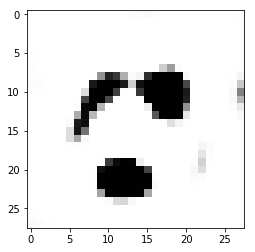

epoch no: 264
index no: 0


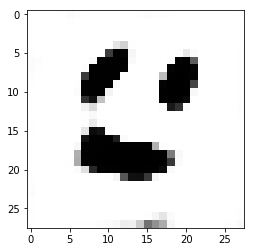

index no: 1


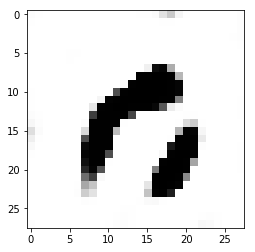

epoch no: 265
index no: 0


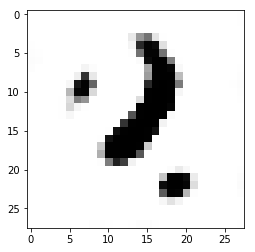

index no: 1


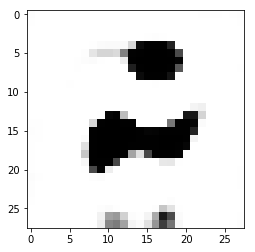

epoch no: 266
index no: 0


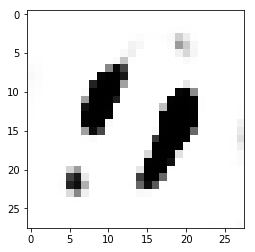

index no: 1


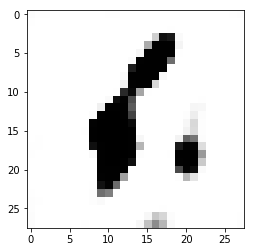

epoch no: 267
index no: 0


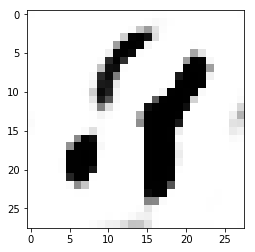

index no: 1


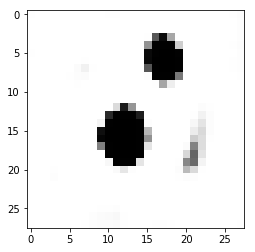

epoch no: 268
index no: 0


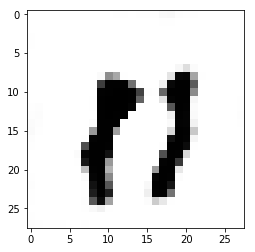

index no: 1


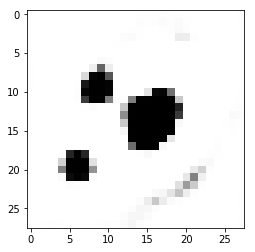

epoch no: 269
index no: 0


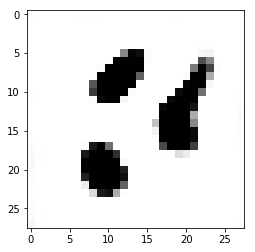

index no: 1


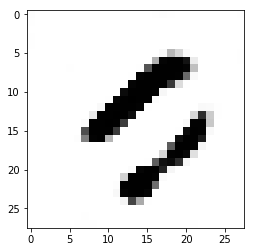

epoch no: 270
index no: 0


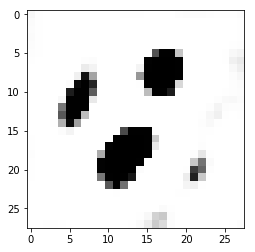

index no: 1


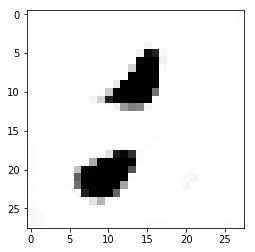

epoch no: 271
index no: 0


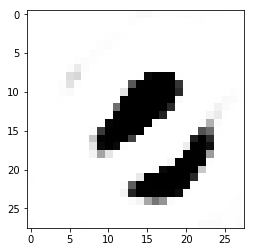

index no: 1


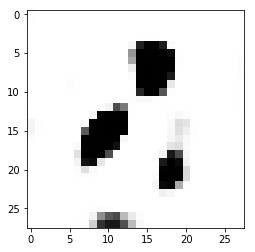

epoch no: 272
index no: 0


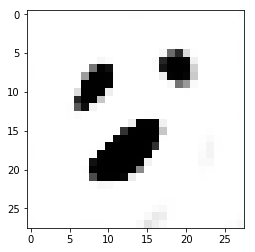

index no: 1


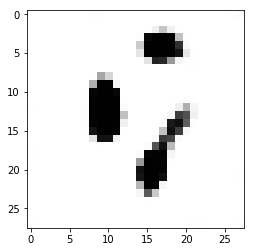

epoch no: 273
index no: 0


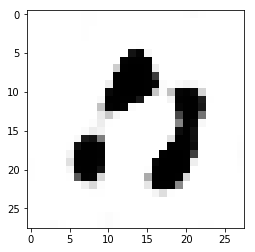

index no: 1


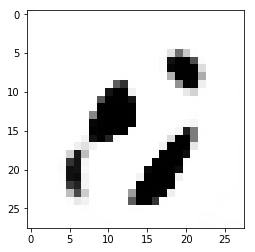

epoch no: 274
index no: 0


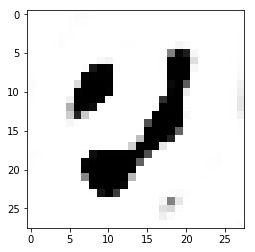

index no: 1


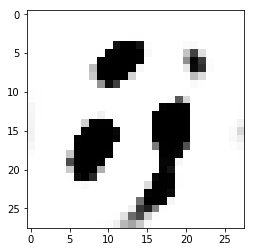

epoch no: 275
index no: 0


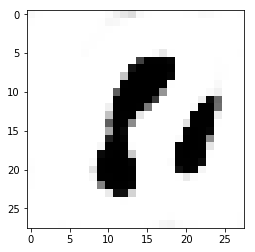

index no: 1


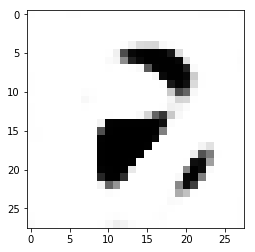

epoch no: 276
index no: 0


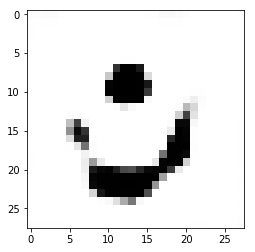

index no: 1


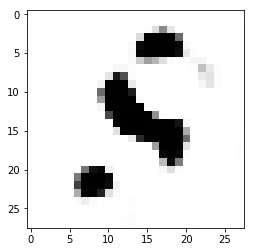

epoch no: 277
index no: 0


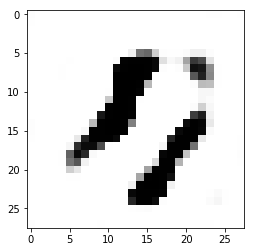

index no: 1


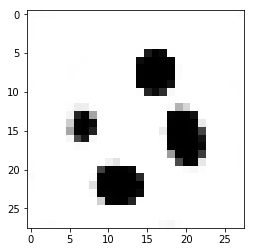

epoch no: 278
index no: 0


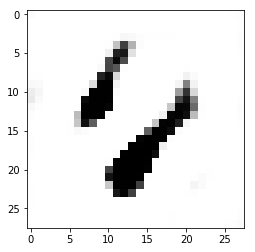

index no: 1


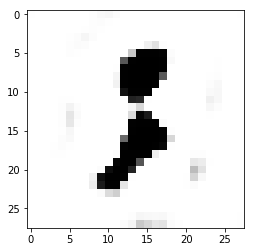

epoch no: 279
index no: 0


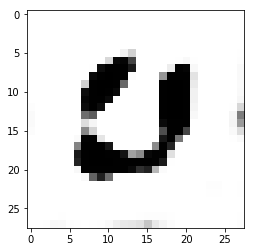

index no: 1


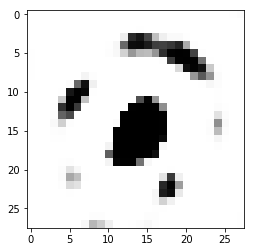

epoch no: 280
index no: 0


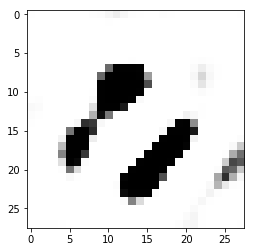

index no: 1


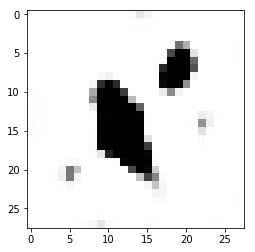

epoch no: 281
index no: 0


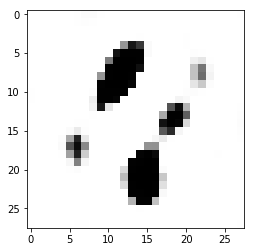

index no: 1


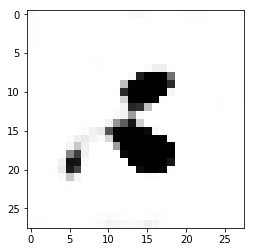

epoch no: 282
index no: 0


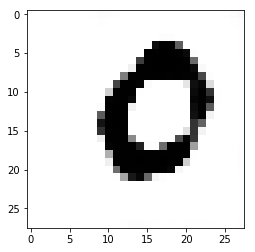

index no: 1


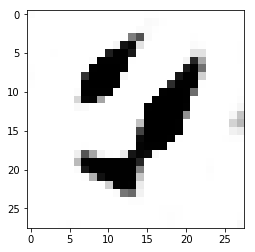

epoch no: 283
index no: 0


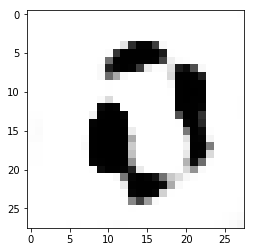

index no: 1


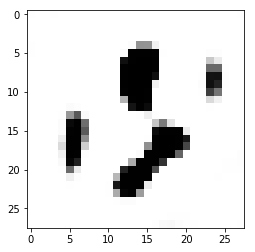

epoch no: 284
index no: 0


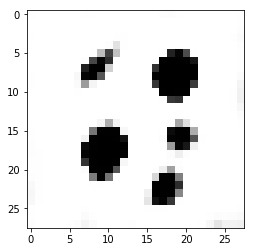

index no: 1


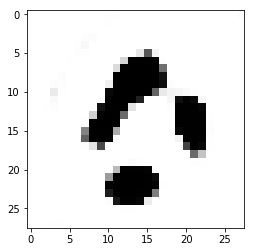

epoch no: 285
index no: 0


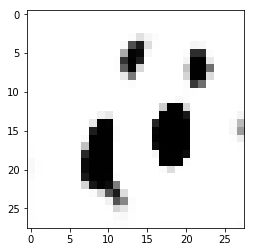

index no: 1


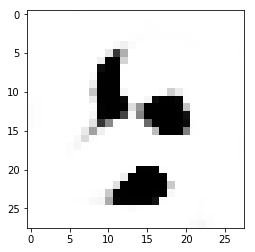

epoch no: 286
index no: 0


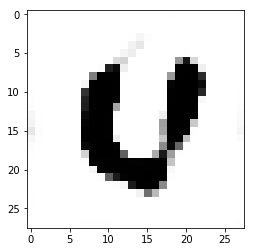

index no: 1


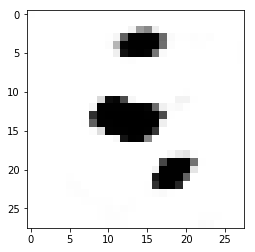

epoch no: 287
index no: 0


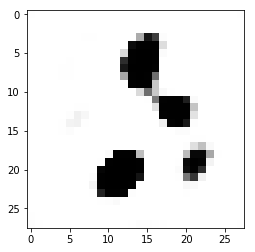

index no: 1


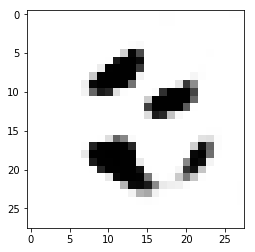

epoch no: 288
index no: 0


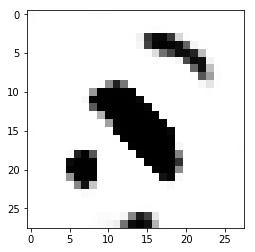

index no: 1


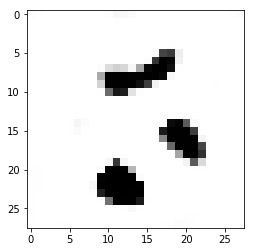

epoch no: 289
index no: 0


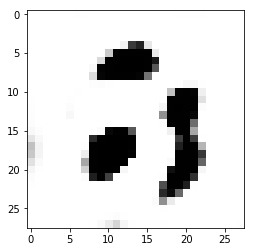

index no: 1


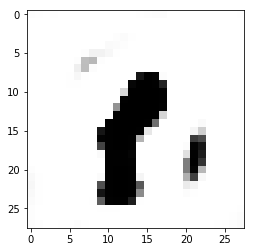

epoch no: 290
index no: 0


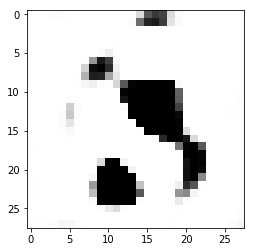

index no: 1


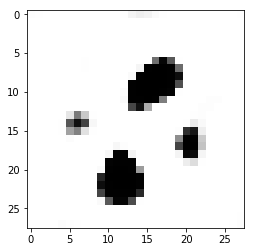

epoch no: 291
index no: 0


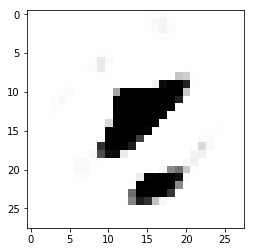

index no: 1


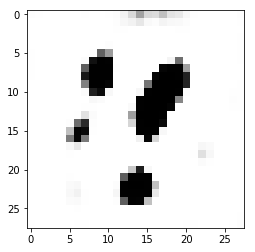

epoch no: 292
index no: 0


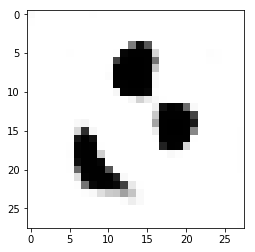

index no: 1


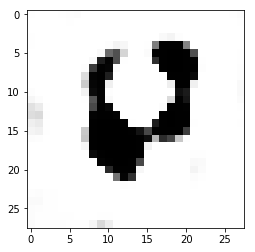

epoch no: 293
index no: 0


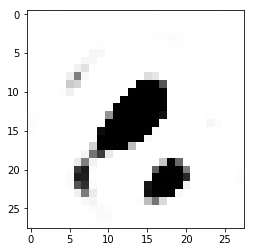

index no: 1


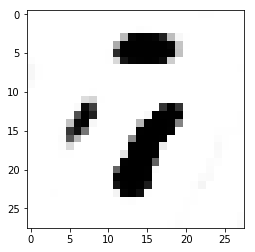

epoch no: 294
index no: 0


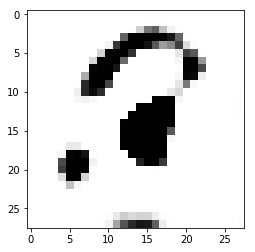

index no: 1


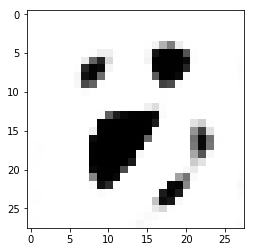

epoch no: 295
index no: 0


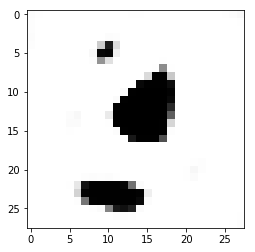

index no: 1


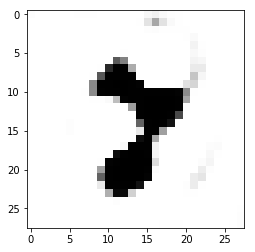

epoch no: 296
index no: 0


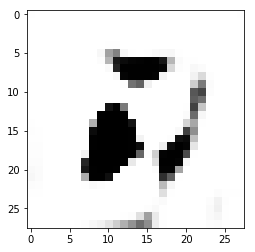

index no: 1


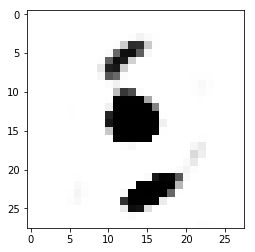

epoch no: 297
index no: 0


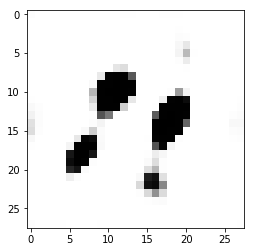

index no: 1


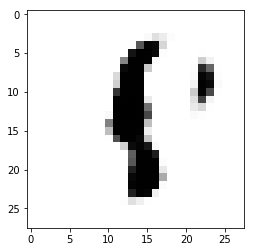

epoch no: 298
index no: 0


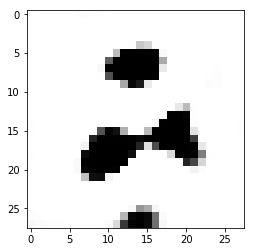

index no: 1


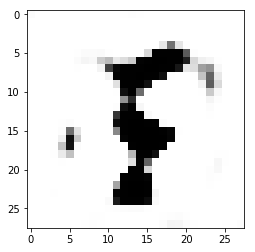

epoch no: 299
index no: 0


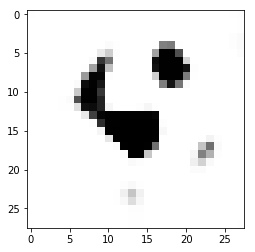

index no: 1


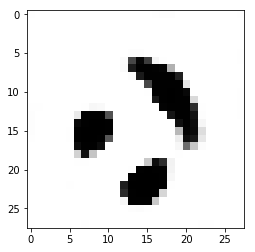

epoch no: 300
index no: 0


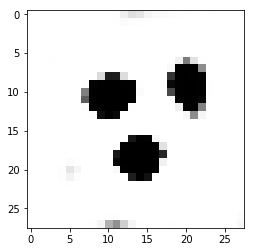

index no: 1


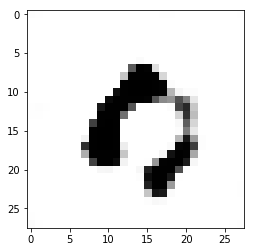

epoch no: 301
index no: 0


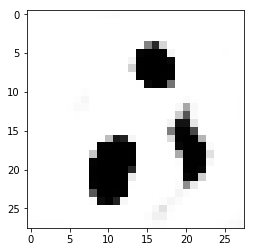

index no: 1


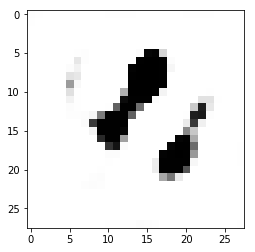

epoch no: 302
index no: 0


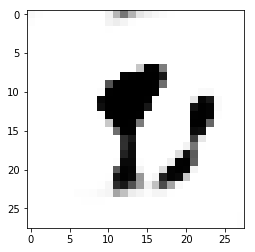

index no: 1


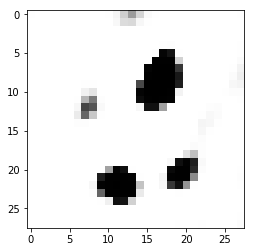

epoch no: 303
index no: 0


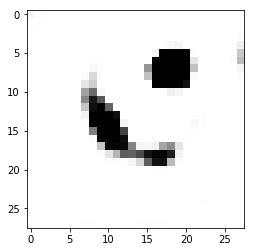

index no: 1


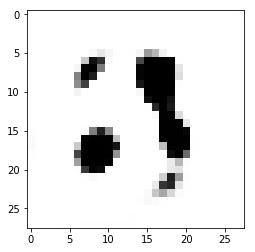

epoch no: 304
index no: 0


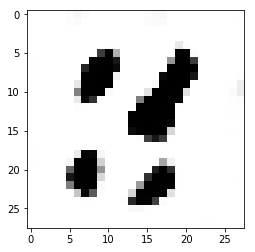

index no: 1


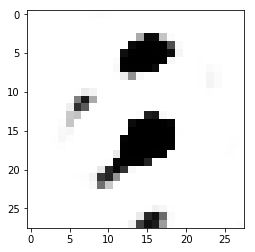

epoch no: 305
index no: 0


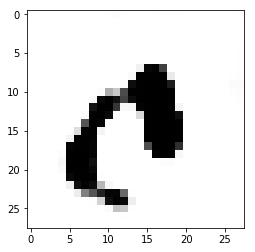

index no: 1


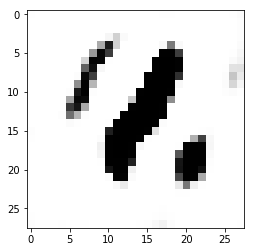

epoch no: 306
index no: 0


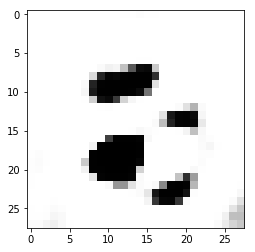

index no: 1


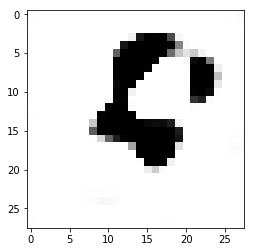

epoch no: 307
index no: 0


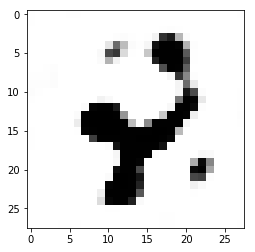

index no: 1


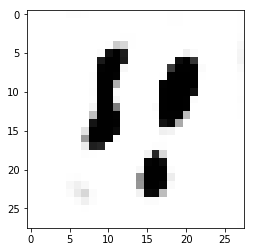

epoch no: 308
index no: 0


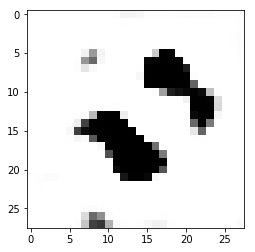

index no: 1


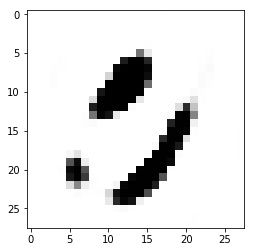

epoch no: 309
index no: 0


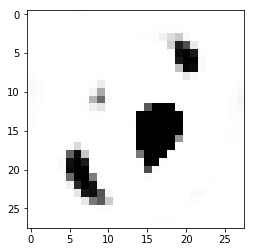

index no: 1


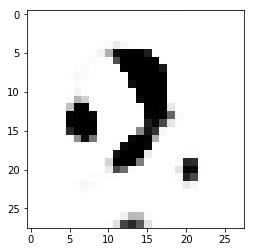

epoch no: 310
index no: 0


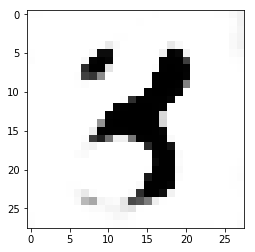

index no: 1


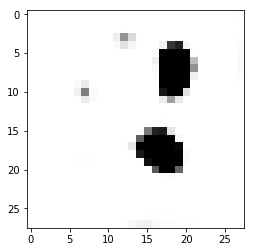

epoch no: 311
index no: 0


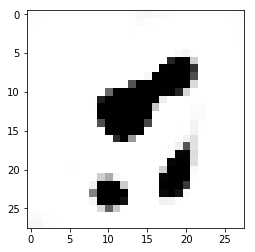

index no: 1


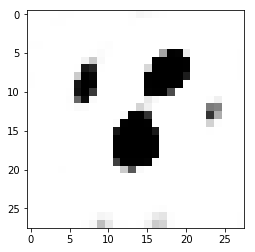

epoch no: 312
index no: 0


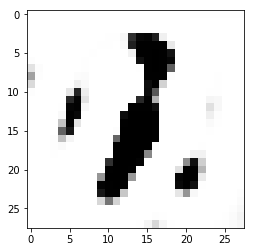

index no: 1


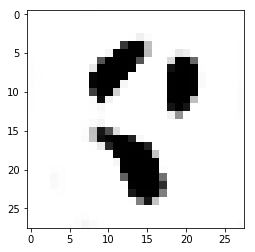

epoch no: 313
index no: 0


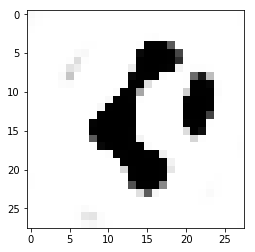

index no: 1


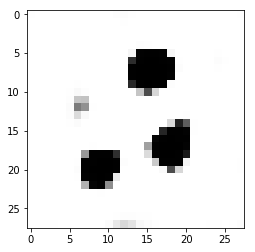

epoch no: 314
index no: 0


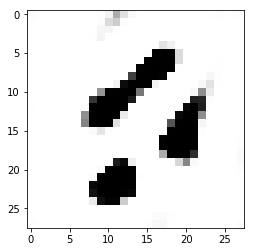

index no: 1


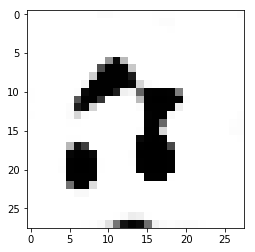

epoch no: 315
index no: 0


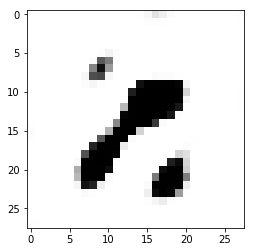

index no: 1


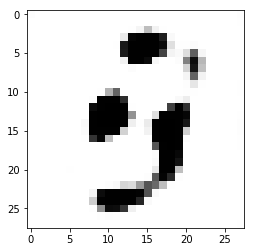

epoch no: 316
index no: 0


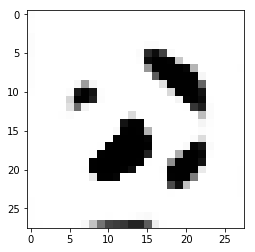

index no: 1


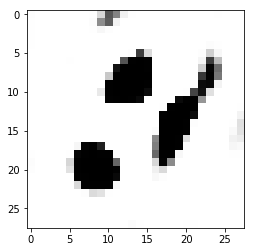

epoch no: 317
index no: 0


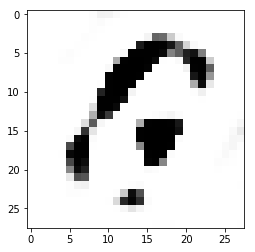

index no: 1


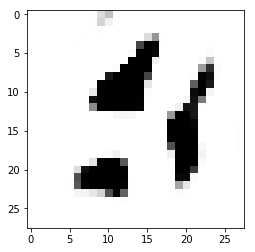

epoch no: 318
index no: 0


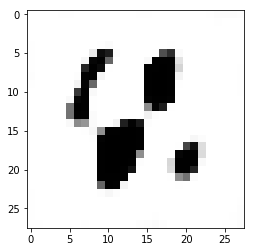

index no: 1


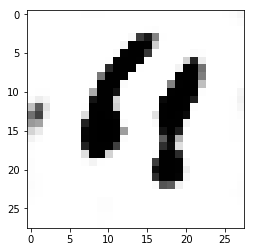

epoch no: 319
index no: 0


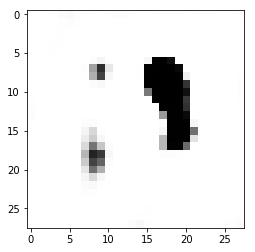

index no: 1


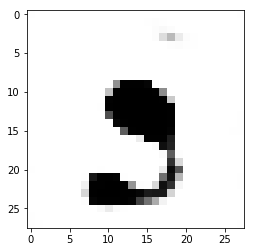

epoch no: 320
index no: 0


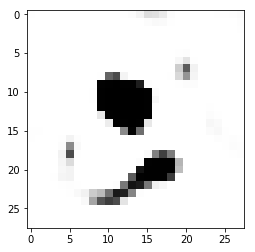

index no: 1


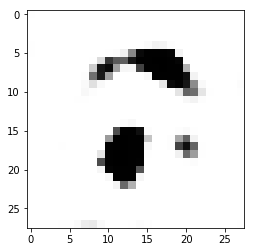

epoch no: 321
index no: 0


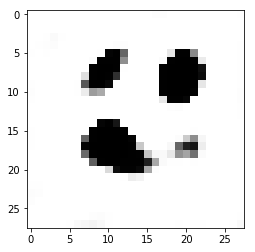

index no: 1


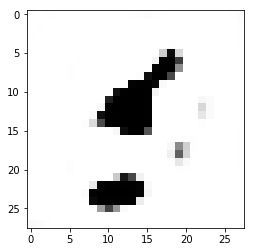

epoch no: 322
index no: 0


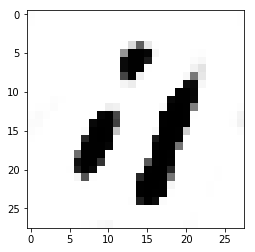

index no: 1


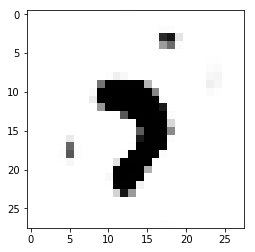

epoch no: 323
index no: 0


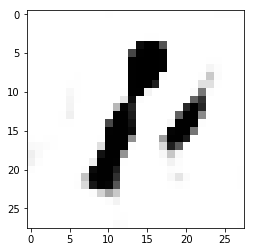

index no: 1


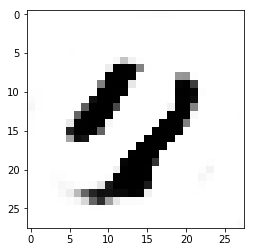

epoch no: 324
index no: 0


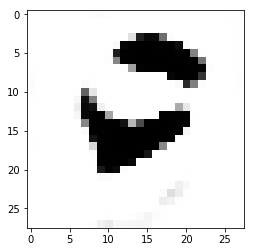

index no: 1


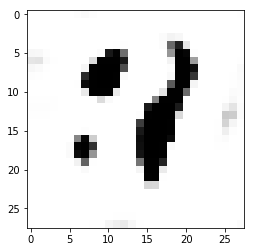

epoch no: 325
index no: 0


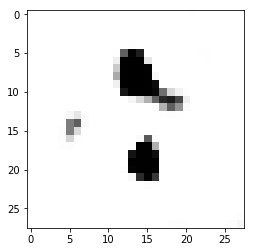

index no: 1


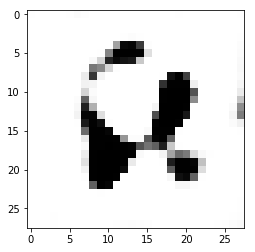

epoch no: 326
index no: 0


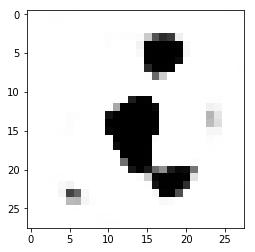

index no: 1


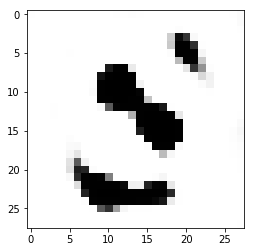

epoch no: 327
index no: 0


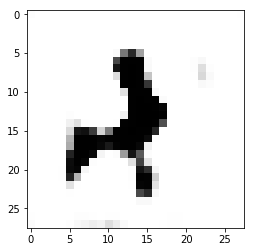

index no: 1


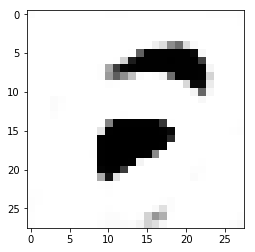

epoch no: 328
index no: 0


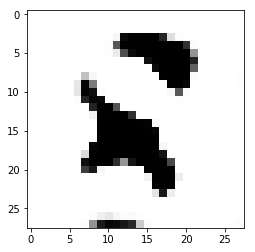

index no: 1


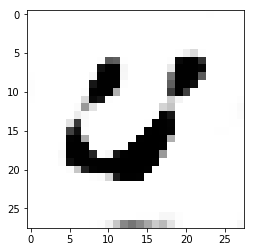

epoch no: 329
index no: 0


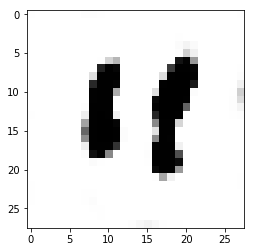

index no: 1


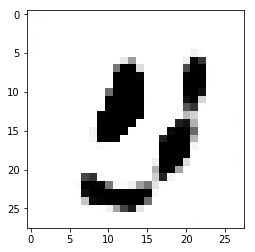

epoch no: 330
index no: 0


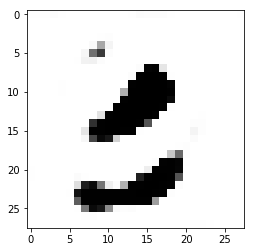

index no: 1


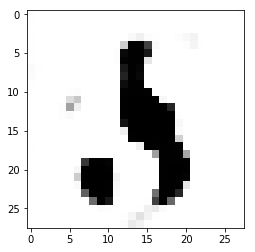

epoch no: 331
index no: 0


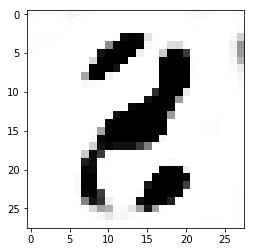

index no: 1


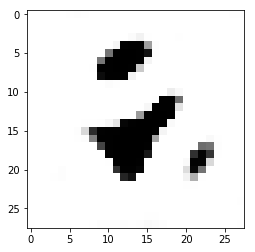

epoch no: 332
index no: 0


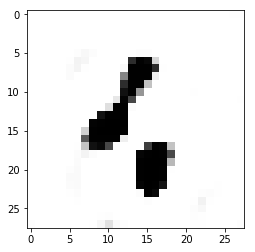

index no: 1


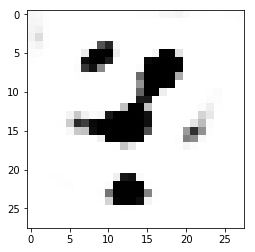

epoch no: 333
index no: 0


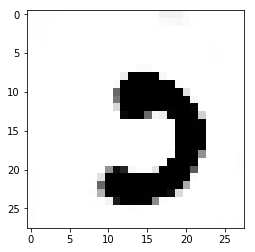

index no: 1


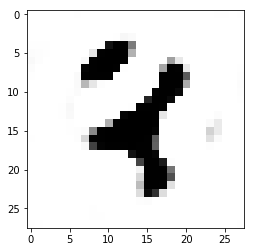

epoch no: 334
index no: 0


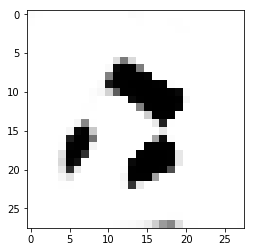

index no: 1


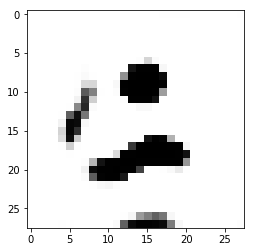

epoch no: 335
index no: 0


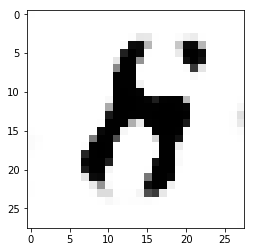

index no: 1


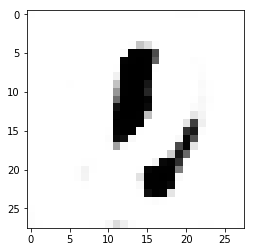

epoch no: 336
index no: 0


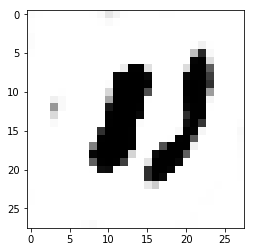

index no: 1


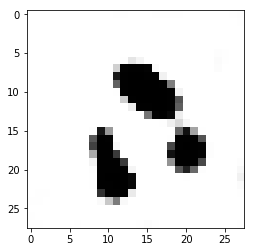

epoch no: 337
index no: 0


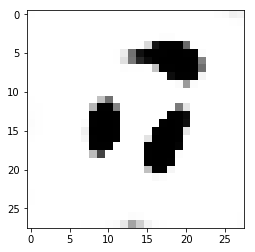

index no: 1


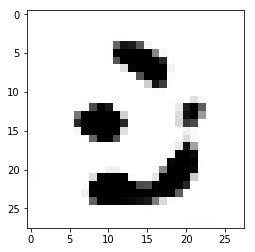

epoch no: 338
index no: 0


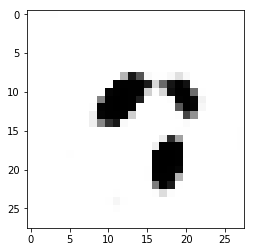

index no: 1


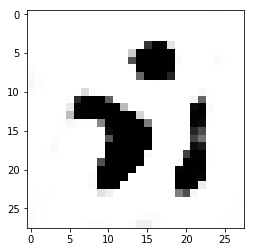

epoch no: 339
index no: 0


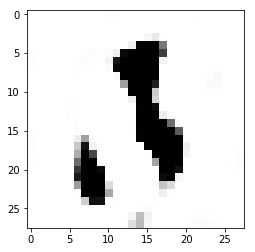

index no: 1


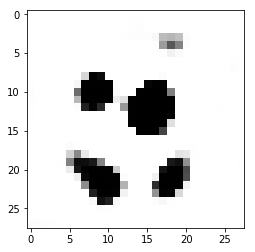

epoch no: 340
index no: 0


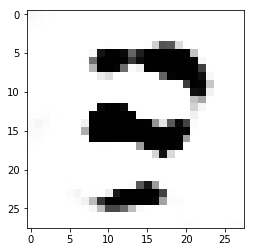

index no: 1


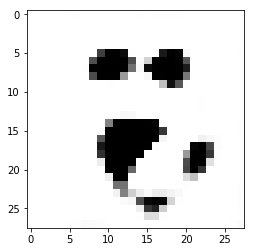

epoch no: 341
index no: 0


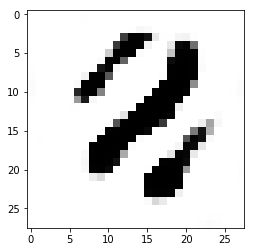

index no: 1


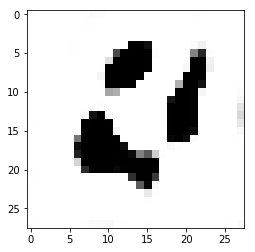

epoch no: 342
index no: 0


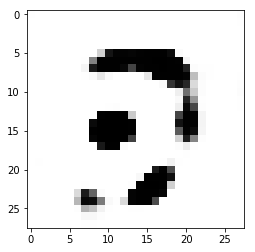

index no: 1


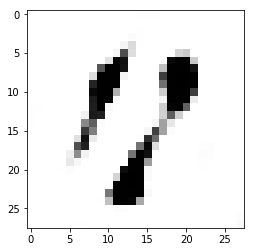

epoch no: 343
index no: 0


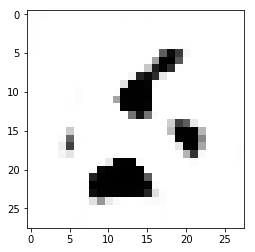

index no: 1


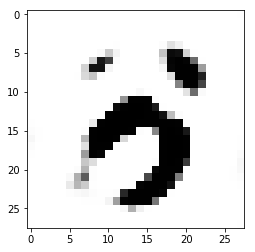

epoch no: 344
index no: 0


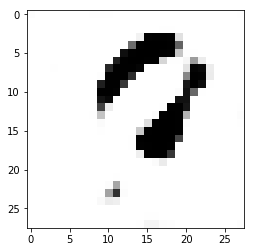

index no: 1


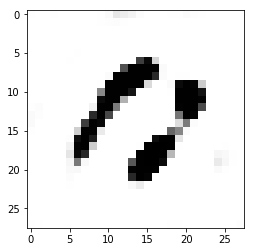

epoch no: 345
index no: 0


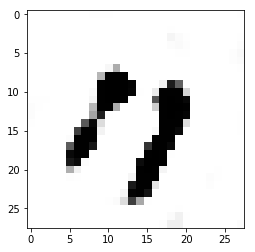

index no: 1


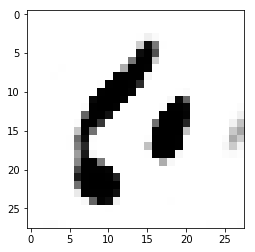

epoch no: 346
index no: 0


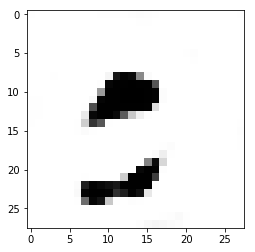

index no: 1


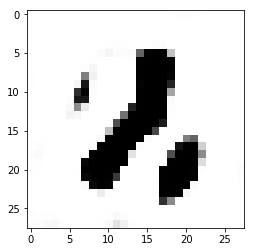

epoch no: 347
index no: 0


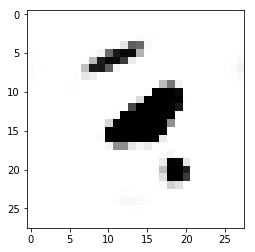

index no: 1


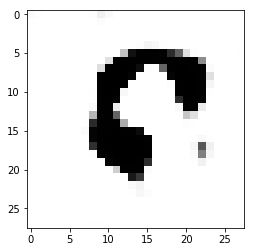

epoch no: 348
index no: 0


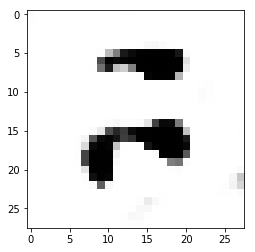

index no: 1


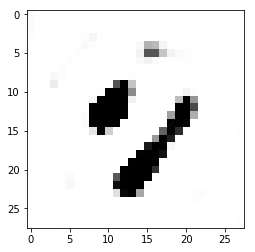

epoch no: 349
index no: 0


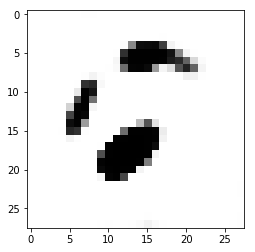

index no: 1


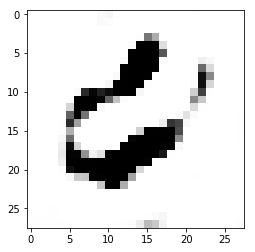

epoch no: 350
index no: 0


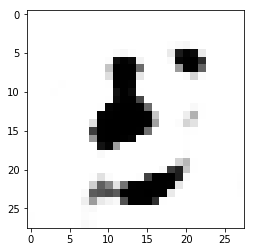

index no: 1


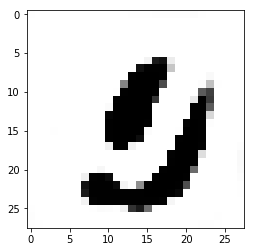

epoch no: 351
index no: 0


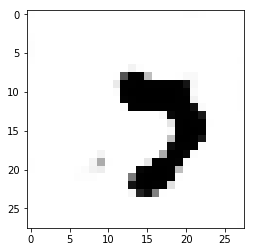

index no: 1


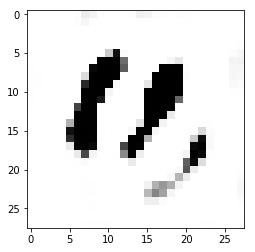

epoch no: 352
index no: 0


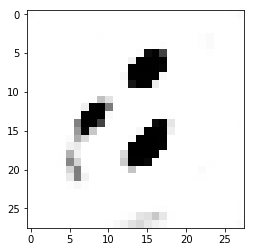

index no: 1


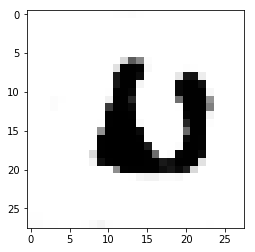

epoch no: 353
index no: 0


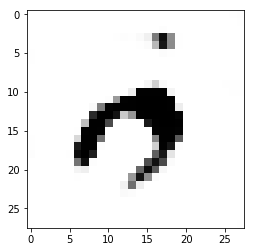

index no: 1


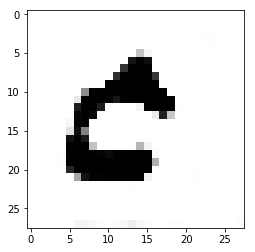

epoch no: 354
index no: 0


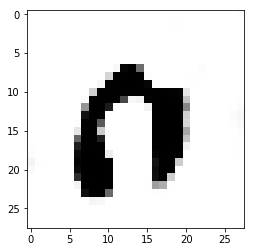

index no: 1


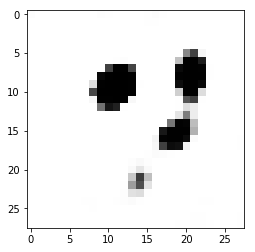

epoch no: 355
index no: 0


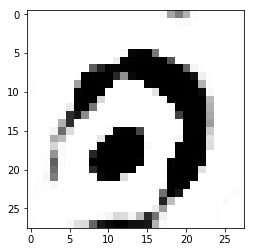

index no: 1


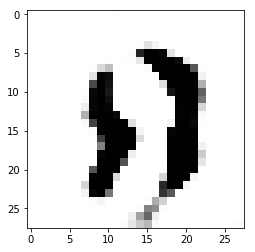

epoch no: 356
index no: 0


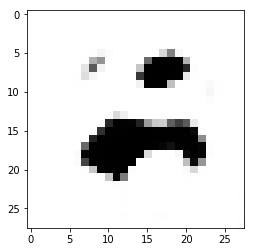

index no: 1


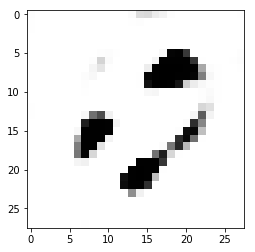

epoch no: 357
index no: 0


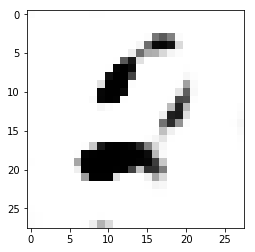

index no: 1


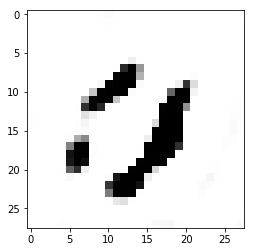

epoch no: 358
index no: 0


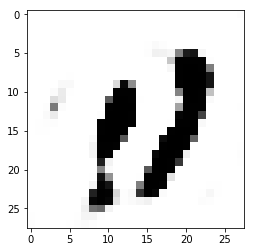

index no: 1


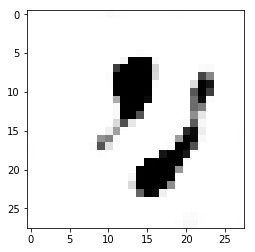

epoch no: 359
index no: 0


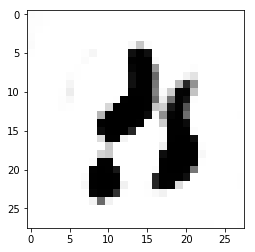

index no: 1


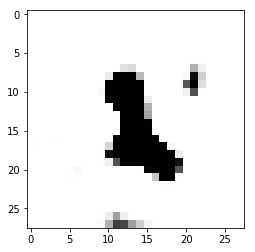

epoch no: 360
index no: 0


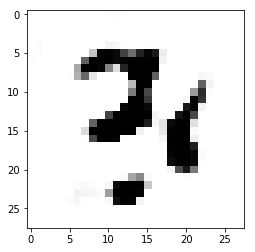

index no: 1


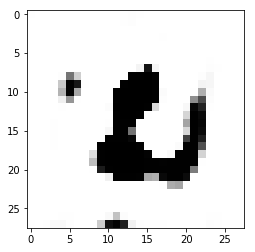

epoch no: 361
index no: 0


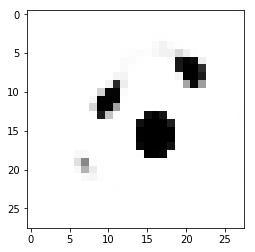

index no: 1


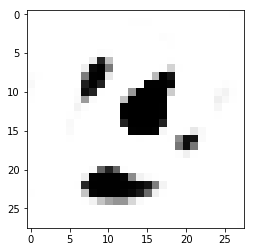

epoch no: 362
index no: 0


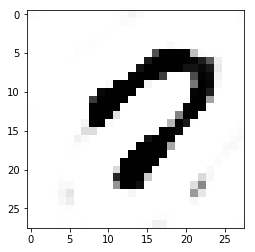

index no: 1


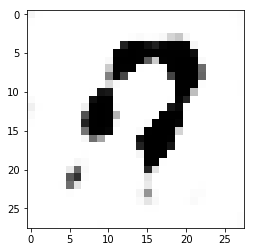

epoch no: 363
index no: 0


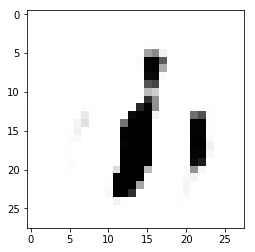

index no: 1


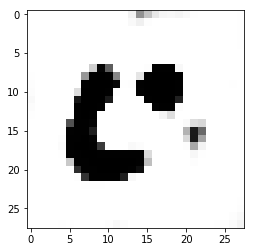

epoch no: 364
index no: 0


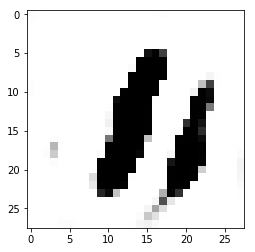

index no: 1


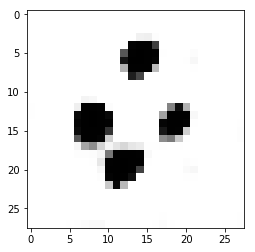

epoch no: 365
index no: 0


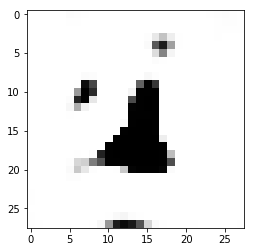

index no: 1


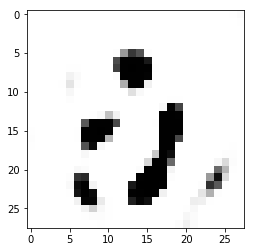

epoch no: 366
index no: 0


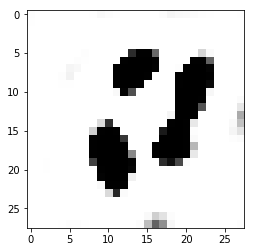

index no: 1


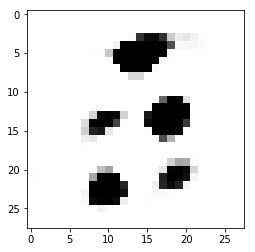

epoch no: 367
index no: 0


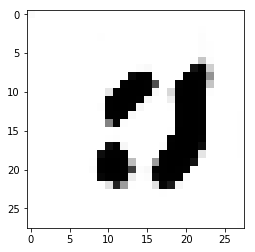

index no: 1


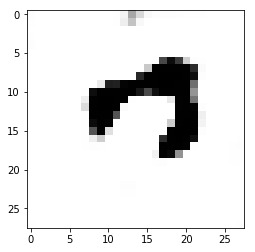

epoch no: 368
index no: 0


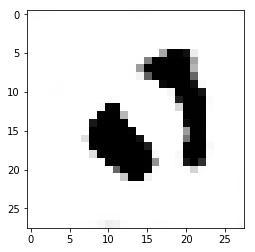

index no: 1


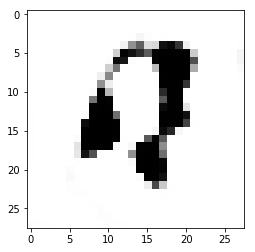

epoch no: 369
index no: 0


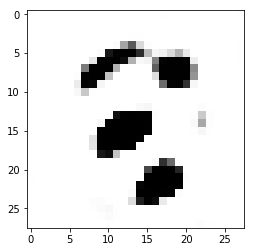

index no: 1


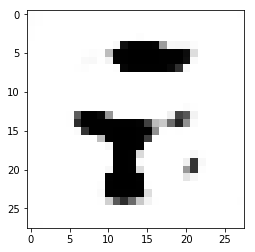

epoch no: 370
index no: 0


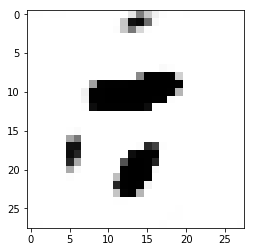

index no: 1


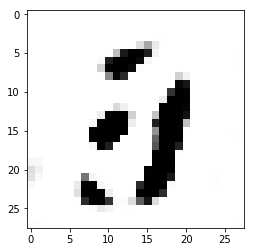

epoch no: 371
index no: 0


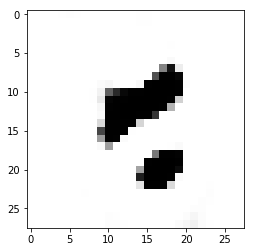

index no: 1


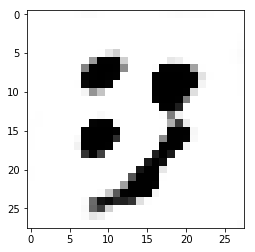

epoch no: 372
index no: 0


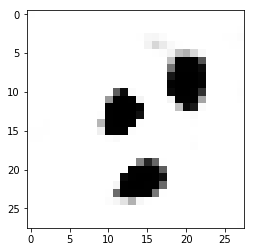

index no: 1


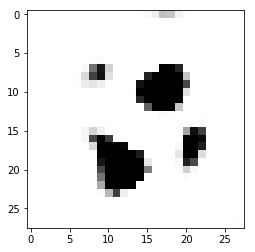

epoch no: 373
index no: 0


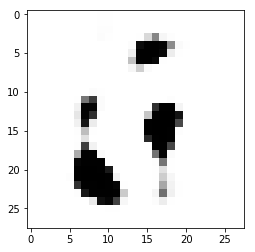

index no: 1


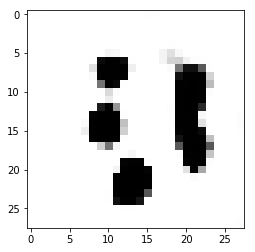

epoch no: 374
index no: 0


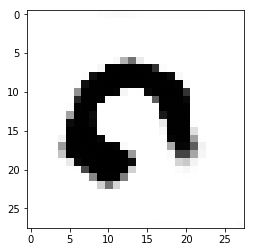

index no: 1


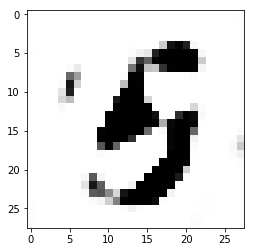

epoch no: 375
index no: 0


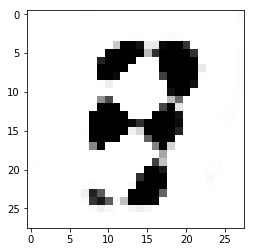

index no: 1


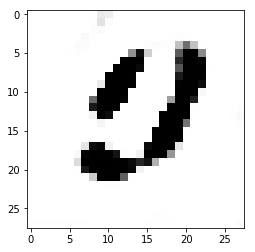

epoch no: 376
index no: 0


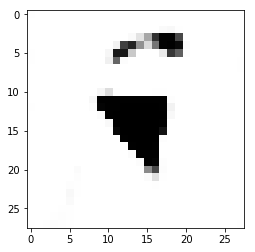

index no: 1


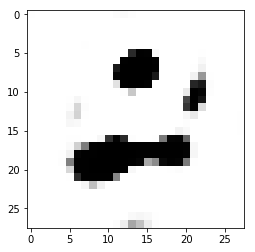

epoch no: 377
index no: 0


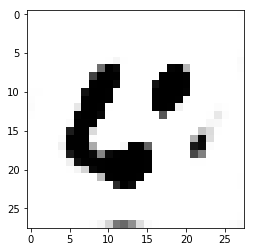

index no: 1


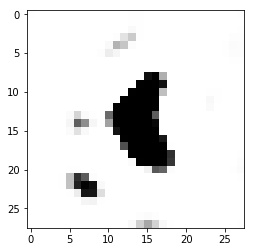

epoch no: 378
index no: 0


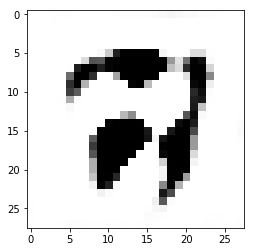

index no: 1


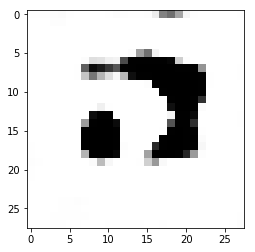

epoch no: 379
index no: 0


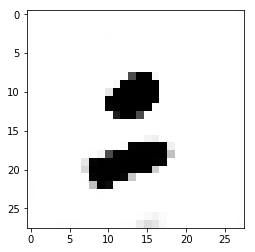

index no: 1


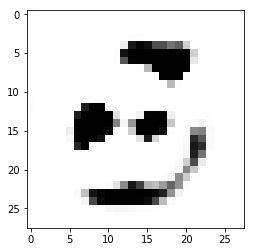

epoch no: 380
index no: 0


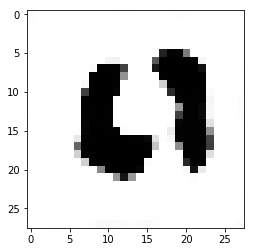

index no: 1


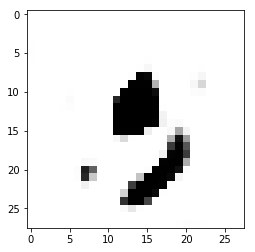

epoch no: 381
index no: 0


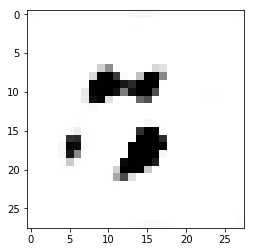

index no: 1


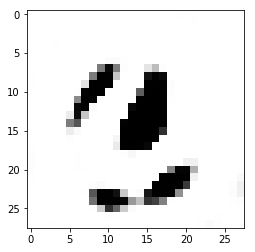

epoch no: 382
index no: 0


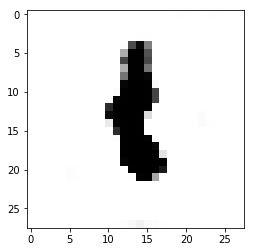

index no: 1


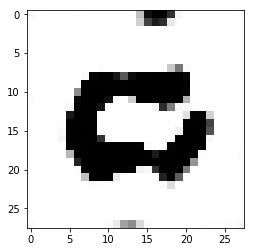

epoch no: 383
index no: 0


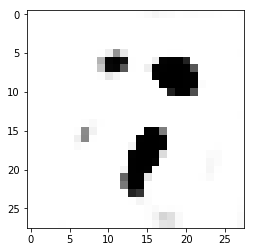

index no: 1


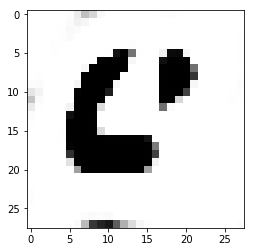

epoch no: 384
index no: 0


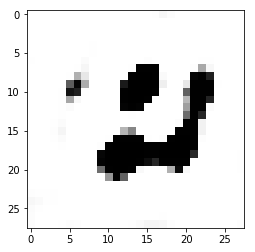

index no: 1


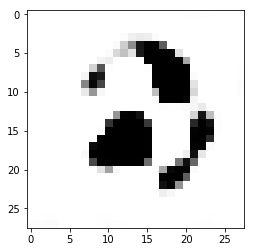

epoch no: 385
index no: 0


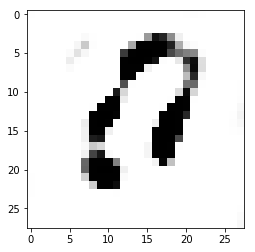

index no: 1


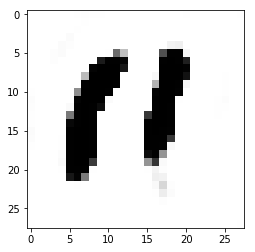

epoch no: 386
index no: 0


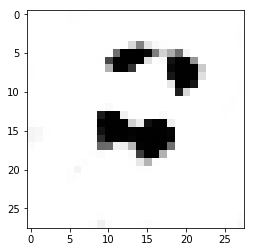

index no: 1


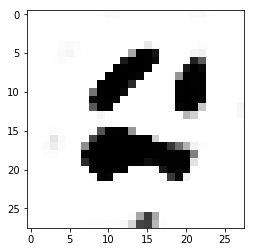

epoch no: 387
index no: 0


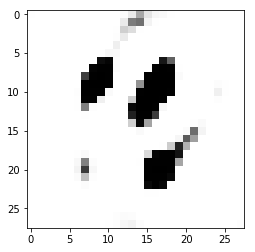

index no: 1


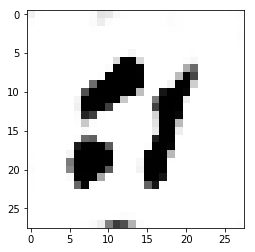

epoch no: 388
index no: 0


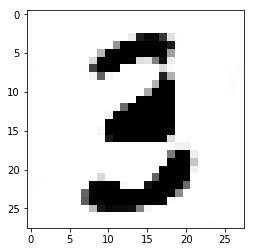

index no: 1


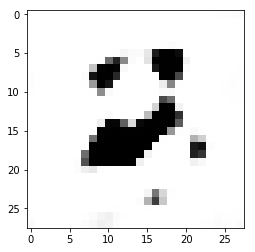

epoch no: 389
index no: 0


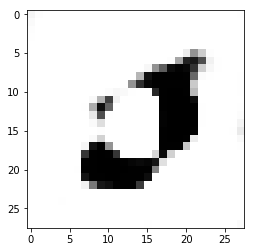

index no: 1


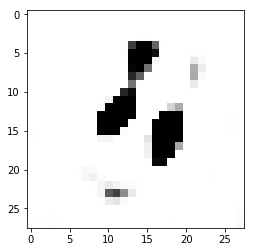

epoch no: 390
index no: 0


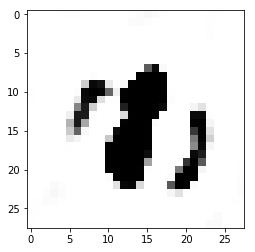

index no: 1


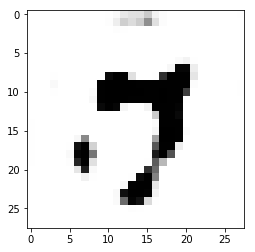

epoch no: 391
index no: 0


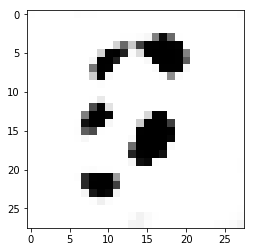

index no: 1


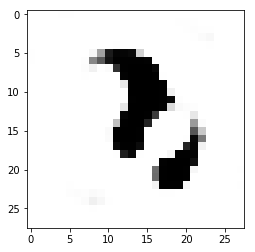

epoch no: 392
index no: 0


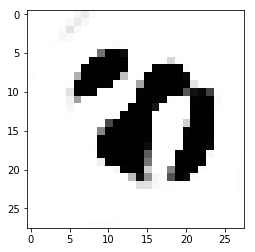

index no: 1


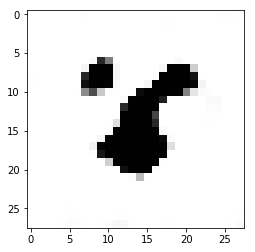

epoch no: 393
index no: 0


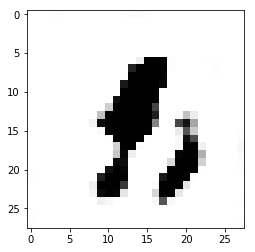

index no: 1


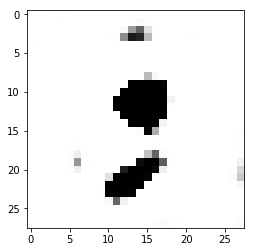

epoch no: 394
index no: 0


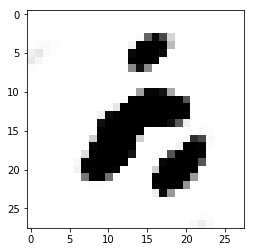

index no: 1


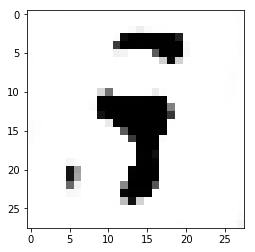

epoch no: 395
index no: 0


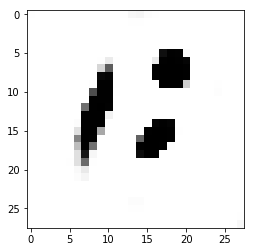

index no: 1


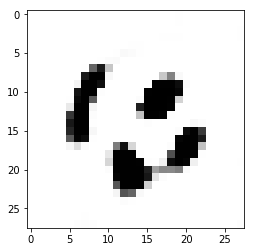

epoch no: 396
index no: 0


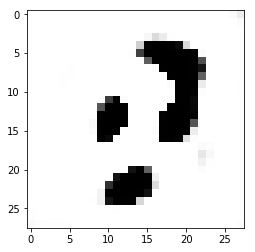

index no: 1


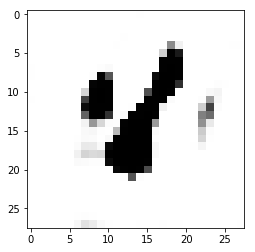

epoch no: 397
index no: 0


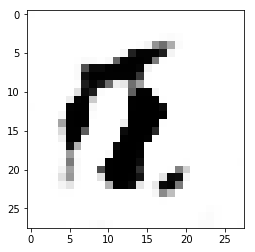

index no: 1


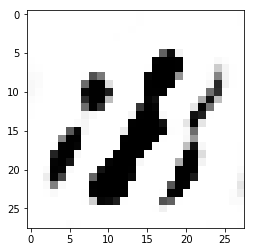

epoch no: 398
index no: 0


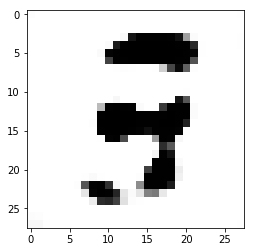

index no: 1


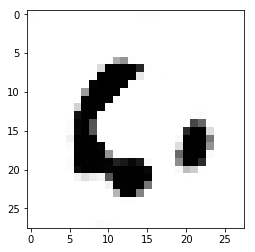

epoch no: 399
index no: 0


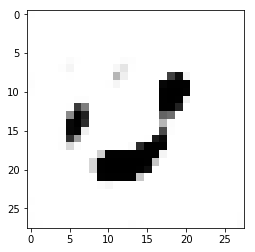

index no: 1


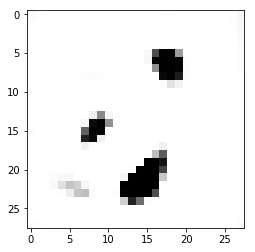

epoch no: 400
index no: 0


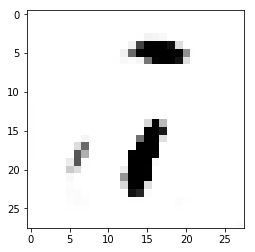

index no: 1


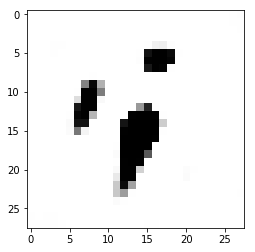

epoch no: 401
index no: 0


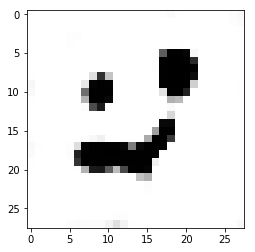

index no: 1


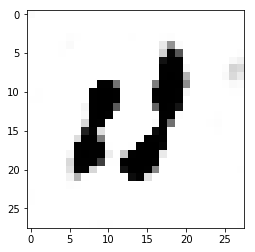

epoch no: 402
index no: 0


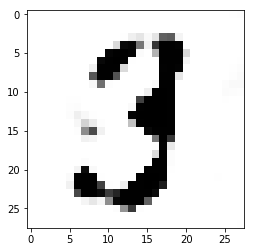

index no: 1


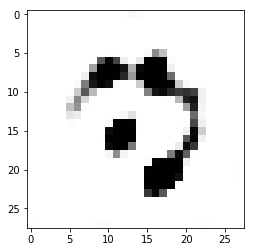

epoch no: 403
index no: 0


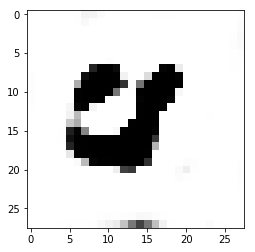

index no: 1


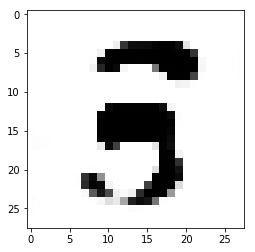

epoch no: 404
index no: 0


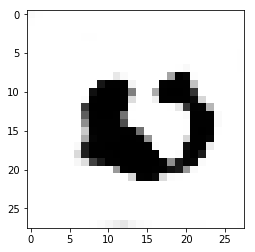

index no: 1


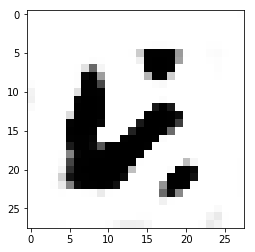

epoch no: 405
index no: 0


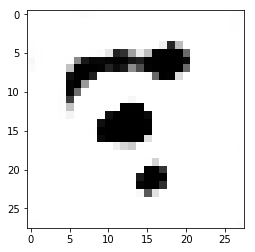

index no: 1


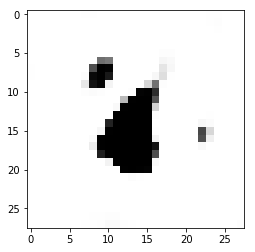

epoch no: 406
index no: 0


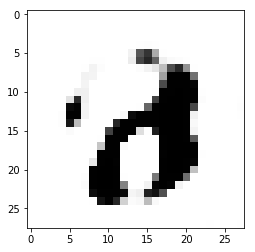

index no: 1


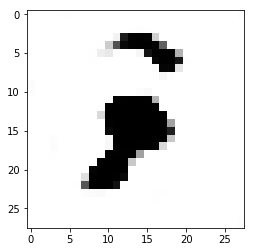

epoch no: 407
index no: 0


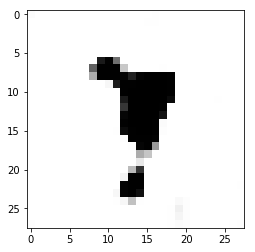

index no: 1


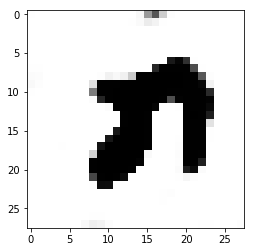

epoch no: 408
index no: 0


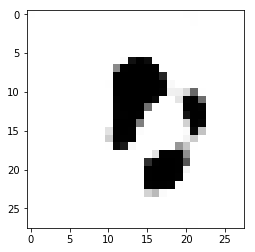

index no: 1


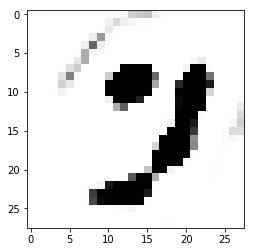

epoch no: 409
index no: 0


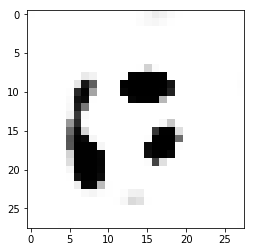

index no: 1


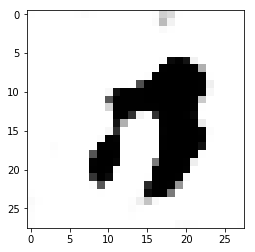

epoch no: 410
index no: 0


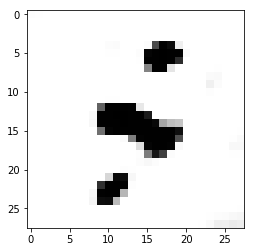

index no: 1


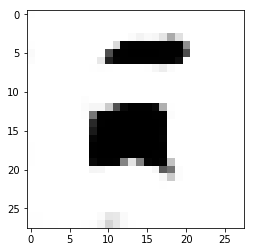

epoch no: 411
index no: 0


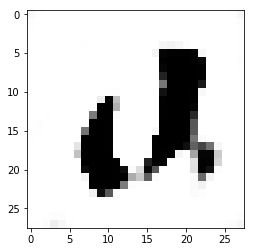

index no: 1


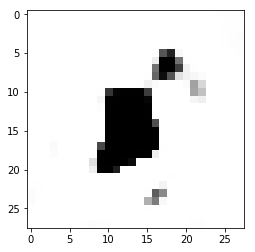

epoch no: 412
index no: 0


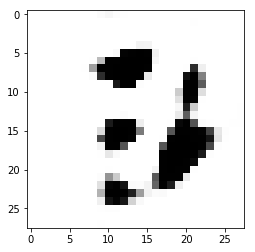

index no: 1


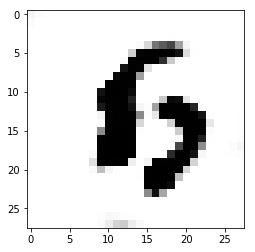

epoch no: 413
index no: 0


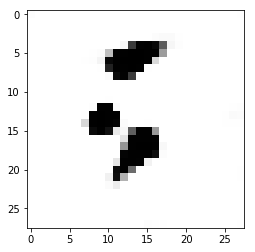

index no: 1


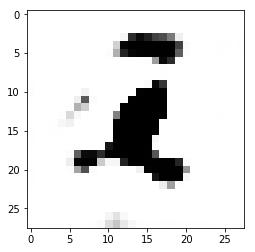

epoch no: 414
index no: 0


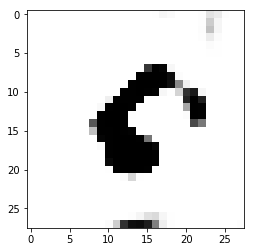

index no: 1


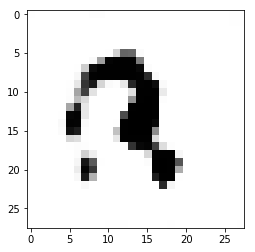

epoch no: 415
index no: 0


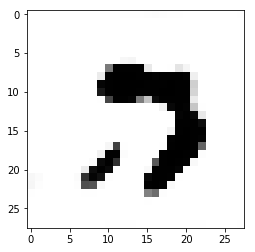

index no: 1


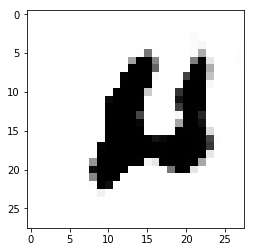

epoch no: 416
index no: 0


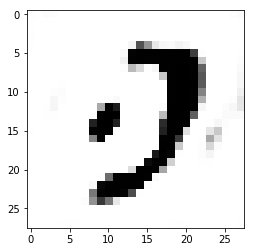

index no: 1


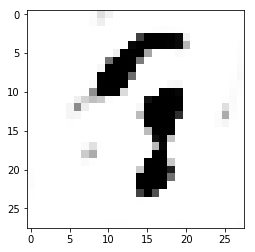

epoch no: 417
index no: 0


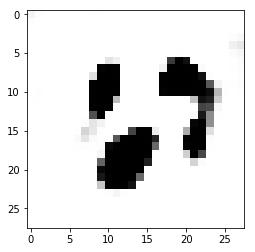

index no: 1


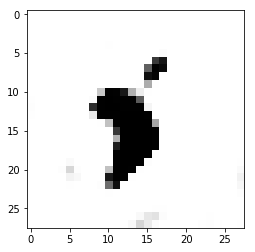

epoch no: 418
index no: 0


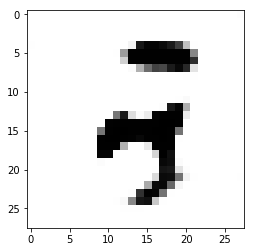

index no: 1


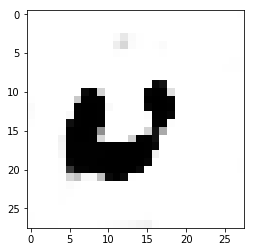

epoch no: 419
index no: 0


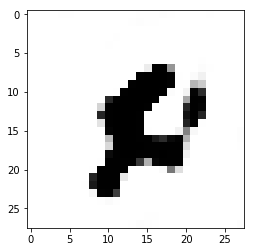

index no: 1


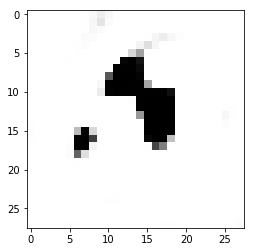

epoch no: 420
index no: 0


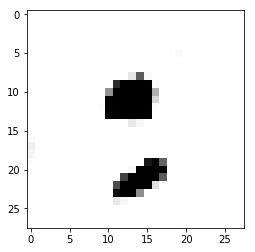

index no: 1


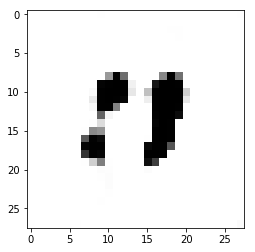

epoch no: 421
index no: 0


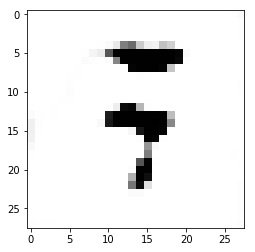

index no: 1


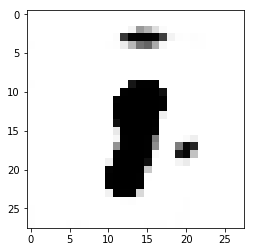

epoch no: 422
index no: 0


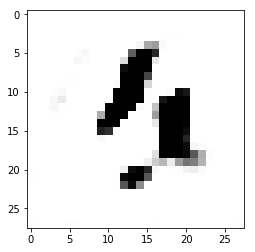

index no: 1


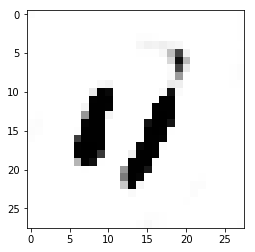

epoch no: 423
index no: 0


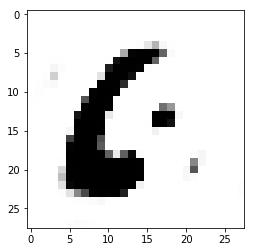

index no: 1


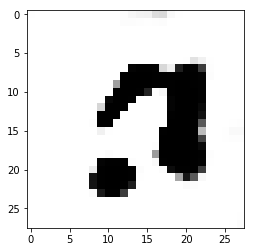

epoch no: 424
index no: 0


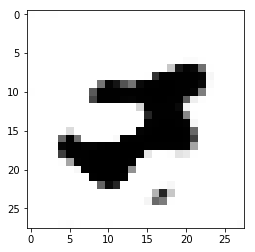

index no: 1


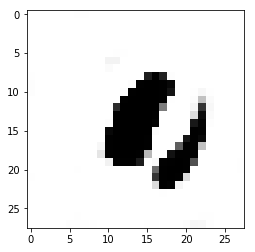

epoch no: 425
index no: 0


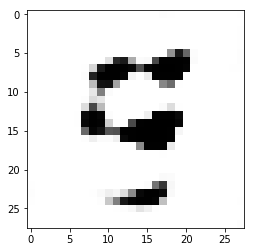

index no: 1


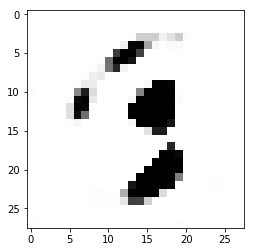

epoch no: 426
index no: 0


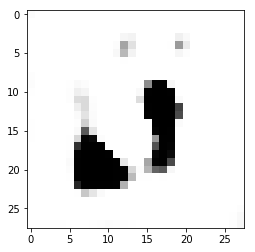

index no: 1


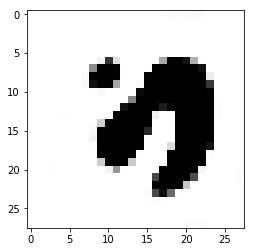

epoch no: 427
index no: 0


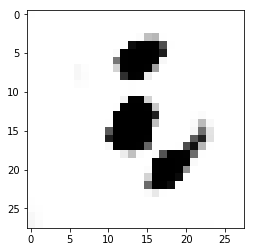

index no: 1


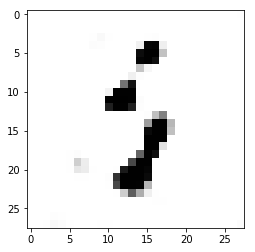

epoch no: 428
index no: 0


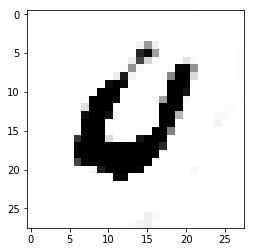

index no: 1


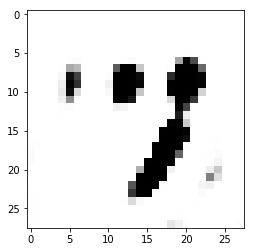

epoch no: 429
index no: 0


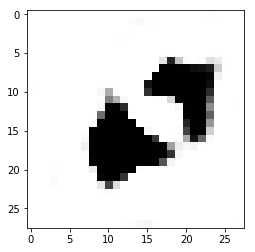

index no: 1


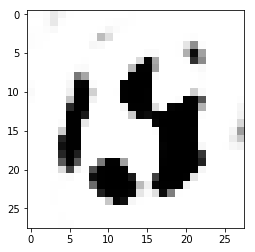

epoch no: 430
index no: 0


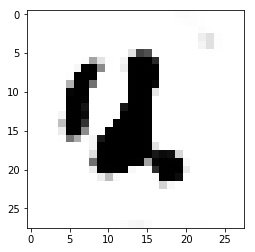

index no: 1


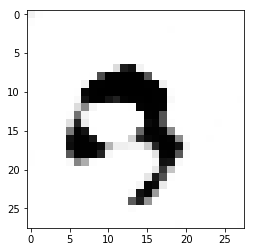

epoch no: 431
index no: 0


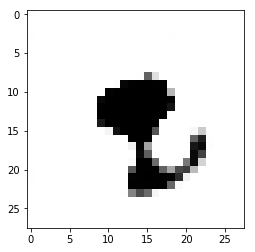

index no: 1


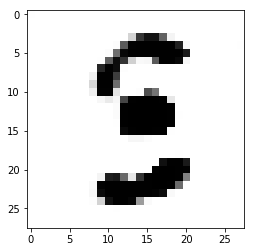

epoch no: 432
index no: 0


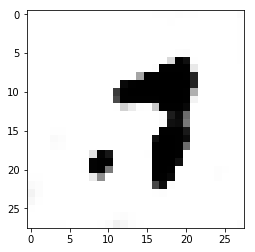

index no: 1


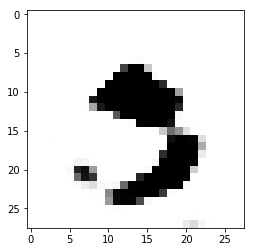

epoch no: 433
index no: 0


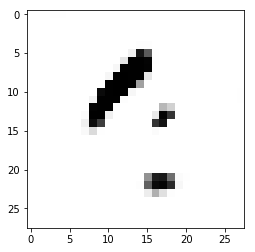

index no: 1


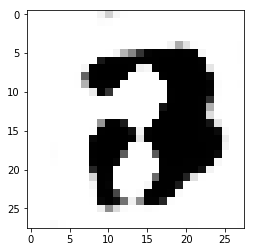

epoch no: 434
index no: 0


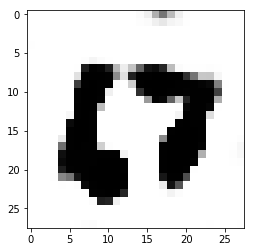

index no: 1


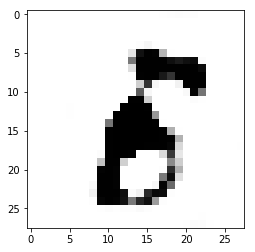

epoch no: 435
index no: 0


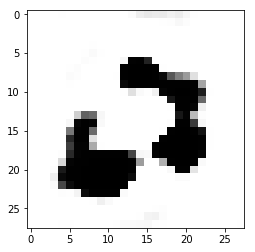

index no: 1


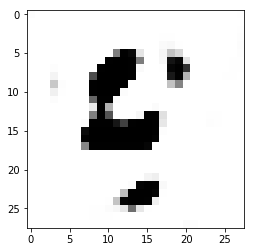

epoch no: 436
index no: 0


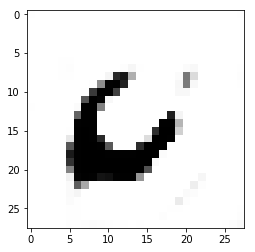

index no: 1


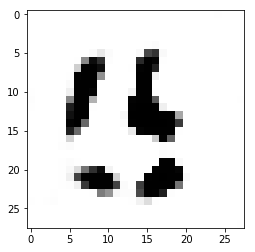

epoch no: 437
index no: 0


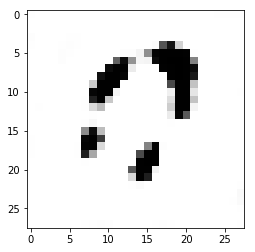

index no: 1


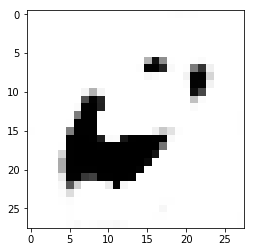

epoch no: 438
index no: 0


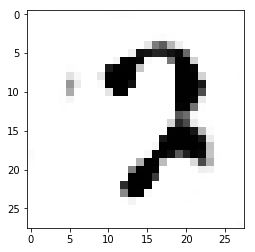

index no: 1


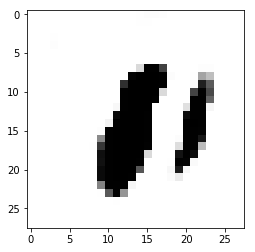

epoch no: 439
index no: 0


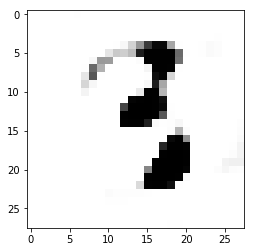

index no: 1


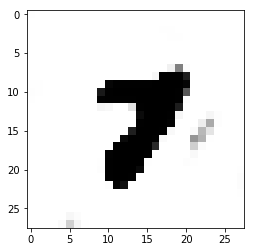

epoch no: 440
index no: 0


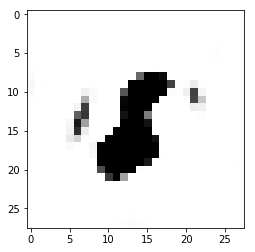

index no: 1


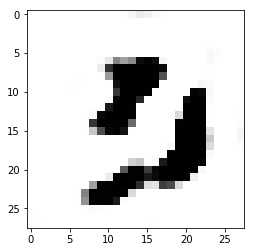

epoch no: 441
index no: 0


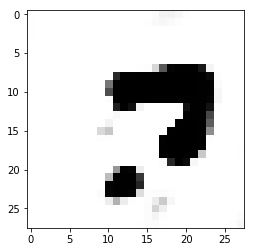

index no: 1


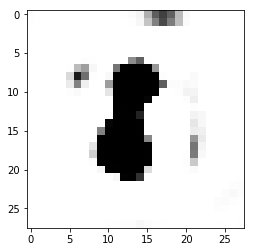

epoch no: 442
index no: 0


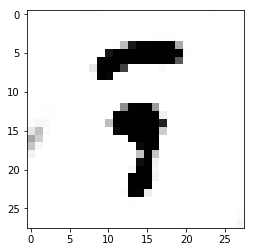

index no: 1


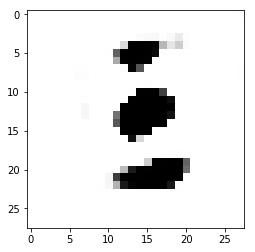

epoch no: 443
index no: 0


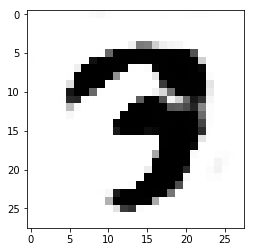

index no: 1


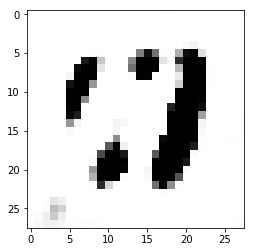

epoch no: 444
index no: 0


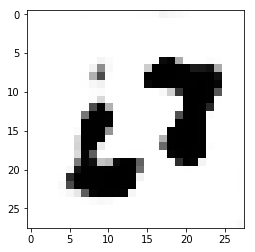

index no: 1


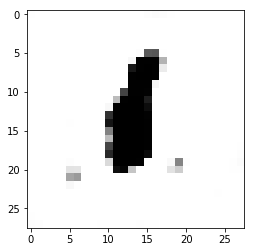

epoch no: 445
index no: 0


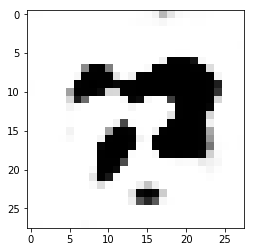

index no: 1


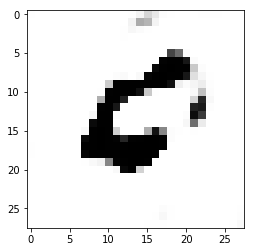

epoch no: 446
index no: 0


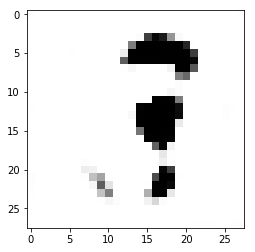

index no: 1


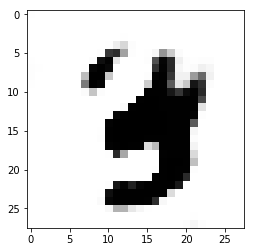

epoch no: 447
index no: 0


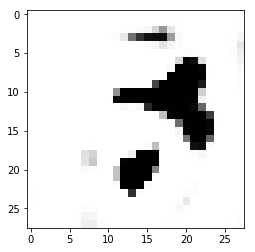

index no: 1


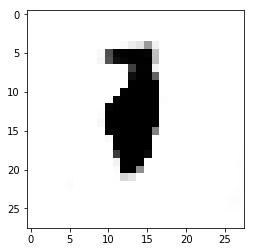

epoch no: 448
index no: 0


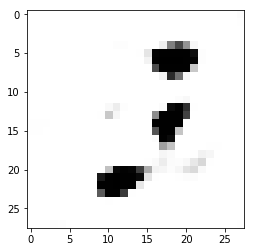

index no: 1


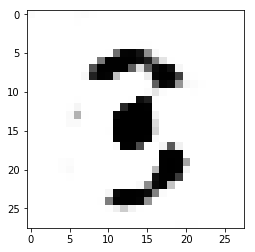

epoch no: 449
index no: 0


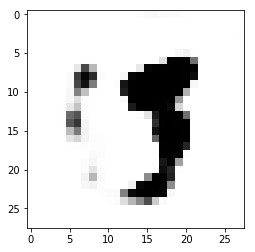

index no: 1


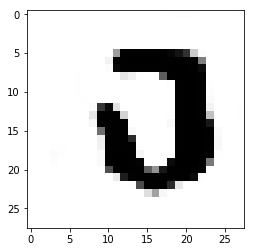

epoch no: 450
index no: 0


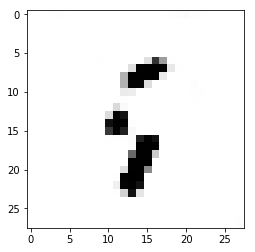

index no: 1


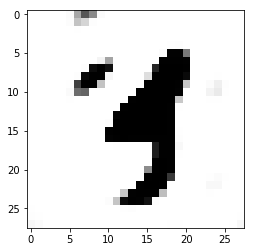

epoch no: 451
index no: 0


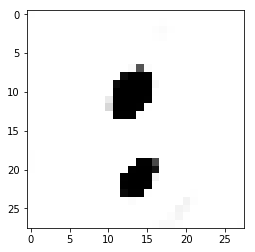

index no: 1


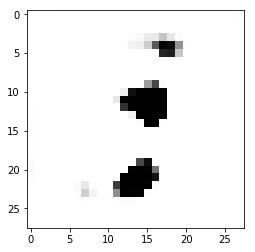

epoch no: 452
index no: 0


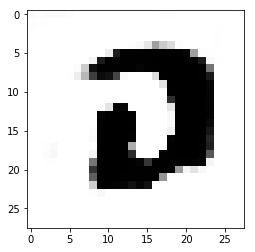

index no: 1


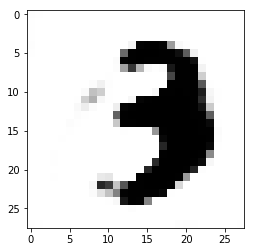

epoch no: 453
index no: 0


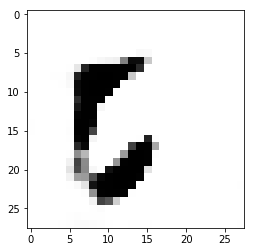

index no: 1


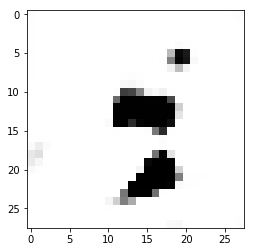

epoch no: 454
index no: 0


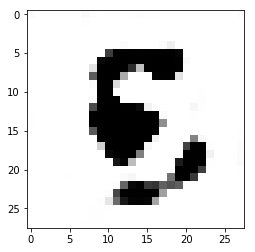

index no: 1


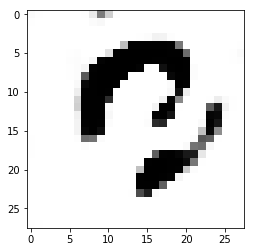

epoch no: 455
index no: 0


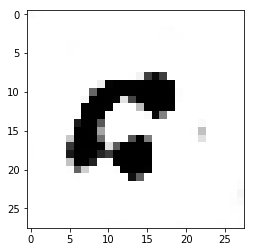

index no: 1


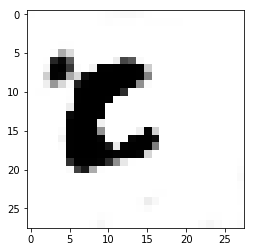

epoch no: 456
index no: 0


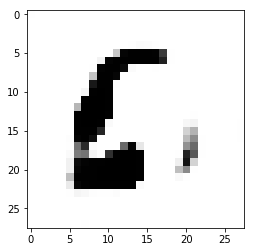

index no: 1


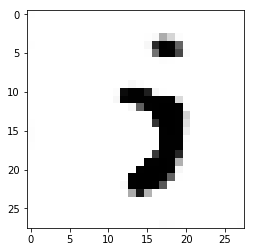

epoch no: 457
index no: 0


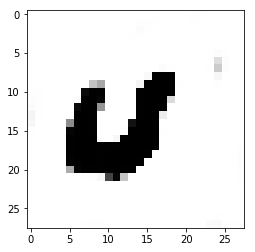

index no: 1


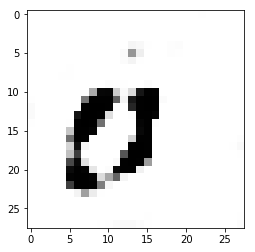

epoch no: 458
index no: 0


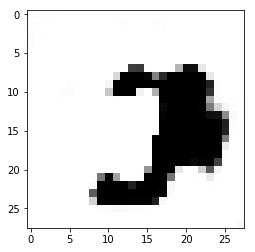

index no: 1


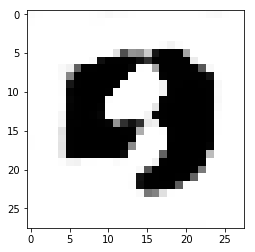

epoch no: 459
index no: 0


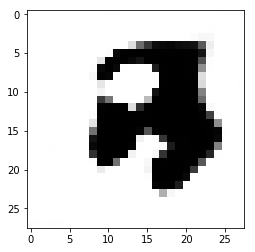

index no: 1


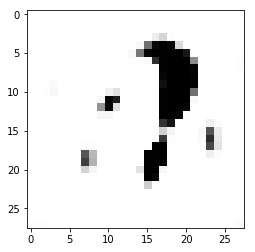

epoch no: 460
index no: 0


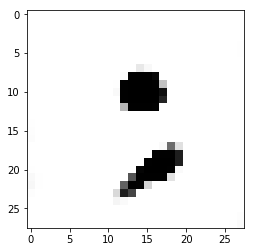

index no: 1


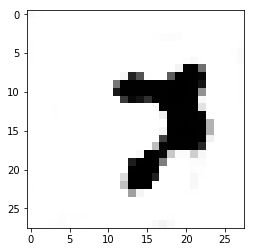

epoch no: 461
index no: 0


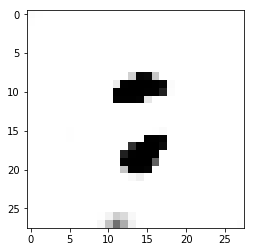

index no: 1


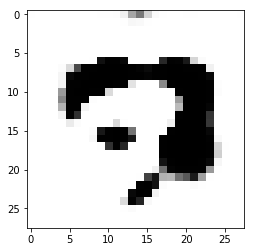

epoch no: 462
index no: 0


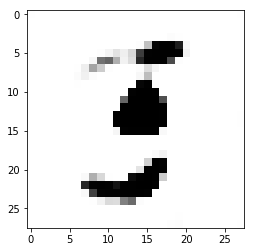

index no: 1


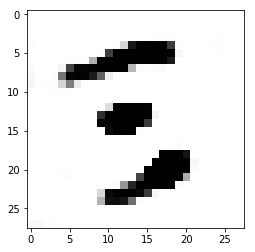

epoch no: 463
index no: 0


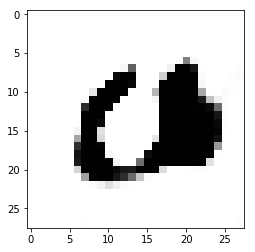

index no: 1


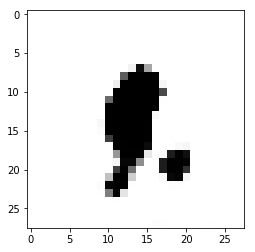

epoch no: 464
index no: 0


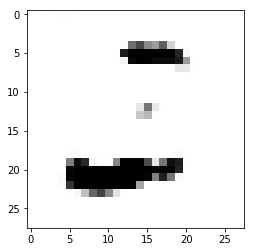

index no: 1


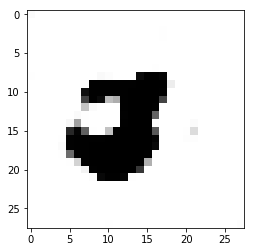

epoch no: 465
index no: 0


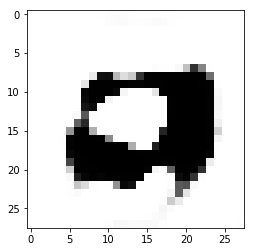

index no: 1


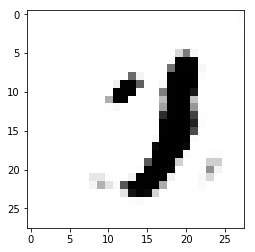

epoch no: 466
index no: 0


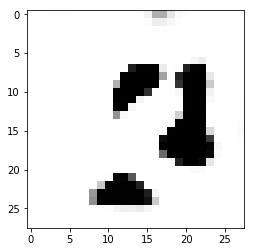

index no: 1


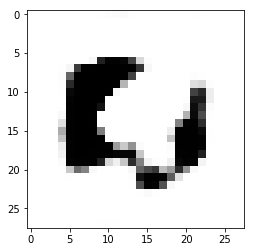

epoch no: 467
index no: 0


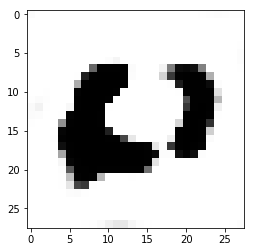

index no: 1


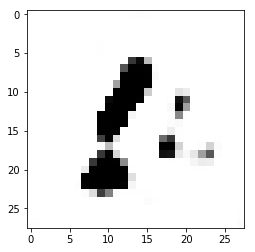

epoch no: 468
index no: 0


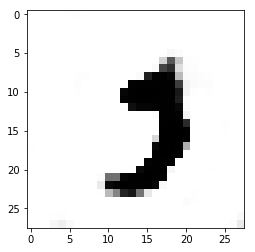

index no: 1


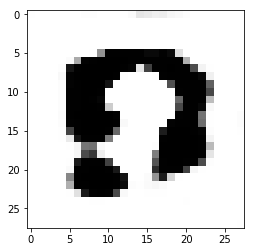

epoch no: 469
index no: 0


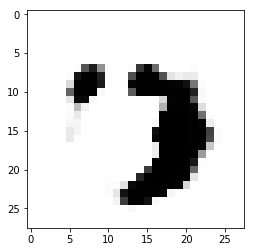

index no: 1


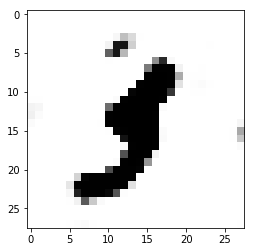

epoch no: 470
index no: 0


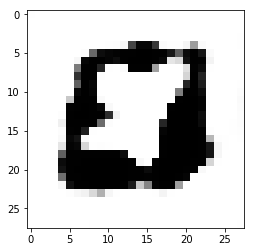

index no: 1


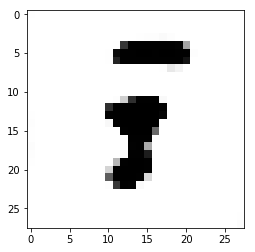

epoch no: 471
index no: 0


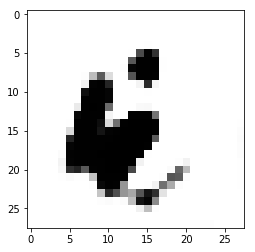

index no: 1


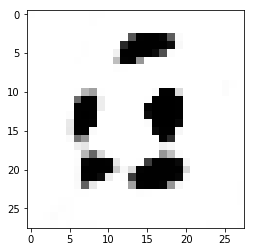

epoch no: 472
index no: 0


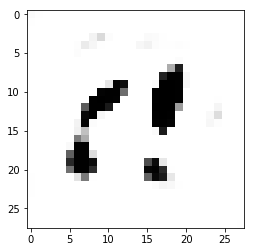

index no: 1


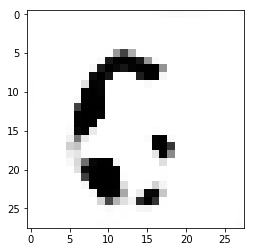

epoch no: 473
index no: 0


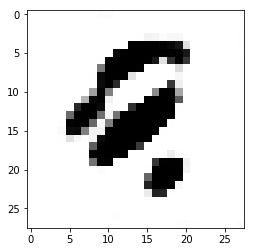

index no: 1


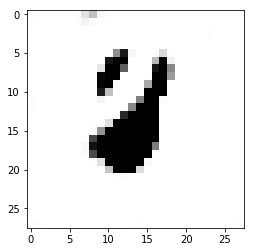

epoch no: 474
index no: 0


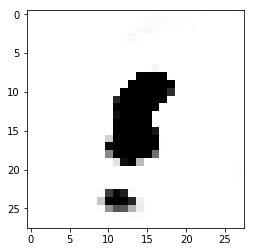

index no: 1


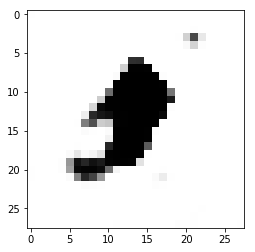

epoch no: 475
index no: 0


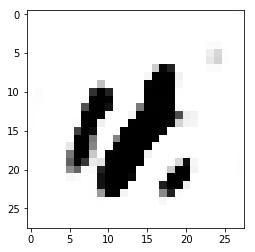

index no: 1


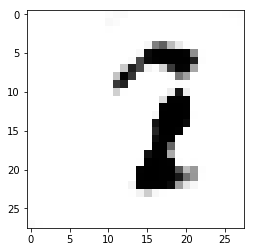

epoch no: 476
index no: 0


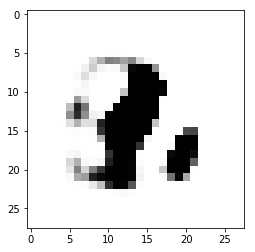

index no: 1


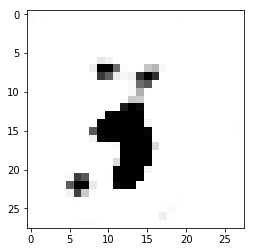

epoch no: 477
index no: 0


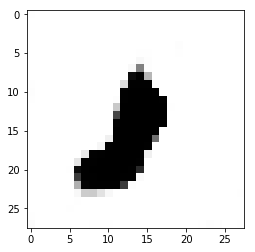

index no: 1


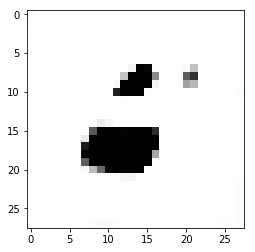

epoch no: 478
index no: 0


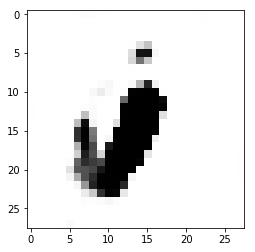

index no: 1


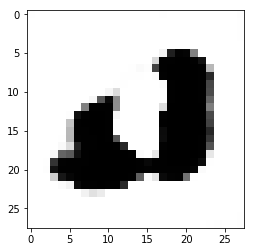

epoch no: 479
index no: 0


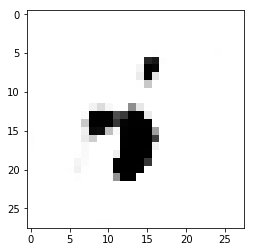

index no: 1


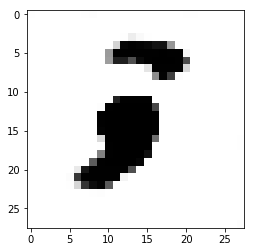

epoch no: 480
index no: 0


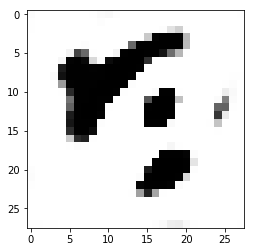

index no: 1


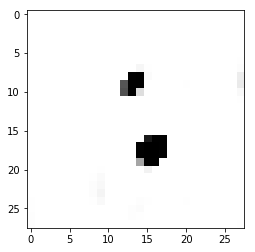

epoch no: 481
index no: 0


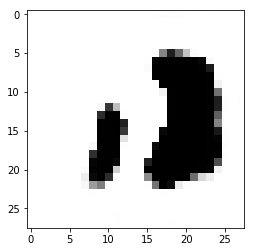

index no: 1


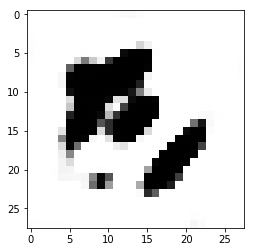

epoch no: 482
index no: 0


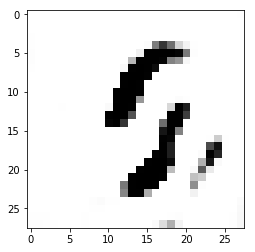

index no: 1


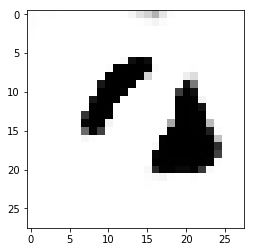

epoch no: 483
index no: 0


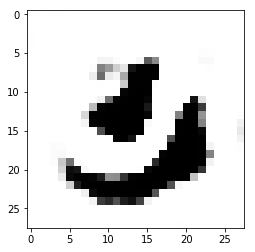

index no: 1


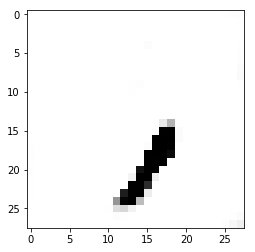

epoch no: 484
index no: 0


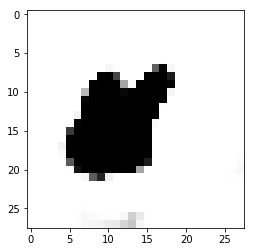

index no: 1


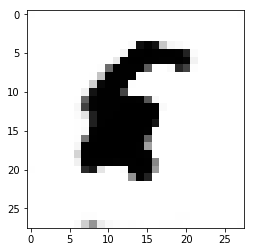

epoch no: 485
index no: 0


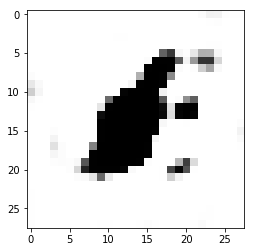

index no: 1


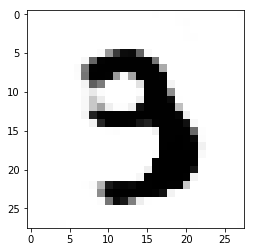

epoch no: 486
index no: 0


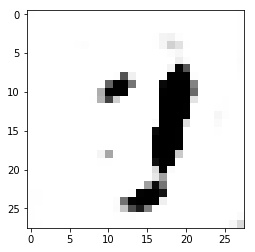

index no: 1


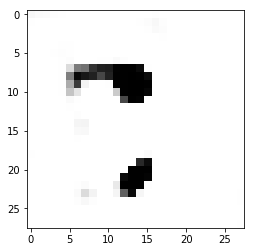

epoch no: 487
index no: 0


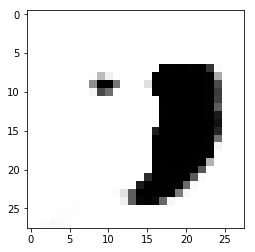

index no: 1


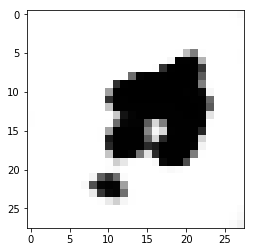

epoch no: 488
index no: 0


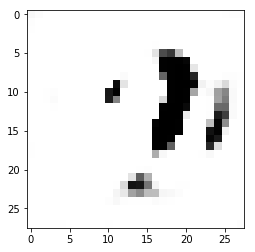

index no: 1


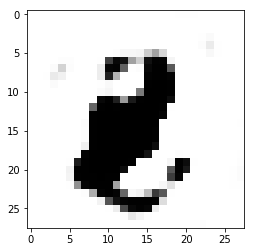

epoch no: 489
index no: 0


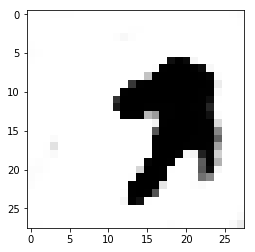

index no: 1


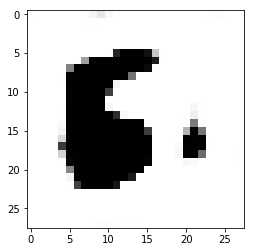

epoch no: 490
index no: 0


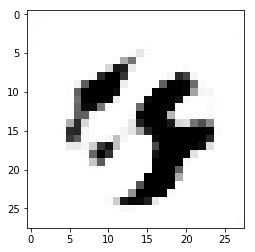

index no: 1


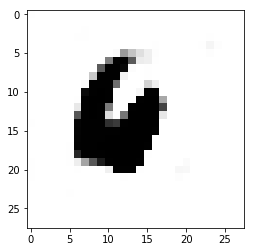

epoch no: 491
index no: 0


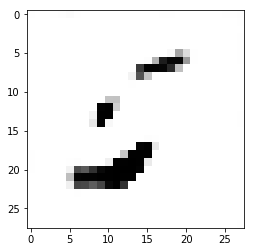

index no: 1


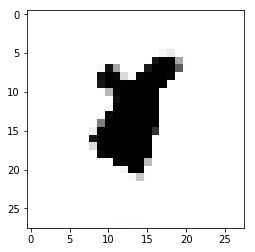

epoch no: 492
index no: 0


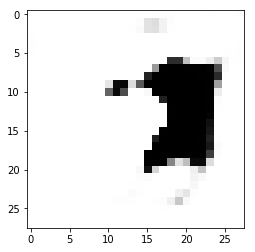

index no: 1


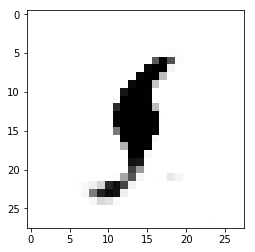

epoch no: 493
index no: 0


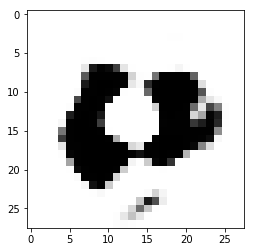

index no: 1


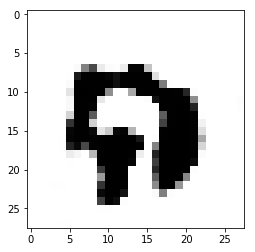

epoch no: 494
index no: 0


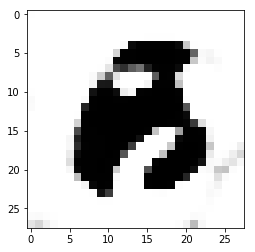

index no: 1


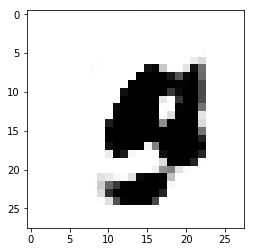

epoch no: 495
index no: 0


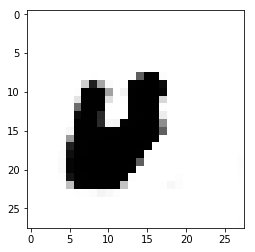

index no: 1


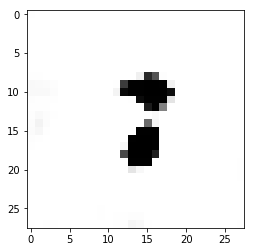

epoch no: 496
index no: 0


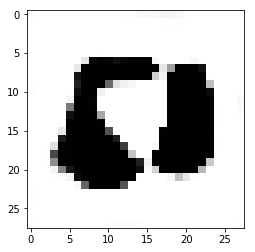

index no: 1


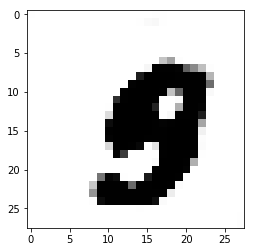

epoch no: 497
index no: 0


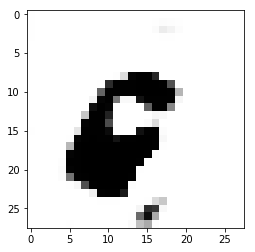

index no: 1


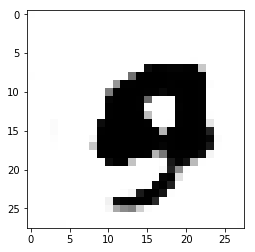

epoch no: 498
index no: 0


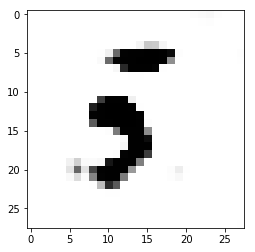

index no: 1


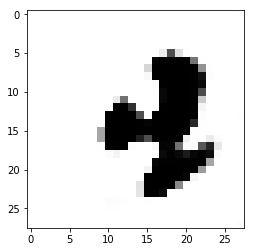

epoch no: 499
index no: 0


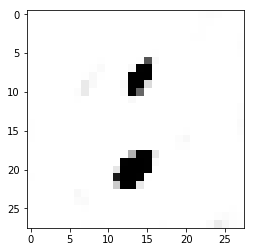

index no: 1


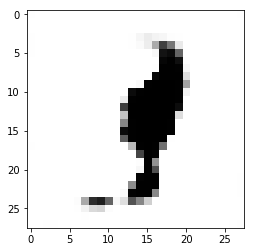

epoch no: 500
index no: 0


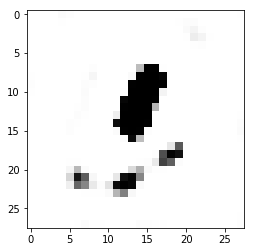

index no: 1


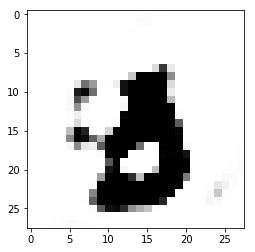

epoch no: 501
index no: 0


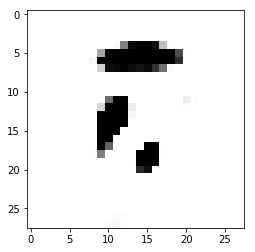

index no: 1


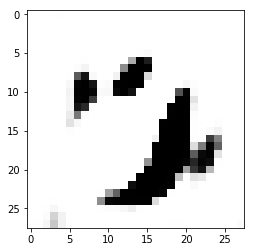

epoch no: 502
index no: 0


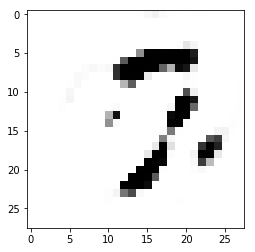

index no: 1


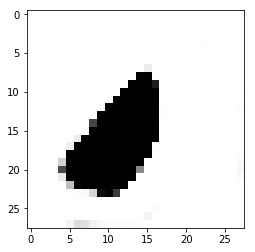

epoch no: 503
index no: 0


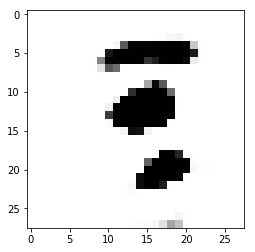

index no: 1


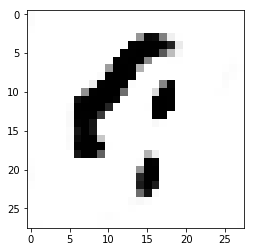

epoch no: 504
index no: 0


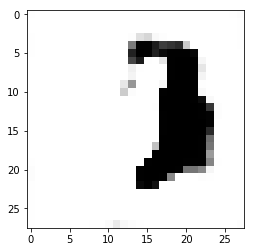

index no: 1


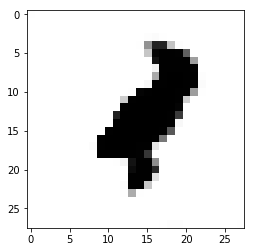

epoch no: 505
index no: 0


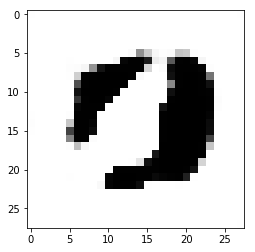

index no: 1


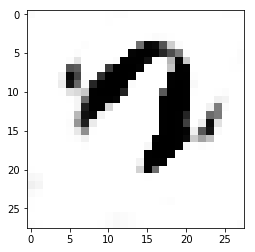

epoch no: 506
index no: 0


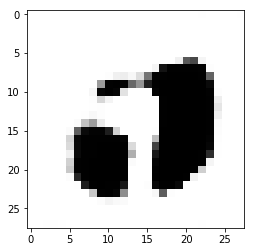

index no: 1


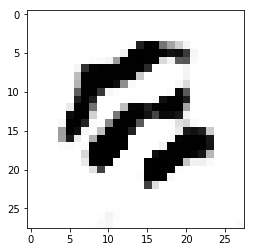

epoch no: 507
index no: 0


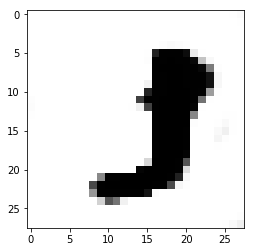

index no: 1


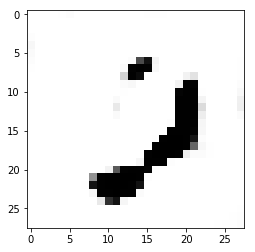

epoch no: 508
index no: 0


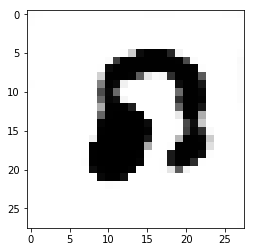

index no: 1


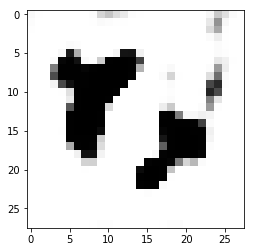

epoch no: 509
index no: 0


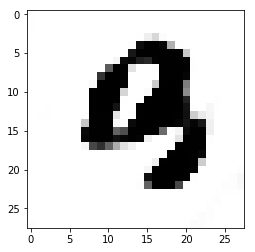

index no: 1


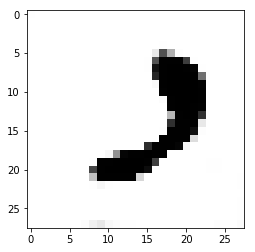

epoch no: 510
index no: 0


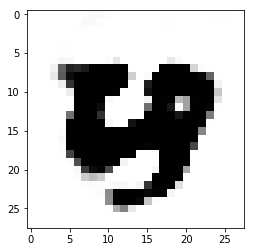

index no: 1


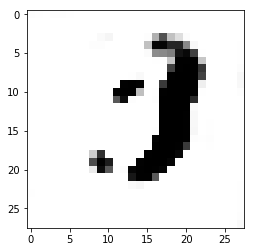

epoch no: 511
index no: 0


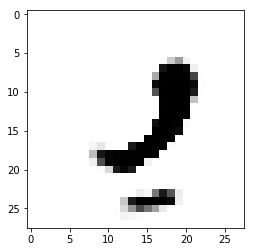

index no: 1


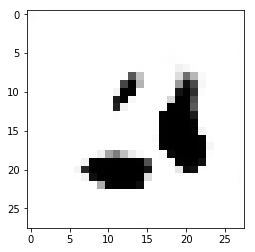

epoch no: 512
index no: 0


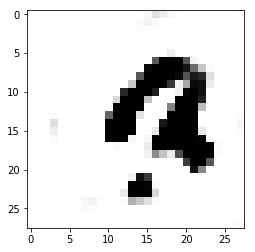

index no: 1


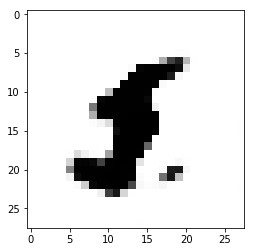

epoch no: 513
index no: 0


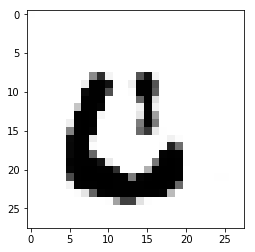

index no: 1


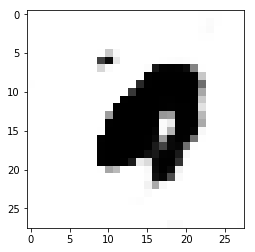

epoch no: 514
index no: 0


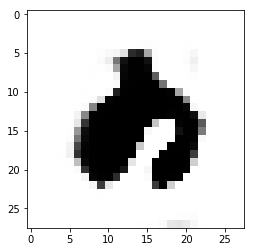

index no: 1


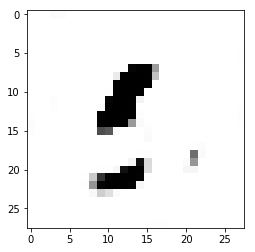

epoch no: 515
index no: 0


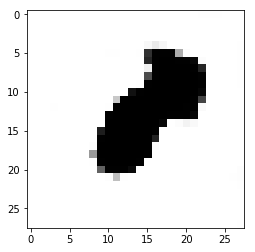

index no: 1


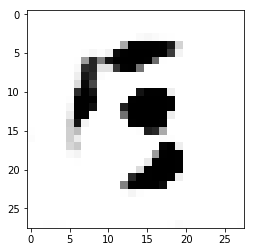

epoch no: 516
index no: 0


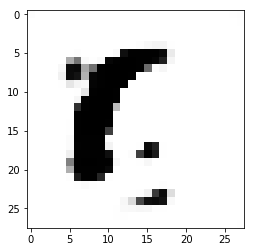

index no: 1


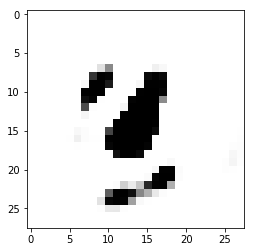

epoch no: 517
index no: 0


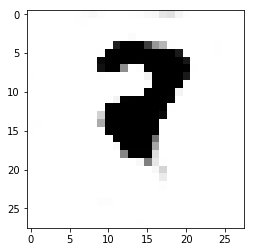

index no: 1


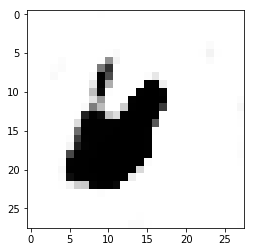

epoch no: 518
index no: 0


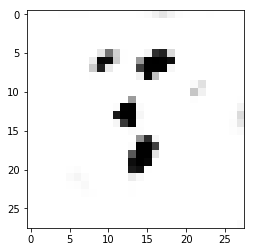

index no: 1


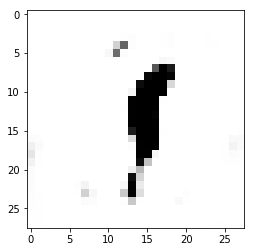

epoch no: 519
index no: 0


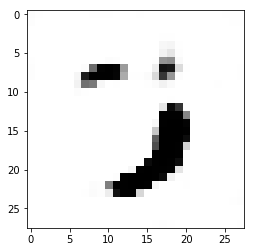

index no: 1


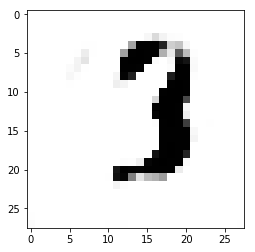

epoch no: 520
index no: 0


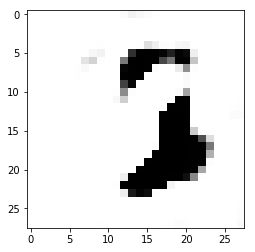

index no: 1


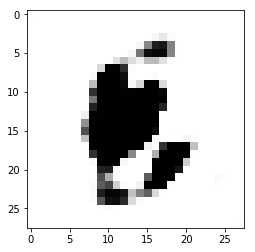

epoch no: 521
index no: 0


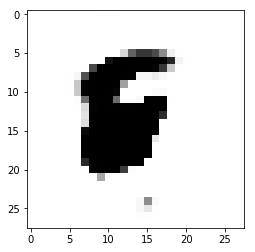

index no: 1


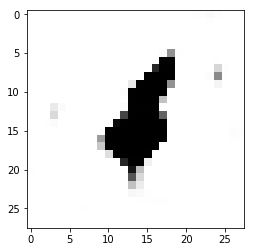

epoch no: 522
index no: 0


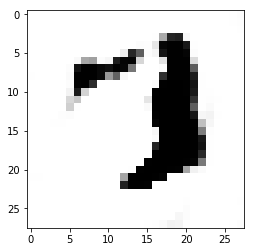

index no: 1


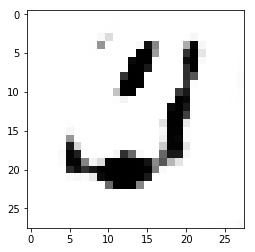

epoch no: 523
index no: 0


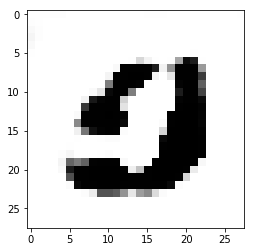

index no: 1


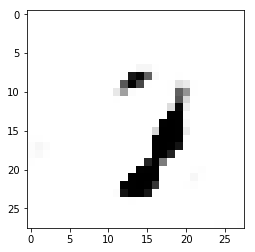

epoch no: 524
index no: 0


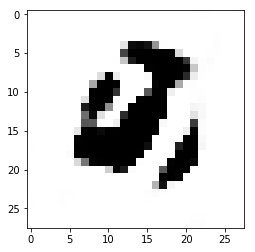

index no: 1


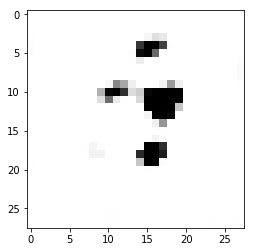

epoch no: 525
index no: 0


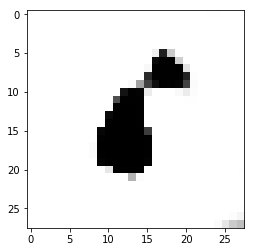

index no: 1


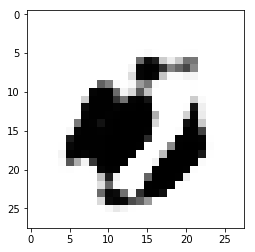

epoch no: 526
index no: 0


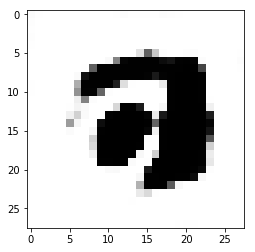

index no: 1


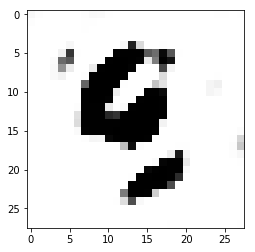

epoch no: 527
index no: 0


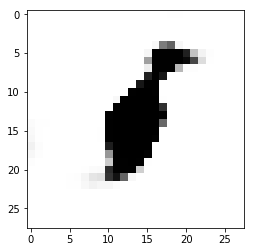

index no: 1


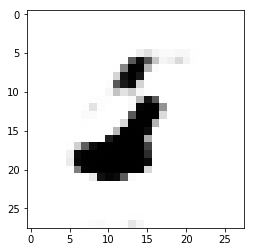

epoch no: 528
index no: 0


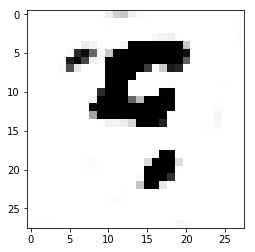

index no: 1


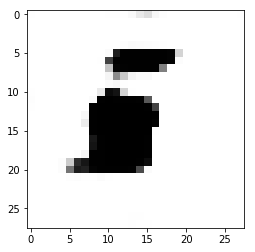

epoch no: 529
index no: 0


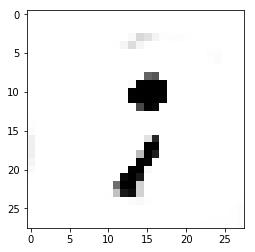

index no: 1


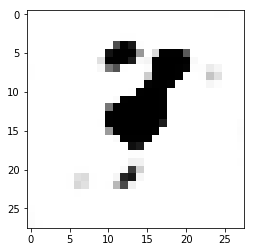

epoch no: 530
index no: 0


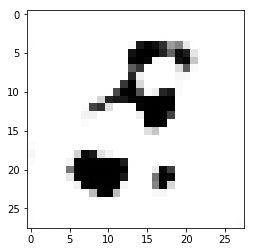

index no: 1


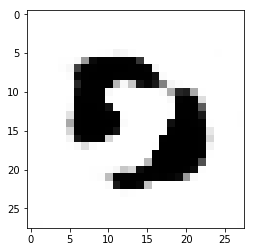

epoch no: 531
index no: 0


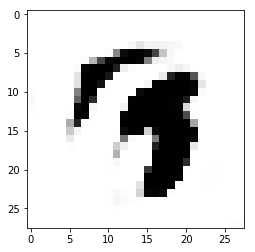

index no: 1


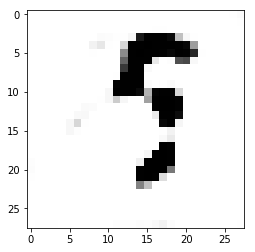

epoch no: 532
index no: 0


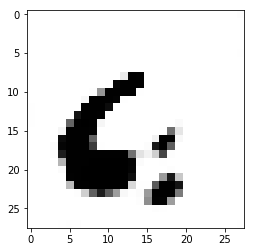

index no: 1


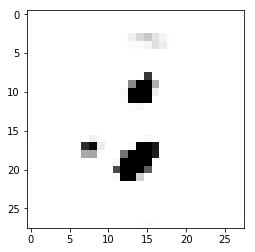

epoch no: 533
index no: 0


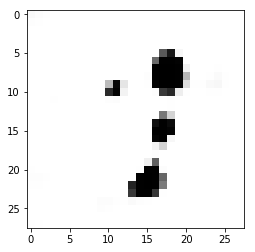

index no: 1


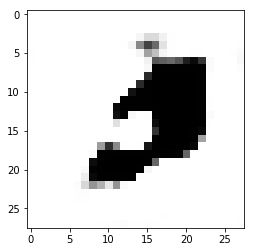

epoch no: 534
index no: 0


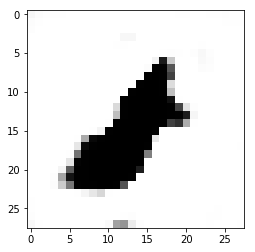

index no: 1


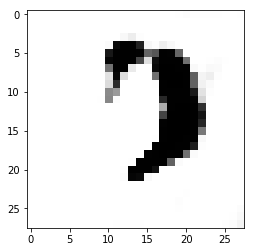

epoch no: 535
index no: 0


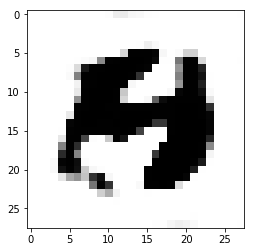

index no: 1


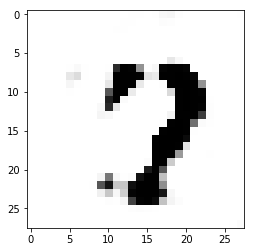

epoch no: 536
index no: 0


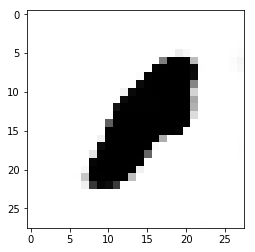

index no: 1


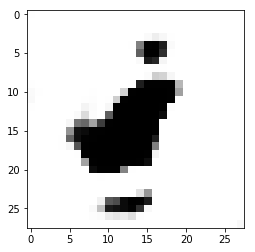

epoch no: 537
index no: 0


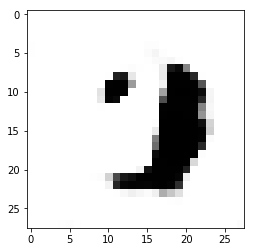

index no: 1


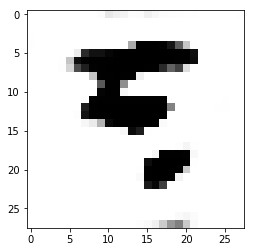

epoch no: 538
index no: 0


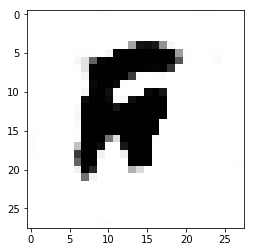

index no: 1


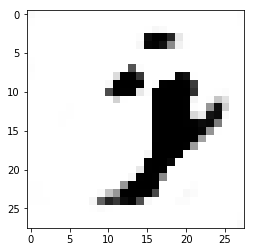

epoch no: 539
index no: 0


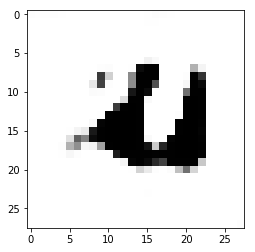

index no: 1


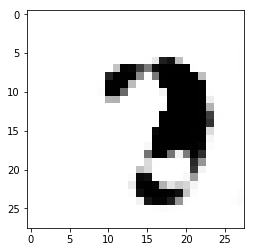

epoch no: 540
index no: 0


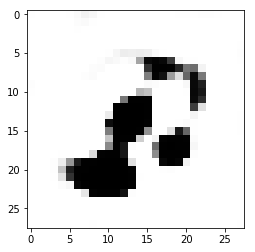

index no: 1


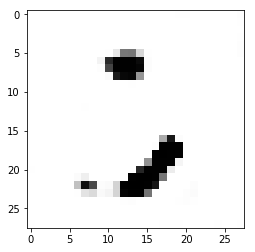

epoch no: 541
index no: 0


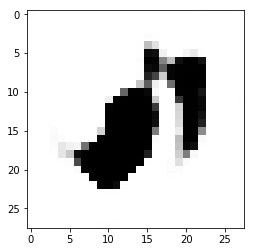

index no: 1


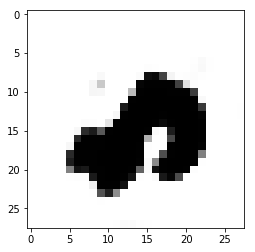

epoch no: 542
index no: 0


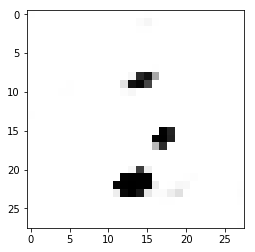

index no: 1


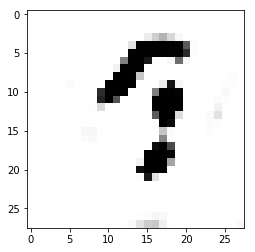

epoch no: 543
index no: 0


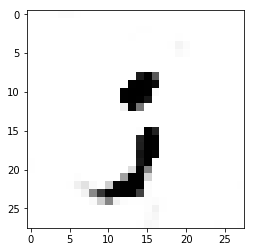

index no: 1


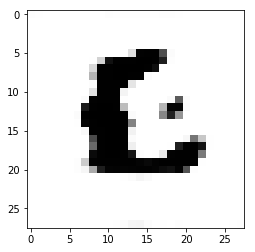

epoch no: 544
index no: 0


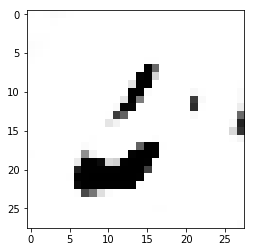

index no: 1


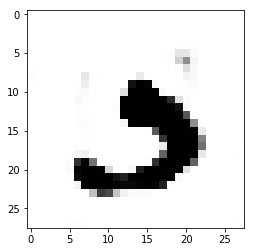

epoch no: 545
index no: 0


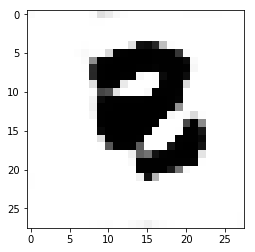

index no: 1


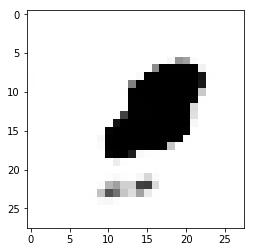

epoch no: 546
index no: 0


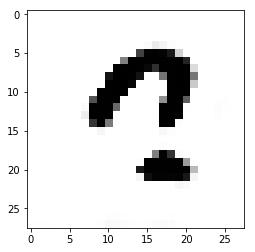

index no: 1


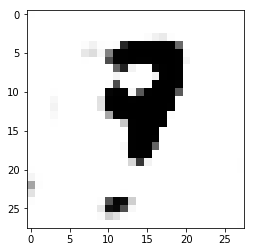

epoch no: 547
index no: 0


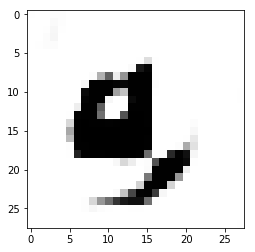

index no: 1


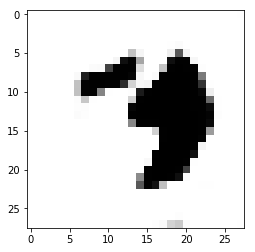

epoch no: 548
index no: 0


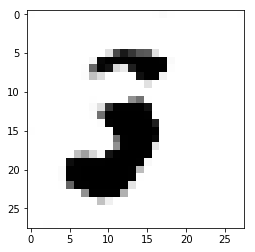

index no: 1


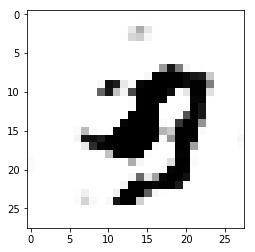

epoch no: 549
index no: 0


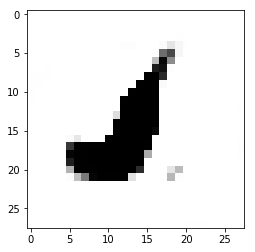

index no: 1


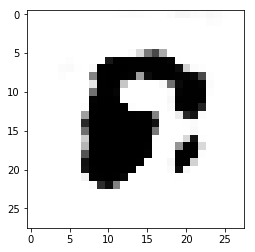

epoch no: 550
index no: 0


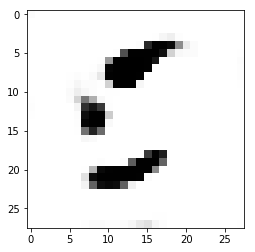

index no: 1


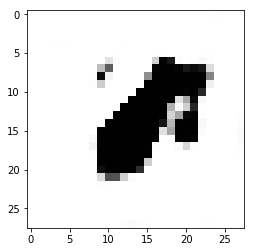

epoch no: 551
index no: 0


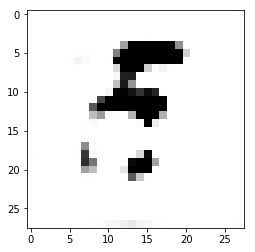

index no: 1


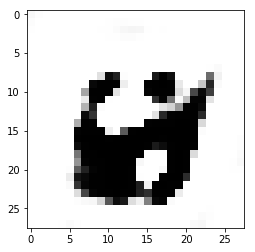

epoch no: 552
index no: 0


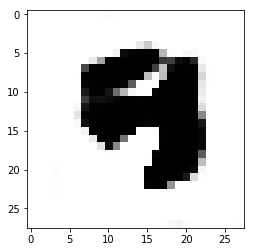

index no: 1


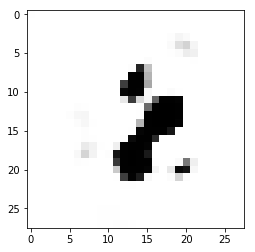

epoch no: 553
index no: 0


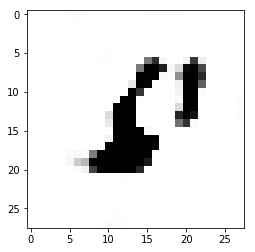

index no: 1


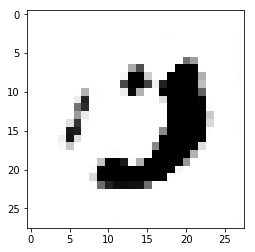

epoch no: 554
index no: 0


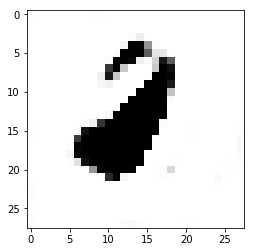

index no: 1


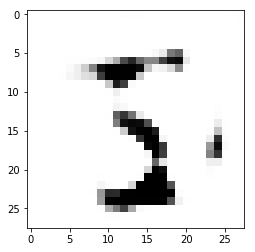

epoch no: 555
index no: 0


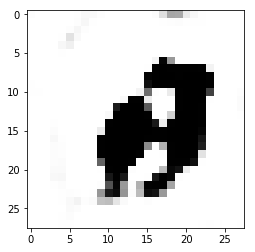

index no: 1


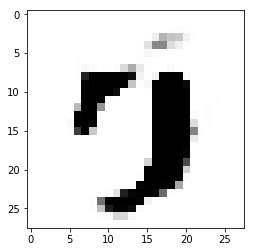

epoch no: 556
index no: 0


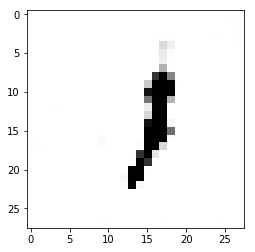

index no: 1


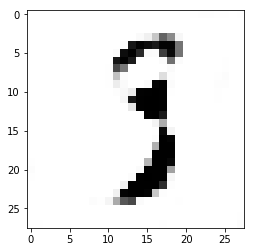

epoch no: 557
index no: 0


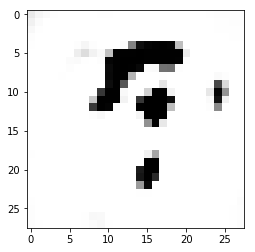

index no: 1


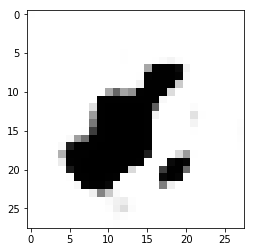

epoch no: 558
index no: 0


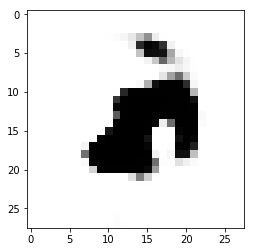

index no: 1


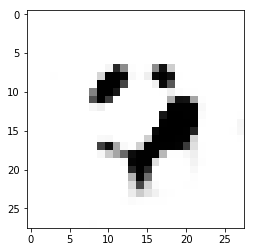

epoch no: 559
index no: 0


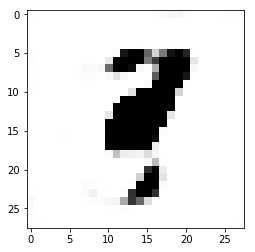

index no: 1


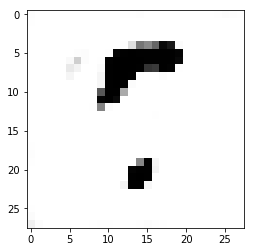

epoch no: 560
index no: 0


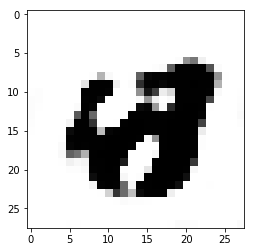

index no: 1


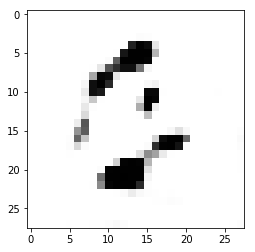

epoch no: 561
index no: 0


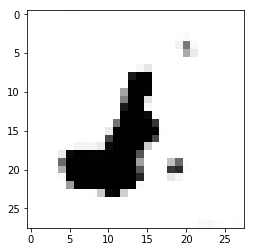

index no: 1


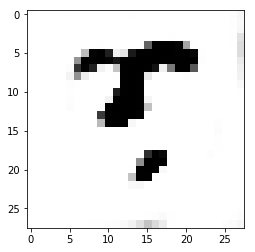

epoch no: 562
index no: 0


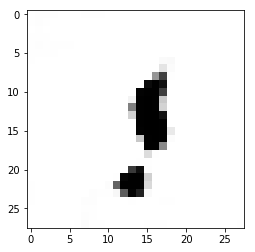

index no: 1


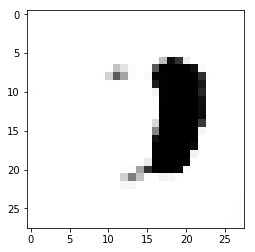

epoch no: 563
index no: 0


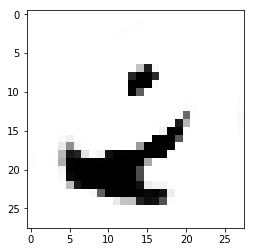

index no: 1


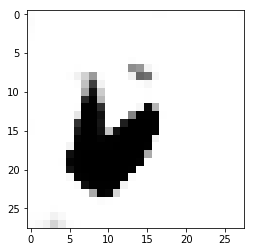

epoch no: 564
index no: 0


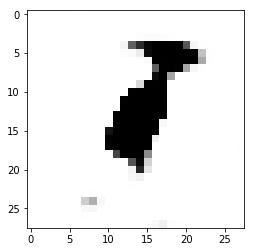

index no: 1


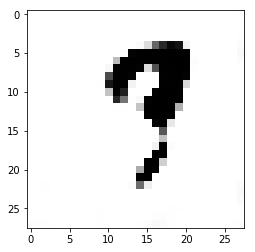

epoch no: 565
index no: 0


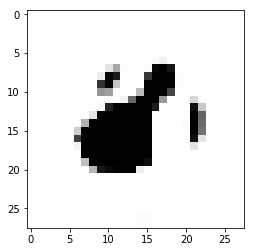

index no: 1


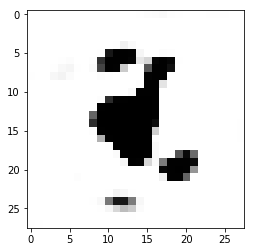

epoch no: 566
index no: 0


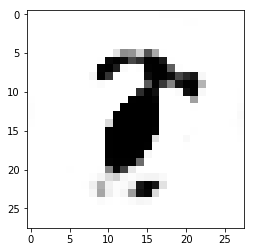

index no: 1


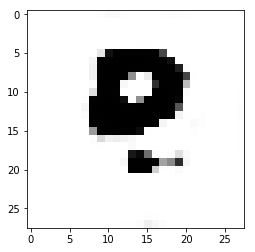

epoch no: 567
index no: 0


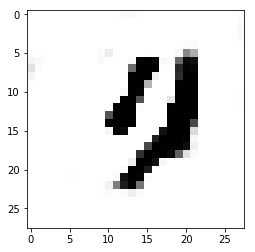

index no: 1


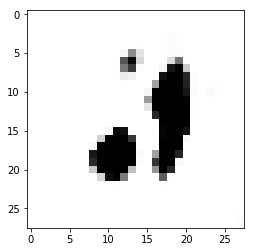

epoch no: 568
index no: 0


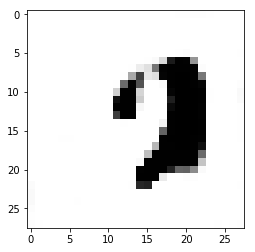

index no: 1


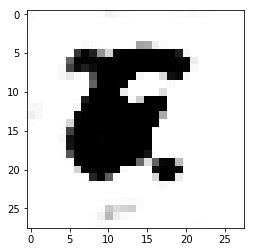

epoch no: 569
index no: 0


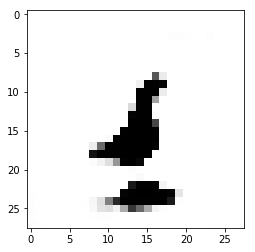

index no: 1


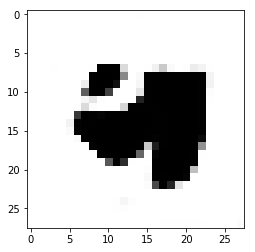

epoch no: 570
index no: 0


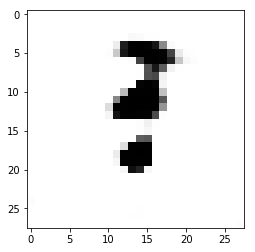

index no: 1


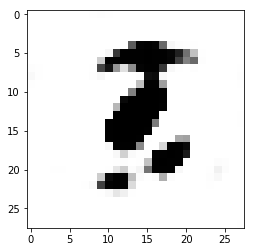

epoch no: 571
index no: 0


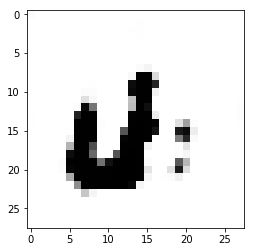

index no: 1


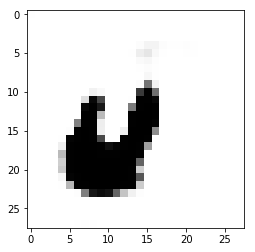

epoch no: 572
index no: 0


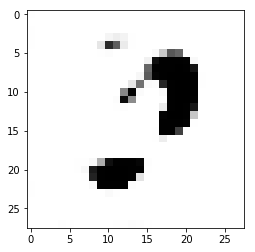

index no: 1


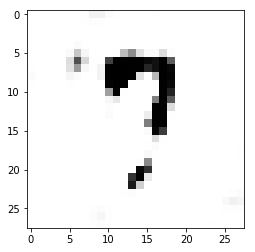

epoch no: 573
index no: 0


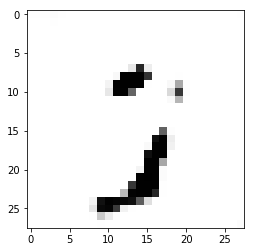

index no: 1


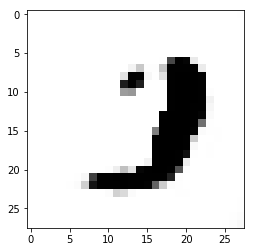

epoch no: 574
index no: 0


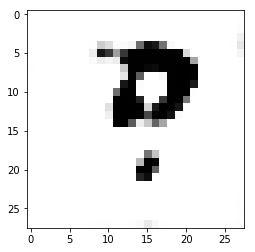

index no: 1


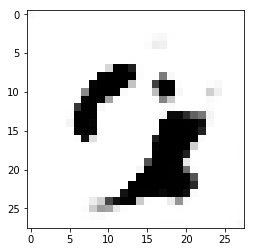

epoch no: 575
index no: 0


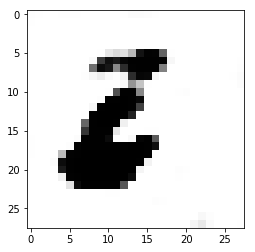

index no: 1


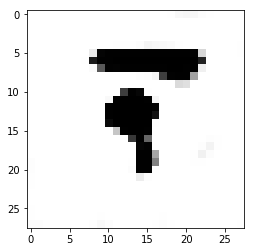

epoch no: 576
index no: 0


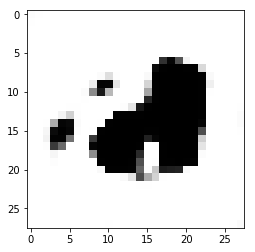

index no: 1


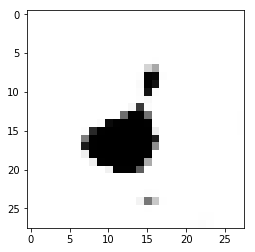

epoch no: 577
index no: 0


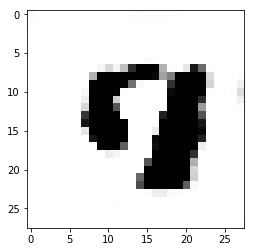

index no: 1


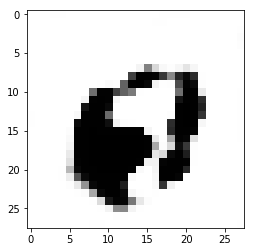

epoch no: 578
index no: 0


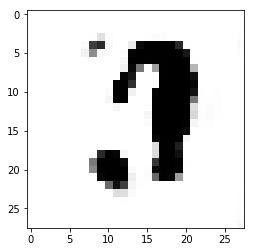

index no: 1


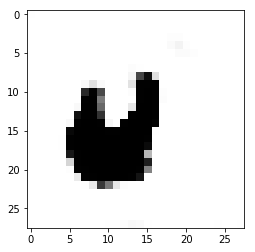

epoch no: 579
index no: 0


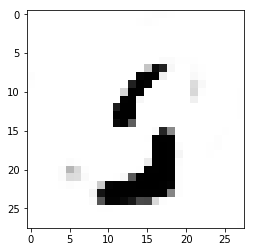

index no: 1


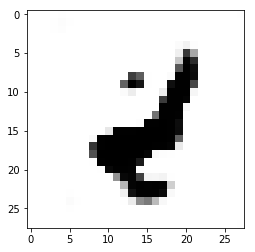

epoch no: 580
index no: 0


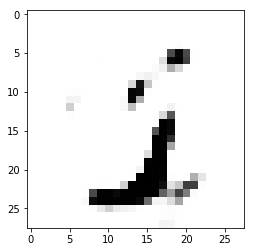

index no: 1


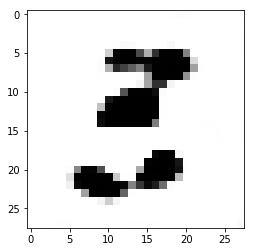

epoch no: 581
index no: 0


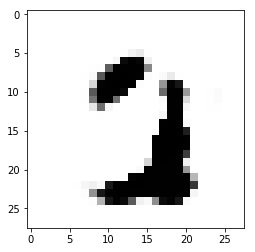

index no: 1


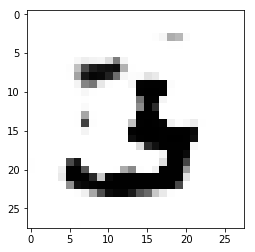

epoch no: 582
index no: 0


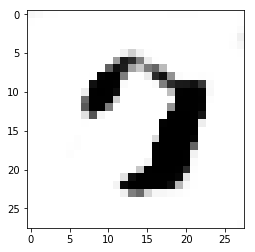

index no: 1


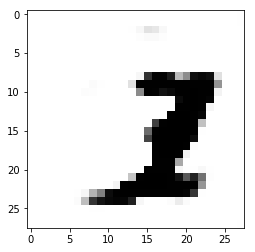

epoch no: 583
index no: 0


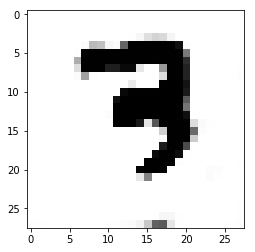

index no: 1


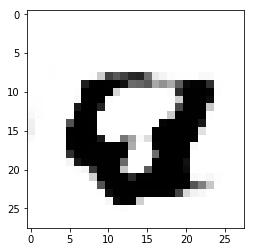

epoch no: 584
index no: 0


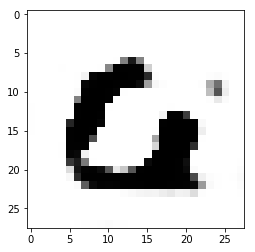

index no: 1


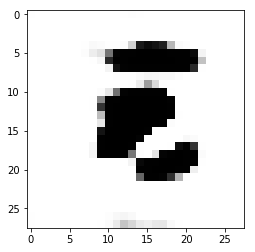

epoch no: 585
index no: 0


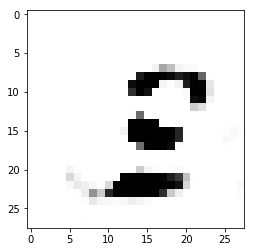

index no: 1


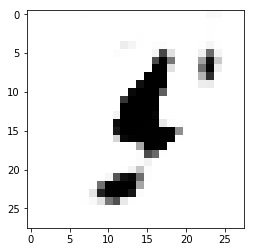

epoch no: 586
index no: 0


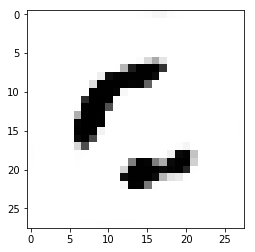

index no: 1


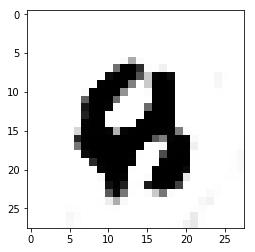

epoch no: 587
index no: 0


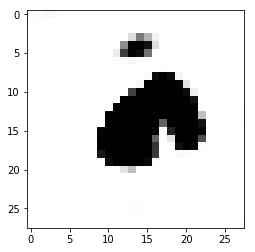

index no: 1


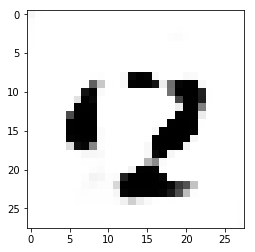

epoch no: 588
index no: 0


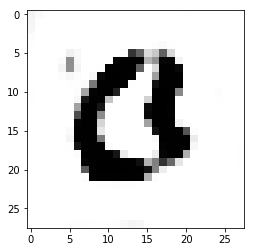

index no: 1


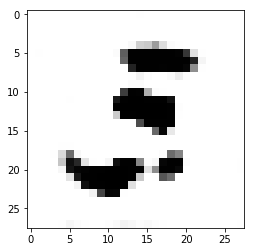

epoch no: 589
index no: 0


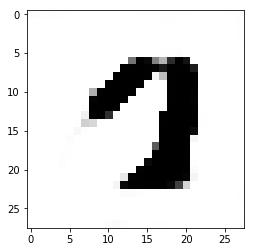

index no: 1


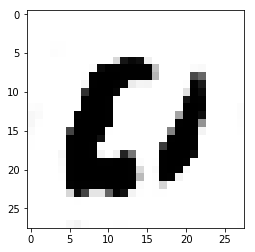

epoch no: 590
index no: 0


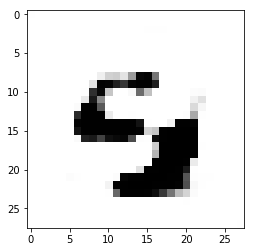

index no: 1


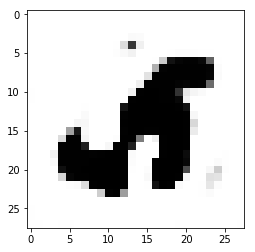

epoch no: 591
index no: 0


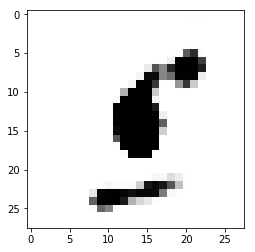

index no: 1


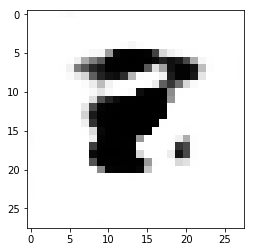

epoch no: 592
index no: 0


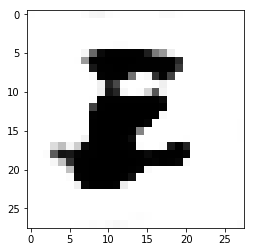

index no: 1


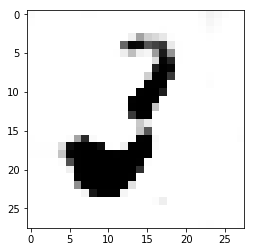

epoch no: 593
index no: 0


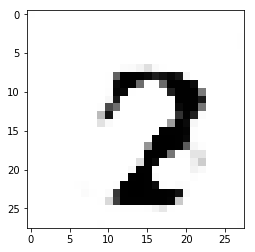

index no: 1


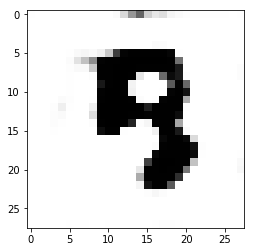

epoch no: 594
index no: 0


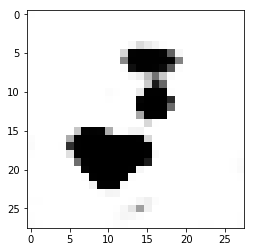

index no: 1


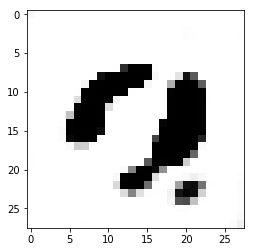

epoch no: 595
index no: 0


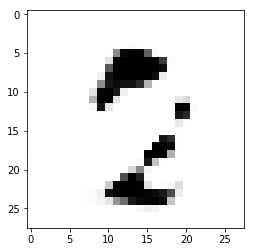

index no: 1


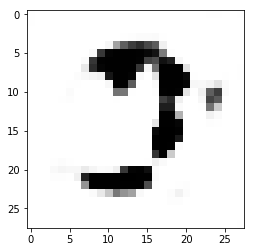

epoch no: 596
index no: 0


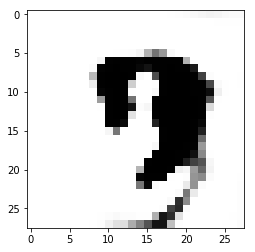

index no: 1


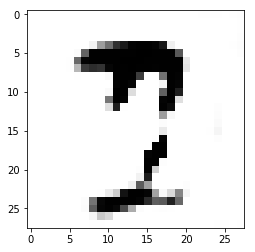

epoch no: 597
index no: 0


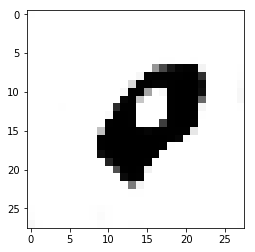

index no: 1


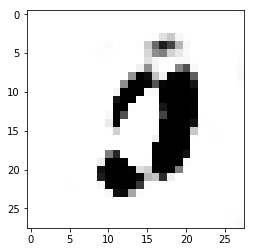

epoch no: 598
index no: 0


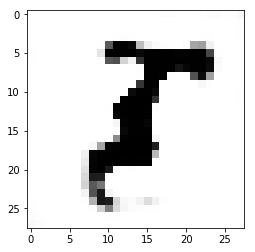

index no: 1


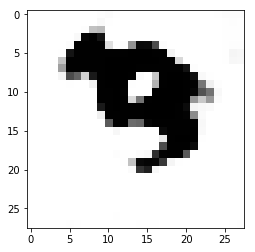

epoch no: 599
index no: 0


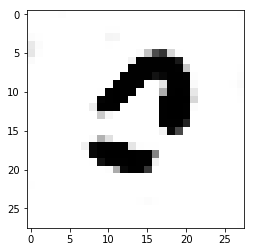

index no: 1


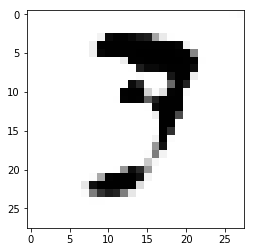

epoch no: 600
index no: 0


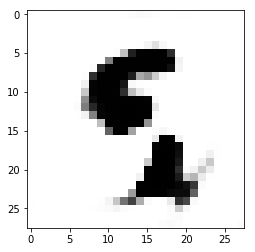

index no: 1


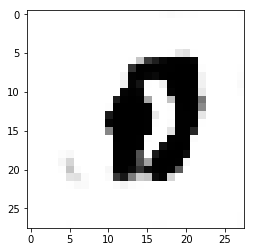

epoch no: 601
index no: 0


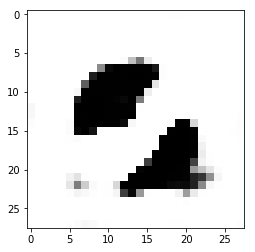

index no: 1


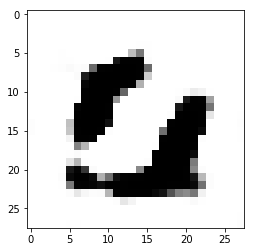

epoch no: 602
index no: 0


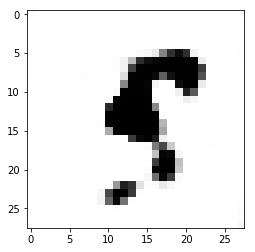

index no: 1


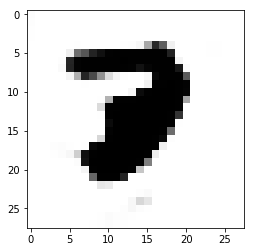

epoch no: 603
index no: 0


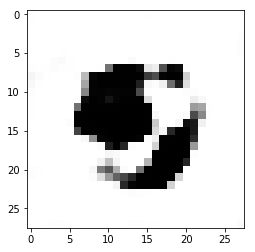

index no: 1


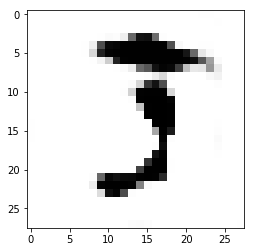

epoch no: 604
index no: 0


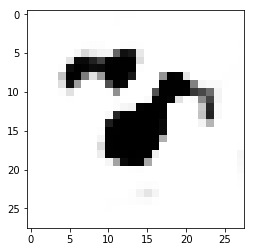

index no: 1


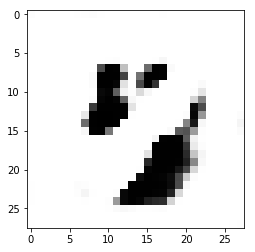

epoch no: 605
index no: 0


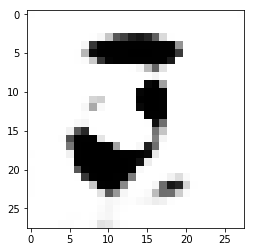

index no: 1


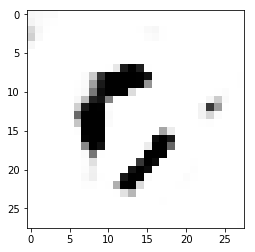

epoch no: 606
index no: 0


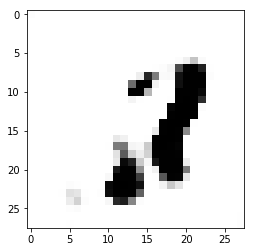

index no: 1


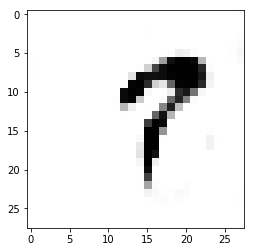

epoch no: 607
index no: 0


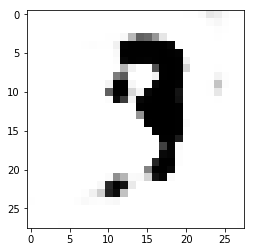

index no: 1


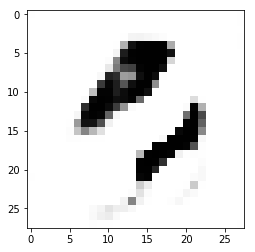

epoch no: 608
index no: 0


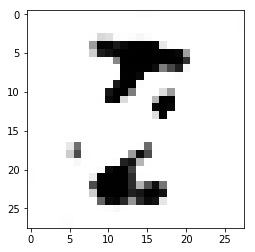

index no: 1


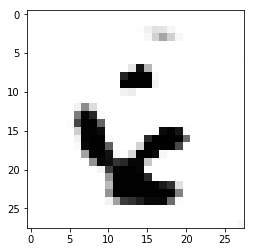

epoch no: 609
index no: 0


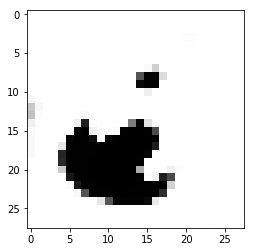

index no: 1


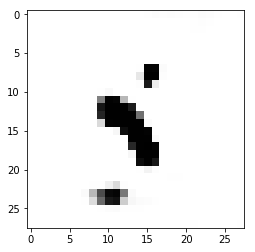

epoch no: 610
index no: 0


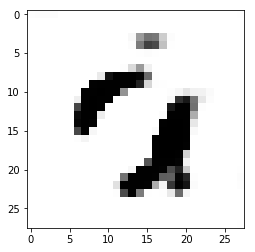

index no: 1


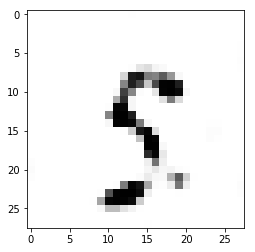

epoch no: 611
index no: 0


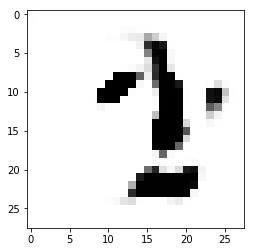

index no: 1


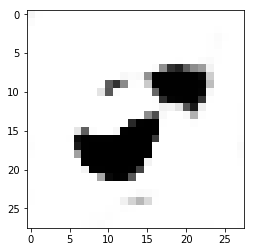

epoch no: 612
index no: 0


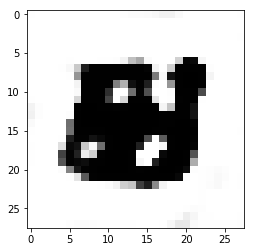

index no: 1


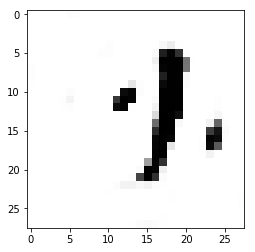

epoch no: 613
index no: 0


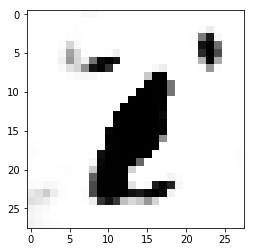

index no: 1


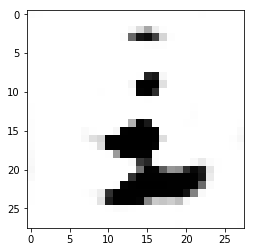

epoch no: 614
index no: 0


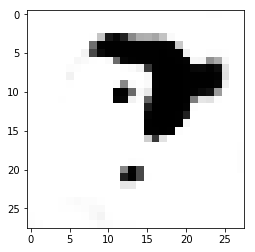

index no: 1


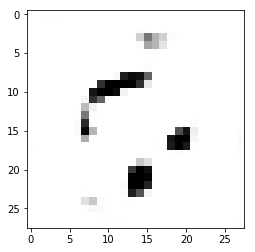

epoch no: 615
index no: 0


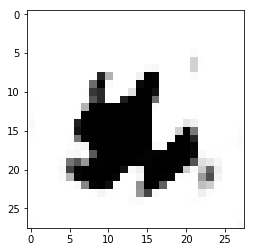

index no: 1


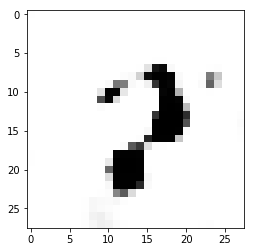

epoch no: 616
index no: 0


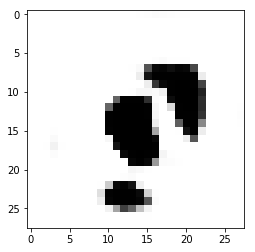

index no: 1


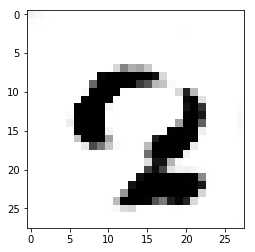

epoch no: 617
index no: 0


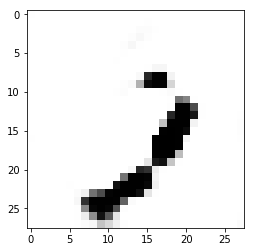

index no: 1


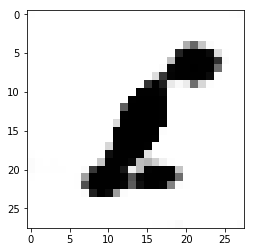

epoch no: 618
index no: 0


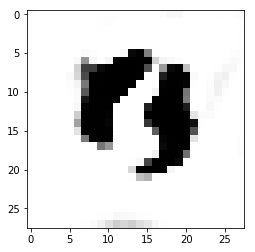

index no: 1


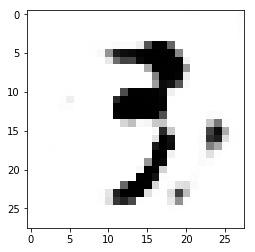

epoch no: 619
index no: 0


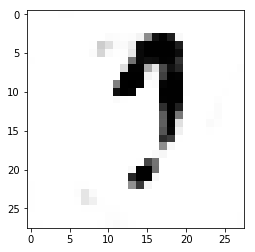

index no: 1


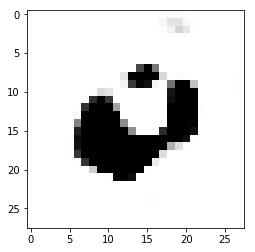

epoch no: 620
index no: 0


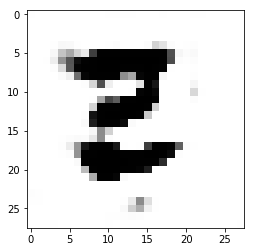

index no: 1


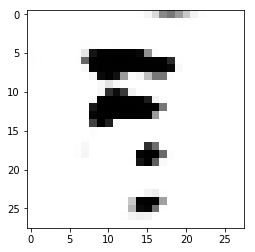

epoch no: 621
index no: 0


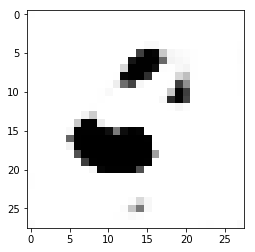

index no: 1


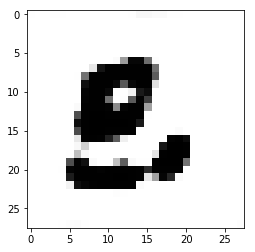

epoch no: 622
index no: 0


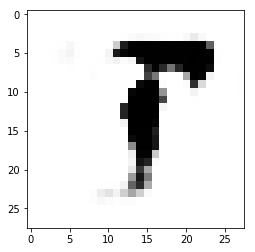

index no: 1


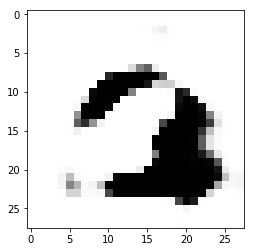

epoch no: 623
index no: 0


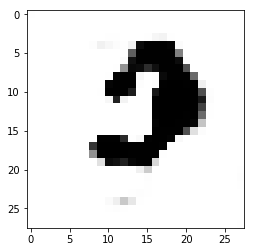

index no: 1


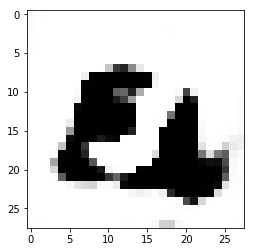

epoch no: 624
index no: 0


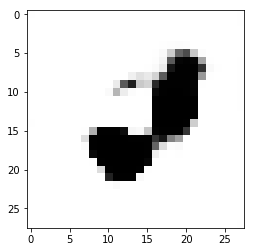

index no: 1


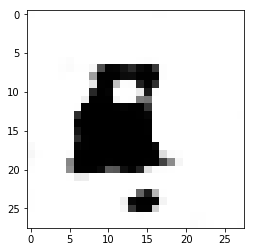

epoch no: 625
index no: 0


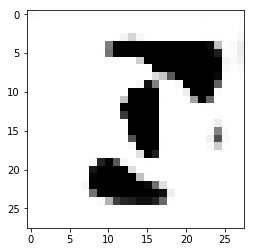

index no: 1


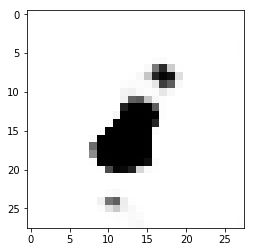

epoch no: 626
index no: 0


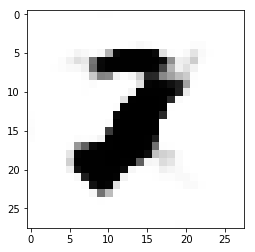

index no: 1


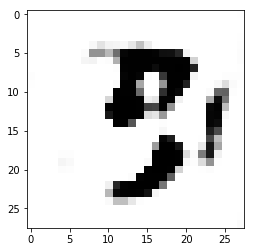

epoch no: 627
index no: 0


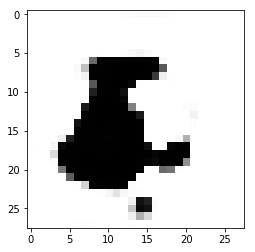

index no: 1


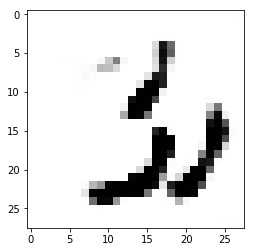

epoch no: 628
index no: 0


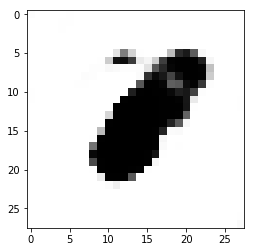

index no: 1


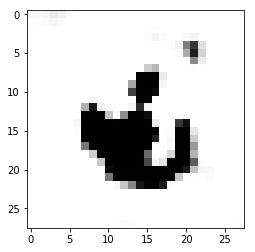

epoch no: 629
index no: 0


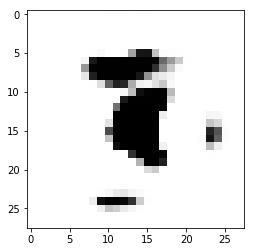

index no: 1


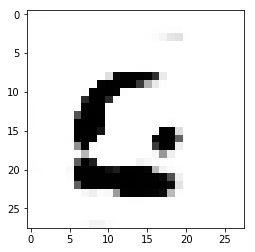

epoch no: 630
index no: 0


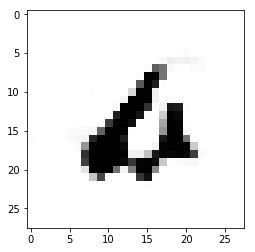

index no: 1


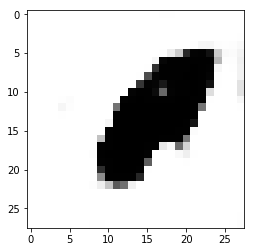

epoch no: 631
index no: 0


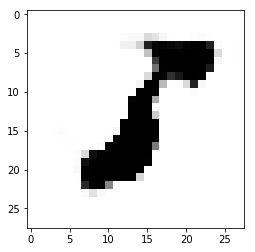

index no: 1


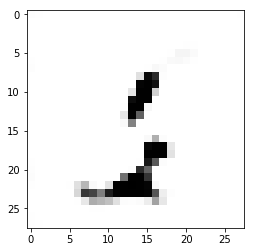

epoch no: 632
index no: 0


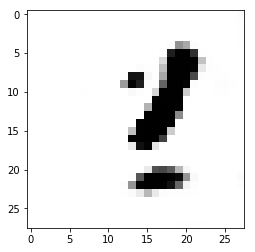

index no: 1


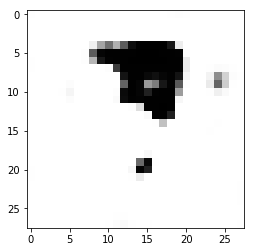

epoch no: 633
index no: 0


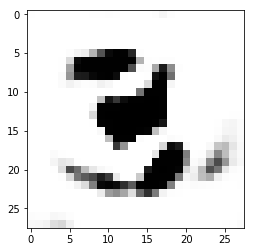

index no: 1


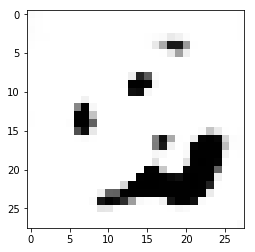

epoch no: 634
index no: 0


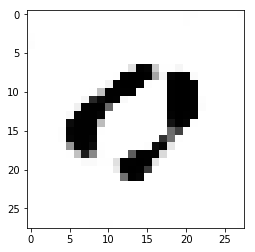

index no: 1


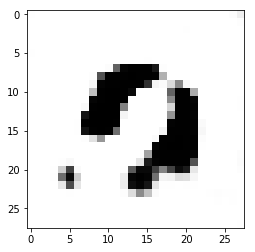

epoch no: 635
index no: 0


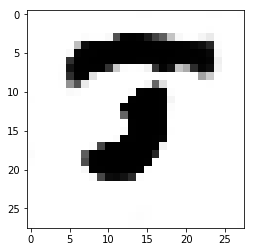

index no: 1


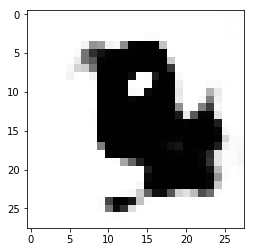

epoch no: 636
index no: 0


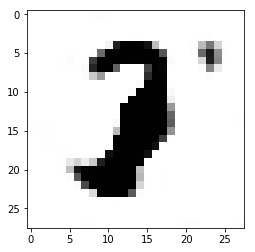

index no: 1


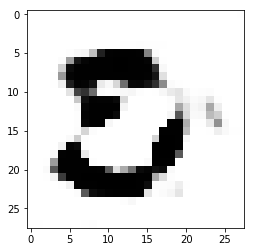

epoch no: 637
index no: 0


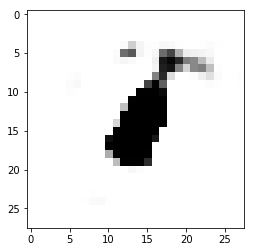

index no: 1


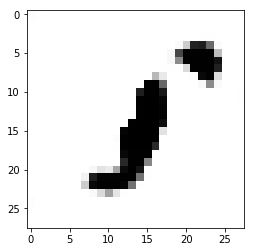

epoch no: 638
index no: 0


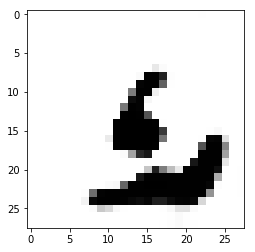

index no: 1


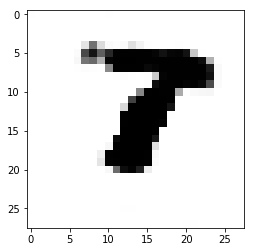

epoch no: 639
index no: 0


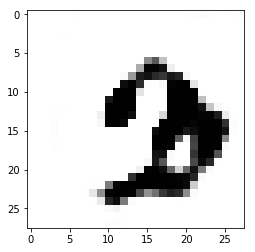

index no: 1


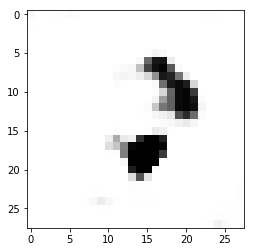

epoch no: 640
index no: 0


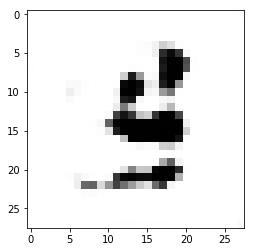

index no: 1


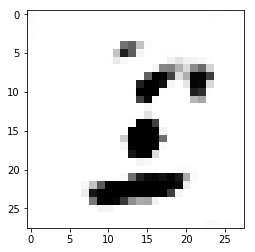

epoch no: 641
index no: 0


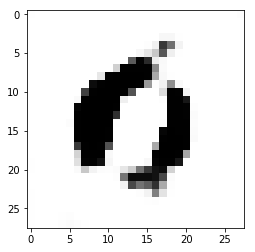

index no: 1


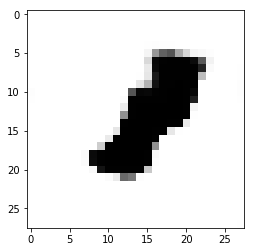

epoch no: 642
index no: 0


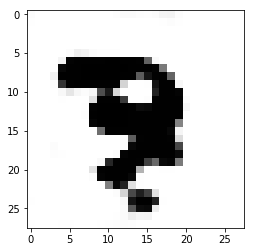

index no: 1


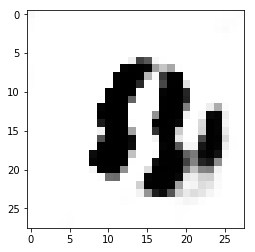

epoch no: 643
index no: 0


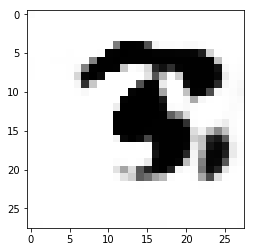

index no: 1


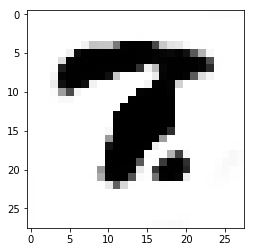

epoch no: 644
index no: 0


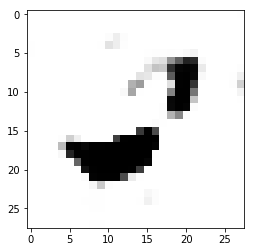

index no: 1


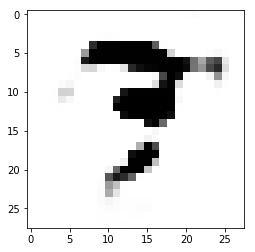

epoch no: 645
index no: 0


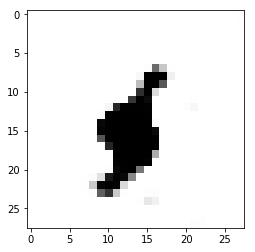

index no: 1


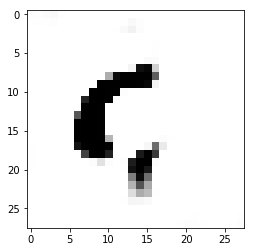

epoch no: 646
index no: 0


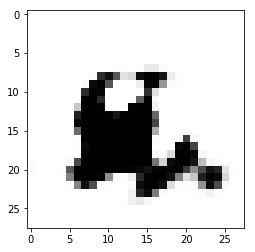

index no: 1


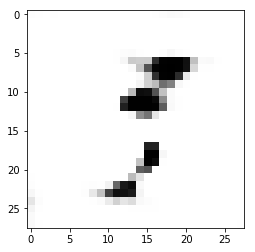

epoch no: 647
index no: 0


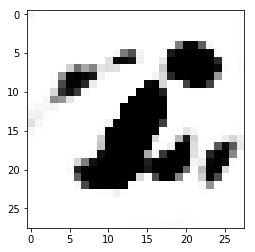

index no: 1


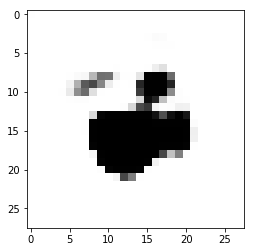

epoch no: 648
index no: 0


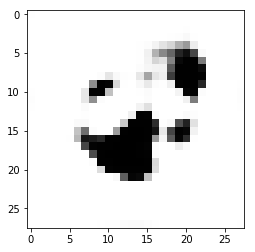

index no: 1


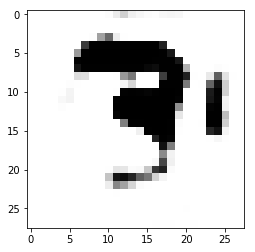

epoch no: 649
index no: 0


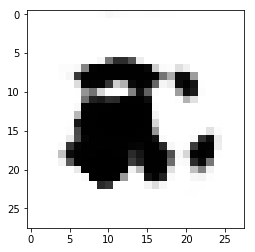

index no: 1


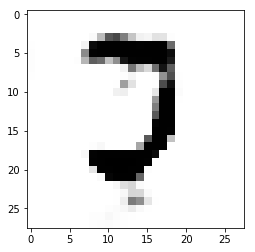

epoch no: 650
index no: 0


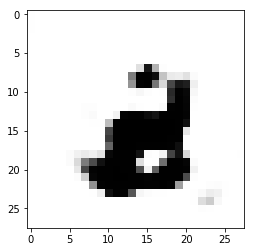

index no: 1


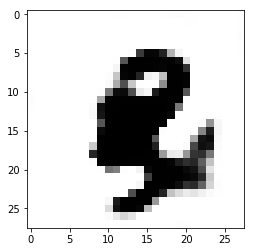

epoch no: 651
index no: 0


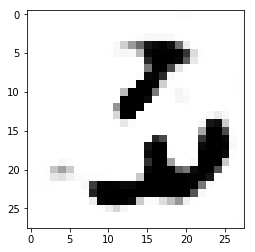

index no: 1


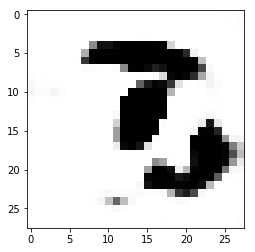

epoch no: 652
index no: 0


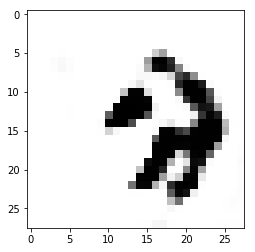

index no: 1


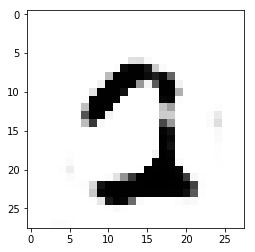

epoch no: 653
index no: 0


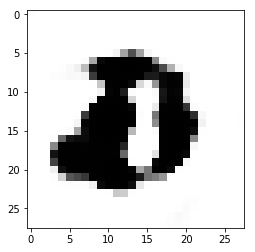

index no: 1


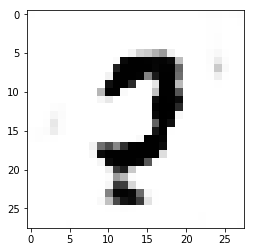

epoch no: 654
index no: 0


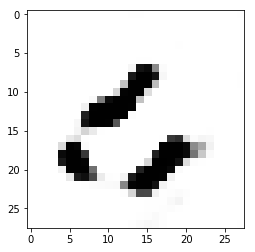

index no: 1


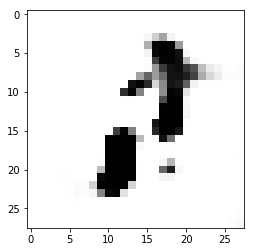

epoch no: 655
index no: 0


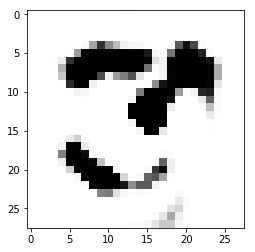

index no: 1


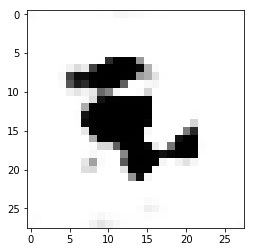

epoch no: 656
index no: 0


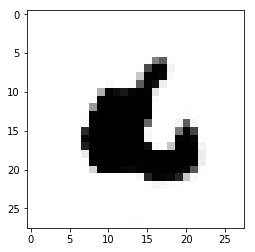

index no: 1


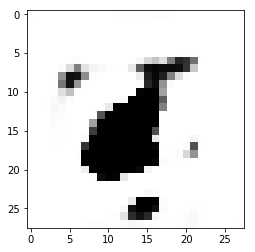

epoch no: 657
index no: 0


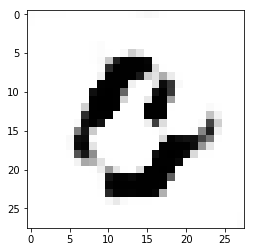

index no: 1


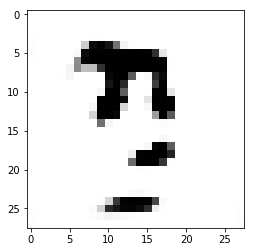

epoch no: 658
index no: 0


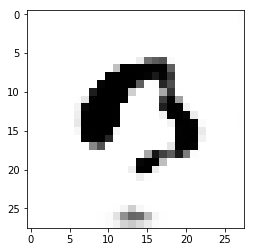

index no: 1


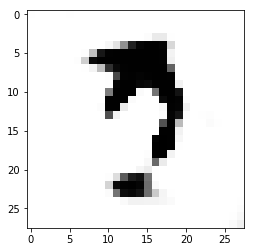

epoch no: 659
index no: 0


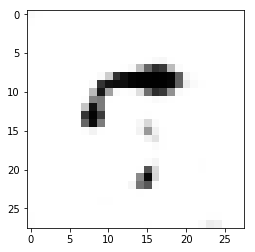

index no: 1


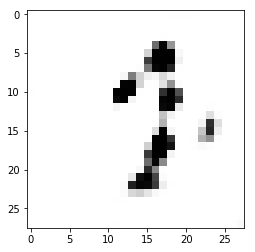

epoch no: 660
index no: 0


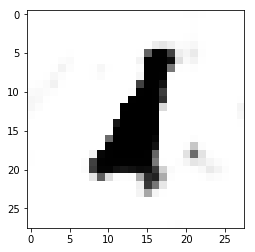

index no: 1


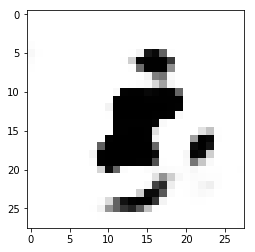

epoch no: 661
index no: 0


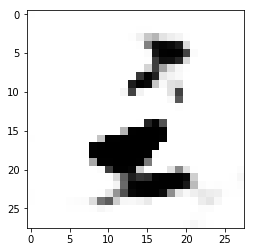

index no: 1


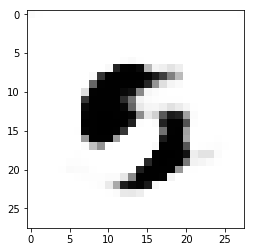

epoch no: 662
index no: 0


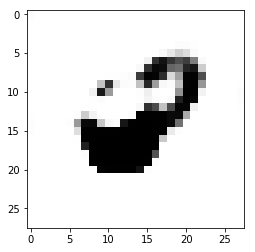

index no: 1


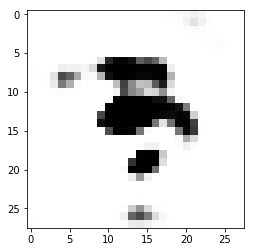

epoch no: 663
index no: 0


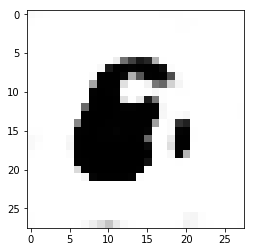

index no: 1


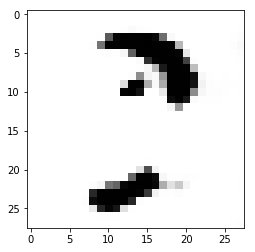

epoch no: 664
index no: 0


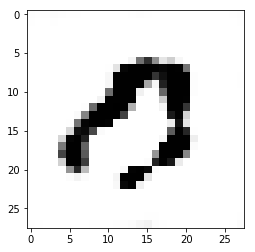

index no: 1


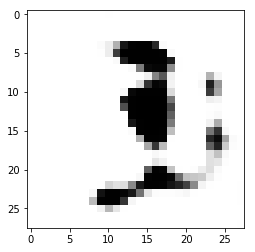

epoch no: 665
index no: 0


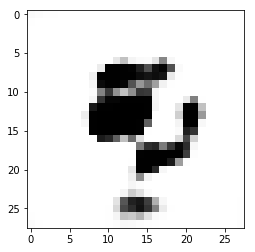

index no: 1


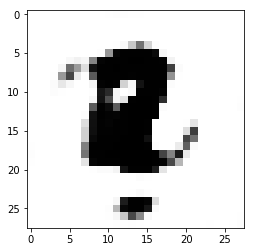

epoch no: 666
index no: 0


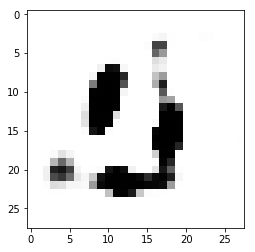

index no: 1


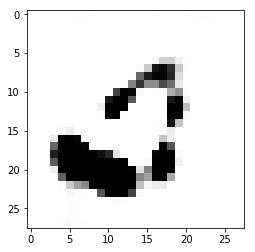

epoch no: 667
index no: 0


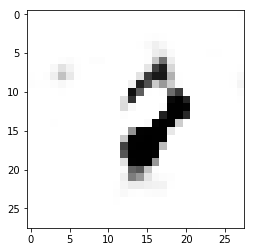

index no: 1


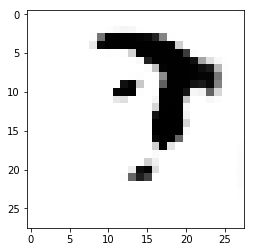

epoch no: 668
index no: 0


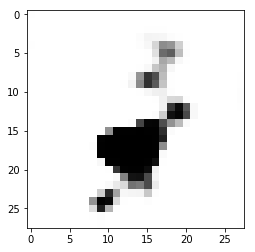

index no: 1


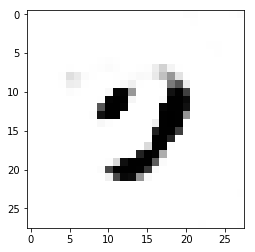

epoch no: 669
index no: 0


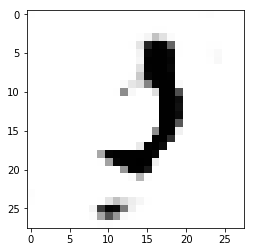

index no: 1


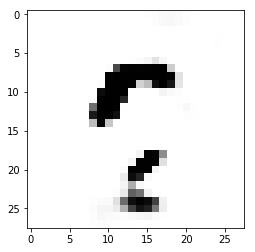

epoch no: 670
index no: 0


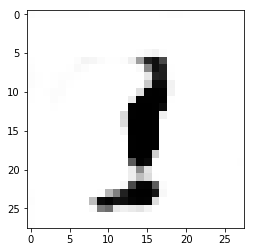

index no: 1


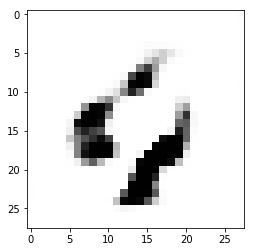

epoch no: 671
index no: 0


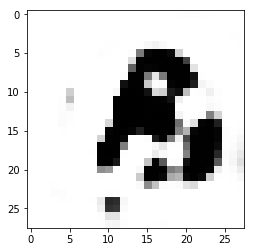

index no: 1


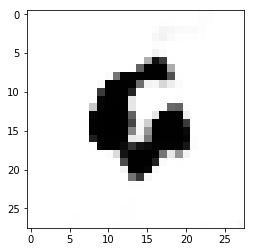

epoch no: 672
index no: 0


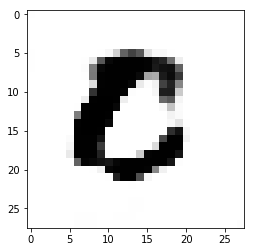

index no: 1


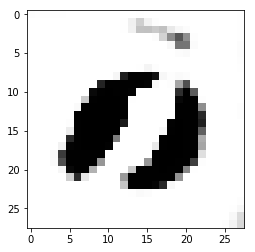

epoch no: 673
index no: 0


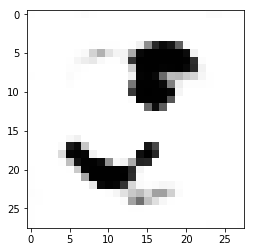

index no: 1


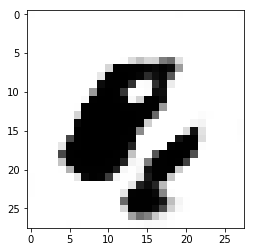

epoch no: 674
index no: 0


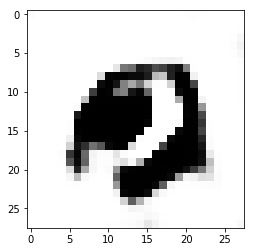

index no: 1


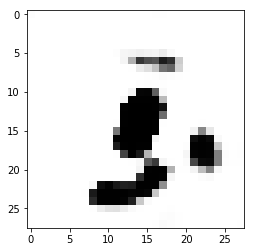

epoch no: 675
index no: 0


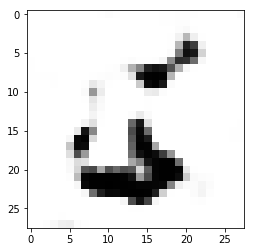

index no: 1


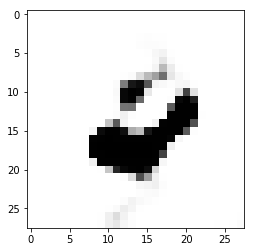

epoch no: 676
index no: 0


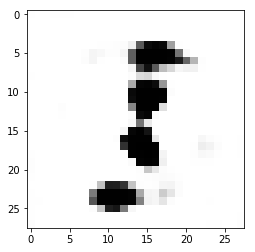

index no: 1


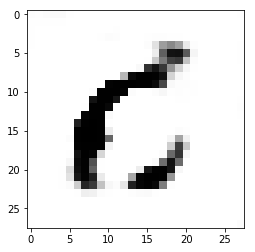

epoch no: 677
index no: 0


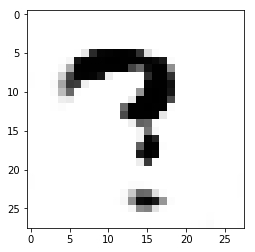

index no: 1


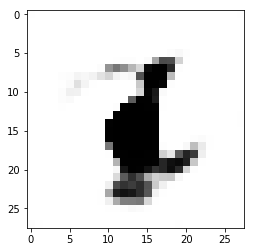

epoch no: 678
index no: 0


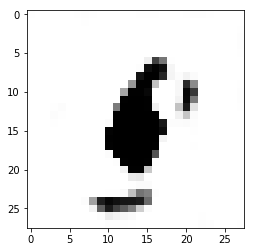

index no: 1


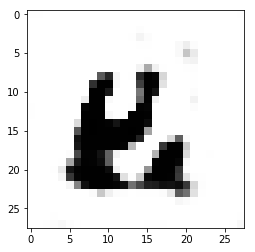

epoch no: 679
index no: 0


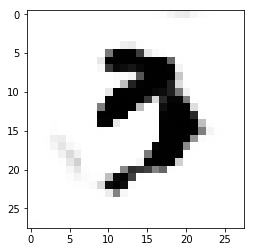

index no: 1


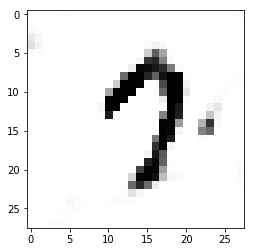

epoch no: 680
index no: 0


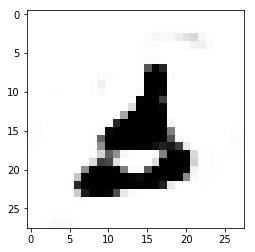

index no: 1


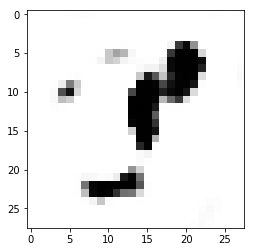

epoch no: 681
index no: 0


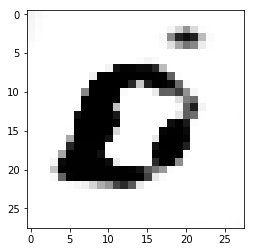

index no: 1


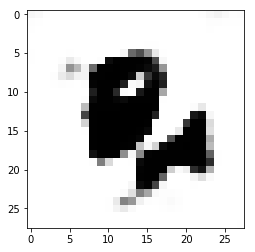

epoch no: 682
index no: 0


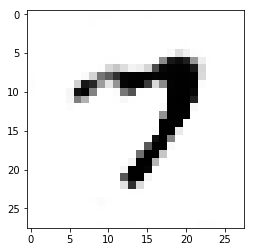

index no: 1


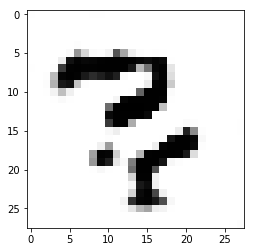

epoch no: 683
index no: 0


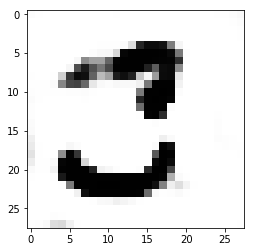

index no: 1


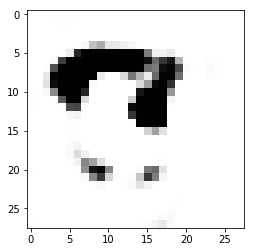

epoch no: 684
index no: 0


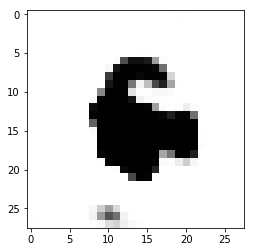

index no: 1


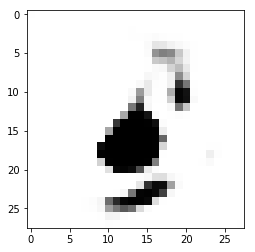

epoch no: 685
index no: 0


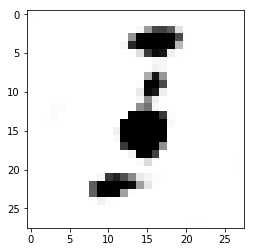

index no: 1


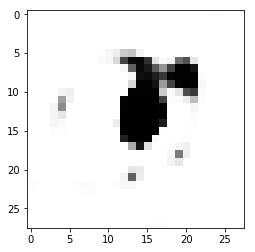

epoch no: 686
index no: 0


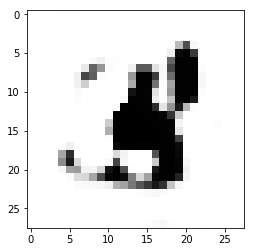

index no: 1


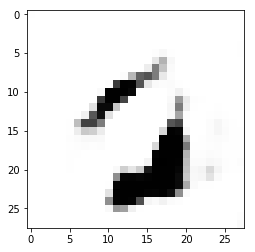

epoch no: 687
index no: 0


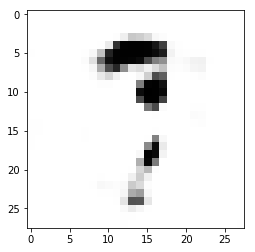

index no: 1


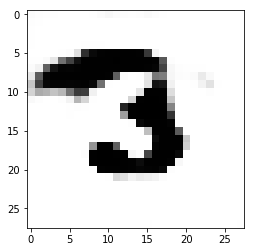

epoch no: 688
index no: 0


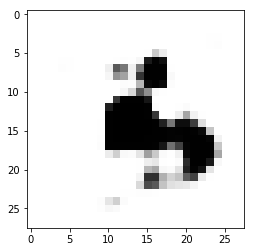

index no: 1


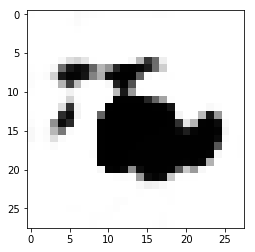

epoch no: 689
index no: 0


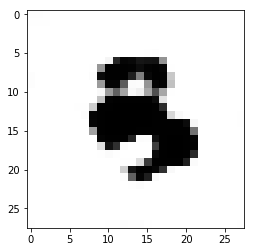

index no: 1


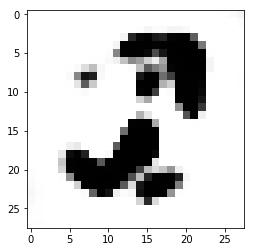

epoch no: 690
index no: 0


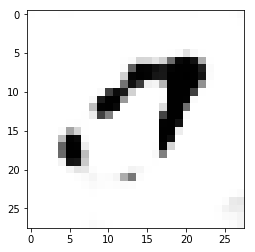

index no: 1


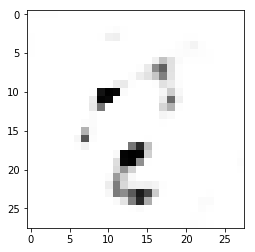

epoch no: 691
index no: 0


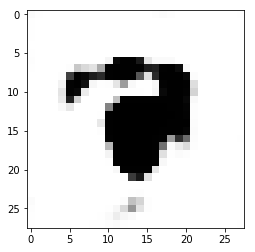

index no: 1


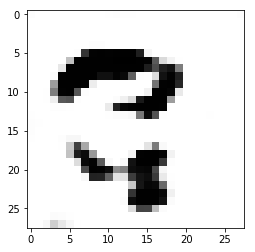

epoch no: 692
index no: 0


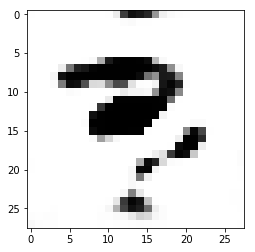

index no: 1


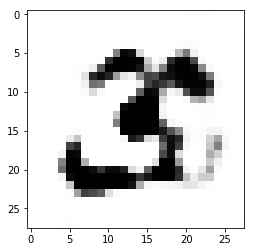

epoch no: 693
index no: 0


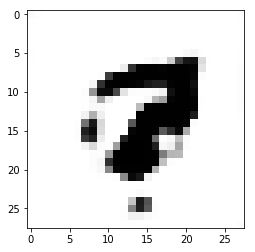

index no: 1


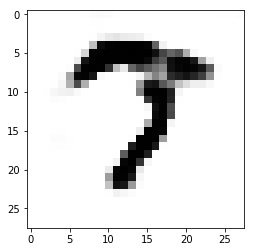

epoch no: 694
index no: 0


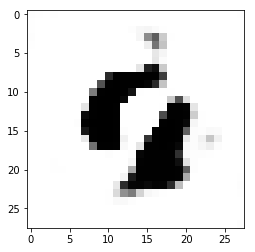

index no: 1


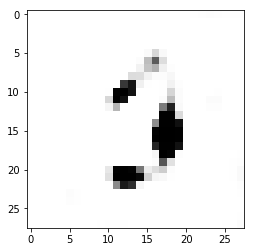

epoch no: 695
index no: 0


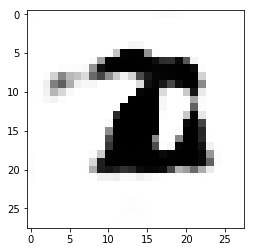

index no: 1


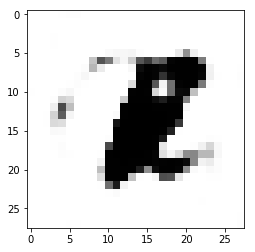

epoch no: 696
index no: 0


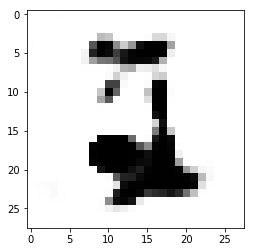

index no: 1


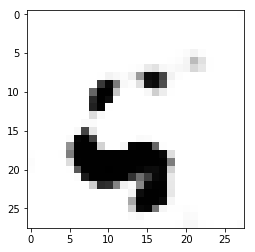

epoch no: 697
index no: 0


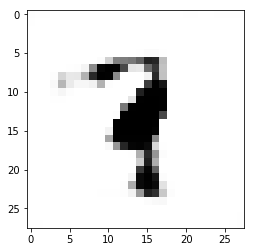

index no: 1


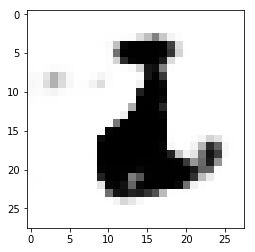

epoch no: 698
index no: 0


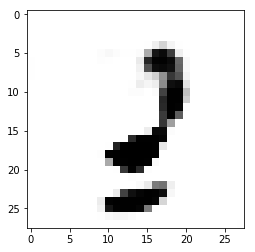

index no: 1


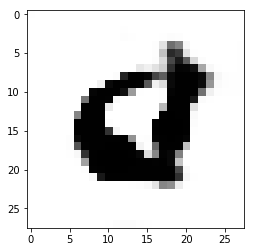

epoch no: 699
index no: 0


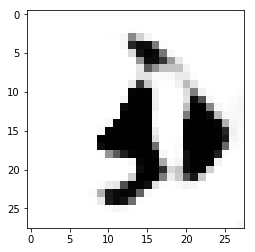

index no: 1


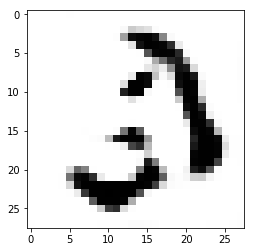

epoch no: 700
index no: 0


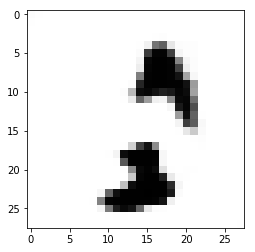

index no: 1


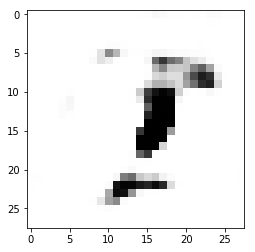

epoch no: 701
index no: 0


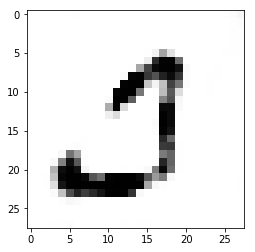

index no: 1


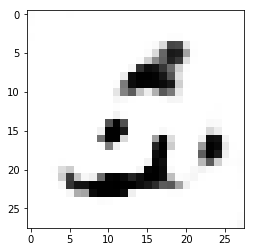

epoch no: 702
index no: 0


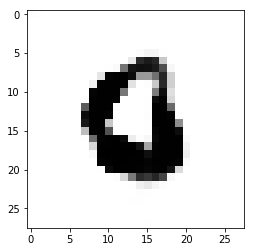

index no: 1


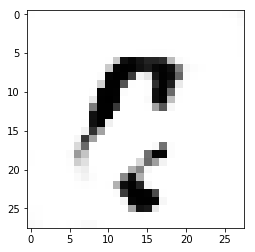

epoch no: 703
index no: 0


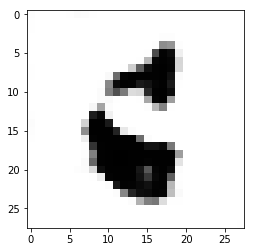

index no: 1


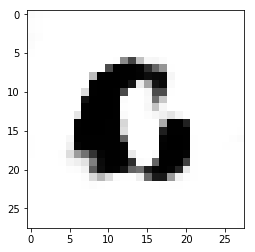

epoch no: 704
index no: 0


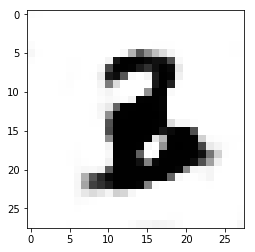

index no: 1


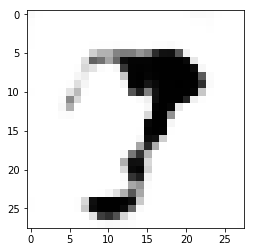

epoch no: 705
index no: 0


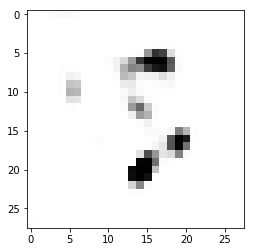

index no: 1


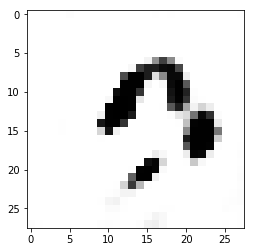

epoch no: 706
index no: 0


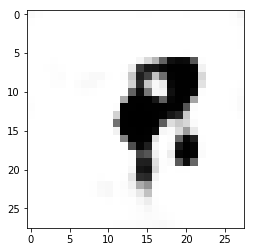

index no: 1


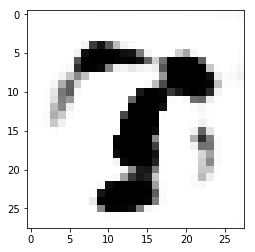

epoch no: 707
index no: 0


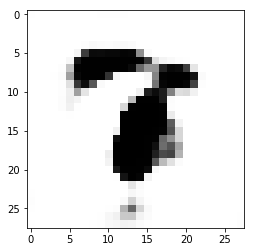

index no: 1


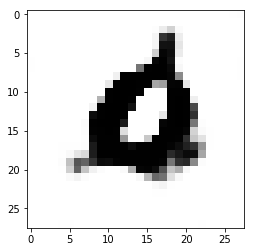

epoch no: 708
index no: 0


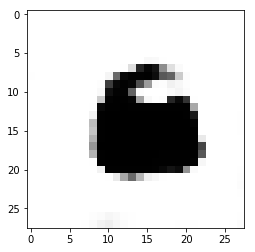

index no: 1


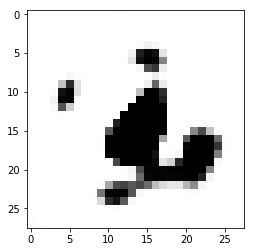

epoch no: 709
index no: 0


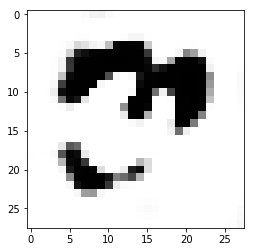

index no: 1


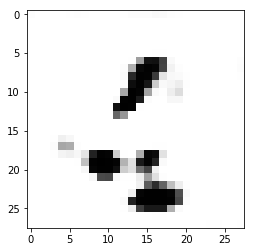

epoch no: 710
index no: 0


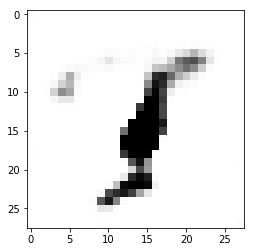

index no: 1


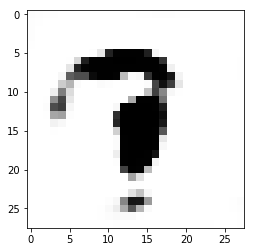

epoch no: 711
index no: 0


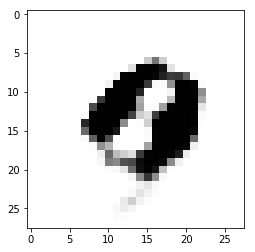

index no: 1


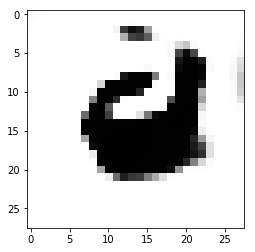

epoch no: 712
index no: 0


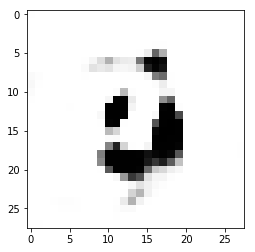

index no: 1


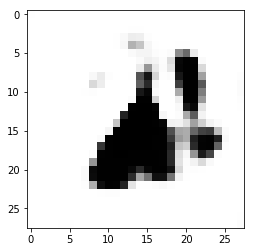

epoch no: 713
index no: 0


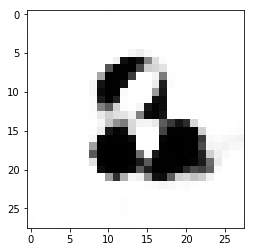

index no: 1


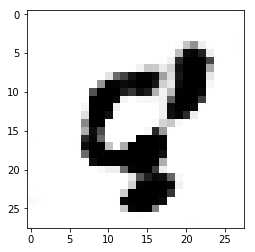

epoch no: 714
index no: 0


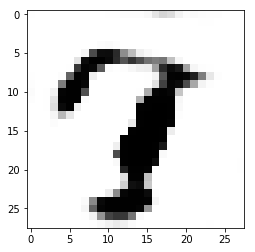

index no: 1


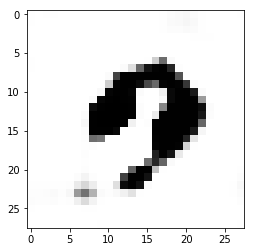

epoch no: 715
index no: 0


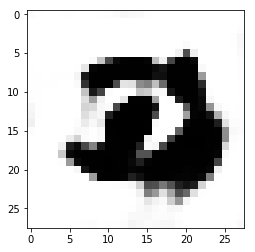

index no: 1


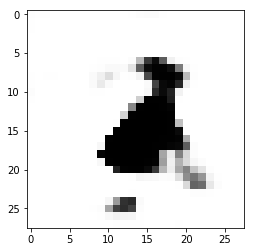

epoch no: 716
index no: 0


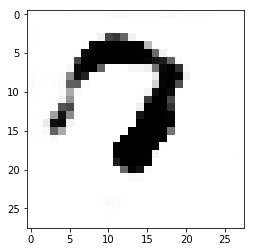

index no: 1


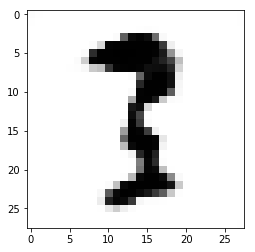

epoch no: 717
index no: 0


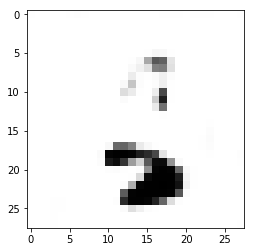

index no: 1


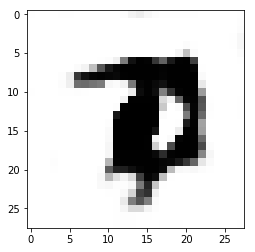

epoch no: 718
index no: 0


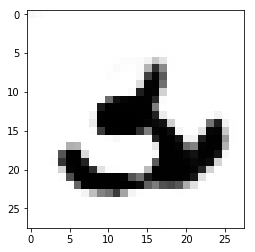

index no: 1


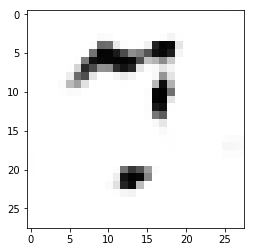

epoch no: 719
index no: 0


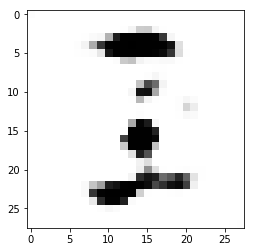

index no: 1


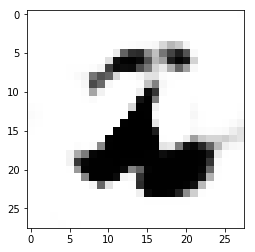

epoch no: 720
index no: 0


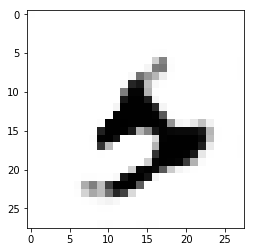

index no: 1


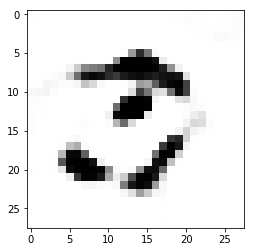

epoch no: 721
index no: 0


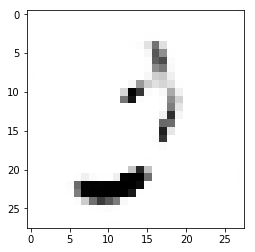

index no: 1


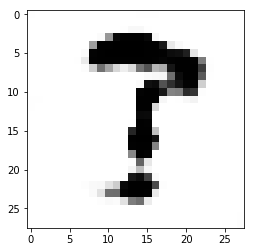

epoch no: 722
index no: 0


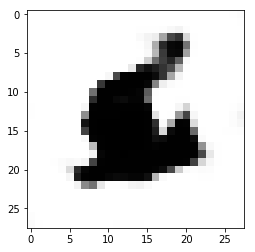

index no: 1


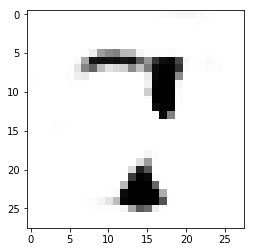

epoch no: 723
index no: 0


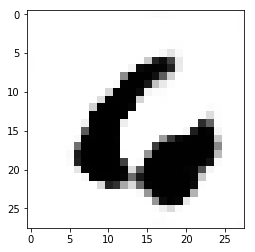

index no: 1


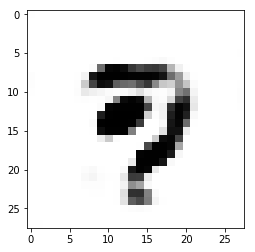

epoch no: 724
index no: 0


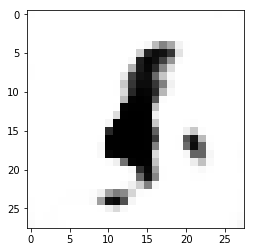

index no: 1


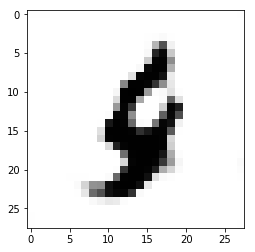

epoch no: 725
index no: 0


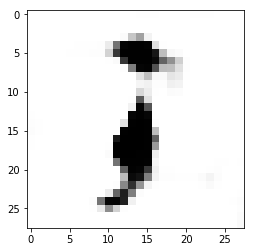

index no: 1


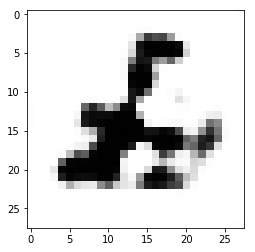

epoch no: 726
index no: 0


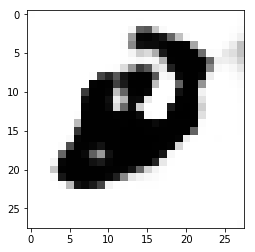

index no: 1


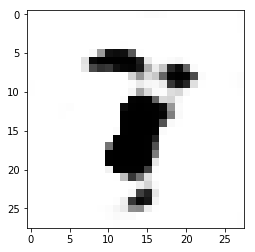

epoch no: 727
index no: 0


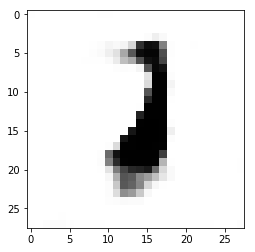

index no: 1


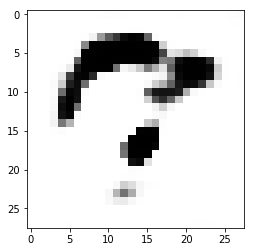

epoch no: 728
index no: 0


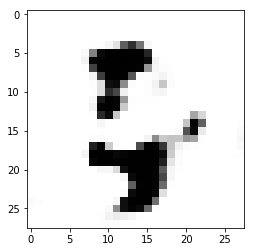

index no: 1


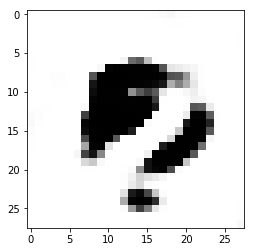

epoch no: 729
index no: 0


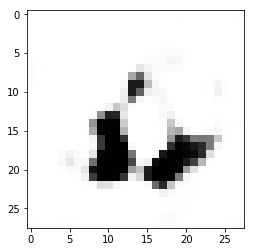

index no: 1


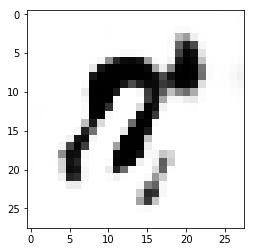

epoch no: 730
index no: 0


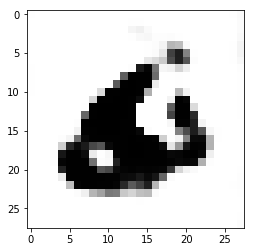

index no: 1


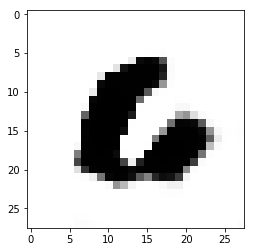

epoch no: 731
index no: 0


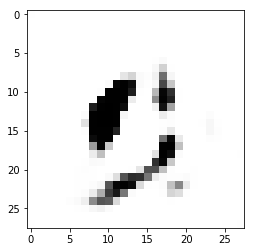

index no: 1


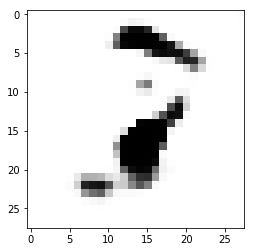

epoch no: 732
index no: 0


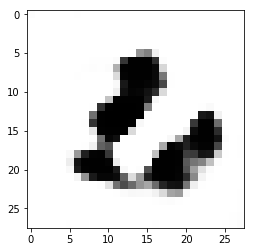

index no: 1


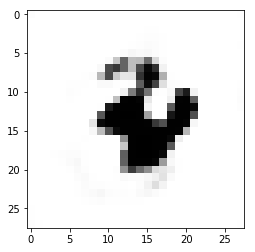

epoch no: 733
index no: 0


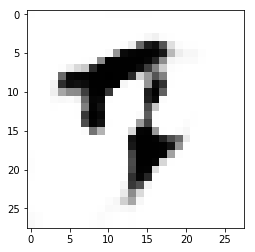

index no: 1


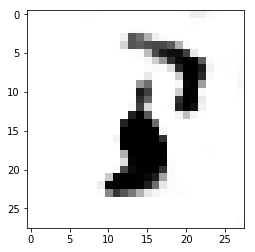

epoch no: 734
index no: 0


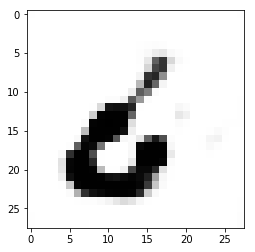

index no: 1


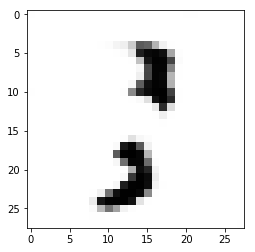

epoch no: 735
index no: 0


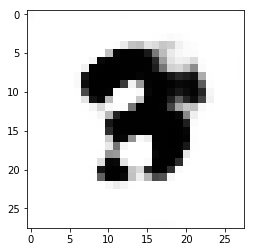

index no: 1


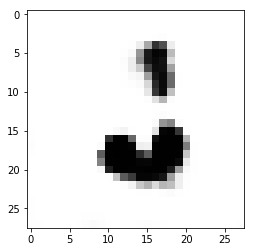

epoch no: 736
index no: 0


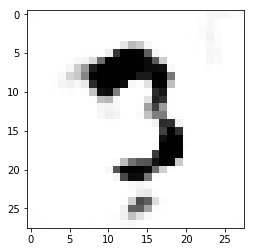

index no: 1


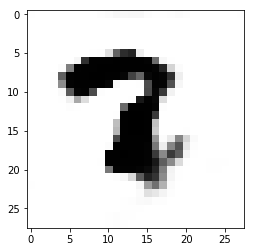

epoch no: 737
index no: 0


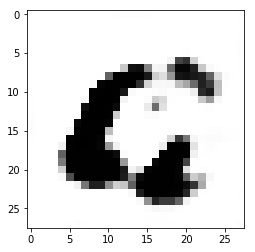

index no: 1


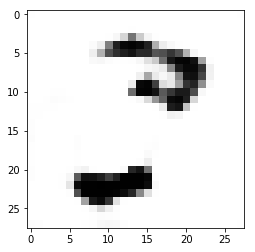

epoch no: 738
index no: 0


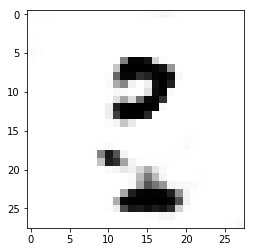

index no: 1


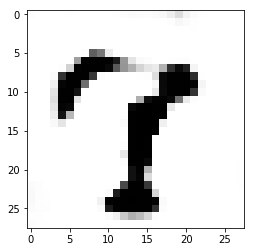

epoch no: 739
index no: 0


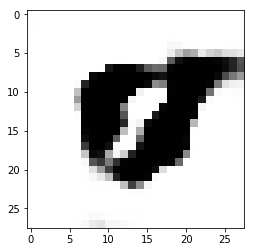

index no: 1


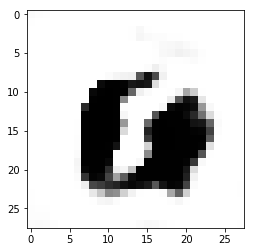

epoch no: 740
index no: 0


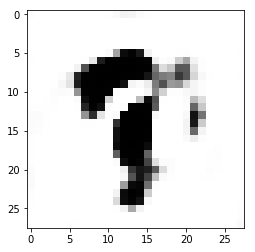

index no: 1


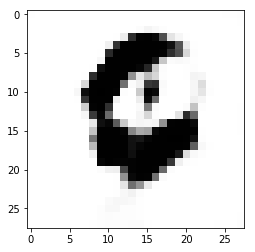

epoch no: 741
index no: 0


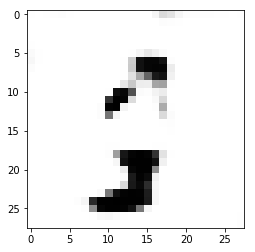

index no: 1


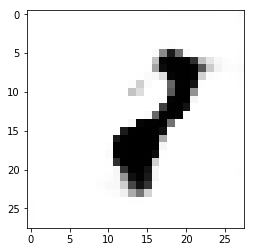

epoch no: 742
index no: 0


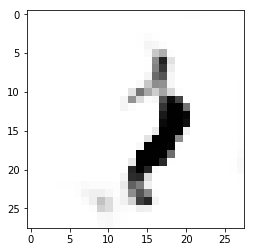

index no: 1


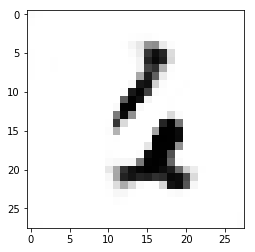

epoch no: 743
index no: 0


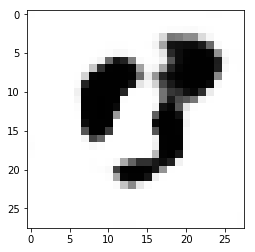

index no: 1


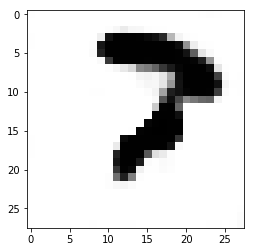

epoch no: 744
index no: 0


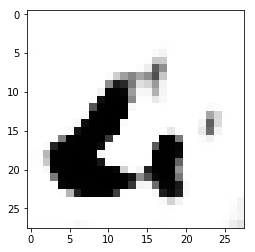

index no: 1


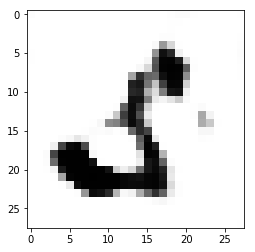

epoch no: 745
index no: 0


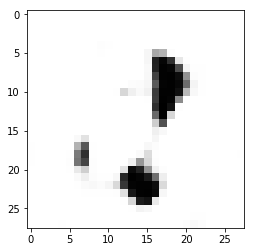

index no: 1


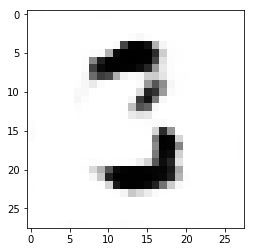

epoch no: 746
index no: 0


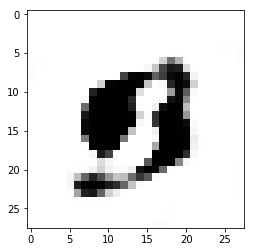

index no: 1


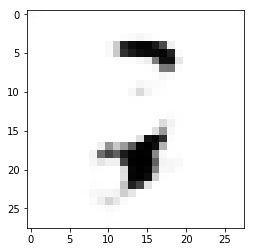

epoch no: 747
index no: 0


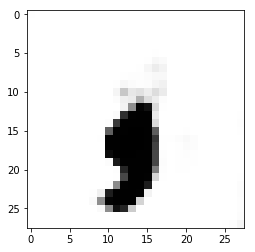

index no: 1


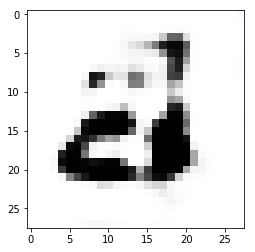

epoch no: 748
index no: 0


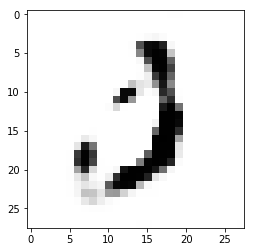

index no: 1


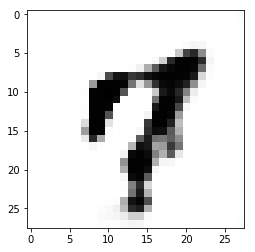

epoch no: 749
index no: 0


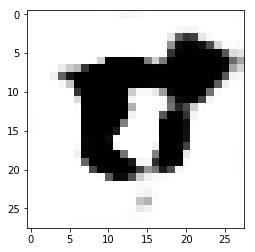

index no: 1


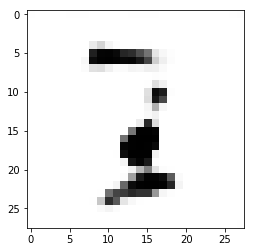

epoch no: 750
index no: 0


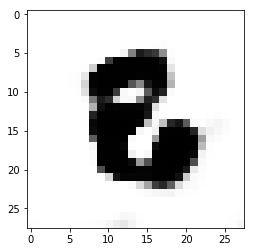

index no: 1


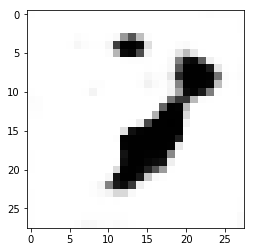

epoch no: 751
index no: 0


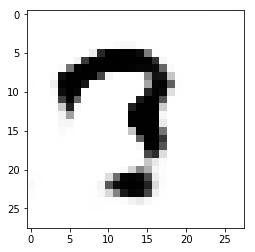

index no: 1


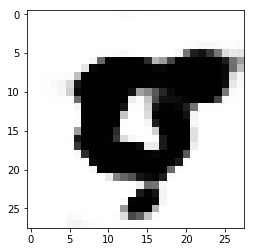

epoch no: 752
index no: 0


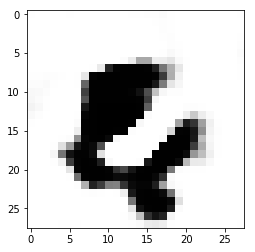

index no: 1


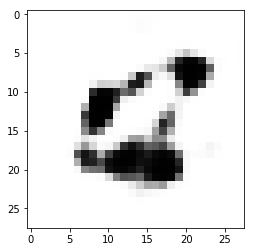

epoch no: 753
index no: 0


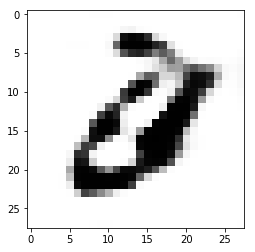

index no: 1


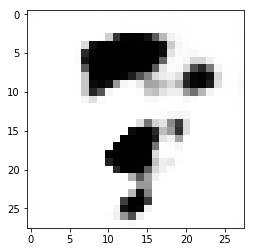

epoch no: 754
index no: 0


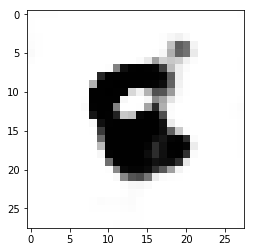

index no: 1


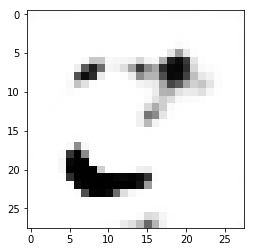

epoch no: 755
index no: 0


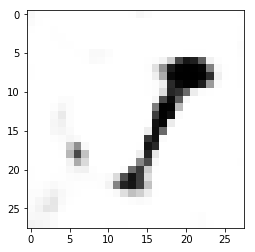

index no: 1


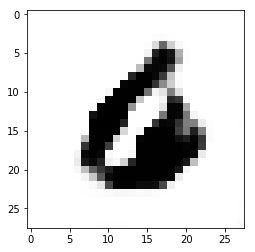

epoch no: 756
index no: 0


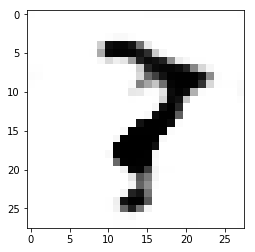

index no: 1


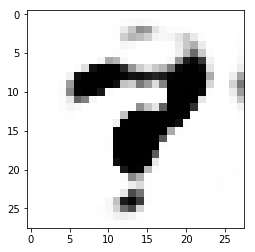

epoch no: 757
index no: 0


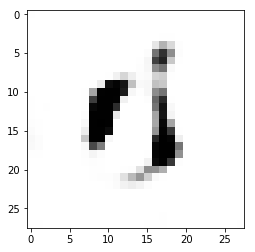

index no: 1


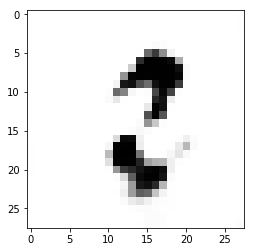

epoch no: 758
index no: 0


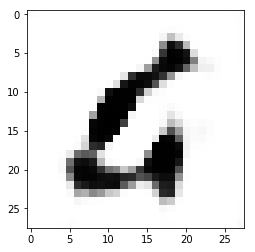

index no: 1


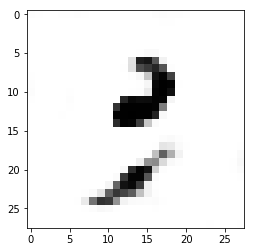

epoch no: 759
index no: 0


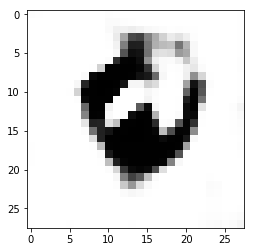

index no: 1


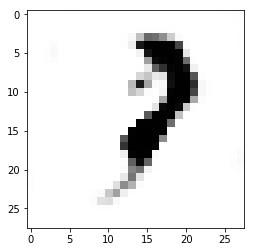

epoch no: 760
index no: 0


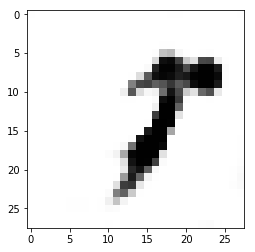

index no: 1


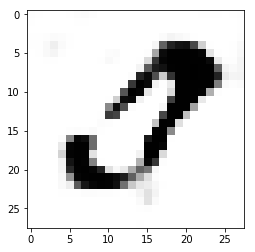

epoch no: 761
index no: 0


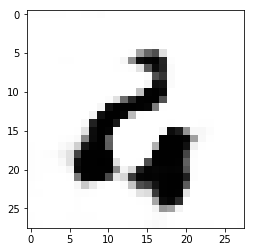

index no: 1


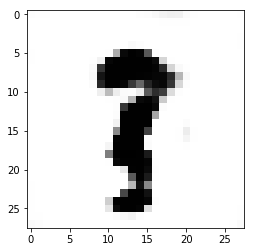

epoch no: 762
index no: 0


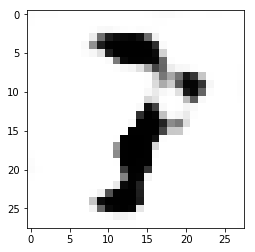

index no: 1


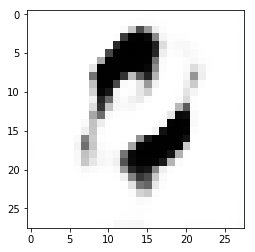

epoch no: 763
index no: 0


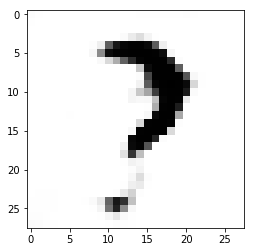

index no: 1


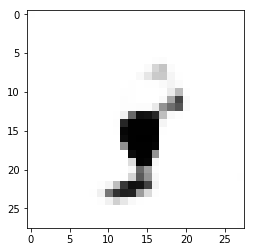

epoch no: 764
index no: 0


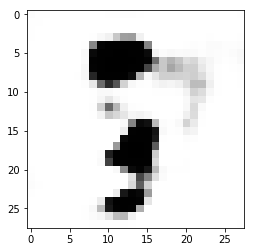

index no: 1


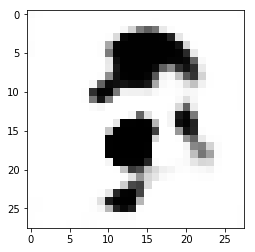

epoch no: 765
index no: 0


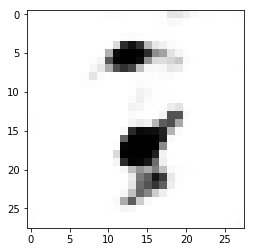

index no: 1


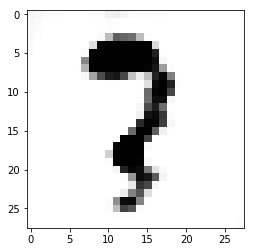

epoch no: 766
index no: 0


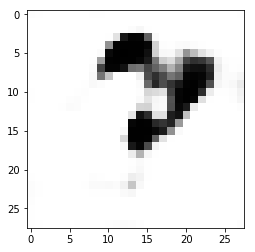

index no: 1


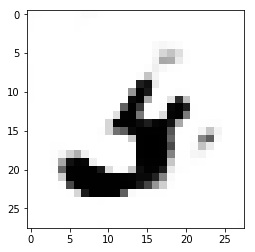

epoch no: 767
index no: 0


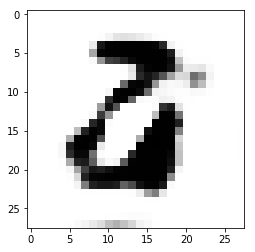

index no: 1


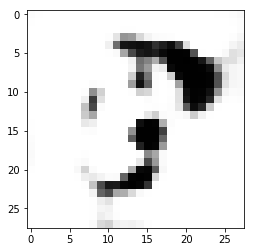

epoch no: 768
index no: 0


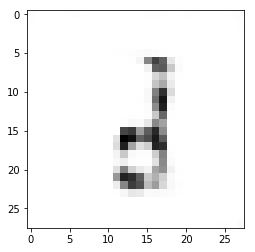

index no: 1


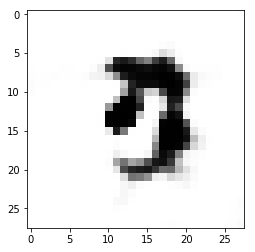

epoch no: 769
index no: 0


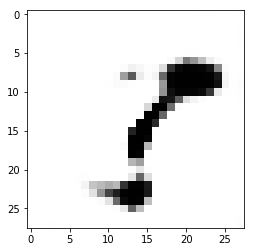

index no: 1


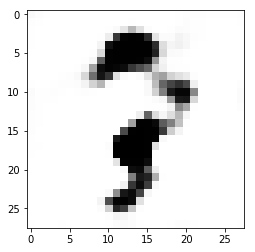

epoch no: 770
index no: 0


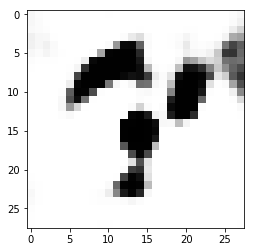

index no: 1


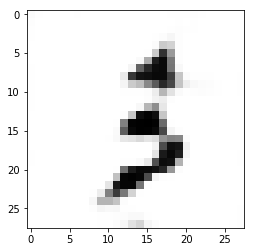

epoch no: 771
index no: 0


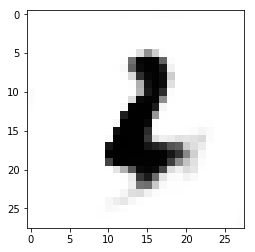

index no: 1


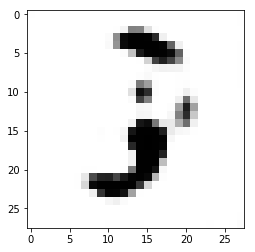

epoch no: 772
index no: 0


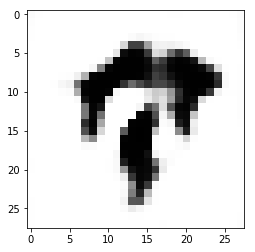

index no: 1


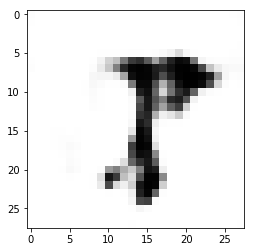

epoch no: 773
index no: 0


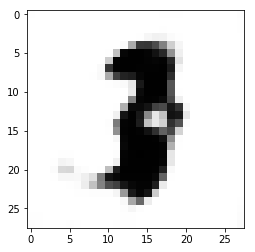

index no: 1


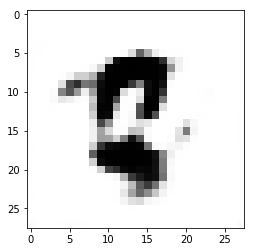

epoch no: 774
index no: 0


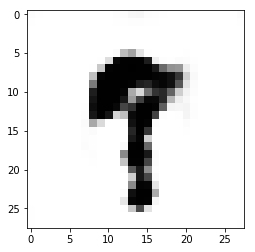

index no: 1


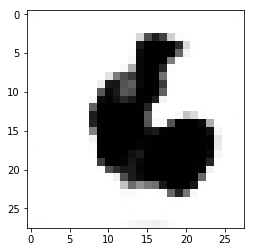

epoch no: 775
index no: 0


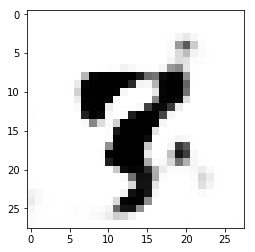

index no: 1


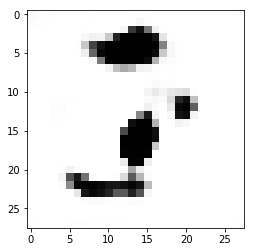

epoch no: 776
index no: 0


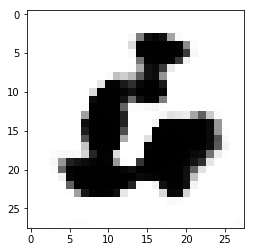

index no: 1


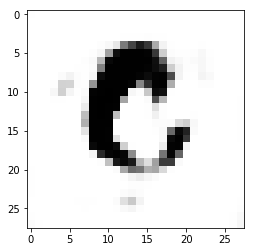

epoch no: 777
index no: 0


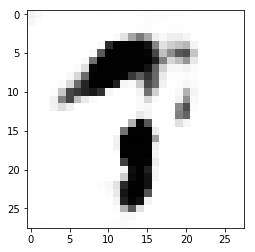

index no: 1


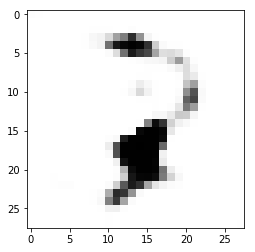

epoch no: 778
index no: 0


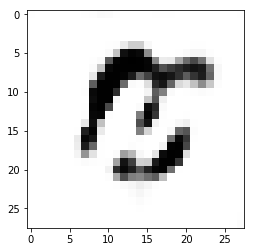

index no: 1


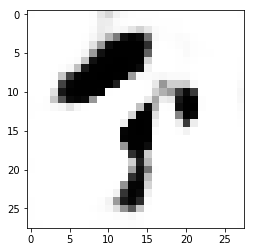

epoch no: 779
index no: 0


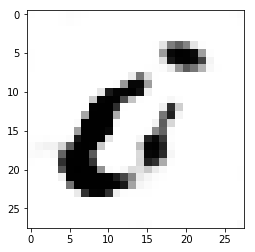

index no: 1


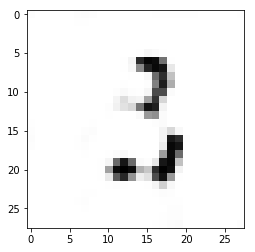

epoch no: 780
index no: 0


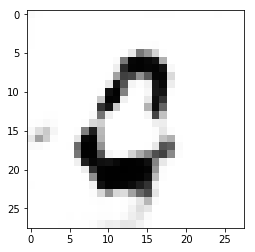

index no: 1


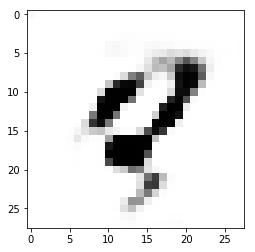

epoch no: 781
index no: 0


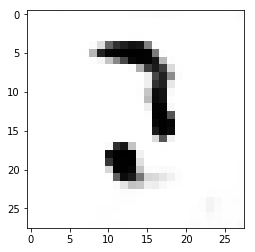

index no: 1


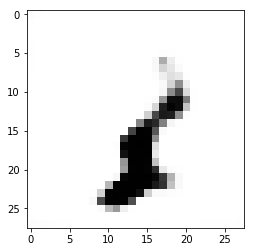

epoch no: 782
index no: 0


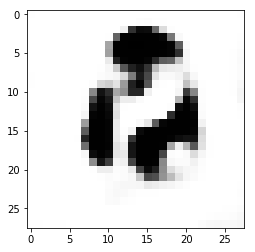

index no: 1


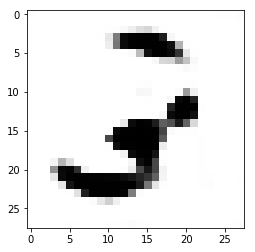

epoch no: 783
index no: 0


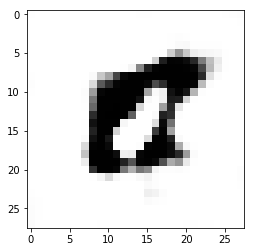

index no: 1


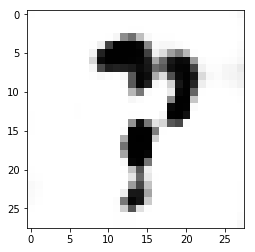

epoch no: 784
index no: 0


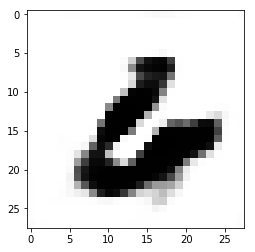

index no: 1


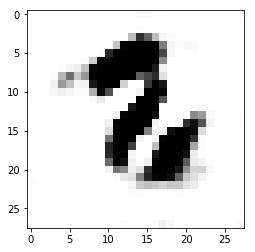

epoch no: 785
index no: 0


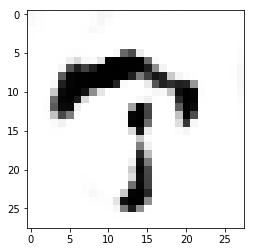

index no: 1


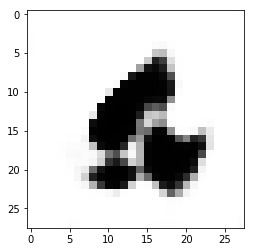

epoch no: 786
index no: 0


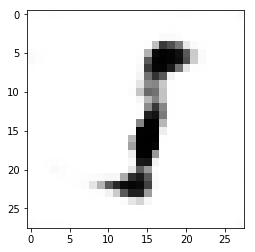

index no: 1


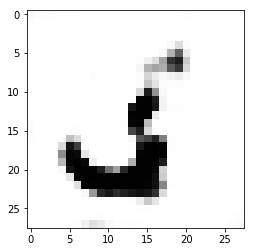

epoch no: 787
index no: 0


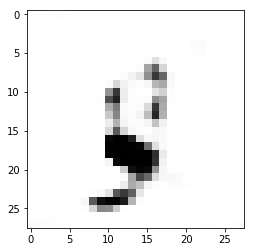

index no: 1


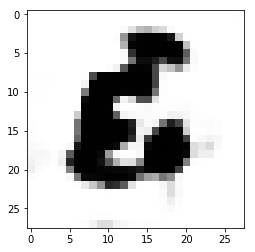

epoch no: 788
index no: 0


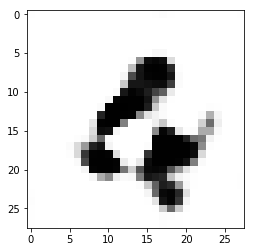

index no: 1


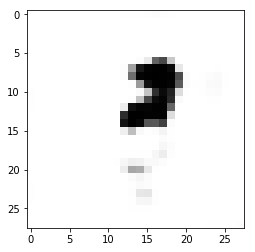

epoch no: 789
index no: 0


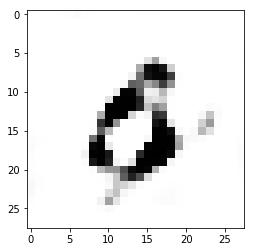

index no: 1


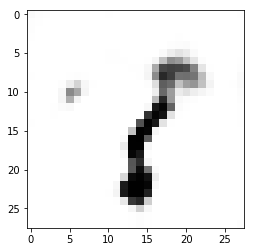

epoch no: 790
index no: 0


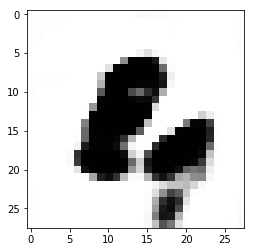

index no: 1


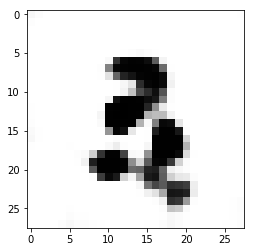

epoch no: 791
index no: 0


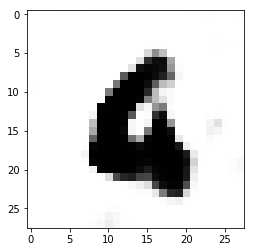

index no: 1


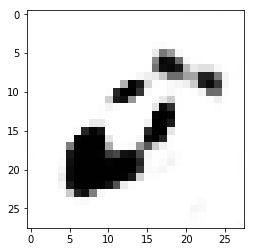

epoch no: 792
index no: 0


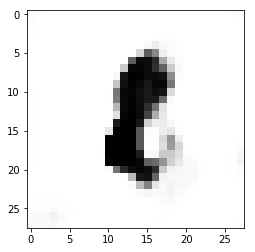

index no: 1


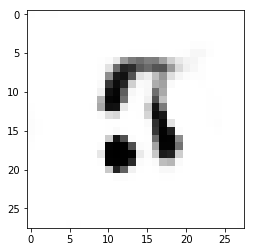

epoch no: 793
index no: 0


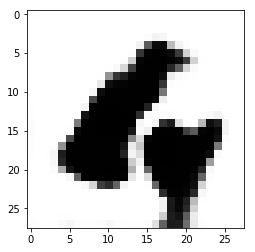

index no: 1


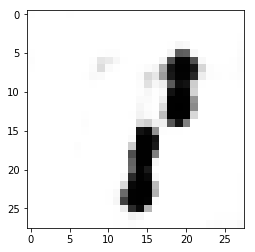

epoch no: 794
index no: 0


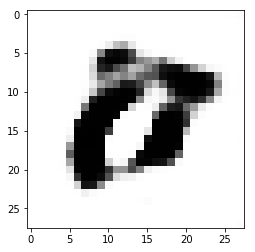

index no: 1


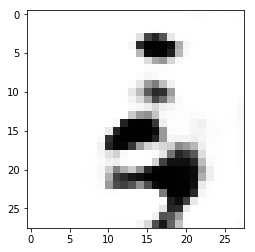

epoch no: 795
index no: 0


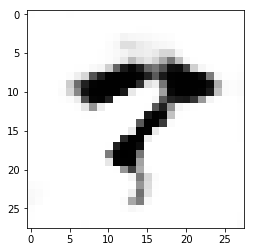

index no: 1


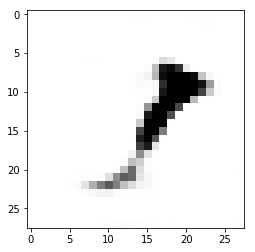

epoch no: 796
index no: 0


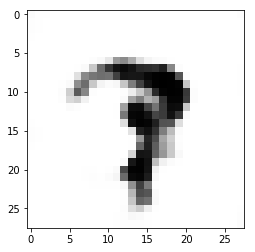

index no: 1


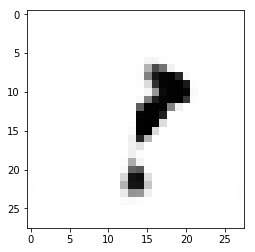

epoch no: 797
index no: 0


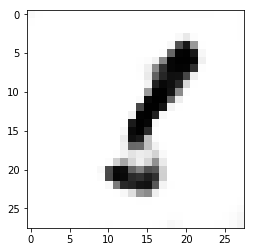

index no: 1


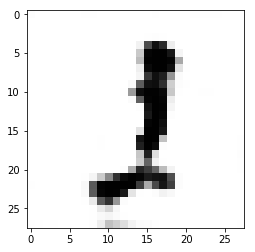

epoch no: 798
index no: 0


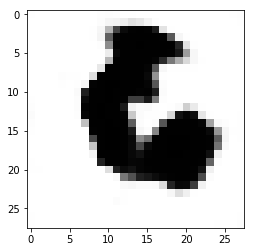

index no: 1


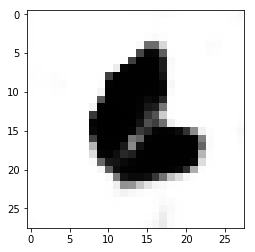

epoch no: 799
index no: 0


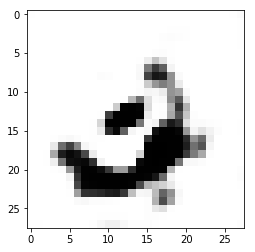

index no: 1


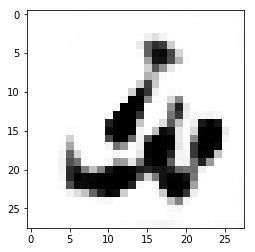

epoch no: 800
index no: 0


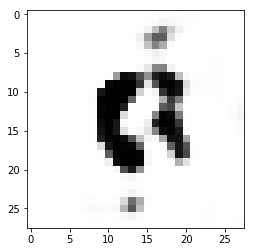

index no: 1


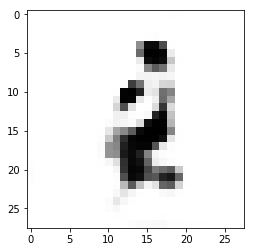

epoch no: 801
index no: 0


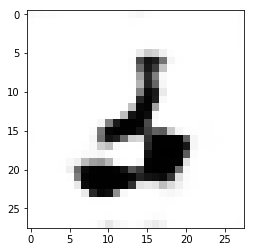

index no: 1


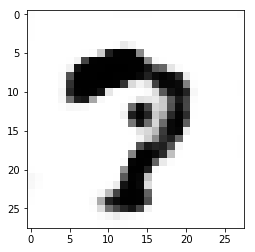

epoch no: 802
index no: 0


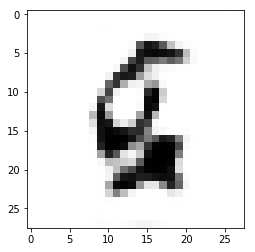

index no: 1


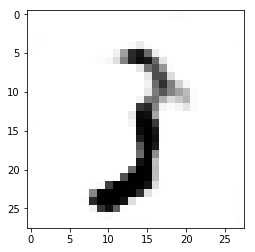

epoch no: 803
index no: 0


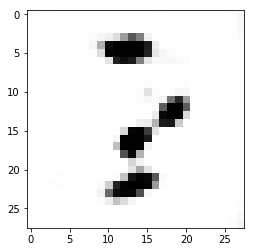

index no: 1


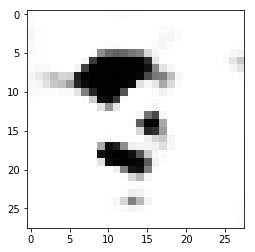

epoch no: 804
index no: 0


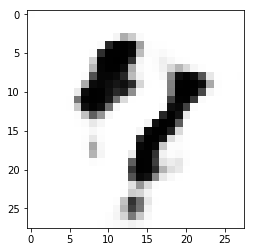

index no: 1


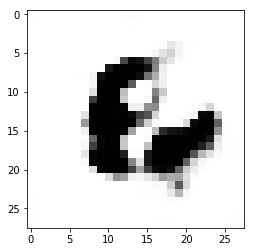

epoch no: 805
index no: 0


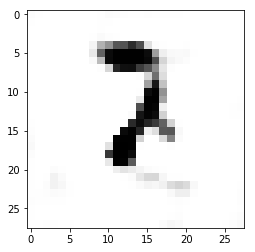

index no: 1


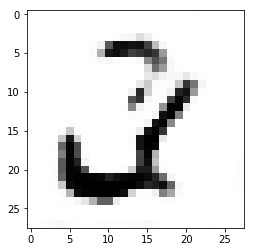

epoch no: 806
index no: 0


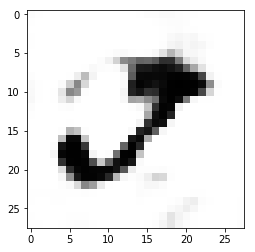

index no: 1


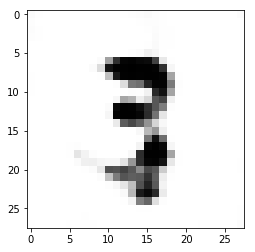

epoch no: 807
index no: 0


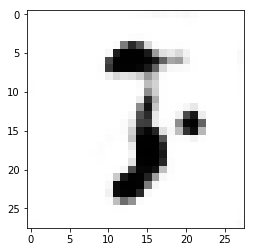

index no: 1


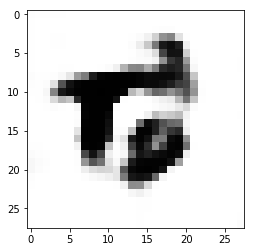

epoch no: 808
index no: 0


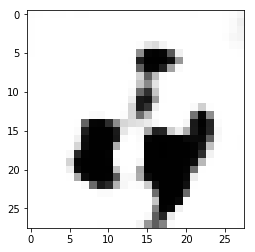

index no: 1


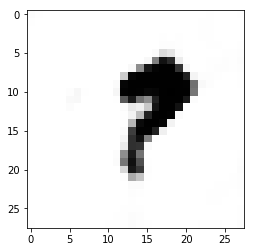

epoch no: 809
index no: 0


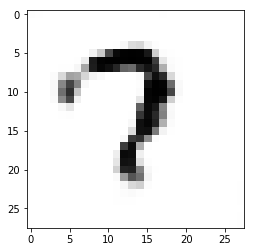

index no: 1


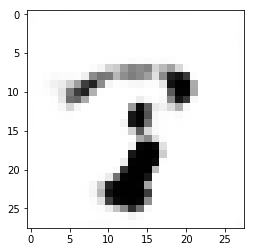

epoch no: 810
index no: 0


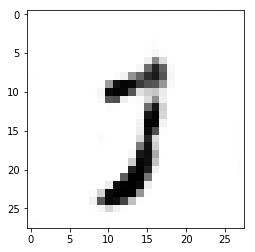

index no: 1


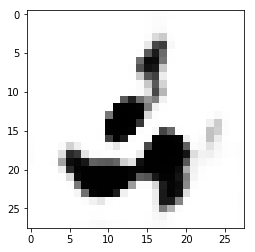

epoch no: 811
index no: 0


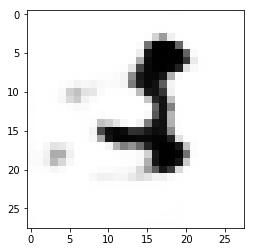

index no: 1


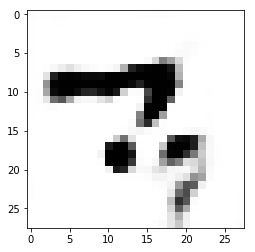

epoch no: 812
index no: 0


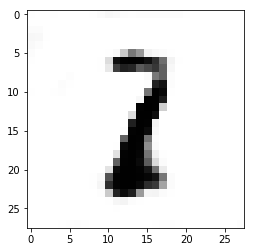

index no: 1


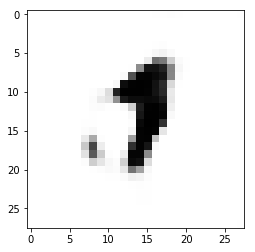

epoch no: 813
index no: 0


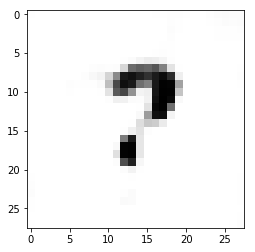

index no: 1


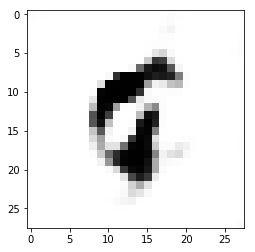

epoch no: 814
index no: 0


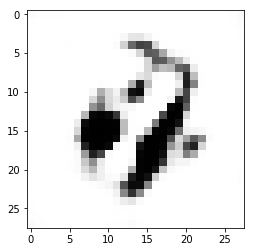

index no: 1


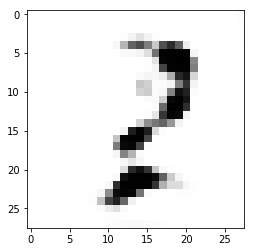

epoch no: 815
index no: 0


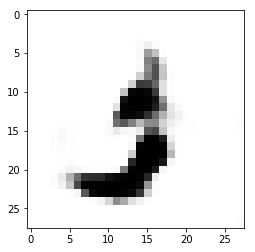

index no: 1


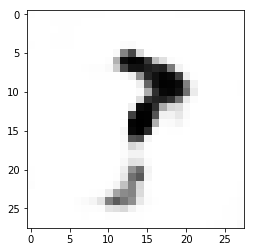

epoch no: 816
index no: 0


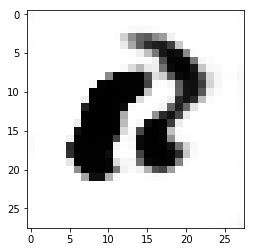

index no: 1


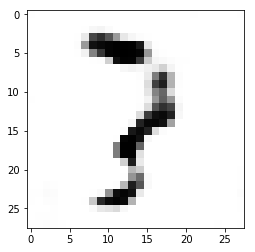

epoch no: 817
index no: 0


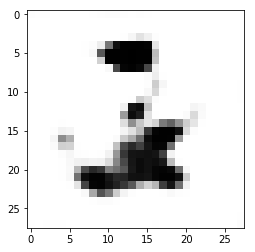

index no: 1


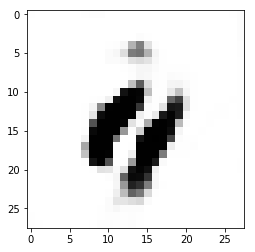

epoch no: 818
index no: 0


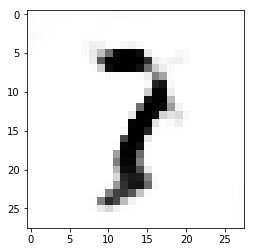

index no: 1


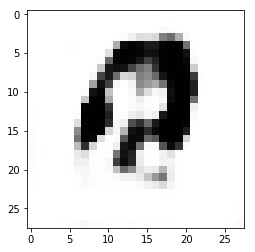

epoch no: 819
index no: 0


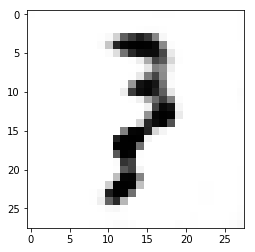

index no: 1


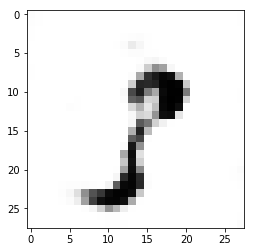

epoch no: 820
index no: 0


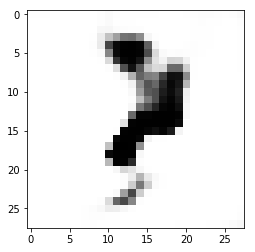

index no: 1


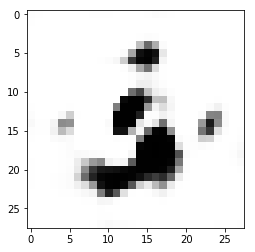

epoch no: 821
index no: 0


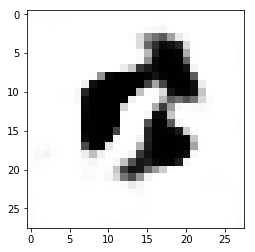

index no: 1


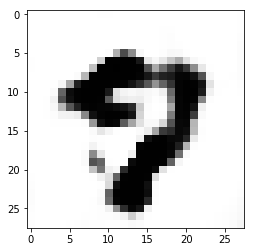

epoch no: 822
index no: 0


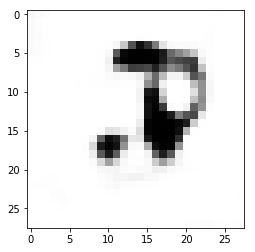

index no: 1


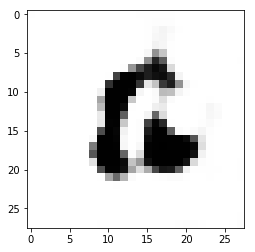

epoch no: 823
index no: 0


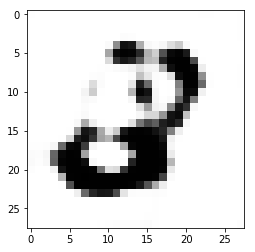

index no: 1


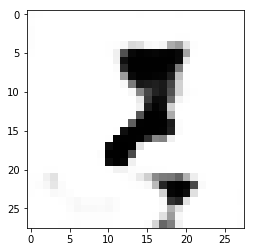

epoch no: 824
index no: 0


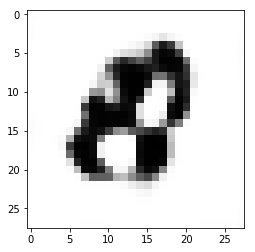

index no: 1


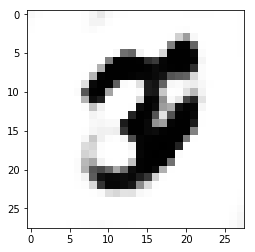

epoch no: 825
index no: 0


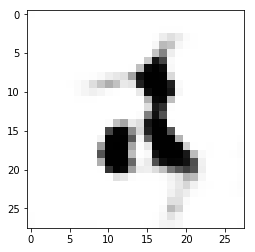

index no: 1


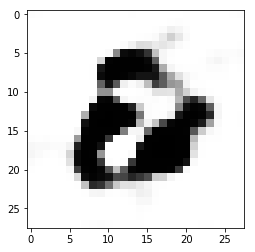

epoch no: 826
index no: 0


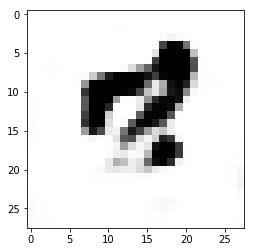

index no: 1


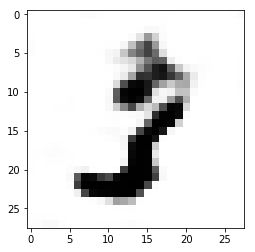

epoch no: 827
index no: 0


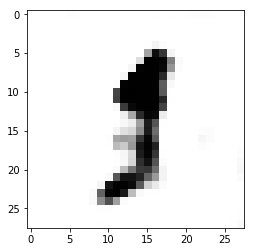

index no: 1


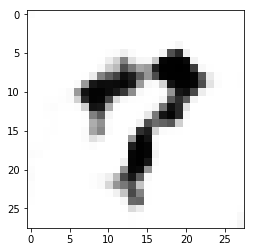

epoch no: 828
index no: 0


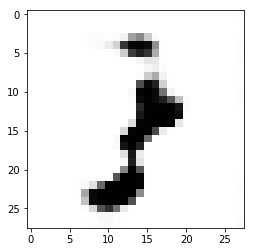

index no: 1


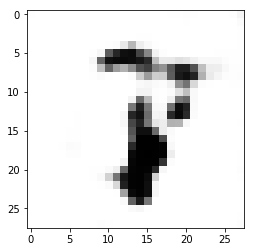

epoch no: 829
index no: 0


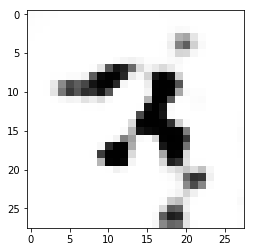

index no: 1


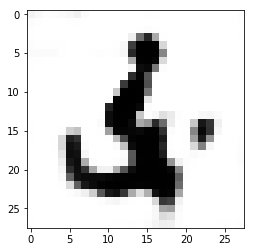

epoch no: 830
index no: 0


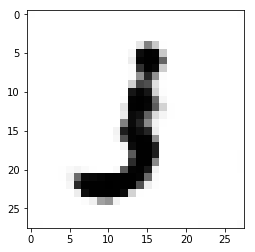

index no: 1


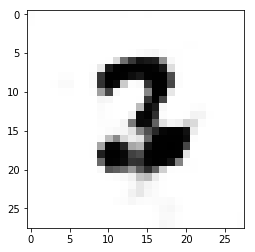

epoch no: 831
index no: 0


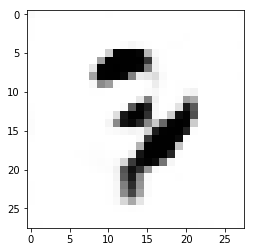

index no: 1


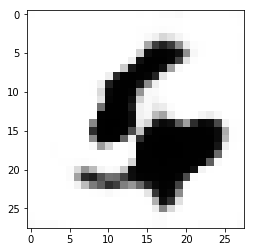

epoch no: 832
index no: 0


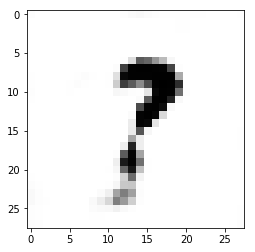

index no: 1


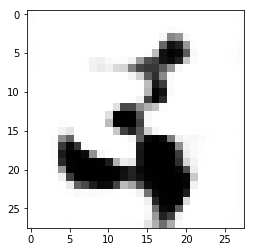

epoch no: 833
index no: 0


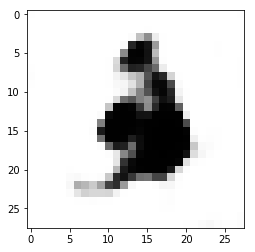

index no: 1


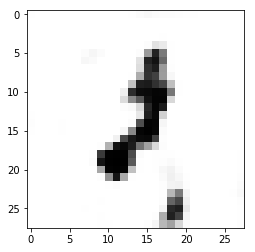

epoch no: 834
index no: 0


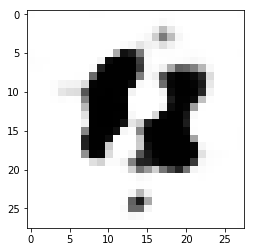

index no: 1


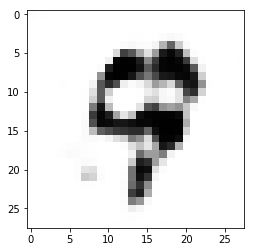

epoch no: 835
index no: 0


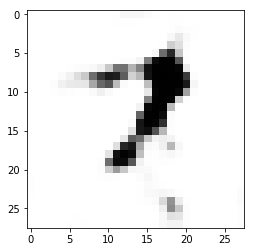

index no: 1


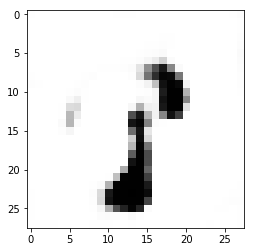

epoch no: 836
index no: 0


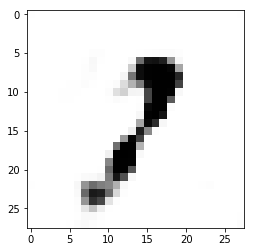

index no: 1


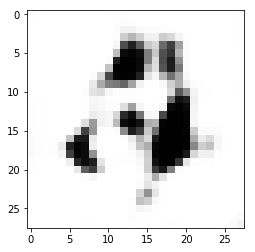

epoch no: 837
index no: 0


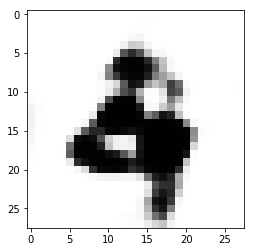

index no: 1


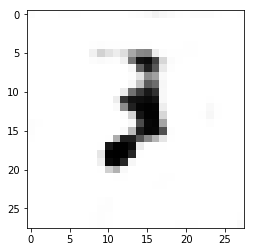

epoch no: 838
index no: 0


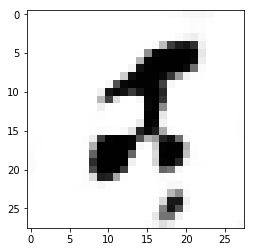

index no: 1


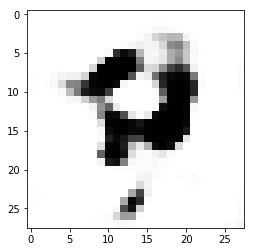

epoch no: 839
index no: 0


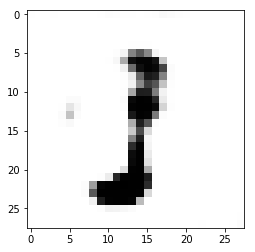

index no: 1


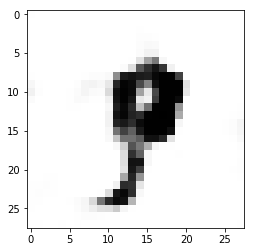

epoch no: 840
index no: 0


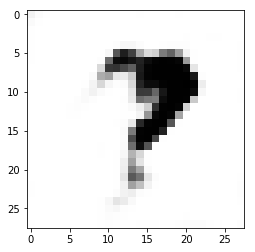

index no: 1


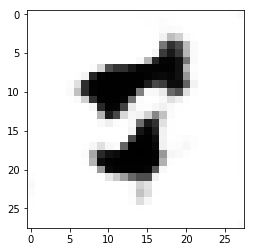

epoch no: 841
index no: 0


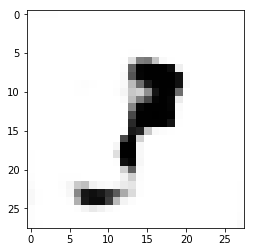

index no: 1


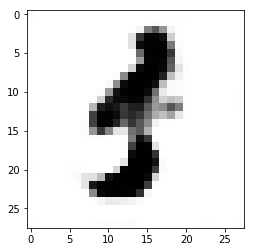

epoch no: 842
index no: 0


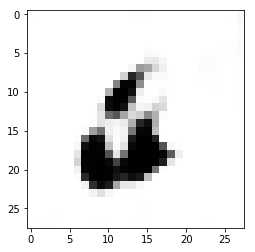

index no: 1


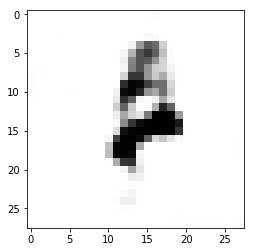

epoch no: 843
index no: 0


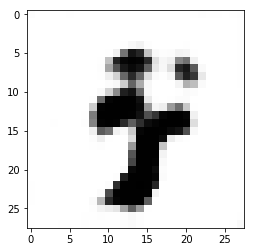

index no: 1


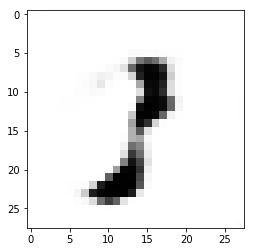

epoch no: 844
index no: 0


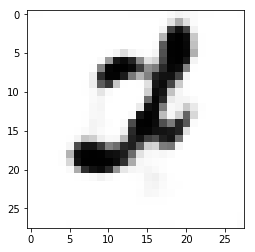

index no: 1


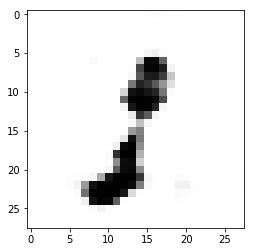

epoch no: 845
index no: 0


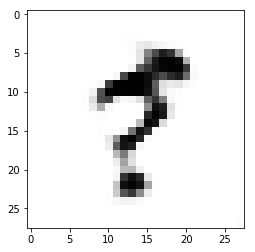

index no: 1


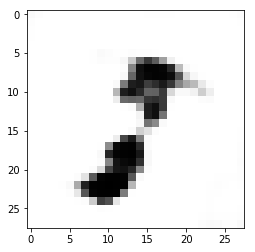

epoch no: 846
index no: 0


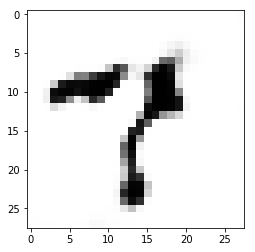

index no: 1


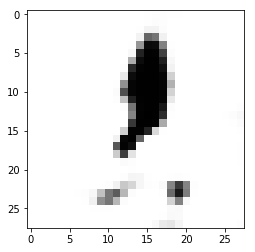

epoch no: 847
index no: 0


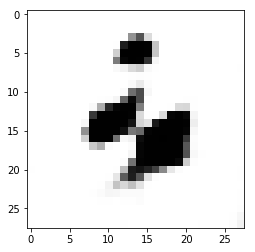

index no: 1


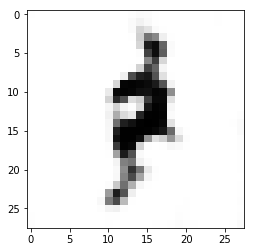

epoch no: 848
index no: 0


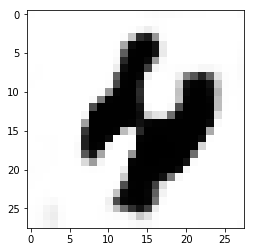

index no: 1


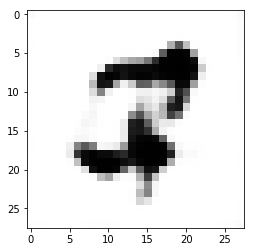

epoch no: 849
index no: 0


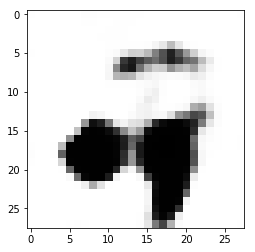

index no: 1


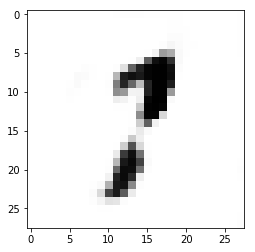

epoch no: 850
index no: 0


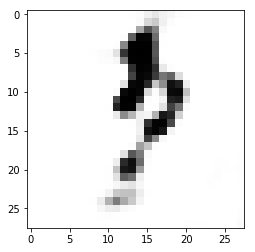

index no: 1


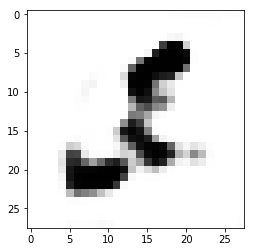

epoch no: 851
index no: 0


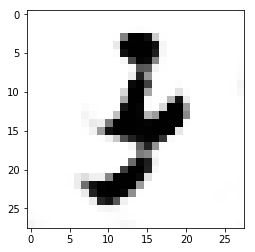

index no: 1


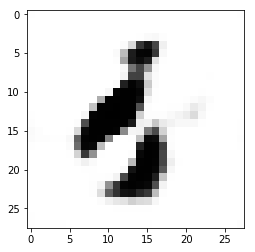

epoch no: 852
index no: 0


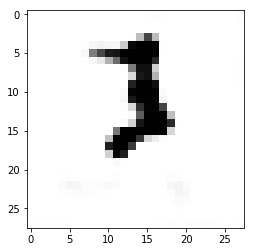

index no: 1


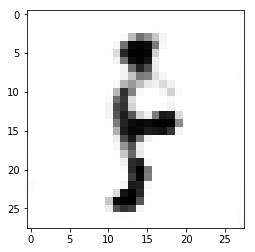

epoch no: 853
index no: 0


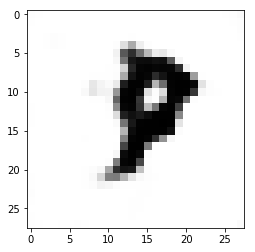

index no: 1


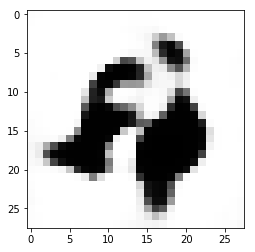

epoch no: 854
index no: 0


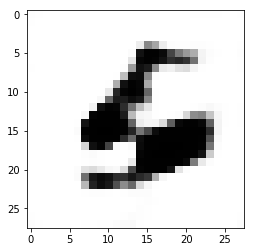

index no: 1


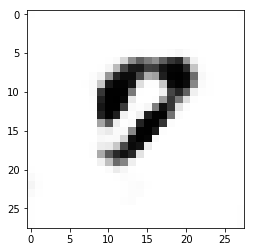

epoch no: 855
index no: 0


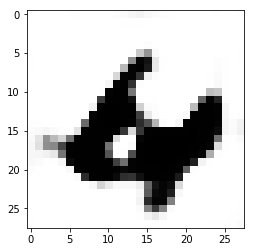

index no: 1


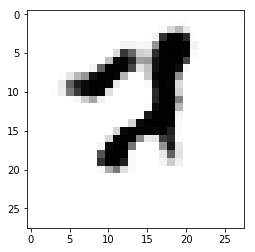

epoch no: 856
index no: 0


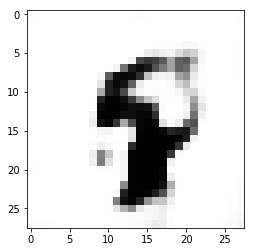

index no: 1


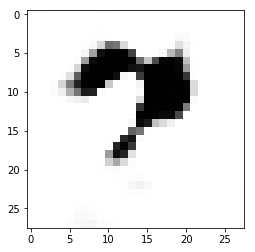

epoch no: 857
index no: 0


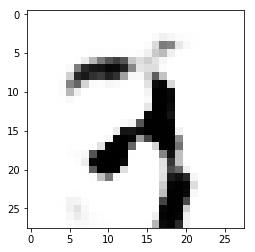

index no: 1


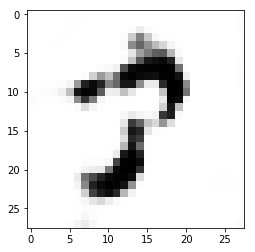

epoch no: 858
index no: 0


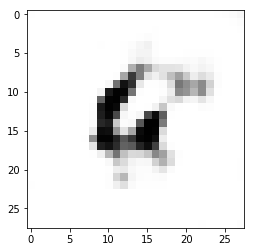

index no: 1


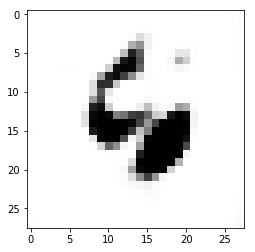

epoch no: 859
index no: 0


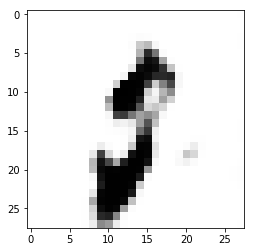

index no: 1


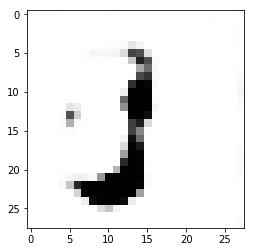

epoch no: 860
index no: 0


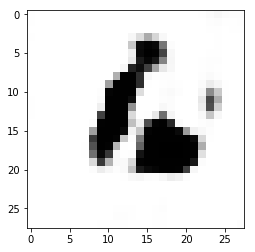

index no: 1


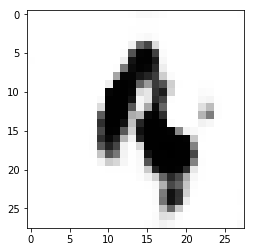

epoch no: 861
index no: 0


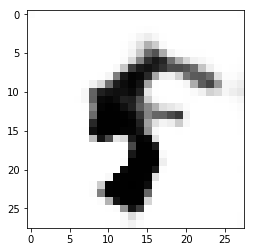

index no: 1


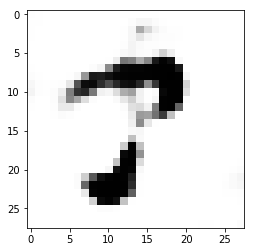

epoch no: 862
index no: 0


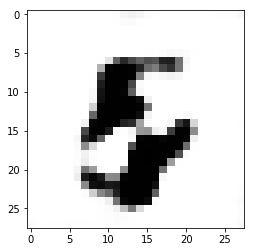

index no: 1


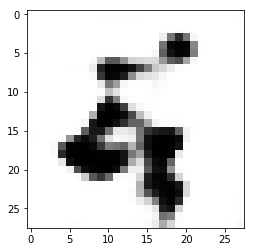

epoch no: 863
index no: 0


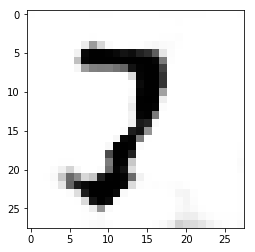

index no: 1


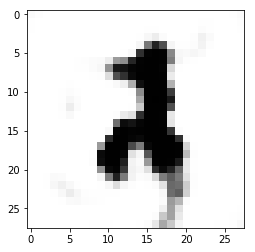

epoch no: 864
index no: 0


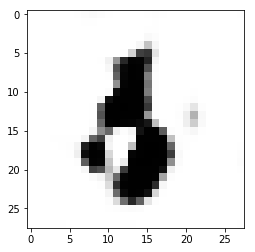

index no: 1


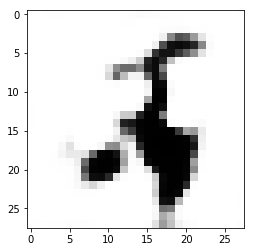

epoch no: 865
index no: 0


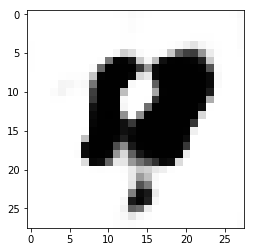

index no: 1


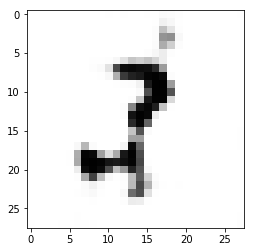

epoch no: 866
index no: 0


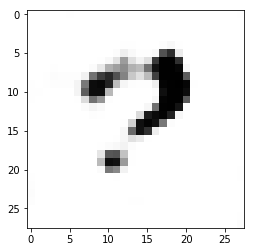

index no: 1


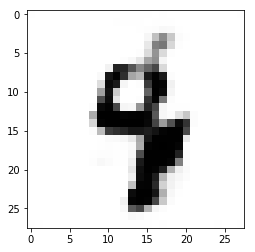

epoch no: 867
index no: 0


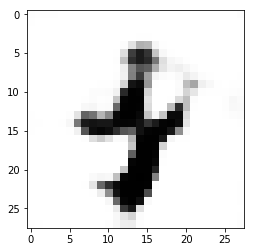

index no: 1


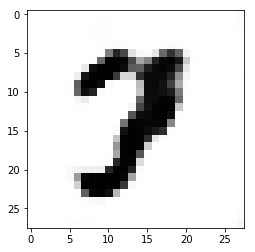

epoch no: 868
index no: 0


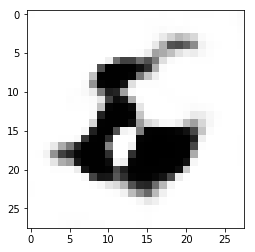

index no: 1


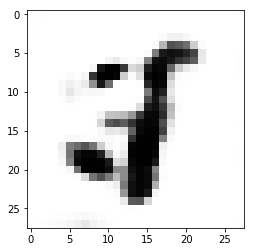

epoch no: 869
index no: 0


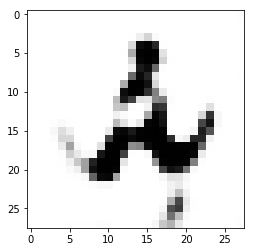

index no: 1


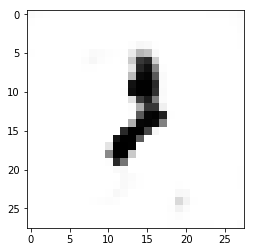

epoch no: 870
index no: 0


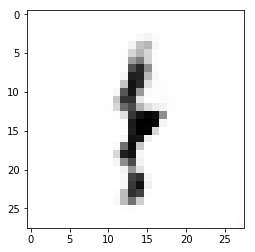

index no: 1


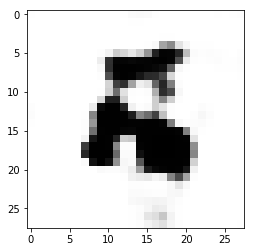

epoch no: 871
index no: 0


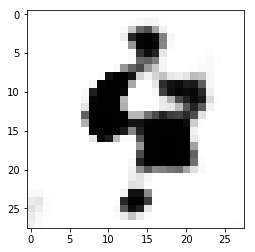

index no: 1


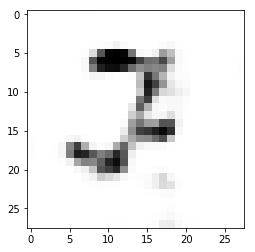

epoch no: 872
index no: 0


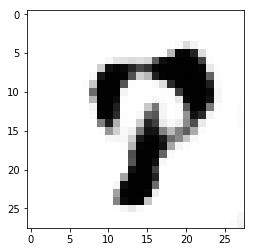

index no: 1


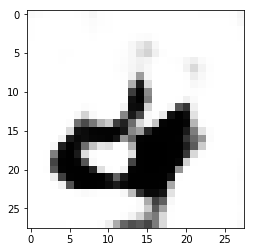

epoch no: 873
index no: 0


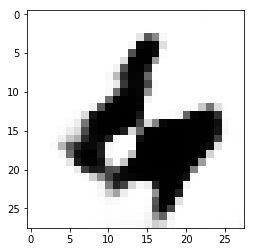

index no: 1


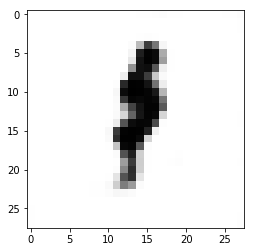

epoch no: 874
index no: 0


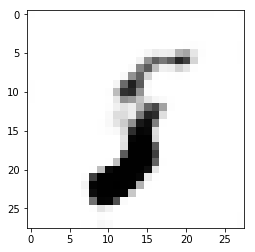

index no: 1


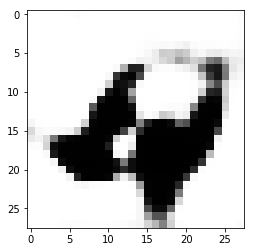

epoch no: 875
index no: 0


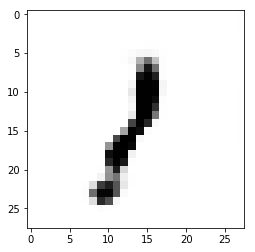

index no: 1


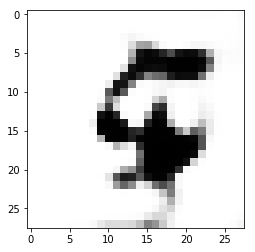

epoch no: 876
index no: 0


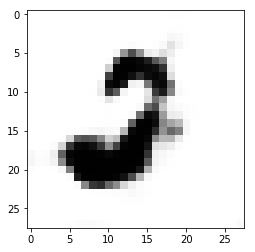

index no: 1


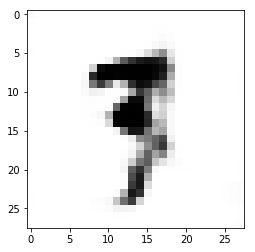

epoch no: 877
index no: 0


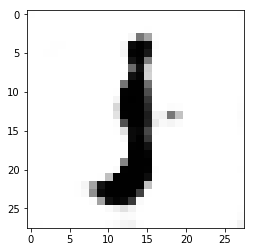

index no: 1


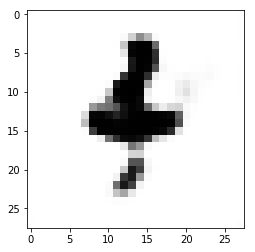

epoch no: 878
index no: 0


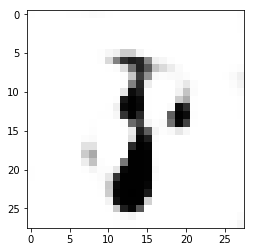

index no: 1


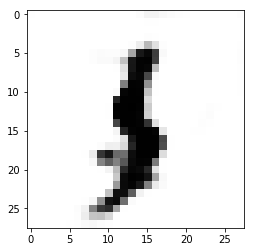

epoch no: 879
index no: 0


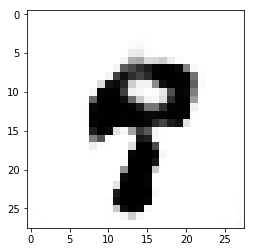

index no: 1


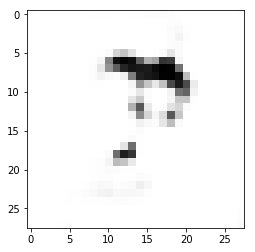

epoch no: 880
index no: 0


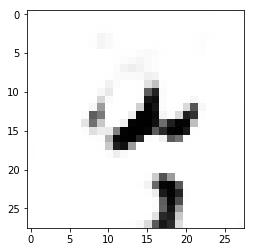

index no: 1


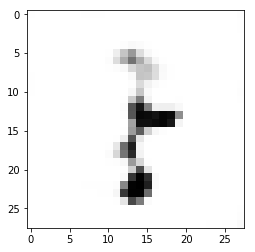

epoch no: 881
index no: 0


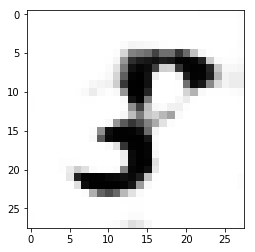

index no: 1


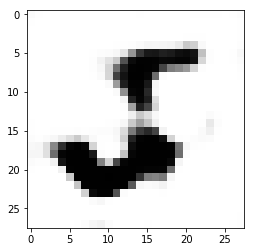

epoch no: 882
index no: 0


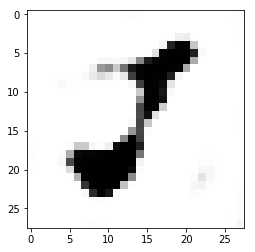

index no: 1


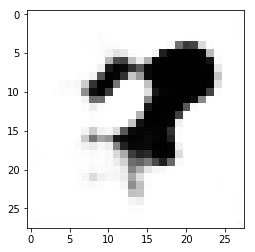

epoch no: 883
index no: 0


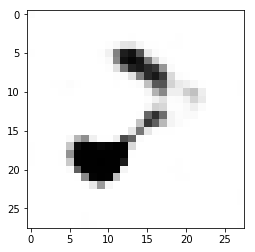

index no: 1


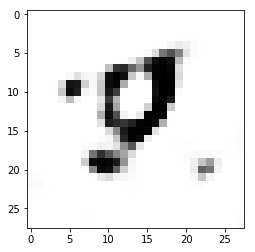

epoch no: 884
index no: 0


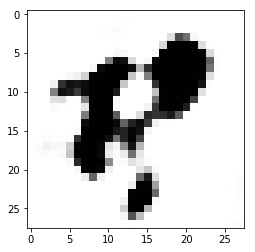

index no: 1


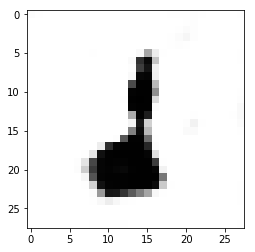

epoch no: 885
index no: 0


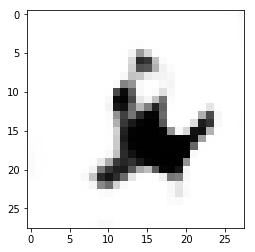

index no: 1


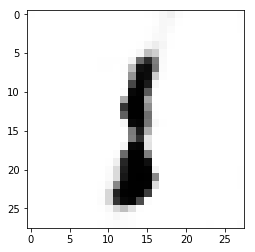

epoch no: 886
index no: 0


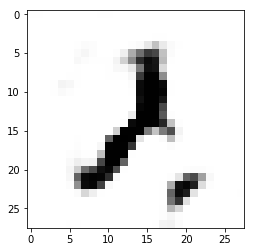

index no: 1


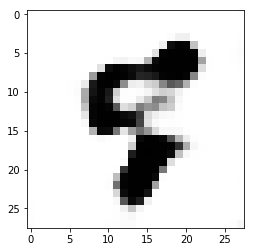

epoch no: 887
index no: 0


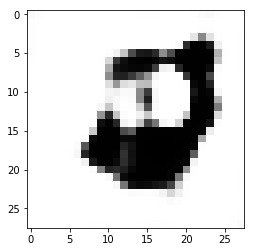

index no: 1


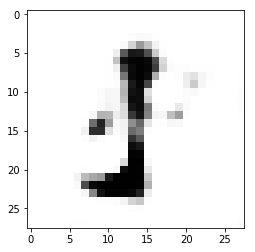

epoch no: 888
index no: 0


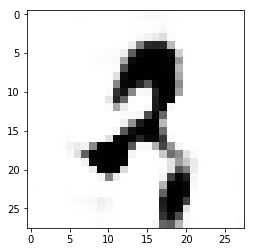

index no: 1


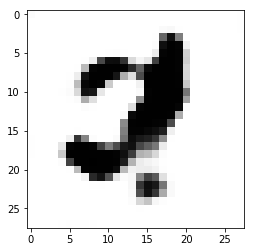

epoch no: 889
index no: 0


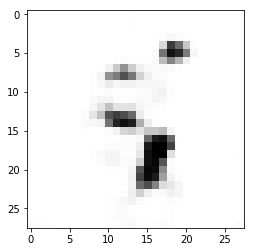

index no: 1


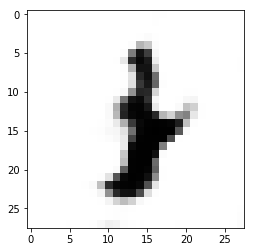

epoch no: 890
index no: 0


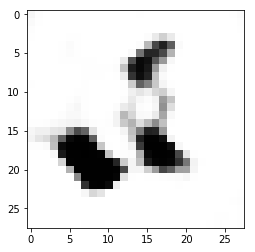

index no: 1


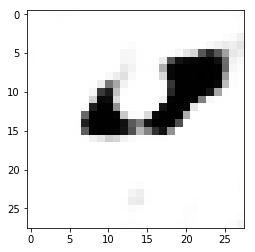

epoch no: 891
index no: 0


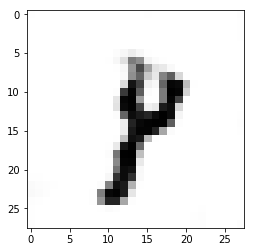

index no: 1


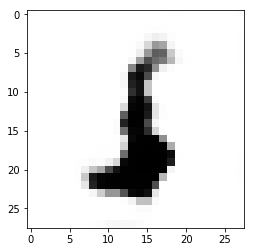

epoch no: 892
index no: 0


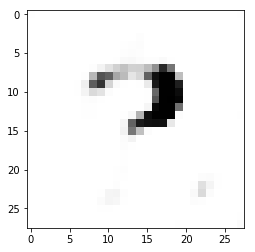

index no: 1


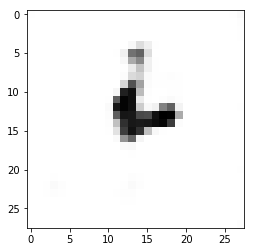

epoch no: 893
index no: 0


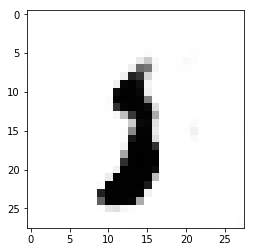

index no: 1


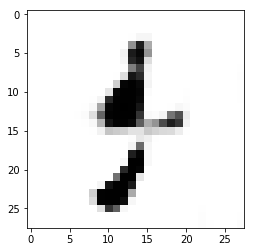

epoch no: 894
index no: 0


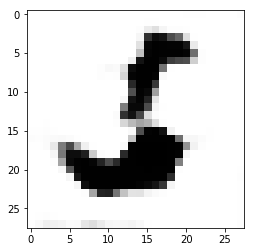

index no: 1


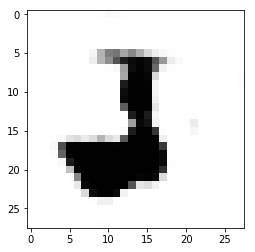

epoch no: 895
index no: 0


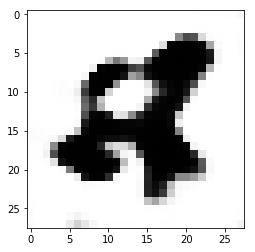

index no: 1


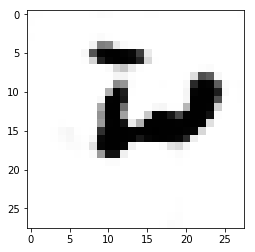

epoch no: 896
index no: 0


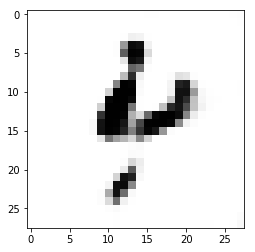

index no: 1


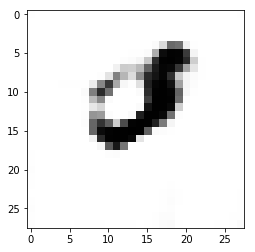

epoch no: 897
index no: 0


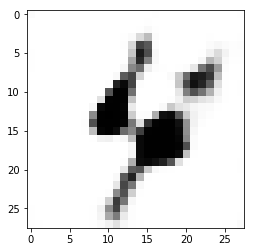

index no: 1


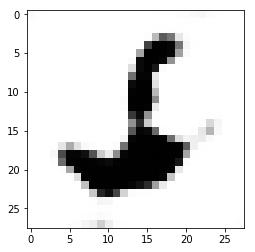

epoch no: 898
index no: 0


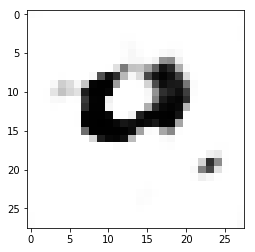

index no: 1


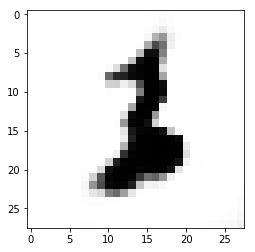

epoch no: 899
index no: 0


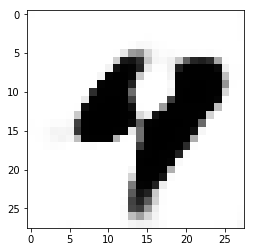

index no: 1


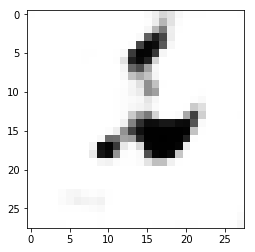

epoch no: 900
index no: 0


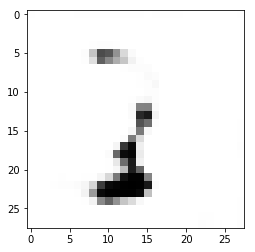

index no: 1


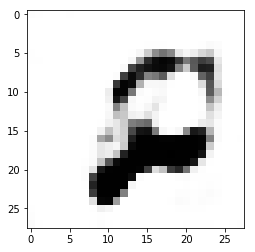

epoch no: 901
index no: 0


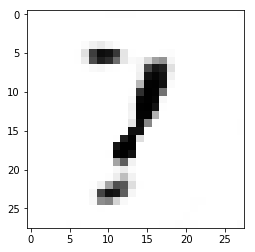

index no: 1


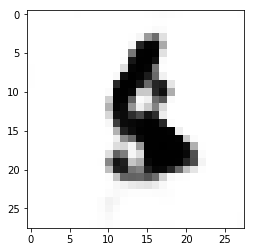

epoch no: 902
index no: 0


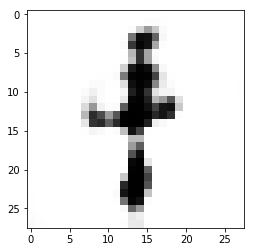

index no: 1


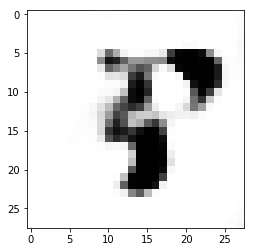

epoch no: 903
index no: 0


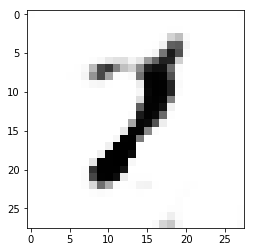

index no: 1


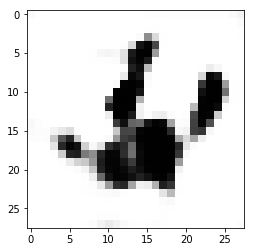

epoch no: 904
index no: 0


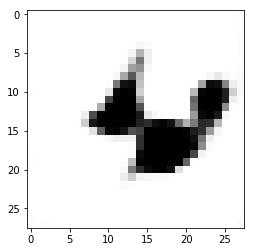

index no: 1


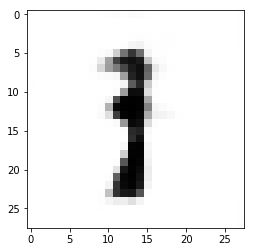

epoch no: 905
index no: 0


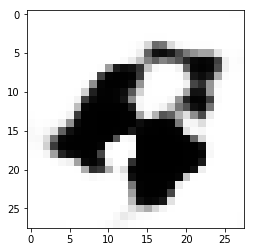

index no: 1


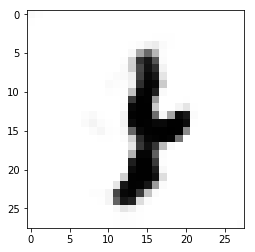

epoch no: 906
index no: 0


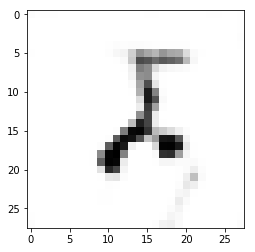

index no: 1


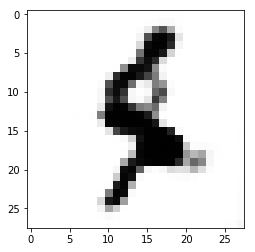

epoch no: 907
index no: 0


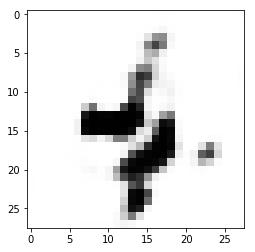

index no: 1


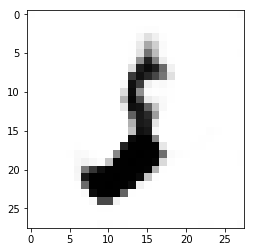

epoch no: 908
index no: 0


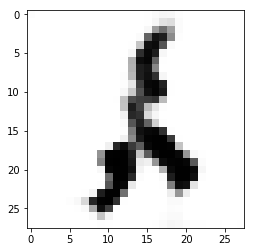

index no: 1


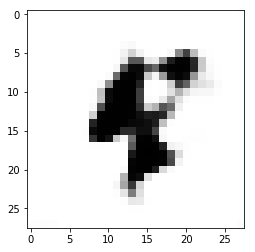

epoch no: 909
index no: 0


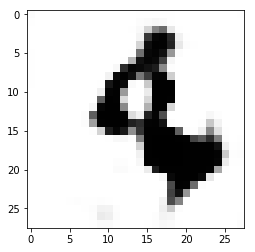

index no: 1


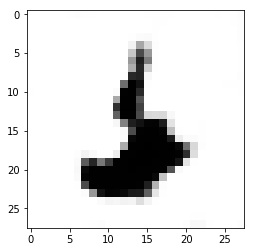

epoch no: 910
index no: 0


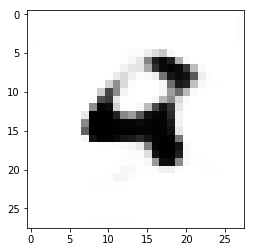

index no: 1


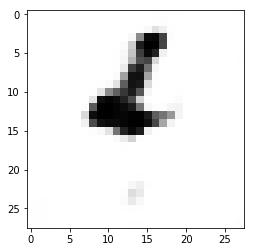

epoch no: 911
index no: 0


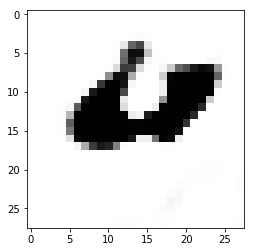

index no: 1


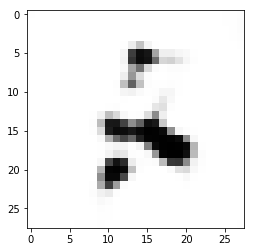

epoch no: 912
index no: 0


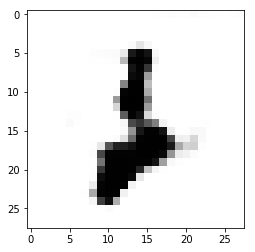

index no: 1


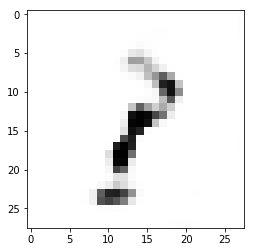

epoch no: 913
index no: 0


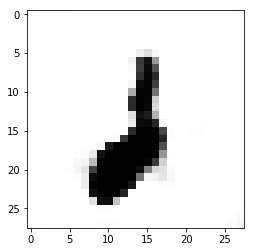

index no: 1


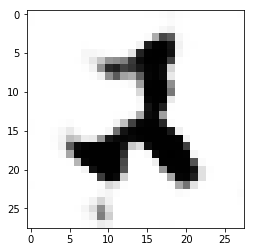

epoch no: 914
index no: 0


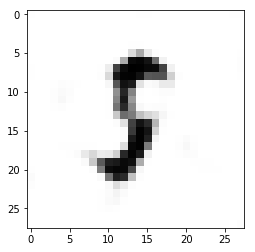

index no: 1


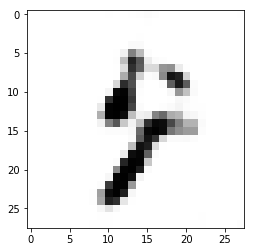

epoch no: 915
index no: 0


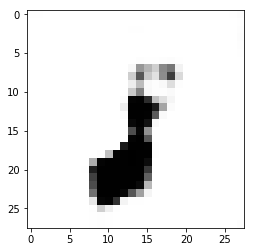

index no: 1


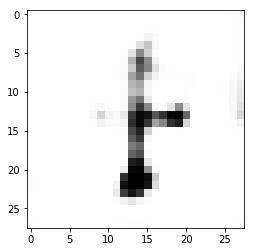

epoch no: 916
index no: 0


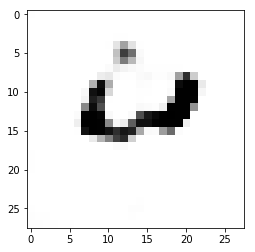

index no: 1


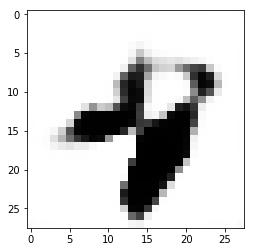

epoch no: 917
index no: 0


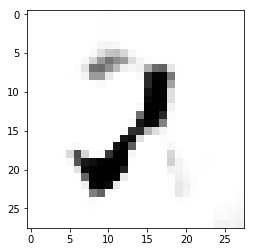

index no: 1


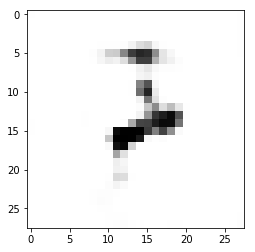

epoch no: 918
index no: 0


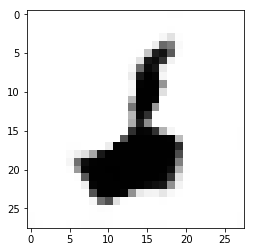

index no: 1


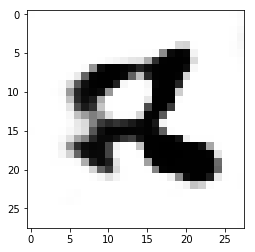

epoch no: 919
index no: 0


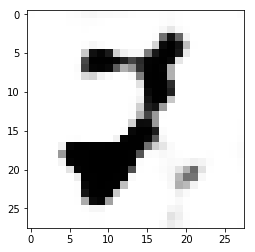

index no: 1


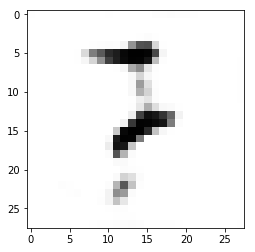

epoch no: 920
index no: 0


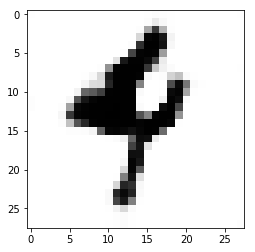

index no: 1


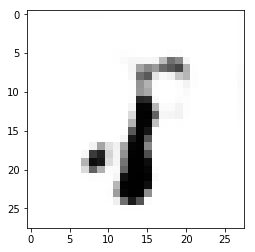

epoch no: 921
index no: 0


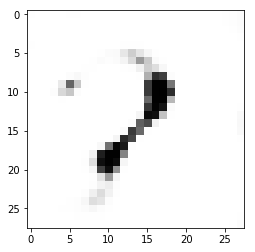

index no: 1


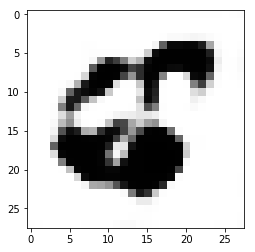

epoch no: 922
index no: 0


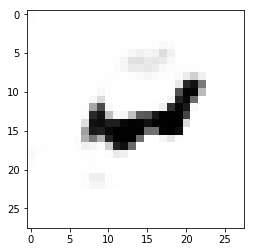

index no: 1


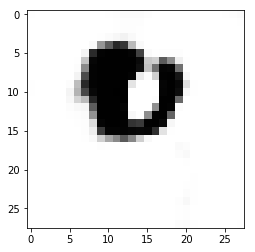

epoch no: 923
index no: 0


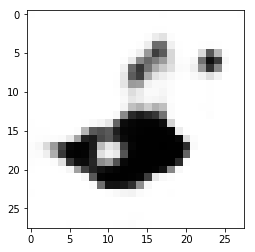

index no: 1


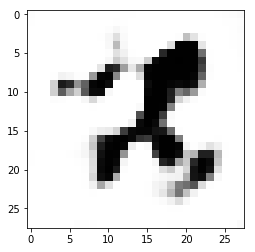

epoch no: 924
index no: 0


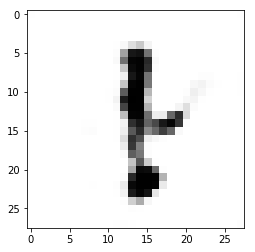

index no: 1


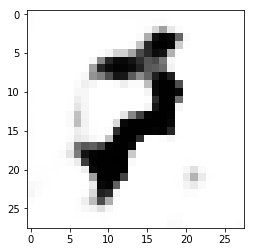

epoch no: 925
index no: 0


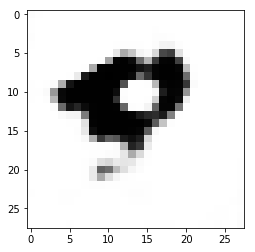

index no: 1


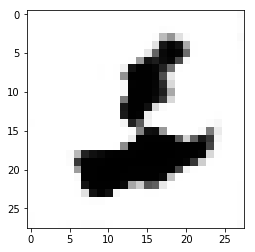

epoch no: 926
index no: 0


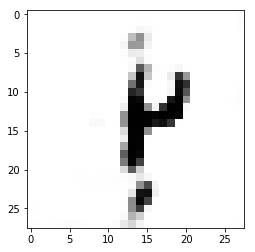

index no: 1


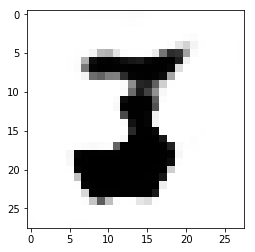

epoch no: 927
index no: 0


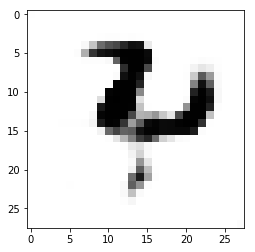

index no: 1


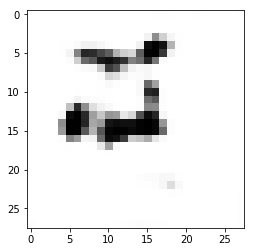

epoch no: 928
index no: 0


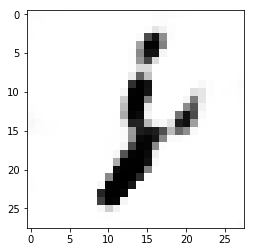

index no: 1


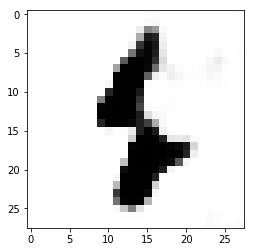

epoch no: 929
index no: 0


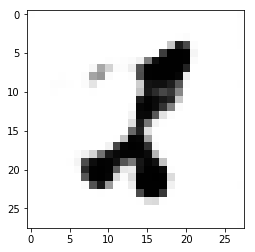

index no: 1


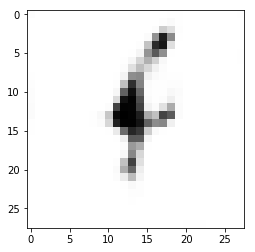

epoch no: 930
index no: 0


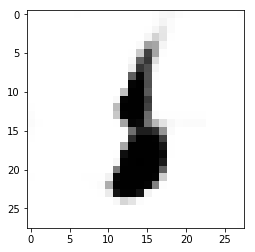

index no: 1


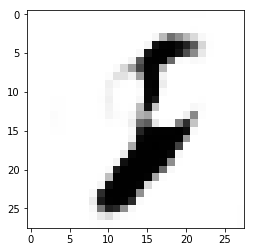

epoch no: 931
index no: 0


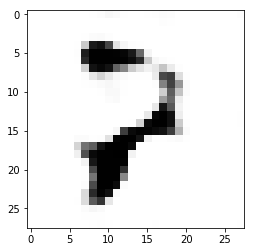

index no: 1


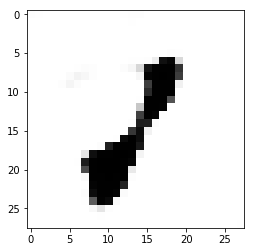

epoch no: 932
index no: 0


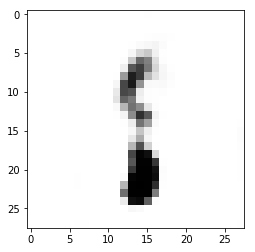

index no: 1


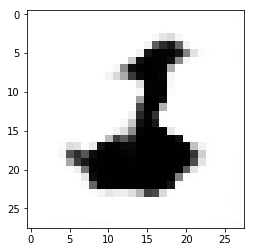

epoch no: 933
index no: 0


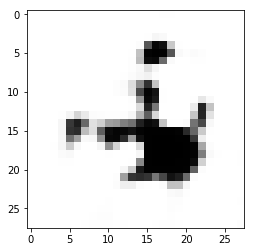

index no: 1


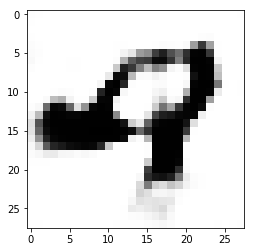

epoch no: 934
index no: 0


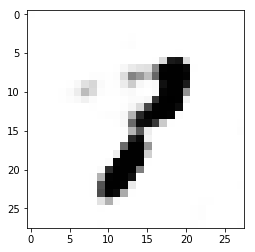

index no: 1


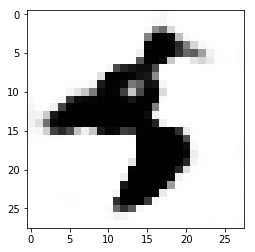

epoch no: 935
index no: 0


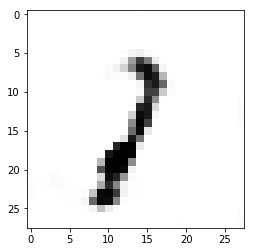

index no: 1


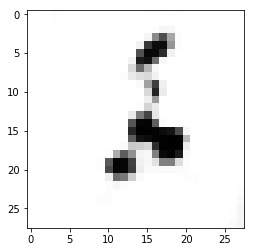

epoch no: 936
index no: 0


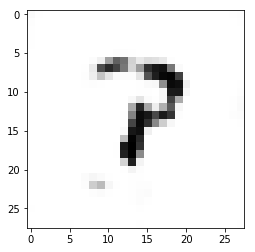

index no: 1


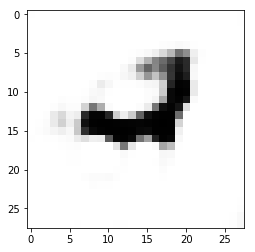

epoch no: 937
index no: 0


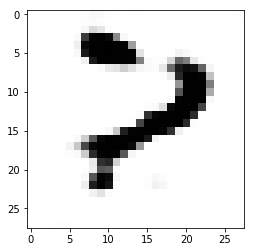

index no: 1


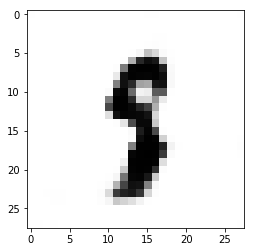

epoch no: 938
index no: 0


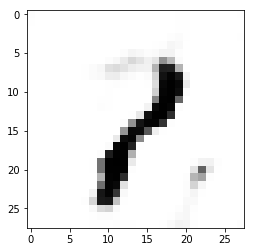

index no: 1


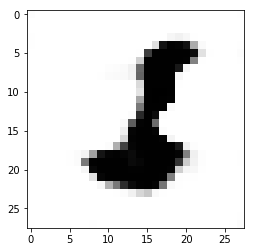

epoch no: 939
index no: 0


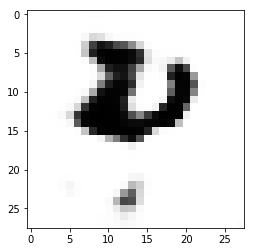

index no: 1


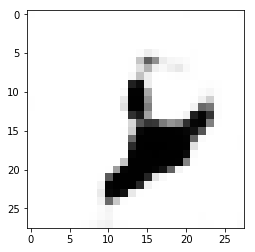

epoch no: 940
index no: 0


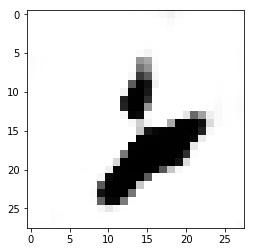

index no: 1


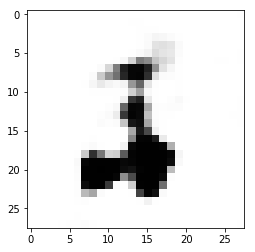

epoch no: 941
index no: 0


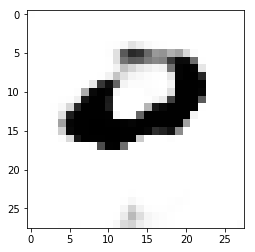

index no: 1


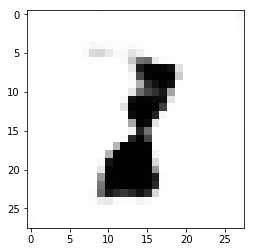

epoch no: 942
index no: 0


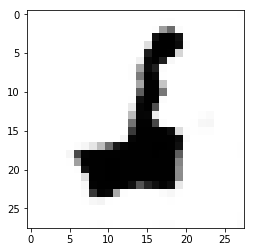

index no: 1


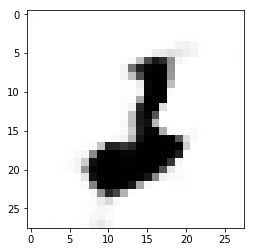

epoch no: 943
index no: 0


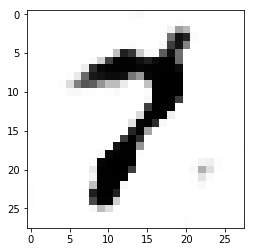

index no: 1


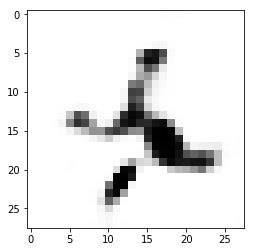

epoch no: 944
index no: 0


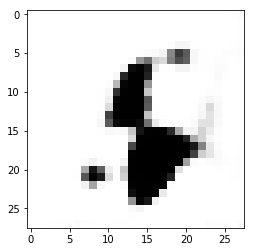

index no: 1


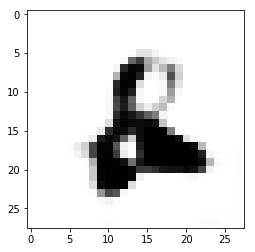

epoch no: 945
index no: 0


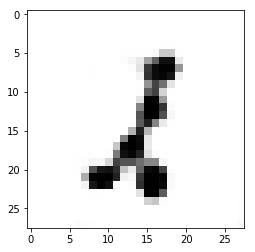

index no: 1


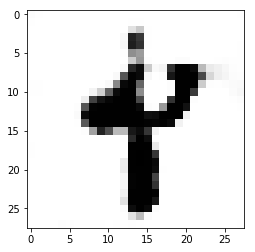

epoch no: 946
index no: 0


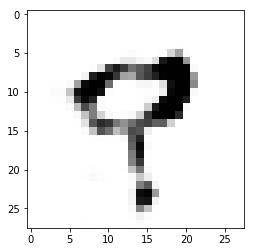

index no: 1


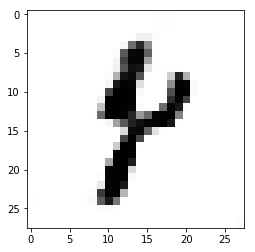

epoch no: 947
index no: 0


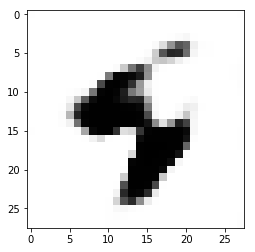

index no: 1


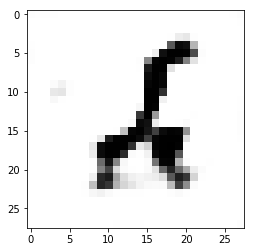

epoch no: 948
index no: 0


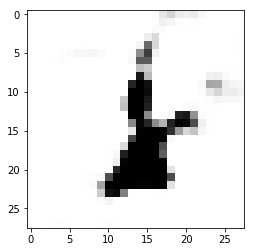

index no: 1


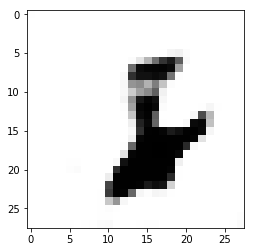

epoch no: 949
index no: 0


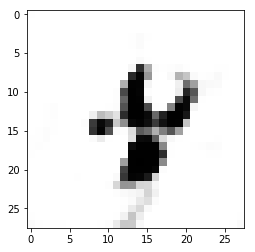

index no: 1


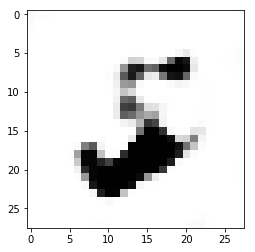

epoch no: 950
index no: 0


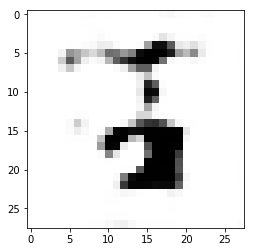

index no: 1


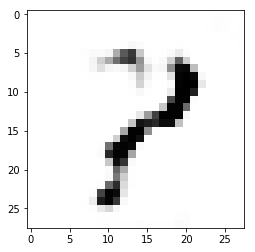

epoch no: 951
index no: 0


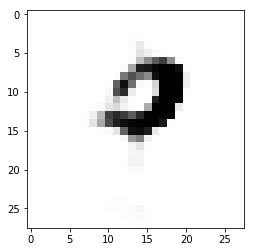

index no: 1


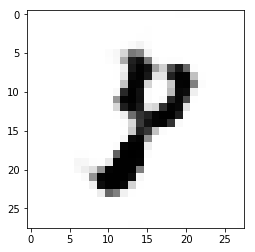

epoch no: 952
index no: 0


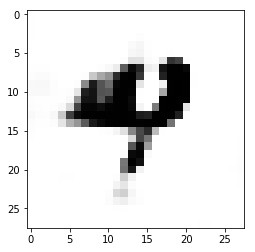

index no: 1


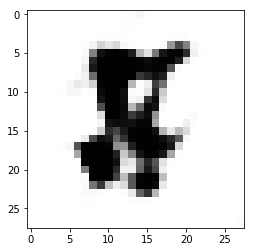

epoch no: 953
index no: 0


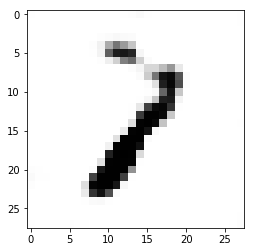

index no: 1


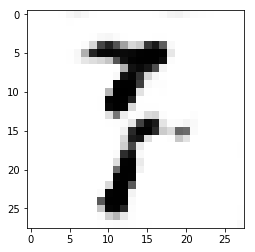

epoch no: 954
index no: 0


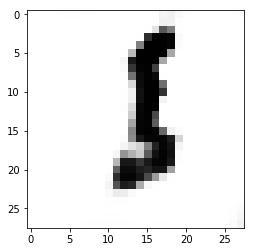

index no: 1


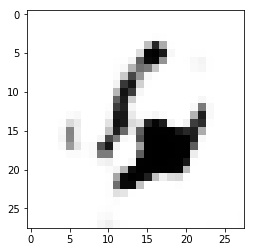

epoch no: 955
index no: 0


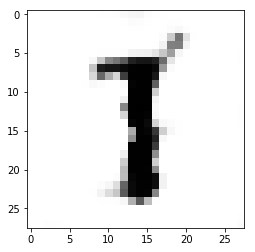

index no: 1


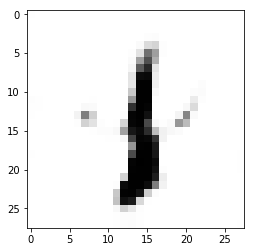

epoch no: 956
index no: 0


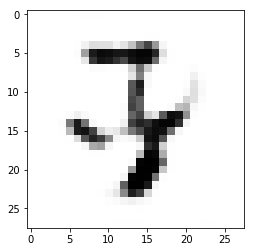

index no: 1


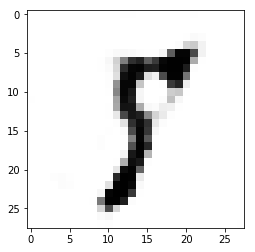

epoch no: 957
index no: 0


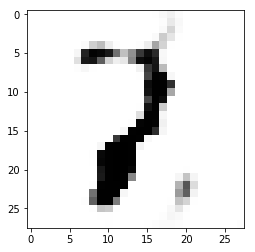

index no: 1


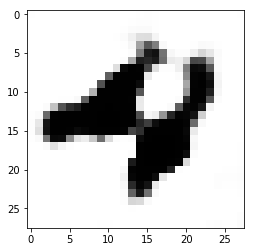

epoch no: 958
index no: 0


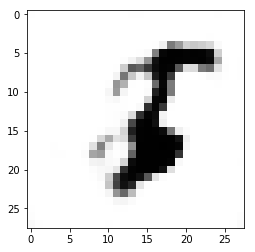

index no: 1


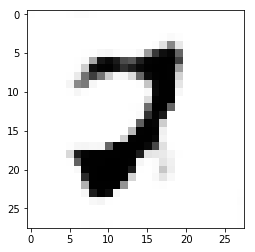

epoch no: 959
index no: 0


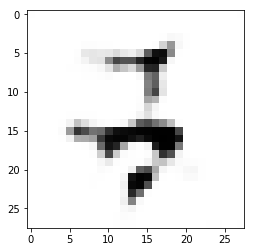

index no: 1


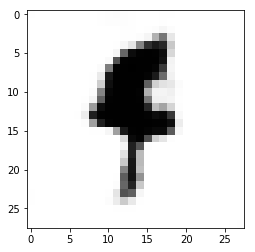

epoch no: 960
index no: 0


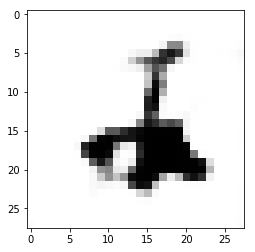

index no: 1


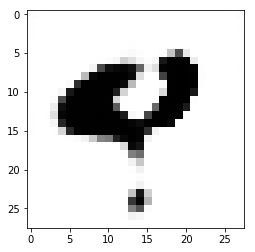

epoch no: 961
index no: 0


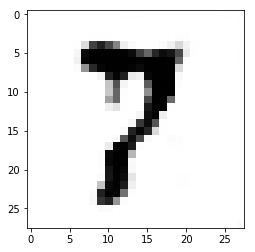

index no: 1


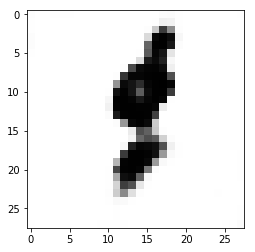

epoch no: 962
index no: 0


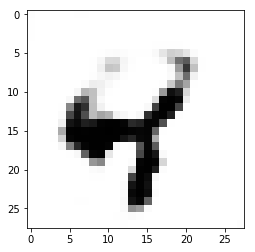

index no: 1


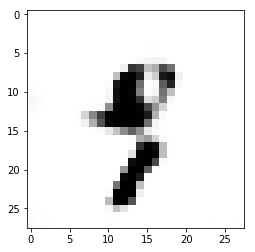

epoch no: 963
index no: 0


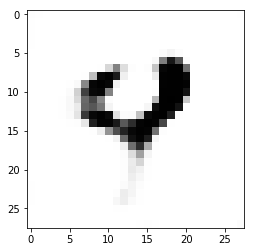

index no: 1


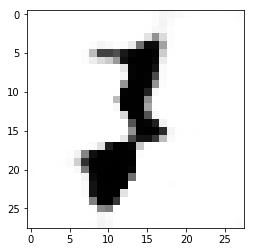

epoch no: 964
index no: 0


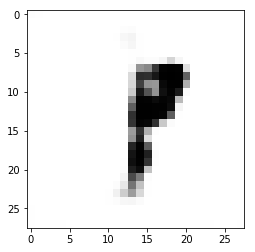

index no: 1


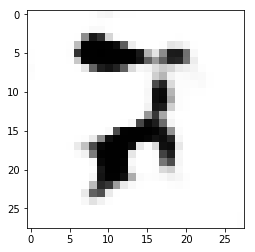

epoch no: 965
index no: 0


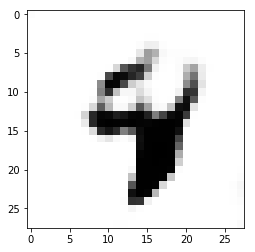

index no: 1


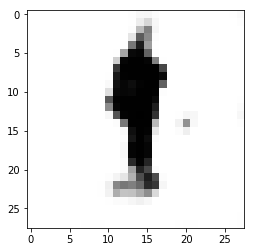

epoch no: 966
index no: 0


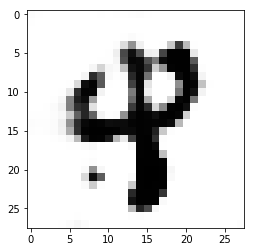

index no: 1


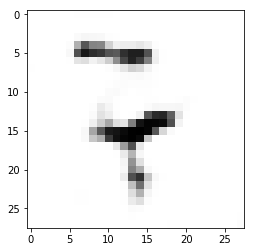

epoch no: 967
index no: 0


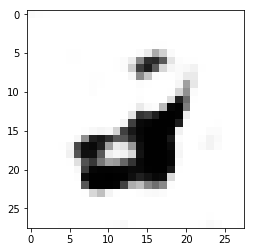

index no: 1


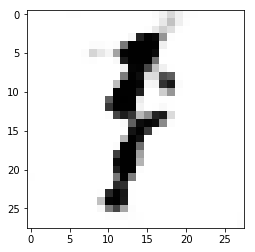

epoch no: 968
index no: 0


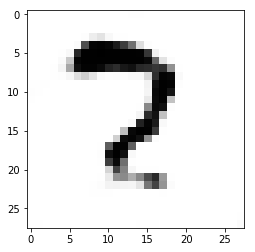

index no: 1


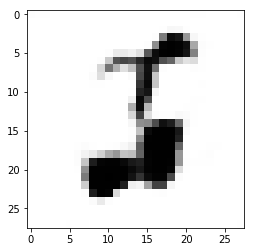

epoch no: 969
index no: 0


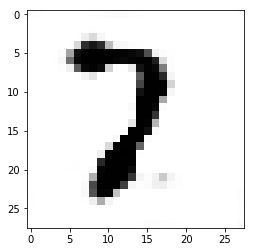

index no: 1


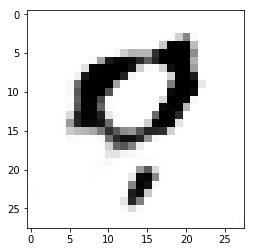

epoch no: 970
index no: 0


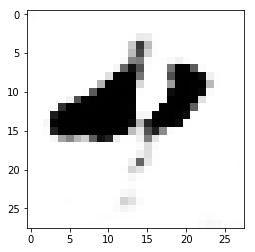

index no: 1


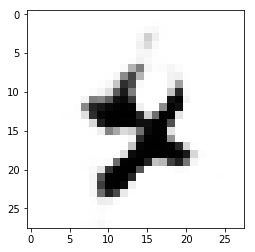

epoch no: 971
index no: 0


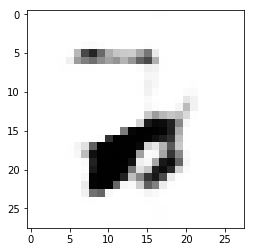

index no: 1


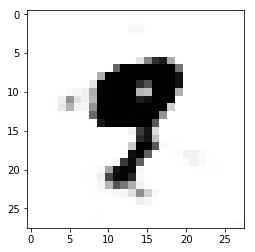

epoch no: 972
index no: 0


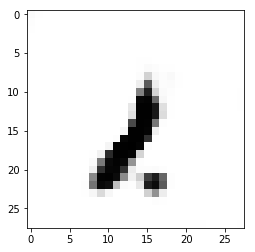

index no: 1


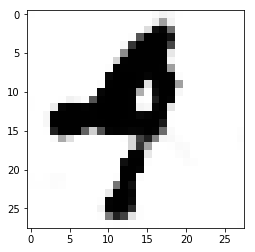

epoch no: 973
index no: 0


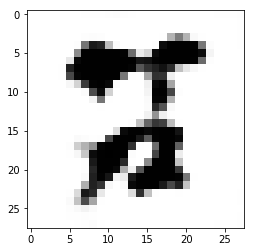

index no: 1


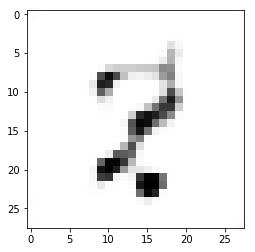

epoch no: 974
index no: 0


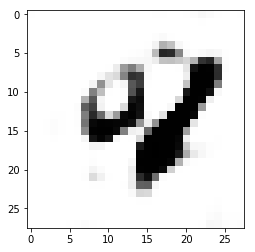

index no: 1


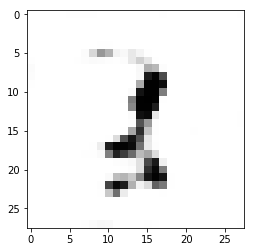

epoch no: 975
index no: 0


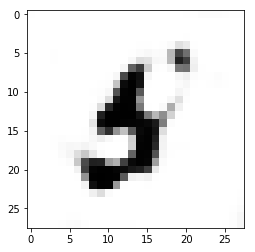

index no: 1


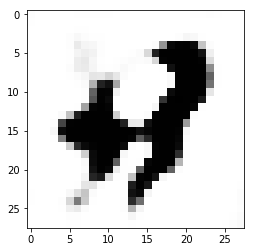

epoch no: 976
index no: 0


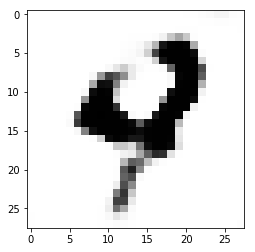

index no: 1


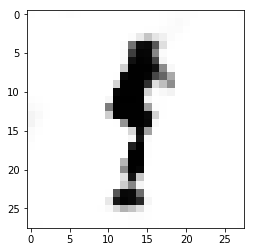

epoch no: 977
index no: 0


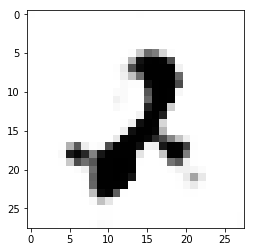

index no: 1


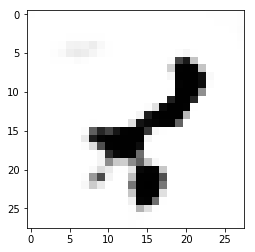

epoch no: 978
index no: 0


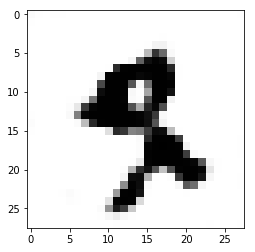

index no: 1


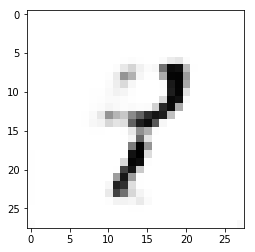

epoch no: 979
index no: 0


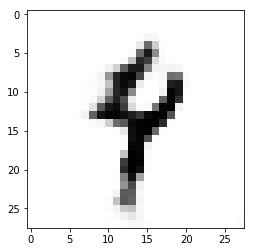

index no: 1


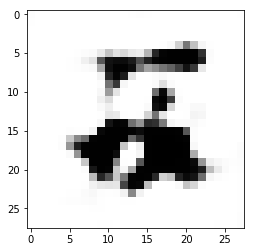

epoch no: 980
index no: 0


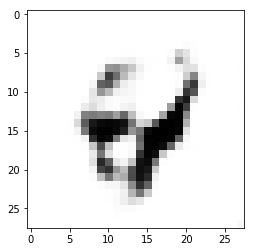

index no: 1


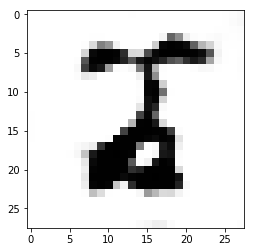

epoch no: 981
index no: 0


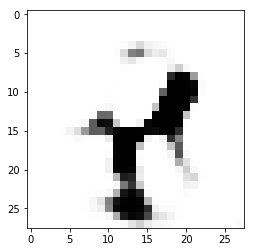

index no: 1


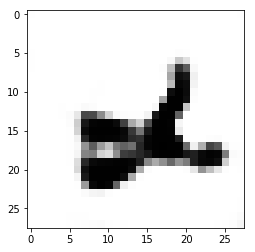

epoch no: 982
index no: 0


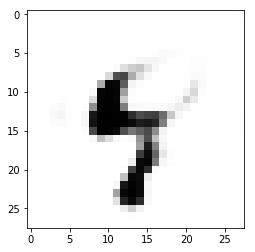

index no: 1


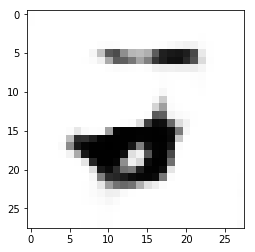

epoch no: 983
index no: 0


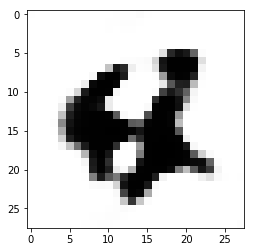

index no: 1


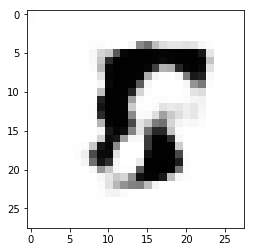

epoch no: 984
index no: 0


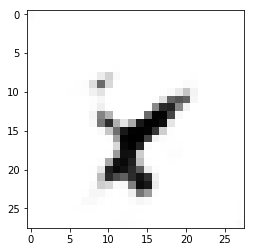

index no: 1


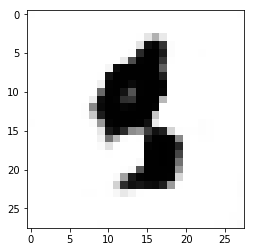

epoch no: 985
index no: 0


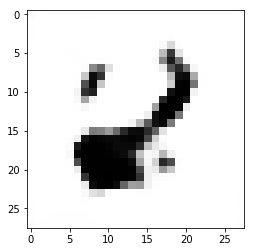

index no: 1


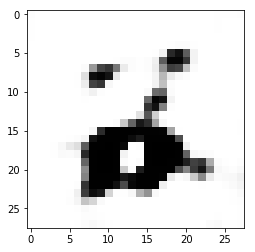

epoch no: 986
index no: 0


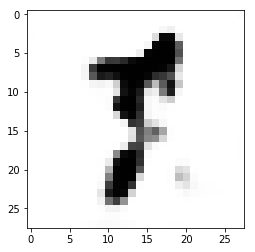

index no: 1


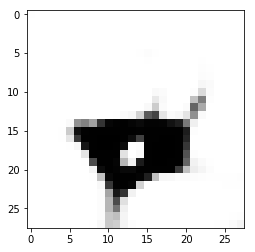

epoch no: 987
index no: 0


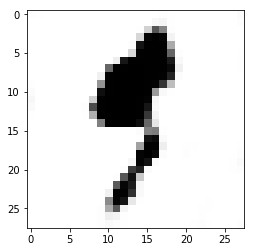

index no: 1


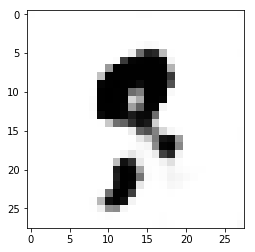

epoch no: 988
index no: 0


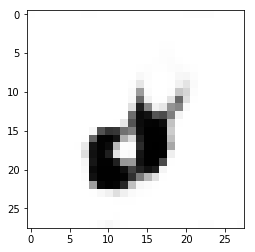

index no: 1


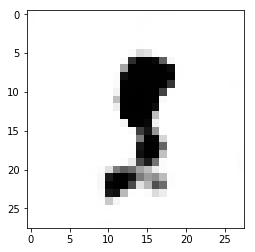

epoch no: 989
index no: 0


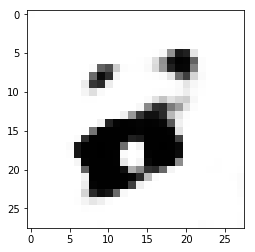

index no: 1


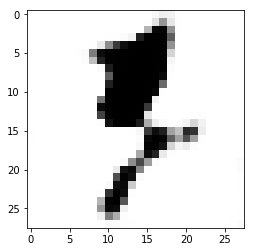

epoch no: 990
index no: 0


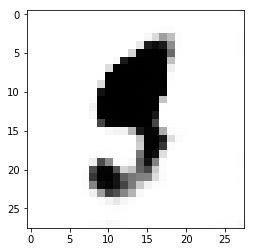

index no: 1


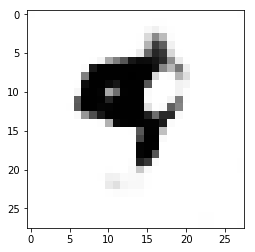

epoch no: 991
index no: 0


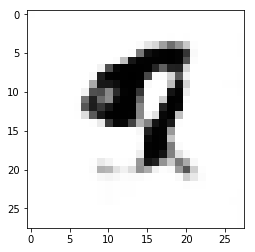

index no: 1


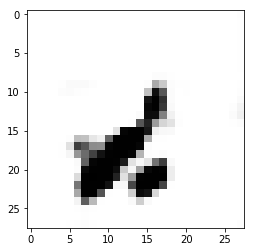

epoch no: 992
index no: 0


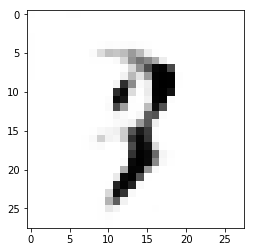

index no: 1


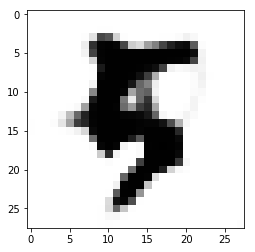

epoch no: 993
index no: 0


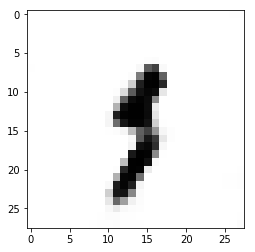

index no: 1


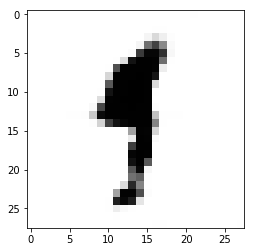

epoch no: 994
index no: 0


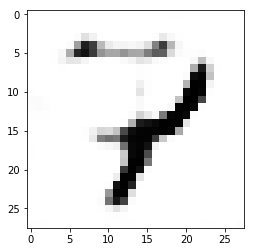

index no: 1


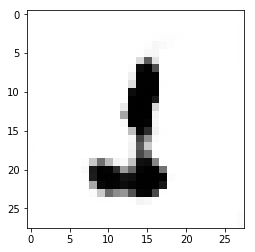

epoch no: 995
index no: 0


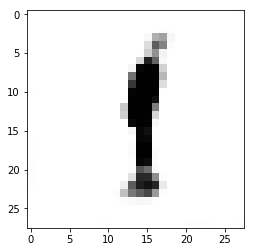

index no: 1


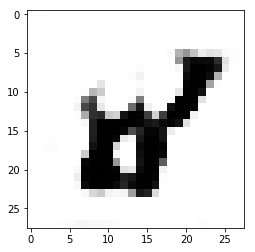

epoch no: 996
index no: 0


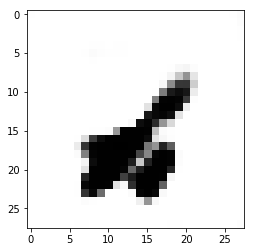

index no: 1


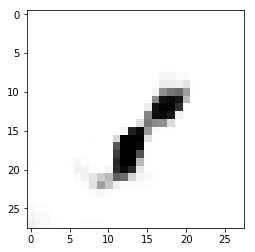

epoch no: 997
index no: 0


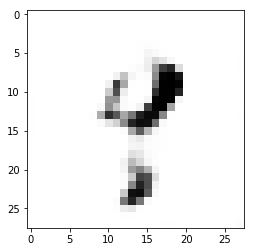

index no: 1


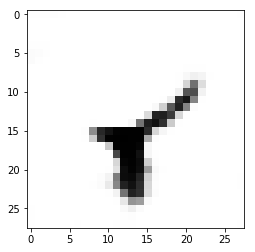

epoch no: 998
index no: 0


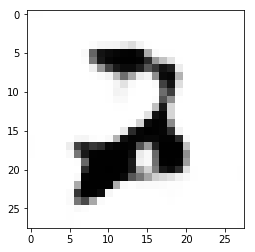

index no: 1


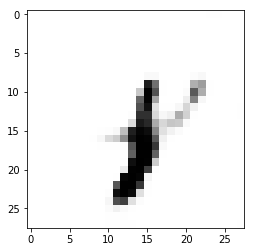

epoch no: 999
index no: 0


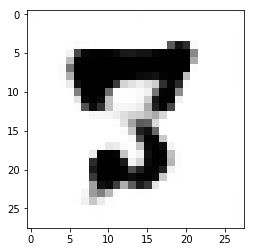

index no: 1


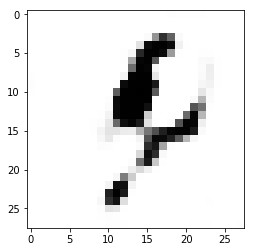

epoch no: 1000
index no: 0


index no: 1


epoch no: 1001
index no: 0


index no: 1


epoch no: 1002
index no: 0


index no: 1


epoch no: 1003
index no: 0


index no: 1


epoch no: 1004
index no: 0


index no: 1


epoch no: 1005
index no: 0


index no: 1


epoch no: 1006
index no: 0


index no: 1


epoch no: 1007
index no: 0


index no: 1


epoch no: 1008
index no: 0


index no: 1


epoch no: 1009
index no: 0


index no: 1


epoch no: 1010
index no: 0


index no: 1


epoch no: 1011
index no: 0


index no: 1


epoch no: 1012
index no: 0


index no: 1


epoch no: 1013
index no: 0


index no: 1


epoch no: 1014
index no: 0


index no: 1


epoch no: 1015
index no: 0


index no: 1


epoch no: 1016
index no: 0


index no: 1


epoch no: 1017
index no: 0


index no: 1


epoch no: 1018
index no: 0


index no: 1


epoch no: 1019
index no: 0


index no: 1


epoch no: 1020
index no: 0


index no: 1


epoch no: 1021
index no: 0


index no: 1


epoch no: 1022
index no: 0


index no: 1


epoch no: 1023
index no: 0


index no: 1


epoch no: 1024
index no: 0


index no: 1


epoch no: 1025
index no: 0


index no: 1


epoch no: 1026
index no: 0


index no: 1


epoch no: 1027
index no: 0


index no: 1


epoch no: 1028
index no: 0


index no: 1


epoch no: 1029
index no: 0


index no: 1


epoch no: 1030
index no: 0


index no: 1


epoch no: 1031
index no: 0


index no: 1


epoch no: 1032
index no: 0


index no: 1


epoch no: 1033
index no: 0


index no: 1


epoch no: 1034
index no: 0


index no: 1


epoch no: 1035
index no: 0


index no: 1


epoch no: 1036
index no: 0


index no: 1


epoch no: 1037
index no: 0


index no: 1


epoch no: 1038
index no: 0


index no: 1


epoch no: 1039
index no: 0


index no: 1


epoch no: 1040
index no: 0


index no: 1


epoch no: 1041
index no: 0


index no: 1


epoch no: 1042
index no: 0


index no: 1


epoch no: 1043
index no: 0


index no: 1


epoch no: 1044
index no: 0


index no: 1


epoch no: 1045
index no: 0


index no: 1


epoch no: 1046
index no: 0


index no: 1


epoch no: 1047
index no: 0


index no: 1


epoch no: 1048
index no: 0


index no: 1


epoch no: 1049
index no: 0


index no: 1


epoch no: 1050
index no: 0


index no: 1


epoch no: 1051
index no: 0


index no: 1


epoch no: 1052
index no: 0


index no: 1


epoch no: 1053
index no: 0


index no: 1


epoch no: 1054
index no: 0


index no: 1


epoch no: 1055
index no: 0


index no: 1


epoch no: 1056
index no: 0


index no: 1


epoch no: 1057
index no: 0


index no: 1


epoch no: 1058
index no: 0


index no: 1


epoch no: 1059
index no: 0


index no: 1


epoch no: 1060
index no: 0


index no: 1


epoch no: 1061
index no: 0


index no: 1


epoch no: 1062
index no: 0


index no: 1


epoch no: 1063
index no: 0


index no: 1


epoch no: 1064
index no: 0


index no: 1


epoch no: 1065
index no: 0


index no: 1


epoch no: 1066
index no: 0


index no: 1


epoch no: 1067
index no: 0


index no: 1


epoch no: 1068
index no: 0


index no: 1


epoch no: 1069
index no: 0


index no: 1


epoch no: 1070
index no: 0


index no: 1


epoch no: 1071
index no: 0


index no: 1


epoch no: 1072
index no: 0


index no: 1


epoch no: 1073
index no: 0


index no: 1


epoch no: 1074
index no: 0


index no: 1


epoch no: 1075
index no: 0


index no: 1


epoch no: 1076
index no: 0


index no: 1


epoch no: 1077
index no: 0


index no: 1


epoch no: 1078
index no: 0


index no: 1


epoch no: 1079
index no: 0


index no: 1


epoch no: 1080
index no: 0


index no: 1


epoch no: 1081
index no: 0


index no: 1


epoch no: 1082
index no: 0


index no: 1


epoch no: 1083
index no: 0


index no: 1


epoch no: 1084
index no: 0


index no: 1


epoch no: 1085
index no: 0


index no: 1


epoch no: 1086
index no: 0


index no: 1


epoch no: 1087
index no: 0


index no: 1


epoch no: 1088
index no: 0


index no: 1


epoch no: 1089
index no: 0


index no: 1


epoch no: 1090
index no: 0


index no: 1


epoch no: 1091
index no: 0


index no: 1


epoch no: 1092
index no: 0


index no: 1


epoch no: 1093
index no: 0


index no: 1


epoch no: 1094
index no: 0


index no: 1


epoch no: 1095
index no: 0


index no: 1


epoch no: 1096
index no: 0


index no: 1


epoch no: 1097
index no: 0


index no: 1


epoch no: 1098
index no: 0


index no: 1


epoch no: 1099
index no: 0


index no: 1


epoch no: 1100
index no: 0


index no: 1


epoch no: 1101
index no: 0


index no: 1


epoch no: 1102
index no: 0


index no: 1


epoch no: 1103
index no: 0


index no: 1


epoch no: 1104
index no: 0


index no: 1


epoch no: 1105
index no: 0


index no: 1


epoch no: 1106
index no: 0


index no: 1


epoch no: 1107
index no: 0


index no: 1


epoch no: 1108
index no: 0


index no: 1


epoch no: 1109
index no: 0


index no: 1


epoch no: 1110
index no: 0


index no: 1


epoch no: 1111
index no: 0


index no: 1


epoch no: 1112
index no: 0


index no: 1


epoch no: 1113
index no: 0


index no: 1


epoch no: 1114
index no: 0


index no: 1


epoch no: 1115
index no: 0


index no: 1


epoch no: 1116
index no: 0


index no: 1


epoch no: 1117
index no: 0


index no: 1


epoch no: 1118
index no: 0


index no: 1


epoch no: 1119
index no: 0


index no: 1


epoch no: 1120
index no: 0


index no: 1


epoch no: 1121
index no: 0


index no: 1


epoch no: 1122
index no: 0


index no: 1


epoch no: 1123
index no: 0


index no: 1


epoch no: 1124
index no: 0


index no: 1


epoch no: 1125
index no: 0


index no: 1


epoch no: 1126
index no: 0


index no: 1


epoch no: 1127
index no: 0


index no: 1


epoch no: 1128
index no: 0


index no: 1


epoch no: 1129
index no: 0


index no: 1


epoch no: 1130
index no: 0


index no: 1


epoch no: 1131
index no: 0


index no: 1


epoch no: 1132
index no: 0


index no: 1


epoch no: 1133
index no: 0


index no: 1


epoch no: 1134
index no: 0


index no: 1


epoch no: 1135
index no: 0


index no: 1


epoch no: 1136
index no: 0


index no: 1


epoch no: 1137
index no: 0


index no: 1


epoch no: 1138
index no: 0


index no: 1


epoch no: 1139
index no: 0


index no: 1


epoch no: 1140
index no: 0


index no: 1


epoch no: 1141
index no: 0


index no: 1


epoch no: 1142
index no: 0


index no: 1


epoch no: 1143
index no: 0


index no: 1


epoch no: 1144
index no: 0


index no: 1


epoch no: 1145
index no: 0


index no: 1


epoch no: 1146
index no: 0


index no: 1


epoch no: 1147
index no: 0


index no: 1


epoch no: 1148
index no: 0


index no: 1


epoch no: 1149
index no: 0


index no: 1


epoch no: 1150
index no: 0


index no: 1


epoch no: 1151
index no: 0


index no: 1


epoch no: 1152
index no: 0


index no: 1


epoch no: 1153
index no: 0


index no: 1


epoch no: 1154
index no: 0


index no: 1


epoch no: 1155
index no: 0


index no: 1


epoch no: 1156
index no: 0


index no: 1


epoch no: 1157
index no: 0


index no: 1


epoch no: 1158
index no: 0


index no: 1


epoch no: 1159
index no: 0


index no: 1


epoch no: 1160
index no: 0


index no: 1


epoch no: 1161
index no: 0


index no: 1


epoch no: 1162
index no: 0


index no: 1


epoch no: 1163
index no: 0


index no: 1


epoch no: 1164
index no: 0


index no: 1


epoch no: 1165
index no: 0


index no: 1


epoch no: 1166
index no: 0


index no: 1


epoch no: 1167
index no: 0


index no: 1


epoch no: 1168
index no: 0


index no: 1


epoch no: 1169
index no: 0


index no: 1


epoch no: 1170
index no: 0


index no: 1


epoch no: 1171
index no: 0


index no: 1


epoch no: 1172
index no: 0


index no: 1


epoch no: 1173
index no: 0


index no: 1


epoch no: 1174
index no: 0


index no: 1


epoch no: 1175
index no: 0


index no: 1


epoch no: 1176
index no: 0


index no: 1


epoch no: 1177
index no: 0


index no: 1


epoch no: 1178
index no: 0


index no: 1


epoch no: 1179
index no: 0


index no: 1


epoch no: 1180
index no: 0


index no: 1


epoch no: 1181
index no: 0


index no: 1


epoch no: 1182
index no: 0


index no: 1


epoch no: 1183
index no: 0


index no: 1


epoch no: 1184
index no: 0


index no: 1


epoch no: 1185
index no: 0


index no: 1


epoch no: 1186
index no: 0


index no: 1


epoch no: 1187
index no: 0


index no: 1


epoch no: 1188
index no: 0


index no: 1


epoch no: 1189
index no: 0


index no: 1


epoch no: 1190
index no: 0


index no: 1


epoch no: 1191
index no: 0


index no: 1


epoch no: 1192
index no: 0


index no: 1


epoch no: 1193
index no: 0


index no: 1


epoch no: 1194
index no: 0


index no: 1


epoch no: 1195
index no: 0


index no: 1


epoch no: 1196
index no: 0


index no: 1


epoch no: 1197
index no: 0


index no: 1


epoch no: 1198
index no: 0


index no: 1


epoch no: 1199
index no: 0


index no: 1


epoch no: 1200
index no: 0


index no: 1


epoch no: 1201
index no: 0


index no: 1


epoch no: 1202
index no: 0


index no: 1


epoch no: 1203
index no: 0


index no: 1


epoch no: 1204
index no: 0


index no: 1


epoch no: 1205
index no: 0


index no: 1


epoch no: 1206
index no: 0


index no: 1


epoch no: 1207
index no: 0


index no: 1


epoch no: 1208
index no: 0


index no: 1


epoch no: 1209
index no: 0


index no: 1


epoch no: 1210
index no: 0


index no: 1


epoch no: 1211
index no: 0


index no: 1


epoch no: 1212
index no: 0


index no: 1


epoch no: 1213
index no: 0


index no: 1


epoch no: 1214
index no: 0


index no: 1


epoch no: 1215
index no: 0


index no: 1


epoch no: 1216
index no: 0


index no: 1


epoch no: 1217
index no: 0


index no: 1


epoch no: 1218
index no: 0


index no: 1


epoch no: 1219
index no: 0


index no: 1


epoch no: 1220
index no: 0


index no: 1


epoch no: 1221
index no: 0


index no: 1


epoch no: 1222
index no: 0


index no: 1


epoch no: 1223
index no: 0


index no: 1


epoch no: 1224
index no: 0


index no: 1


epoch no: 1225
index no: 0


index no: 1


epoch no: 1226
index no: 0


index no: 1


epoch no: 1227
index no: 0


index no: 1


epoch no: 1228
index no: 0


index no: 1


epoch no: 1229
index no: 0


index no: 1


epoch no: 1230
index no: 0


index no: 1


epoch no: 1231
index no: 0


index no: 1


epoch no: 1232
index no: 0


index no: 1


epoch no: 1233
index no: 0


index no: 1


epoch no: 1234
index no: 0


index no: 1


epoch no: 1235
index no: 0


index no: 1


epoch no: 1236
index no: 0


index no: 1


epoch no: 1237
index no: 0


index no: 1


epoch no: 1238
index no: 0


index no: 1


epoch no: 1239
index no: 0


index no: 1


epoch no: 1240
index no: 0


index no: 1


epoch no: 1241
index no: 0


index no: 1


epoch no: 1242
index no: 0


index no: 1


epoch no: 1243
index no: 0


index no: 1


epoch no: 1244
index no: 0


index no: 1


epoch no: 1245
index no: 0


index no: 1


epoch no: 1246
index no: 0


index no: 1


epoch no: 1247
index no: 0


index no: 1


epoch no: 1248
index no: 0


index no: 1


epoch no: 1249
index no: 0


index no: 1


epoch no: 1250
index no: 0


index no: 1


epoch no: 1251
index no: 0


index no: 1


epoch no: 1252
index no: 0


index no: 1


epoch no: 1253
index no: 0


index no: 1


epoch no: 1254
index no: 0


index no: 1


epoch no: 1255
index no: 0


index no: 1


epoch no: 1256
index no: 0


index no: 1


epoch no: 1257
index no: 0


index no: 1


epoch no: 1258
index no: 0


index no: 1


epoch no: 1259
index no: 0


index no: 1


epoch no: 1260
index no: 0


index no: 1


epoch no: 1261
index no: 0


index no: 1


epoch no: 1262
index no: 0


index no: 1


epoch no: 1263
index no: 0


index no: 1


epoch no: 1264
index no: 0


index no: 1


epoch no: 1265
index no: 0


index no: 1


epoch no: 1266
index no: 0


index no: 1


epoch no: 1267
index no: 0


index no: 1


epoch no: 1268
index no: 0


index no: 1


epoch no: 1269
index no: 0


index no: 1


epoch no: 1270
index no: 0


index no: 1


epoch no: 1271
index no: 0


index no: 1


epoch no: 1272
index no: 0


index no: 1


epoch no: 1273
index no: 0


index no: 1


epoch no: 1274
index no: 0


index no: 1


epoch no: 1275
index no: 0


index no: 1


epoch no: 1276
index no: 0


index no: 1


epoch no: 1277
index no: 0


index no: 1


epoch no: 1278
index no: 0


index no: 1


epoch no: 1279
index no: 0


index no: 1


epoch no: 1280
index no: 0


index no: 1


epoch no: 1281
index no: 0


index no: 1


epoch no: 1282
index no: 0


index no: 1


epoch no: 1283
index no: 0


index no: 1


epoch no: 1284
index no: 0


index no: 1


epoch no: 1285
index no: 0


index no: 1


epoch no: 1286
index no: 0


index no: 1


epoch no: 1287
index no: 0


index no: 1


epoch no: 1288
index no: 0


index no: 1


epoch no: 1289
index no: 0


index no: 1


epoch no: 1290
index no: 0


index no: 1


epoch no: 1291
index no: 0


index no: 1


epoch no: 1292
index no: 0


index no: 1


epoch no: 1293
index no: 0


index no: 1


epoch no: 1294
index no: 0


index no: 1


epoch no: 1295
index no: 0


index no: 1


epoch no: 1296
index no: 0


index no: 1


epoch no: 1297
index no: 0


index no: 1


epoch no: 1298
index no: 0


index no: 1


epoch no: 1299
index no: 0


index no: 1


epoch no: 1300
index no: 0


index no: 1


epoch no: 1301
index no: 0


index no: 1


epoch no: 1302
index no: 0


index no: 1


epoch no: 1303
index no: 0


index no: 1


epoch no: 1304
index no: 0


index no: 1


epoch no: 1305
index no: 0


index no: 1


epoch no: 1306
index no: 0


index no: 1


epoch no: 1307
index no: 0


index no: 1


epoch no: 1308
index no: 0


index no: 1


epoch no: 1309
index no: 0


index no: 1


epoch no: 1310
index no: 0


index no: 1


epoch no: 1311
index no: 0


index no: 1


epoch no: 1312
index no: 0


index no: 1


epoch no: 1313
index no: 0


index no: 1


epoch no: 1314
index no: 0


index no: 1


epoch no: 1315
index no: 0


index no: 1


epoch no: 1316
index no: 0


index no: 1


epoch no: 1317
index no: 0


index no: 1


epoch no: 1318
index no: 0


index no: 1


epoch no: 1319
index no: 0


index no: 1


epoch no: 1320
index no: 0


index no: 1


epoch no: 1321
index no: 0


index no: 1


epoch no: 1322
index no: 0


index no: 1


epoch no: 1323
index no: 0


index no: 1


epoch no: 1324
index no: 0


index no: 1


epoch no: 1325
index no: 0


index no: 1


epoch no: 1326
index no: 0


index no: 1


epoch no: 1327
index no: 0


index no: 1


epoch no: 1328
index no: 0


index no: 1


epoch no: 1329
index no: 0


index no: 1


epoch no: 1330
index no: 0


index no: 1


epoch no: 1331
index no: 0


index no: 1


epoch no: 1332
index no: 0


index no: 1


epoch no: 1333
index no: 0


index no: 1


epoch no: 1334
index no: 0


index no: 1


epoch no: 1335
index no: 0


index no: 1


epoch no: 1336
index no: 0


index no: 1


epoch no: 1337
index no: 0


index no: 1


epoch no: 1338
index no: 0


index no: 1


epoch no: 1339
index no: 0


index no: 1


epoch no: 1340
index no: 0


index no: 1


epoch no: 1341
index no: 0


index no: 1


epoch no: 1342
index no: 0


index no: 1


epoch no: 1343
index no: 0


index no: 1


epoch no: 1344
index no: 0


index no: 1


epoch no: 1345
index no: 0


index no: 1


epoch no: 1346
index no: 0


index no: 1


epoch no: 1347
index no: 0


index no: 1


epoch no: 1348
index no: 0


index no: 1


epoch no: 1349
index no: 0


index no: 1


epoch no: 1350
index no: 0


index no: 1


epoch no: 1351
index no: 0


index no: 1


epoch no: 1352
index no: 0


index no: 1


epoch no: 1353
index no: 0


index no: 1


epoch no: 1354
index no: 0


index no: 1


epoch no: 1355
index no: 0


index no: 1


epoch no: 1356
index no: 0


index no: 1


epoch no: 1357
index no: 0


index no: 1


epoch no: 1358
index no: 0


index no: 1


epoch no: 1359
index no: 0


index no: 1


epoch no: 1360
index no: 0


index no: 1


epoch no: 1361
index no: 0


index no: 1


epoch no: 1362
index no: 0


index no: 1


epoch no: 1363
index no: 0


index no: 1


epoch no: 1364
index no: 0


index no: 1


epoch no: 1365
index no: 0


index no: 1


epoch no: 1366
index no: 0


index no: 1


epoch no: 1367
index no: 0


index no: 1


epoch no: 1368
index no: 0


index no: 1


epoch no: 1369
index no: 0


index no: 1


epoch no: 1370
index no: 0


index no: 1


epoch no: 1371
index no: 0


index no: 1


epoch no: 1372
index no: 0


index no: 1


epoch no: 1373
index no: 0


index no: 1


epoch no: 1374
index no: 0


index no: 1


epoch no: 1375
index no: 0


index no: 1


epoch no: 1376
index no: 0


index no: 1


epoch no: 1377
index no: 0


index no: 1


epoch no: 1378
index no: 0


index no: 1


epoch no: 1379
index no: 0


index no: 1


epoch no: 1380
index no: 0


index no: 1


epoch no: 1381
index no: 0


index no: 1


epoch no: 1382
index no: 0


index no: 1


epoch no: 1383
index no: 0


index no: 1


epoch no: 1384
index no: 0


index no: 1


epoch no: 1385
index no: 0


index no: 1


epoch no: 1386
index no: 0


index no: 1


epoch no: 1387
index no: 0


index no: 1


epoch no: 1388
index no: 0


index no: 1


epoch no: 1389
index no: 0


index no: 1


epoch no: 1390
index no: 0


index no: 1


epoch no: 1391
index no: 0


index no: 1


epoch no: 1392
index no: 0


index no: 1


epoch no: 1393
index no: 0


index no: 1


epoch no: 1394
index no: 0


index no: 1


epoch no: 1395
index no: 0


index no: 1


epoch no: 1396
index no: 0


index no: 1


epoch no: 1397
index no: 0


index no: 1


epoch no: 1398
index no: 0


index no: 1


epoch no: 1399
index no: 0


index no: 1


epoch no: 1400
index no: 0


index no: 1


epoch no: 1401
index no: 0


index no: 1


epoch no: 1402
index no: 0


index no: 1


epoch no: 1403
index no: 0


index no: 1


epoch no: 1404
index no: 0


index no: 1


epoch no: 1405
index no: 0


index no: 1


epoch no: 1406
index no: 0


index no: 1


epoch no: 1407
index no: 0


index no: 1


epoch no: 1408
index no: 0


index no: 1


epoch no: 1409
index no: 0


index no: 1


epoch no: 1410
index no: 0


index no: 1


epoch no: 1411
index no: 0


index no: 1


epoch no: 1412
index no: 0


index no: 1


epoch no: 1413
index no: 0


index no: 1


epoch no: 1414
index no: 0


index no: 1


epoch no: 1415
index no: 0


index no: 1


epoch no: 1416
index no: 0


index no: 1


epoch no: 1417
index no: 0


index no: 1


epoch no: 1418
index no: 0


index no: 1


epoch no: 1419
index no: 0


index no: 1


epoch no: 1420
index no: 0


index no: 1


epoch no: 1421
index no: 0


index no: 1


epoch no: 1422
index no: 0


index no: 1


epoch no: 1423
index no: 0


index no: 1


epoch no: 1424
index no: 0


index no: 1


epoch no: 1425
index no: 0


index no: 1


epoch no: 1426
index no: 0


index no: 1


epoch no: 1427
index no: 0


index no: 1


epoch no: 1428
index no: 0


index no: 1


epoch no: 1429
index no: 0


index no: 1


epoch no: 1430
index no: 0


index no: 1


epoch no: 1431
index no: 0


index no: 1


epoch no: 1432
index no: 0


index no: 1


epoch no: 1433
index no: 0


index no: 1


epoch no: 1434
index no: 0


index no: 1


epoch no: 1435
index no: 0


index no: 1


epoch no: 1436
index no: 0


index no: 1


epoch no: 1437
index no: 0


index no: 1


epoch no: 1438
index no: 0


index no: 1


epoch no: 1439
index no: 0


index no: 1


epoch no: 1440
index no: 0


index no: 1


epoch no: 1441
index no: 0


index no: 1


epoch no: 1442
index no: 0


index no: 1


epoch no: 1443
index no: 0


index no: 1


epoch no: 1444
index no: 0


index no: 1


epoch no: 1445
index no: 0


index no: 1


epoch no: 1446
index no: 0


index no: 1


epoch no: 1447
index no: 0


index no: 1


epoch no: 1448
index no: 0


index no: 1


epoch no: 1449
index no: 0


index no: 1


epoch no: 1450
index no: 0


index no: 1


epoch no: 1451
index no: 0


index no: 1


epoch no: 1452
index no: 0


index no: 1


epoch no: 1453
index no: 0


index no: 1


epoch no: 1454
index no: 0


index no: 1


epoch no: 1455
index no: 0


index no: 1


epoch no: 1456
index no: 0


index no: 1


epoch no: 1457
index no: 0


index no: 1


epoch no: 1458
index no: 0


index no: 1


epoch no: 1459
index no: 0


index no: 1


epoch no: 1460
index no: 0


index no: 1


epoch no: 1461
index no: 0


index no: 1


epoch no: 1462
index no: 0


index no: 1


epoch no: 1463
index no: 0


index no: 1


epoch no: 1464
index no: 0


index no: 1


epoch no: 1465
index no: 0


index no: 1


epoch no: 1466
index no: 0


index no: 1


epoch no: 1467
index no: 0


index no: 1


epoch no: 1468
index no: 0


index no: 1


epoch no: 1469
index no: 0


index no: 1


epoch no: 1470
index no: 0


index no: 1


epoch no: 1471
index no: 0


index no: 1


epoch no: 1472
index no: 0


index no: 1


epoch no: 1473
index no: 0


index no: 1


epoch no: 1474
index no: 0


index no: 1


epoch no: 1475
index no: 0


index no: 1


epoch no: 1476
index no: 0


index no: 1


epoch no: 1477
index no: 0


index no: 1


epoch no: 1478
index no: 0


index no: 1


epoch no: 1479
index no: 0


index no: 1


epoch no: 1480
index no: 0


index no: 1


epoch no: 1481
index no: 0


index no: 1


epoch no: 1482
index no: 0


index no: 1


epoch no: 1483
index no: 0


index no: 1


epoch no: 1484
index no: 0


index no: 1


epoch no: 1485
index no: 0


index no: 1


epoch no: 1486
index no: 0


index no: 1


epoch no: 1487
index no: 0


index no: 1


epoch no: 1488
index no: 0


index no: 1


epoch no: 1489
index no: 0


index no: 1


epoch no: 1490
index no: 0


index no: 1


epoch no: 1491
index no: 0


index no: 1


epoch no: 1492
index no: 0


index no: 1


epoch no: 1493
index no: 0


index no: 1


epoch no: 1494
index no: 0


index no: 1


epoch no: 1495
index no: 0


index no: 1


epoch no: 1496
index no: 0


index no: 1


epoch no: 1497
index no: 0


index no: 1


epoch no: 1498
index no: 0


index no: 1


epoch no: 1499
index no: 0


index no: 1


epoch no: 1500
index no: 0


index no: 1


epoch no: 1501
index no: 0


index no: 1


epoch no: 1502
index no: 0


index no: 1


epoch no: 1503
index no: 0


index no: 1


epoch no: 1504
index no: 0


index no: 1


epoch no: 1505
index no: 0


index no: 1


epoch no: 1506
index no: 0


index no: 1


epoch no: 1507
index no: 0


index no: 1


epoch no: 1508
index no: 0


index no: 1


epoch no: 1509
index no: 0


index no: 1


epoch no: 1510
index no: 0


index no: 1


epoch no: 1511
index no: 0


index no: 1


epoch no: 1512
index no: 0


index no: 1


epoch no: 1513
index no: 0


index no: 1


epoch no: 1514
index no: 0


index no: 1


epoch no: 1515
index no: 0


index no: 1


epoch no: 1516
index no: 0


index no: 1


epoch no: 1517
index no: 0


index no: 1


epoch no: 1518
index no: 0


index no: 1


epoch no: 1519
index no: 0


index no: 1


epoch no: 1520
index no: 0


index no: 1


epoch no: 1521
index no: 0


index no: 1


epoch no: 1522
index no: 0


index no: 1


epoch no: 1523
index no: 0


index no: 1


epoch no: 1524
index no: 0


index no: 1


epoch no: 1525
index no: 0


index no: 1


epoch no: 1526
index no: 0


index no: 1


epoch no: 1527
index no: 0


index no: 1


epoch no: 1528
index no: 0


index no: 1


epoch no: 1529
index no: 0


index no: 1


epoch no: 1530
index no: 0


index no: 1


epoch no: 1531
index no: 0


index no: 1


epoch no: 1532
index no: 0


index no: 1


epoch no: 1533
index no: 0


index no: 1


epoch no: 1534
index no: 0


index no: 1


epoch no: 1535
index no: 0


index no: 1


epoch no: 1536
index no: 0


index no: 1


epoch no: 1537
index no: 0


index no: 1


epoch no: 1538
index no: 0


index no: 1


epoch no: 1539
index no: 0


index no: 1


epoch no: 1540
index no: 0


index no: 1


epoch no: 1541
index no: 0


index no: 1


epoch no: 1542
index no: 0


index no: 1


epoch no: 1543
index no: 0


index no: 1


epoch no: 1544
index no: 0


index no: 1


epoch no: 1545
index no: 0


index no: 1


epoch no: 1546
index no: 0


index no: 1


epoch no: 1547
index no: 0


index no: 1


epoch no: 1548
index no: 0


index no: 1


epoch no: 1549
index no: 0


index no: 1


epoch no: 1550
index no: 0


index no: 1


epoch no: 1551
index no: 0


index no: 1


epoch no: 1552
index no: 0


index no: 1


epoch no: 1553
index no: 0


index no: 1


epoch no: 1554
index no: 0


index no: 1


epoch no: 1555
index no: 0


index no: 1


epoch no: 1556
index no: 0


index no: 1


epoch no: 1557
index no: 0


index no: 1


epoch no: 1558
index no: 0


index no: 1


epoch no: 1559
index no: 0


index no: 1


epoch no: 1560
index no: 0


index no: 1


epoch no: 1561
index no: 0


index no: 1


epoch no: 1562
index no: 0


index no: 1


epoch no: 1563
index no: 0


index no: 1


epoch no: 1564
index no: 0


index no: 1


epoch no: 1565
index no: 0


index no: 1


epoch no: 1566
index no: 0


index no: 1


epoch no: 1567
index no: 0


index no: 1


epoch no: 1568
index no: 0


index no: 1


epoch no: 1569
index no: 0


index no: 1


epoch no: 1570
index no: 0


index no: 1


epoch no: 1571
index no: 0


index no: 1


epoch no: 1572
index no: 0


index no: 1


epoch no: 1573
index no: 0


index no: 1


epoch no: 1574
index no: 0


index no: 1


epoch no: 1575
index no: 0


index no: 1


epoch no: 1576
index no: 0


index no: 1


epoch no: 1577
index no: 0


index no: 1


epoch no: 1578
index no: 0


index no: 1


epoch no: 1579
index no: 0


index no: 1


epoch no: 1580
index no: 0


index no: 1


epoch no: 1581
index no: 0


index no: 1


epoch no: 1582
index no: 0


index no: 1


epoch no: 1583
index no: 0


index no: 1


epoch no: 1584
index no: 0


index no: 1


epoch no: 1585
index no: 0


index no: 1


epoch no: 1586
index no: 0


index no: 1


epoch no: 1587
index no: 0


index no: 1


epoch no: 1588
index no: 0


index no: 1


epoch no: 1589
index no: 0


index no: 1


epoch no: 1590
index no: 0


index no: 1


epoch no: 1591
index no: 0


index no: 1


epoch no: 1592
index no: 0


index no: 1


epoch no: 1593
index no: 0


index no: 1


epoch no: 1594
index no: 0


index no: 1


epoch no: 1595
index no: 0


index no: 1


epoch no: 1596
index no: 0


index no: 1


epoch no: 1597
index no: 0


index no: 1


epoch no: 1598
index no: 0


index no: 1


epoch no: 1599
index no: 0


index no: 1


epoch no: 1600
index no: 0


index no: 1


epoch no: 1601
index no: 0


index no: 1


epoch no: 1602
index no: 0


index no: 1


epoch no: 1603
index no: 0


index no: 1


epoch no: 1604
index no: 0


index no: 1


epoch no: 1605
index no: 0


index no: 1


epoch no: 1606
index no: 0


index no: 1


epoch no: 1607
index no: 0


index no: 1


epoch no: 1608
index no: 0


index no: 1


epoch no: 1609
index no: 0


index no: 1


epoch no: 1610
index no: 0


index no: 1


epoch no: 1611
index no: 0


index no: 1


epoch no: 1612
index no: 0


index no: 1


epoch no: 1613
index no: 0


index no: 1


epoch no: 1614
index no: 0


index no: 1


epoch no: 1615
index no: 0


index no: 1


epoch no: 1616
index no: 0


index no: 1


epoch no: 1617
index no: 0


index no: 1


epoch no: 1618
index no: 0


index no: 1


epoch no: 1619
index no: 0


index no: 1


epoch no: 1620
index no: 0


index no: 1


epoch no: 1621
index no: 0


index no: 1


epoch no: 1622
index no: 0


index no: 1


epoch no: 1623
index no: 0


index no: 1


epoch no: 1624
index no: 0


index no: 1


epoch no: 1625
index no: 0


index no: 1


epoch no: 1626
index no: 0


index no: 1


epoch no: 1627
index no: 0


index no: 1


epoch no: 1628
index no: 0


index no: 1


epoch no: 1629
index no: 0


index no: 1


epoch no: 1630
index no: 0


index no: 1


epoch no: 1631
index no: 0


index no: 1


epoch no: 1632
index no: 0


index no: 1


epoch no: 1633
index no: 0


index no: 1


epoch no: 1634
index no: 0


index no: 1


epoch no: 1635
index no: 0


index no: 1


epoch no: 1636
index no: 0


index no: 1


epoch no: 1637
index no: 0


index no: 1


epoch no: 1638
index no: 0


index no: 1


epoch no: 1639
index no: 0


index no: 1


epoch no: 1640
index no: 0


index no: 1


epoch no: 1641
index no: 0


index no: 1


epoch no: 1642
index no: 0


index no: 1


epoch no: 1643
index no: 0


index no: 1


epoch no: 1644
index no: 0


index no: 1


epoch no: 1645
index no: 0


index no: 1


epoch no: 1646
index no: 0


index no: 1


epoch no: 1647
index no: 0


index no: 1


epoch no: 1648
index no: 0


index no: 1


epoch no: 1649
index no: 0


index no: 1


epoch no: 1650
index no: 0


index no: 1


epoch no: 1651
index no: 0


index no: 1


epoch no: 1652
index no: 0


index no: 1


epoch no: 1653
index no: 0


index no: 1


epoch no: 1654
index no: 0


index no: 1


epoch no: 1655
index no: 0


index no: 1


epoch no: 1656
index no: 0


index no: 1


epoch no: 1657
index no: 0


index no: 1


epoch no: 1658
index no: 0


index no: 1


epoch no: 1659
index no: 0


index no: 1


epoch no: 1660
index no: 0


index no: 1


epoch no: 1661
index no: 0


index no: 1


epoch no: 1662
index no: 0


index no: 1


epoch no: 1663
index no: 0


index no: 1


epoch no: 1664
index no: 0


index no: 1


epoch no: 1665
index no: 0


index no: 1


epoch no: 1666
index no: 0


index no: 1


epoch no: 1667
index no: 0


index no: 1


epoch no: 1668
index no: 0


index no: 1


epoch no: 1669
index no: 0


index no: 1


epoch no: 1670
index no: 0


index no: 1


epoch no: 1671
index no: 0


index no: 1


epoch no: 1672
index no: 0


index no: 1


epoch no: 1673
index no: 0


index no: 1


epoch no: 1674
index no: 0


index no: 1


epoch no: 1675
index no: 0


index no: 1


epoch no: 1676
index no: 0


index no: 1


epoch no: 1677
index no: 0


index no: 1


epoch no: 1678
index no: 0


index no: 1


epoch no: 1679
index no: 0


index no: 1


epoch no: 1680
index no: 0


index no: 1


epoch no: 1681
index no: 0


index no: 1


epoch no: 1682
index no: 0


index no: 1


epoch no: 1683
index no: 0


index no: 1


epoch no: 1684
index no: 0


index no: 1


epoch no: 1685
index no: 0


index no: 1


epoch no: 1686
index no: 0


index no: 1


epoch no: 1687
index no: 0


index no: 1


epoch no: 1688
index no: 0


index no: 1


epoch no: 1689
index no: 0


index no: 1


epoch no: 1690
index no: 0


index no: 1


epoch no: 1691
index no: 0


index no: 1


epoch no: 1692
index no: 0


index no: 1


epoch no: 1693
index no: 0


index no: 1


epoch no: 1694
index no: 0


index no: 1


epoch no: 1695
index no: 0


index no: 1


epoch no: 1696
index no: 0


index no: 1


epoch no: 1697
index no: 0


index no: 1


epoch no: 1698
index no: 0


index no: 1


epoch no: 1699
index no: 0


index no: 1


epoch no: 1700
index no: 0


index no: 1


epoch no: 1701
index no: 0


index no: 1


epoch no: 1702
index no: 0


index no: 1


epoch no: 1703
index no: 0


index no: 1


epoch no: 1704
index no: 0


index no: 1


epoch no: 1705
index no: 0


index no: 1


epoch no: 1706
index no: 0


index no: 1


epoch no: 1707
index no: 0


index no: 1


epoch no: 1708
index no: 0


index no: 1


epoch no: 1709
index no: 0


index no: 1


epoch no: 1710
index no: 0


index no: 1


epoch no: 1711
index no: 0


index no: 1


epoch no: 1712
index no: 0


index no: 1


epoch no: 1713
index no: 0


index no: 1


epoch no: 1714
index no: 0


index no: 1


epoch no: 1715
index no: 0


index no: 1


epoch no: 1716
index no: 0


index no: 1


epoch no: 1717
index no: 0


index no: 1


epoch no: 1718
index no: 0


index no: 1


epoch no: 1719
index no: 0


index no: 1


epoch no: 1720
index no: 0


index no: 1


epoch no: 1721
index no: 0


index no: 1


epoch no: 1722
index no: 0


index no: 1


epoch no: 1723
index no: 0


index no: 1


epoch no: 1724
index no: 0


index no: 1


epoch no: 1725
index no: 0


index no: 1


epoch no: 1726
index no: 0


index no: 1


epoch no: 1727
index no: 0


index no: 1


epoch no: 1728
index no: 0


index no: 1


epoch no: 1729
index no: 0


index no: 1


epoch no: 1730
index no: 0


index no: 1


epoch no: 1731
index no: 0


index no: 1


epoch no: 1732
index no: 0


index no: 1


epoch no: 1733
index no: 0


index no: 1


epoch no: 1734
index no: 0


index no: 1


epoch no: 1735
index no: 0


index no: 1


epoch no: 1736
index no: 0


index no: 1


epoch no: 1737
index no: 0


index no: 1


epoch no: 1738
index no: 0


index no: 1


epoch no: 1739
index no: 0


index no: 1


epoch no: 1740
index no: 0


index no: 1


epoch no: 1741
index no: 0


index no: 1


epoch no: 1742
index no: 0


index no: 1


epoch no: 1743
index no: 0


index no: 1


epoch no: 1744
index no: 0


index no: 1


epoch no: 1745
index no: 0


index no: 1


epoch no: 1746
index no: 0


index no: 1


epoch no: 1747
index no: 0


index no: 1


epoch no: 1748
index no: 0


index no: 1


epoch no: 1749
index no: 0


index no: 1


epoch no: 1750
index no: 0


index no: 1


epoch no: 1751
index no: 0


index no: 1


epoch no: 1752
index no: 0


index no: 1


epoch no: 1753
index no: 0


index no: 1


epoch no: 1754
index no: 0


index no: 1


epoch no: 1755
index no: 0


index no: 1


epoch no: 1756
index no: 0


index no: 1


epoch no: 1757
index no: 0


index no: 1


epoch no: 1758
index no: 0


index no: 1


epoch no: 1759
index no: 0


index no: 1


epoch no: 1760
index no: 0


index no: 1


epoch no: 1761
index no: 0


index no: 1


epoch no: 1762
index no: 0


index no: 1


epoch no: 1763
index no: 0


index no: 1


epoch no: 1764
index no: 0


index no: 1


epoch no: 1765
index no: 0


index no: 1


epoch no: 1766
index no: 0


index no: 1


epoch no: 1767
index no: 0


index no: 1


epoch no: 1768
index no: 0


index no: 1


epoch no: 1769
index no: 0


index no: 1


epoch no: 1770
index no: 0


index no: 1


epoch no: 1771
index no: 0


index no: 1


epoch no: 1772
index no: 0


index no: 1


epoch no: 1773
index no: 0


index no: 1


epoch no: 1774
index no: 0


index no: 1


epoch no: 1775
index no: 0


index no: 1


epoch no: 1776
index no: 0


index no: 1


epoch no: 1777
index no: 0


index no: 1


epoch no: 1778
index no: 0


index no: 1


epoch no: 1779
index no: 0


index no: 1


epoch no: 1780
index no: 0


index no: 1


epoch no: 1781
index no: 0


index no: 1


epoch no: 1782
index no: 0


index no: 1


epoch no: 1783
index no: 0


index no: 1


epoch no: 1784
index no: 0


index no: 1


epoch no: 1785
index no: 0


index no: 1


epoch no: 1786
index no: 0


index no: 1


epoch no: 1787
index no: 0


index no: 1


epoch no: 1788
index no: 0


index no: 1


epoch no: 1789
index no: 0


index no: 1


epoch no: 1790
index no: 0


index no: 1


epoch no: 1791
index no: 0


index no: 1


epoch no: 1792
index no: 0


index no: 1


epoch no: 1793
index no: 0


index no: 1


epoch no: 1794
index no: 0


index no: 1


epoch no: 1795
index no: 0


index no: 1


epoch no: 1796
index no: 0


index no: 1


epoch no: 1797
index no: 0


index no: 1


epoch no: 1798
index no: 0


index no: 1


epoch no: 1799
index no: 0


index no: 1


epoch no: 1800
index no: 0


index no: 1


epoch no: 1801
index no: 0


index no: 1


epoch no: 1802
index no: 0


index no: 1


epoch no: 1803
index no: 0


index no: 1


epoch no: 1804
index no: 0


index no: 1


epoch no: 1805
index no: 0


index no: 1


epoch no: 1806
index no: 0


index no: 1


epoch no: 1807
index no: 0


index no: 1


epoch no: 1808
index no: 0


index no: 1


epoch no: 1809
index no: 0


index no: 1


epoch no: 1810
index no: 0


index no: 1


epoch no: 1811
index no: 0


index no: 1


epoch no: 1812
index no: 0


index no: 1


epoch no: 1813
index no: 0


index no: 1


epoch no: 1814
index no: 0


index no: 1


epoch no: 1815
index no: 0


index no: 1


epoch no: 1816
index no: 0


index no: 1


epoch no: 1817
index no: 0


index no: 1


epoch no: 1818
index no: 0


index no: 1


epoch no: 1819
index no: 0


index no: 1


epoch no: 1820
index no: 0


index no: 1


epoch no: 1821
index no: 0


index no: 1


epoch no: 1822
index no: 0


index no: 1


epoch no: 1823
index no: 0


index no: 1


epoch no: 1824
index no: 0


index no: 1


epoch no: 1825
index no: 0


index no: 1


epoch no: 1826
index no: 0


index no: 1


epoch no: 1827
index no: 0


index no: 1


epoch no: 1828
index no: 0


index no: 1


epoch no: 1829
index no: 0


index no: 1


epoch no: 1830
index no: 0


index no: 1


epoch no: 1831
index no: 0


index no: 1


epoch no: 1832
index no: 0


index no: 1


epoch no: 1833
index no: 0


index no: 1


epoch no: 1834
index no: 0


index no: 1


epoch no: 1835
index no: 0


index no: 1


epoch no: 1836
index no: 0


index no: 1


epoch no: 1837
index no: 0


index no: 1


epoch no: 1838
index no: 0


index no: 1


epoch no: 1839
index no: 0


index no: 1


epoch no: 1840
index no: 0


index no: 1


epoch no: 1841
index no: 0


index no: 1


epoch no: 1842
index no: 0


index no: 1


epoch no: 1843
index no: 0


index no: 1


epoch no: 1844
index no: 0


index no: 1


epoch no: 1845
index no: 0


index no: 1


epoch no: 1846
index no: 0


index no: 1


epoch no: 1847
index no: 0


index no: 1


epoch no: 1848
index no: 0


index no: 1


epoch no: 1849
index no: 0


index no: 1


epoch no: 1850
index no: 0


index no: 1


epoch no: 1851
index no: 0


index no: 1


epoch no: 1852
index no: 0


index no: 1


epoch no: 1853
index no: 0


index no: 1


epoch no: 1854
index no: 0


index no: 1


epoch no: 1855
index no: 0


index no: 1


epoch no: 1856
index no: 0


index no: 1


epoch no: 1857
index no: 0


index no: 1


epoch no: 1858
index no: 0


index no: 1


epoch no: 1859
index no: 0


index no: 1


epoch no: 1860
index no: 0


index no: 1


epoch no: 1861
index no: 0


index no: 1


epoch no: 1862
index no: 0


index no: 1


epoch no: 1863
index no: 0


index no: 1


epoch no: 1864
index no: 0


index no: 1


epoch no: 1865
index no: 0


index no: 1


epoch no: 1866
index no: 0


index no: 1


epoch no: 1867
index no: 0


index no: 1


epoch no: 1868
index no: 0


index no: 1


epoch no: 1869
index no: 0


index no: 1


epoch no: 1870
index no: 0


index no: 1


epoch no: 1871
index no: 0


index no: 1


epoch no: 1872
index no: 0


index no: 1


epoch no: 1873
index no: 0


index no: 1


epoch no: 1874
index no: 0


index no: 1


epoch no: 1875
index no: 0


index no: 1


epoch no: 1876
index no: 0


index no: 1


epoch no: 1877
index no: 0


index no: 1


epoch no: 1878
index no: 0


index no: 1


epoch no: 1879
index no: 0


index no: 1


epoch no: 1880
index no: 0


index no: 1


epoch no: 1881
index no: 0


index no: 1


epoch no: 1882
index no: 0


index no: 1


epoch no: 1883
index no: 0


index no: 1


epoch no: 1884
index no: 0


index no: 1


epoch no: 1885
index no: 0


index no: 1


epoch no: 1886
index no: 0


index no: 1


epoch no: 1887
index no: 0


index no: 1


epoch no: 1888
index no: 0


index no: 1


epoch no: 1889
index no: 0


index no: 1


epoch no: 1890
index no: 0


index no: 1


epoch no: 1891
index no: 0


index no: 1


epoch no: 1892
index no: 0


index no: 1


epoch no: 1893
index no: 0


index no: 1


epoch no: 1894
index no: 0


index no: 1


epoch no: 1895
index no: 0


index no: 1


epoch no: 1896
index no: 0


index no: 1


epoch no: 1897
index no: 0


index no: 1


epoch no: 1898
index no: 0


index no: 1


epoch no: 1899
index no: 0


index no: 1


epoch no: 1900
index no: 0


index no: 1


epoch no: 1901
index no: 0


index no: 1


epoch no: 1902
index no: 0


index no: 1


epoch no: 1903
index no: 0


index no: 1


epoch no: 1904
index no: 0


index no: 1


epoch no: 1905
index no: 0


index no: 1


epoch no: 1906
index no: 0


index no: 1


epoch no: 1907
index no: 0


index no: 1


epoch no: 1908
index no: 0


index no: 1


epoch no: 1909
index no: 0


index no: 1


epoch no: 1910
index no: 0


index no: 1


epoch no: 1911
index no: 0


index no: 1


epoch no: 1912
index no: 0


index no: 1


epoch no: 1913
index no: 0


index no: 1


epoch no: 1914
index no: 0


index no: 1


epoch no: 1915
index no: 0


index no: 1


epoch no: 1916
index no: 0


index no: 1


epoch no: 1917
index no: 0


index no: 1


epoch no: 1918
index no: 0


index no: 1


epoch no: 1919
index no: 0


index no: 1


epoch no: 1920
index no: 0


index no: 1


epoch no: 1921
index no: 0


index no: 1


epoch no: 1922
index no: 0


index no: 1


epoch no: 1923
index no: 0


index no: 1


epoch no: 1924
index no: 0


index no: 1


epoch no: 1925
index no: 0


index no: 1


epoch no: 1926
index no: 0


index no: 1


epoch no: 1927
index no: 0


index no: 1


epoch no: 1928
index no: 0


index no: 1


epoch no: 1929
index no: 0


index no: 1


epoch no: 1930
index no: 0


index no: 1


epoch no: 1931
index no: 0


index no: 1


epoch no: 1932
index no: 0


index no: 1


epoch no: 1933
index no: 0


index no: 1


epoch no: 1934
index no: 0


index no: 1


epoch no: 1935
index no: 0


index no: 1


epoch no: 1936
index no: 0


index no: 1


epoch no: 1937
index no: 0


index no: 1


epoch no: 1938
index no: 0


index no: 1


epoch no: 1939
index no: 0


index no: 1


epoch no: 1940
index no: 0


index no: 1


epoch no: 1941
index no: 0


index no: 1


epoch no: 1942
index no: 0


index no: 1


epoch no: 1943
index no: 0


index no: 1


epoch no: 1944
index no: 0


index no: 1


epoch no: 1945
index no: 0


index no: 1


epoch no: 1946
index no: 0


index no: 1


epoch no: 1947
index no: 0


index no: 1


epoch no: 1948
index no: 0


index no: 1


epoch no: 1949
index no: 0


index no: 1


epoch no: 1950
index no: 0


index no: 1


epoch no: 1951
index no: 0


index no: 1


epoch no: 1952
index no: 0


index no: 1


epoch no: 1953
index no: 0


index no: 1


epoch no: 1954
index no: 0


index no: 1


epoch no: 1955
index no: 0


index no: 1


epoch no: 1956
index no: 0


index no: 1


epoch no: 1957
index no: 0


index no: 1


epoch no: 1958
index no: 0


index no: 1


epoch no: 1959
index no: 0


index no: 1


epoch no: 1960
index no: 0


index no: 1


epoch no: 1961
index no: 0


index no: 1


epoch no: 1962
index no: 0


index no: 1


epoch no: 1963
index no: 0


index no: 1


epoch no: 1964
index no: 0


index no: 1


epoch no: 1965
index no: 0


index no: 1


epoch no: 1966
index no: 0


index no: 1


epoch no: 1967
index no: 0


index no: 1


epoch no: 1968
index no: 0


index no: 1


epoch no: 1969
index no: 0


index no: 1


epoch no: 1970
index no: 0


index no: 1


epoch no: 1971
index no: 0


index no: 1


epoch no: 1972
index no: 0


index no: 1


epoch no: 1973
index no: 0


index no: 1


epoch no: 1974
index no: 0


index no: 1


epoch no: 1975
index no: 0


index no: 1


epoch no: 1976
index no: 0


index no: 1


epoch no: 1977
index no: 0


index no: 1


epoch no: 1978
index no: 0


index no: 1


epoch no: 1979
index no: 0


index no: 1


epoch no: 1980
index no: 0


index no: 1


epoch no: 1981
index no: 0


index no: 1


epoch no: 1982
index no: 0


index no: 1


epoch no: 1983
index no: 0


index no: 1


epoch no: 1984
index no: 0


index no: 1


epoch no: 1985
index no: 0


index no: 1


epoch no: 1986
index no: 0


index no: 1


epoch no: 1987
index no: 0


index no: 1


epoch no: 1988
index no: 0


index no: 1


epoch no: 1989
index no: 0


index no: 1


epoch no: 1990
index no: 0


index no: 1


epoch no: 1991
index no: 0


index no: 1


epoch no: 1992
index no: 0


index no: 1


epoch no: 1993
index no: 0


index no: 1


epoch no: 1994
index no: 0


index no: 1


epoch no: 1995
index no: 0


index no: 1


epoch no: 1996
index no: 0


index no: 1


epoch no: 1997
index no: 0


index no: 1


epoch no: 1998
index no: 0


index no: 1


epoch no: 1999
index no: 0


index no: 1


In [6]:
if __name__ == "__main__":
    
    (X_train, y_train), (X_test, y_test)=data()
    
    generator=create_generator()
    discriminator=create_discriminator()
    gan=create_gan(generator, discriminator)
    optim = SGD(lr=0.0005, momentum=0.9, nesterov=True)
   
    
    generator.compile(loss='binary_crossentropy', optimizer=optim)
    gan.compile(loss='binary_crossentropy', optimizer=optim)
    discriminator.trainable = True
    discriminator.compile(loss='binary_crossentropy', optimizer=optim)
    
    #pretraining the discriminator: this is important : do not skip
    pre_size=2000
    pre_epoch=1
    pre_b_size=32
    
    noise_pre=np.random.uniform(-1,1,(pre_size,100))
    g_images_pre=generator.predict(noise_pre)
    image_batch = X_train[0:pre_size]
    x_pre = np.concatenate((image_batch, g_images_pre))
    y_pre = [1] * pre_size + [0] * pre_size
    discriminator.fit(x_pre,y_pre,nb_epoch=pre_epoch, batch_size=pre_b_size)
    
    b_size=3000
    epoch=2000
    
    for i in range(epoch):
        print ("epoch no:", i)
        for index in range(2):#(int(X_train.shape[0]/b_size)):
            print ("index no:", index)
            noise=np.random.uniform(-1,1,(b_size,100))
            g_images=generator.predict(noise)
            
            # Sampling the generated images
            myimage = array_to_img(g_images[0])
            pyplot.imshow(myimage,cmap='Greys')
            mypdf.savefig()
            pyplot.show()
            
            image_batch = X_train[index*b_size:(index+1)*b_size]
            
            #myimage = image_batch[0]
            #myimage = myimage.reshape(28,28)
            #pyplot.imshow(myimage,cmap='Greys')
            #mypdf.savefig()
            #pyplot.show()
            
            x = np.concatenate((image_batch, g_images))
            y_d = [1] * b_size + [0] * b_size
            discriminator.train_on_batch(x,y_d)
         
            discriminator.trainable = False
            y_gan = [1] * b_size
            gan.train_on_batch(noise,y_gan)
            discriminator.trainable = True
    
    # Testing generator
    test_size=5
    noise_test=np.random.uniform(-1,1,(test_size,100))
    test_images=generator.predict(noise_test)
    for i in range(test_size):
        myimage = array_to_img(test_images[i])
        pyplot.imshow(myimage,cmap='Greys')
        mypdf.savefig()
        pyplot.show() 
    mypdf.close()  
   
   
        